In [1]:
import scipy.io
import numpy as np
import itertools
from scipy.signal import butter, lfilter
from scipy.fftpack import fft, fftfreq
from random import randint
import scipy.signal
import pandas as pd
import time
from math import sqrt
import xarray as xr
from pprint import pprint
from functools import reduce
from matplotlib import pyplot as plt
from IPython.display import display, Markdown
import math
import pylab
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, PolynomialFeatures
from sklearn import metrics, preprocessing 
from sklearn.svm import SVC 
from sklearn import neighbors
from sklearn.metrics import precision_recall_fscore_support
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn import tree
from sklearn import datasets, linear_model, metrics
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import xlwt
from xlrd import open_workbook
from openpyxl import load_workbook
import xlrd
import xlutils
from xlutils.copy import copy
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')

## Define Function

In [2]:
def my_r2_score(v_true, v_pred):
    ssres = np.sum(np.square(v_true - v_pred))
    sstot = np.sum(np.square(v_true - np.mean(v_true)))
    return 1 - ssres / sstot
def curve_fitting(data):
    if len(data.shape) == 3:
        target_data = np.zeros((data.shape[0], data.shape[1], data.shape[2]))
        time_seq = np.linspace(1, int(data.shape[2]), int(data.shape[2]))
        #Data was used
        for p in range(data.shape[0]):
            for c in range(data.shape[1]):
                if c == 0:
                    X_data = data[p, c, :]
                    poly_features = PolynomialFeatures(degree = 1)
                    X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                    poly_model = LinearRegression() 
                    poly_model.fit(X_poly, X_data)
                    pred = poly_model.predict(X_poly)
                    target_data[p, c, :] = pred
                else:
                    X_data = data[p, c, :]
                    poly_features = PolynomialFeatures(degree = 2)
                    X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                    poly_model = LinearRegression() 
                    poly_model.fit(X_poly, X_data)
                    pred = poly_model.predict(X_poly)
                    target_data[p, c, :] = pred
    else:
        target_data = np.zeros((data.shape[0], data.shape[1]))
        time_seq = np.linspace(1, int(data.shape[1]), int(data.shape[1]))
        #Data was used
        for c in range(data.shape[0]):
            if c == 0:
                X_data = data[c, :]
                poly_features = PolynomialFeatures(degree = 1)
                X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                poly_model = LinearRegression() 
                poly_model.fit(X_poly, X_data)
                pred = poly_model.predict(X_poly)
                target_data[c, :] = pred
            else:
                X_data = data[c, :]
                poly_features = PolynomialFeatures(degree = 2)
                X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                poly_model = LinearRegression() 
                poly_model.fit(X_poly, X_data)
                pred = poly_model.predict(X_poly)
                target_data[c, :] = pred
        
    print("Done!!!")
    return target_data

## Main Programes

Dimesion of dataset:  (4, 16, 58, 750)
'''''Import successfully'''''
(16, 4, 58)
Dimension of data after applying swappaxes function (16, 4, 58, 750)
==== the test person number # 0 ====
==== the validated person number # 1 ====
==== the set of subject training data # [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19534200e-09 4.00596529e-09 3.79618159e

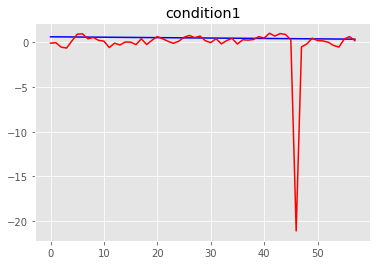

MSE condition1: 8.234922758692615
R2 condition1: -1369.5751224288333


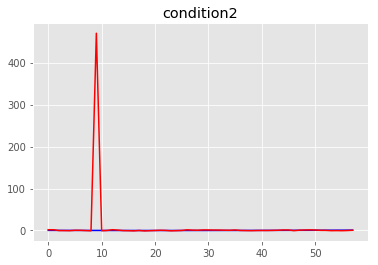

MSE condition2: 3809.364338275113
R2 condition2: -71143.16522004033


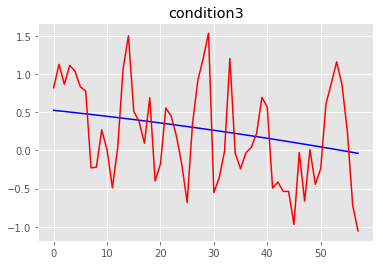

MSE condition3: 0.3743507901069155
R2 condition3: -12.600787831746116


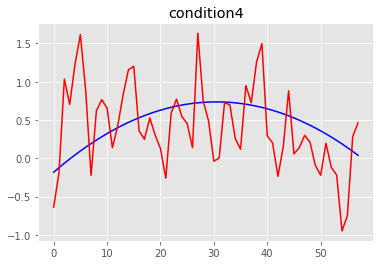

MSE condition4: 0.3175597955439867
R2 condition4: -3.8356586942965967
==== the test person number # 0 ====
==== the validated person number # 2 ====
==== the set of subject training data # [1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.24860551e-09 4.04936959e-09 3.85586975e-09 3.75710059e-09]
Global min values from training is:  [-4.23942601e-09 -4.061

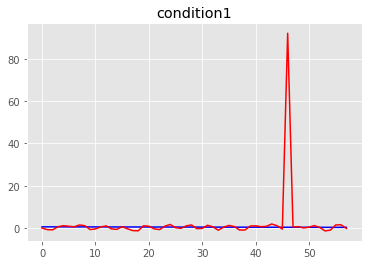

MSE condition1: 145.71368337694548
R2 condition1: -27699.879242007122


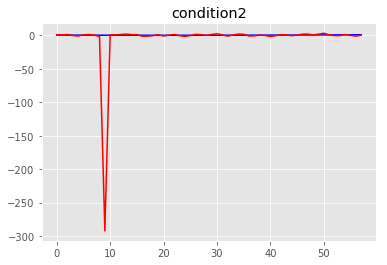

MSE condition2: 1475.0215466624718
R2 condition2: -29124.384284840227


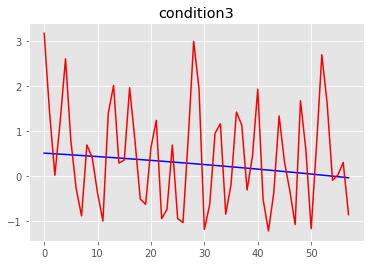

MSE condition3: 1.322191639311578
R2 condition3: -49.73325848464399


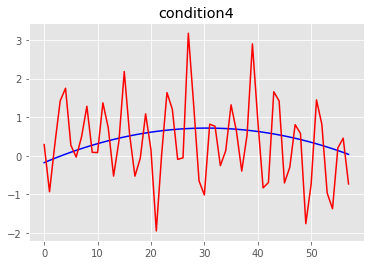

MSE condition4: 1.0838665774586984
R2 condition4: -16.34918904731381
==== the test person number # 0 ====
==== the validated person number # 3 ====
==== the set of subject training data # [1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23657233e-09 4.01064275e-09 3.84875635e-09 3.75438175e-09]
Global min values from training is:  [-4.22865966e-09 -4.0229

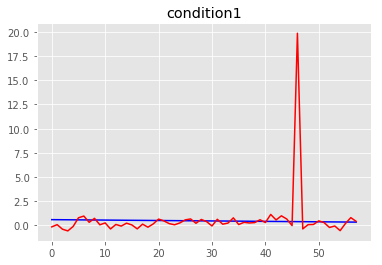

MSE condition1: 6.742811865550319
R2 condition1: -1208.7851158159963


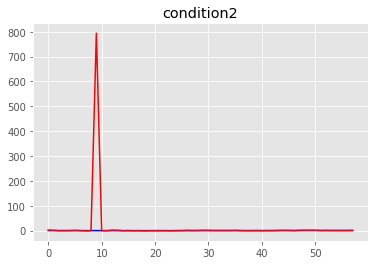

MSE condition2: 10866.394213652382
R2 condition2: -205287.80795618866


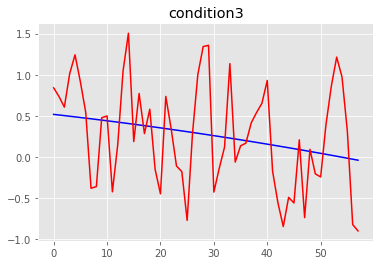

MSE condition3: 0.36380501067626364
R2 condition3: -12.579509977937136


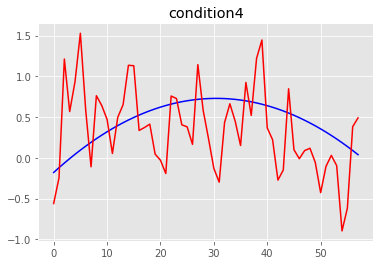

MSE condition4: 0.30839706007875894
R2 condition4: -3.7900921728308523
==== the test person number # 0 ====
==== the validated person number # 4 ====
==== the set of subject training data # [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32278515e-09 4.13145862e-09 3.83463111e-09 3.83866253e-09]
Global min values from training is:  [-4.31247419e-09 -4.14

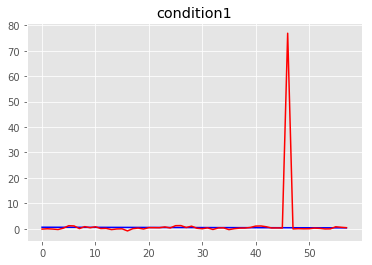

MSE condition1: 101.15730441002701
R2 condition1: -20147.30874768172


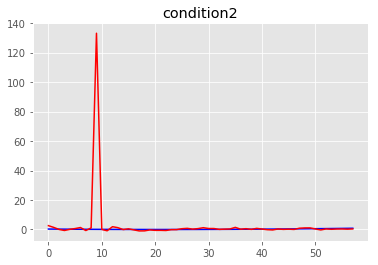

MSE condition2: 305.8440862844974
R2 condition2: -6016.585661132629


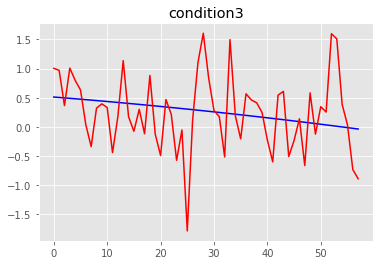

MSE condition3: 0.417010289704915
R2 condition3: -15.040720248219195


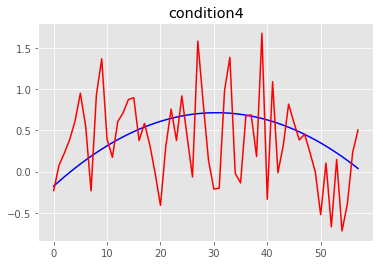

MSE condition4: 0.2933772092215246
R2 condition4: -3.745107080182101
==== the test person number # 0 ====
==== the validated person number # 5 ====
==== the set of subject training data # [1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30328738e-09 3.85233593e-09 3.82769260e-09 3.79385937e-09]
Global min values from training is:  [-4.29392564e-09 -3.8480

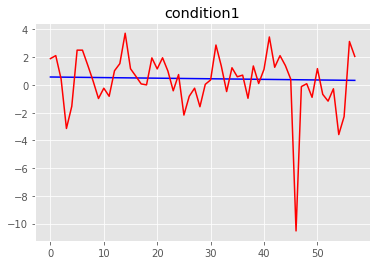

MSE condition1: 4.334547892419494
R2 condition1: -849.9148202663813


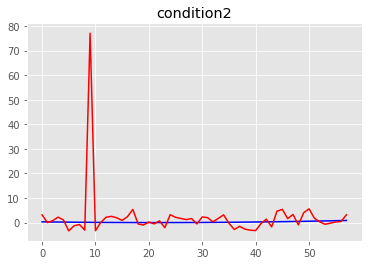

MSE condition2: 107.3175482715401
R2 condition2: -1941.9642696679289


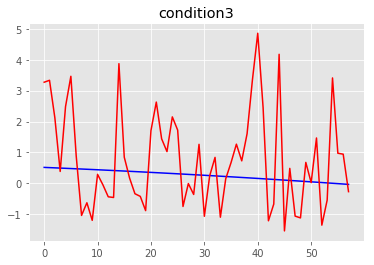

MSE condition3: 2.7395038671128256
R2 condition3: -103.46874366754702


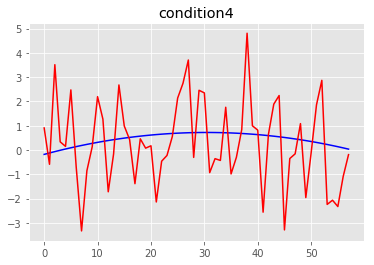

MSE condition4: 3.0409145680119294
R2 condition4: -46.86097510002258
==== the test person number # 0 ====
==== the validated person number # 6 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30390406e-09 4.11891061e-09 3.84935371e-09 3.81303450e-09]
Global min values from training is:  [-4.29426577e-09 -4.1323

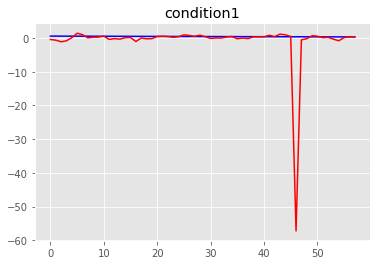

MSE condition1: 57.555703850035776
R2 condition1: -11414.879655259576


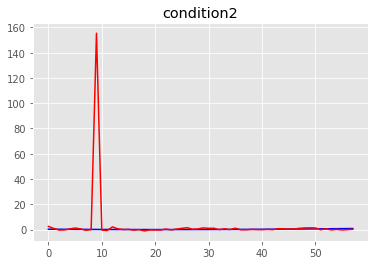

MSE condition2: 416.4579874224267
R2 condition2: -8241.866281007724


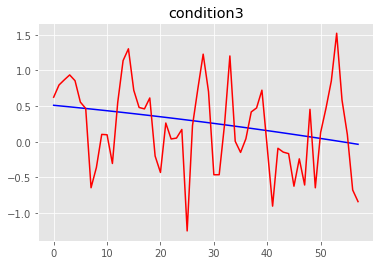

MSE condition3: 0.3442292103257713
R2 condition3: -12.260533644842


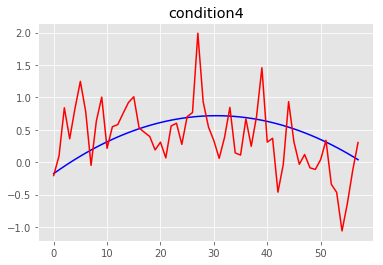

MSE condition4: 0.26616712787592156
R2 condition4: -3.2778862969268303
==== the test person number # 0 ====
==== the validated person number # 7 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.89944670e-09 3.76837666e-09 3.49352219e-09 3.42696105e-09]
Global min values from training is:  [-3.89340149e-09 -3.78

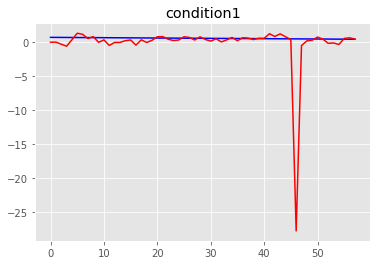

MSE condition1: 13.927766265205936
R2 condition1: -2130.101706265757


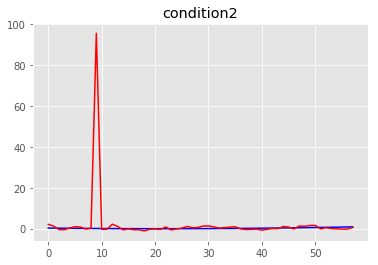

MSE condition2: 158.02361367238285
R2 condition2: -2667.5664563891023


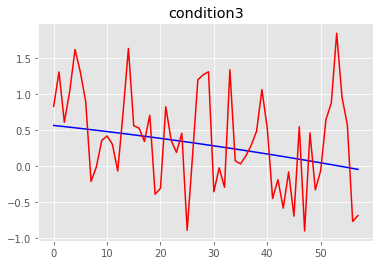

MSE condition3: 0.416150136958682
R2 condition3: -11.903148140445667


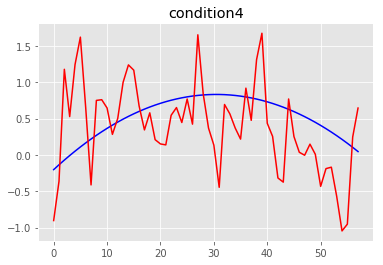

MSE condition4: 0.39852519727576863
R2 condition4: -3.773354810864392
==== the test person number # 0 ====
==== the validated person number # 8 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27915638e-09 4.09274745e-09 3.83101687e-09 3.70133942e-09]
Global min values from training is:  [-4.26816916e-09 -4.104

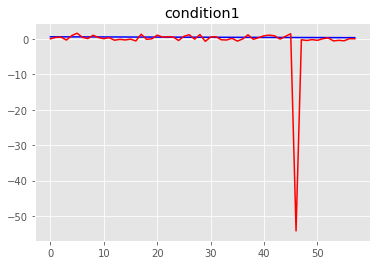

MSE condition1: 51.76890604240953
R2 condition1: -10298.126848415937


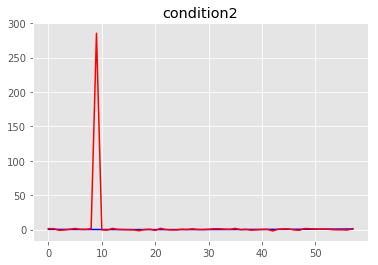

MSE condition2: 1405.3014998033848
R2 condition2: -27053.848414267413


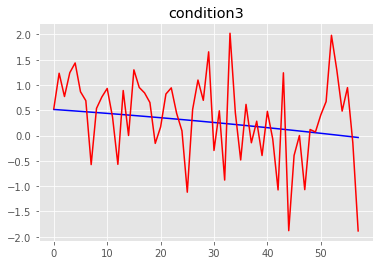

MSE condition3: 0.6431918849853108
R2 condition3: -23.188214984835067


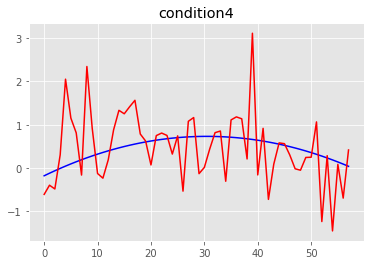

MSE condition4: 0.623562811454168
R2 condition4: -8.674555642517388
==== the test person number # 0 ====
==== the validated person number # 9 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11157338e-09 4.00180341e-09 3.74456059e-09 3.64273057e-09]
Global min values from training is:  [-4.10459332e-09 -4.01336

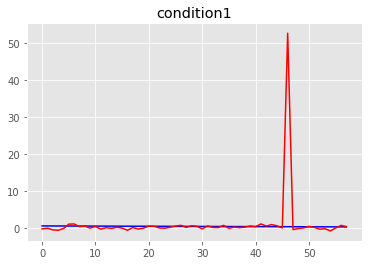

MSE condition1: 47.312117498774285
R2 condition1: -8013.567955210563


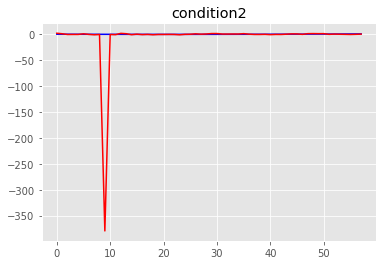

MSE condition2: 2483.973074687469
R2 condition2: -43665.81272064605


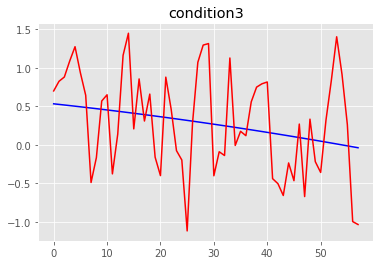

MSE condition3: 0.39528091411023836
R2 condition3: -13.032520815047587


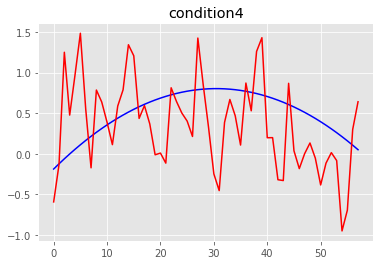

MSE condition4: 0.36792734052278997
R2 condition4: -3.8111115158716817
==== the test person number # 0 ====
==== the validated person number # 10 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26748806e-09 4.05633511e-09 3.78175176e-09 3.74285703e-09]
Global min values from training is:  [-4.25543456e-09 -4.06

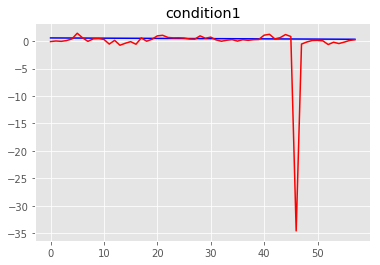

MSE condition1: 21.312862957661373
R2 condition1: -4205.876015911062


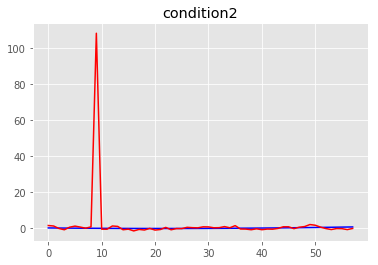

MSE condition2: 203.21009170968142
R2 condition2: -3759.953489810729


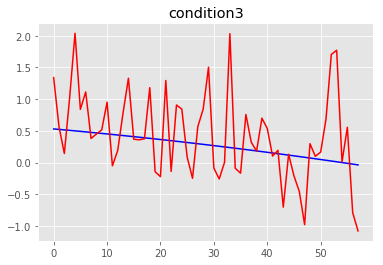

MSE condition3: 0.44769151934831863
R2 condition3: -15.084331425215094


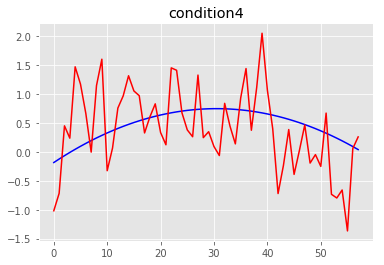

MSE condition4: 0.4593676296472951
R2 condition4: -5.773037193161664
==== the test person number # 0 ====
==== the validated person number # 11 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.85131932e-09 3.66696108e-09 3.52645263e-09 3.44362682e-09]
Global min values from training is:  [-3.84804139e-09 -3.6829

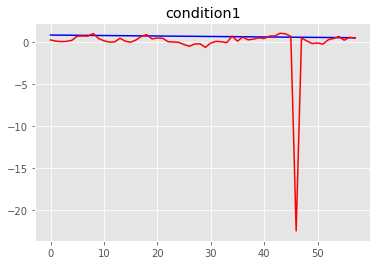

MSE condition1: 9.428247021342093
R2 condition1: -1075.3884729781835


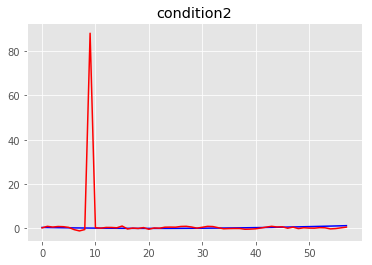

MSE condition2: 133.40863416688006
R2 condition2: -1182.9420845010973


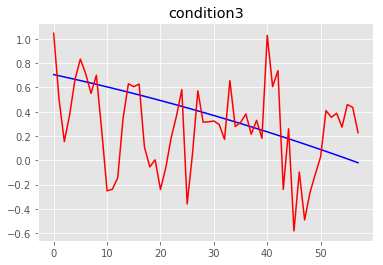

MSE condition3: 0.1493469166136343
R2 condition3: -2.2776961154306274


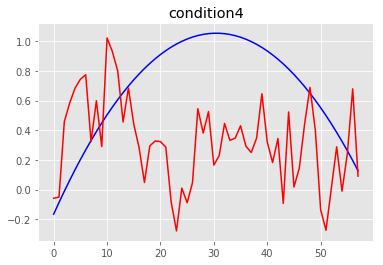

MSE condition4: 0.35571308403761276
R2 condition4: -2.0587573179459433
==== the test person number # 0 ====
==== the validated person number # 12 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20851316e-09 3.97793309e-09 3.74122821e-09 3.73250645e-09]
Global min values from training is:  [-4.19851579e-09 -3.99

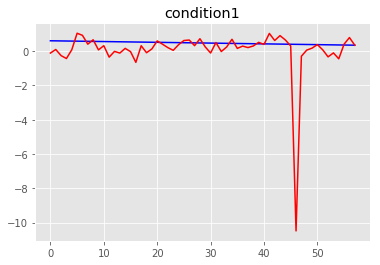

MSE condition1: 2.2479418367976076
R2 condition1: -393.25846505814985


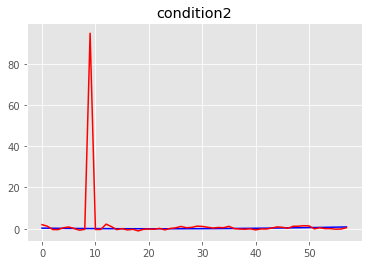

MSE condition2: 155.12098556272676
R2 condition2: -2753.7423129236913


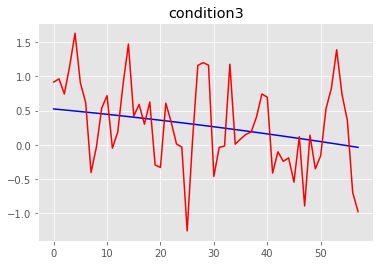

MSE condition3: 0.3548016641852919
R2 condition3: -12.005315301519325


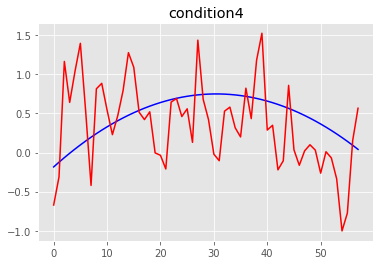

MSE condition4: 0.3276106381854102
R2 condition4: -3.819395068790011
==== the test person number # 0 ====
==== the validated person number # 13 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26286420e-09 4.06647918e-09 3.78795036e-09 3.80162848e-09]
Global min values from training is:  [-4.25447437e-09 -4.0808

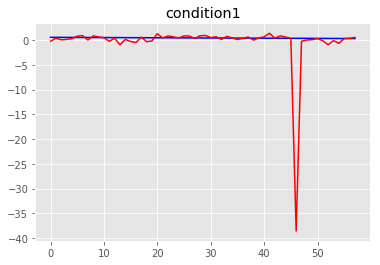

MSE condition1: 26.385041530380917
R2 condition1: -5173.7830017116385


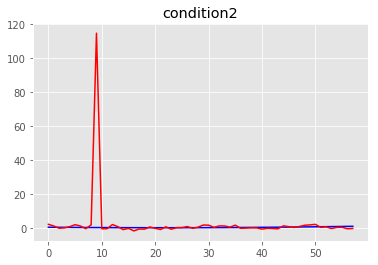

MSE condition2: 226.2680852566299
R2 condition2: -4402.067807501701


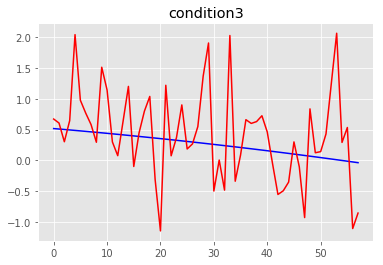

MSE condition3: 0.5275112953152424
R2 condition3: -18.894620248159576


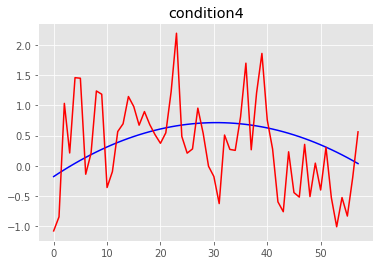

MSE condition4: 0.5257351010424209
R2 condition4: -7.490859671526547
==== the test person number # 0 ====
==== the validated person number # 14 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00737975e-09 3.82811449e-09 3.45734051e-09 3.59061275e-09]
Global min values from training is:  [-3.99242127e-09 -3.8437

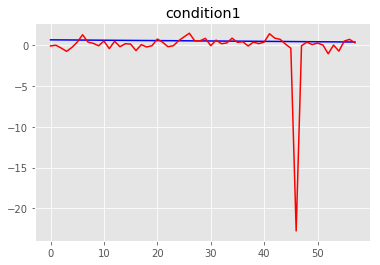

MSE condition1: 9.597282866000421
R2 condition1: -1583.9975359183325


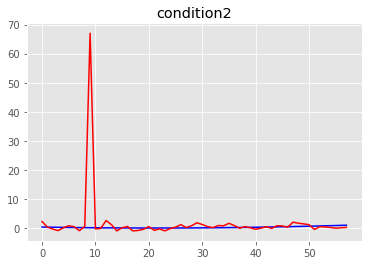

MSE condition2: 77.94075795487389
R2 condition2: -1121.816945102559


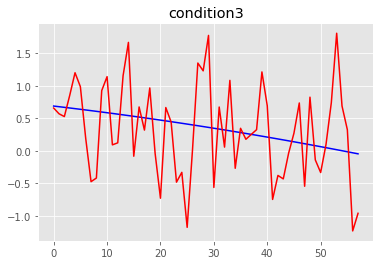

MSE condition3: 0.49061215057707747
R2 condition3: -9.50067360866223


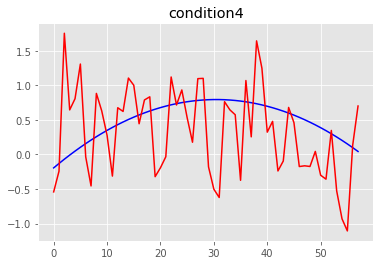

MSE condition4: 0.457747048489172
R2 condition4: -5.0044087133023725
==== the test person number # 0 ====
==== the validated person number # 15 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30993808e-09 4.12261209e-09 3.87308245e-09 3.85699694e-09]
Global min values from training is:  [-4.30063731e-09 -4.1361

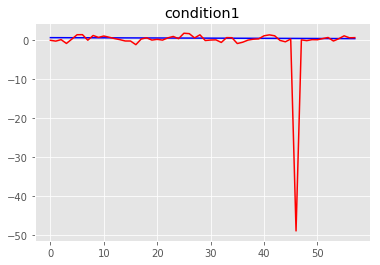

MSE condition1: 42.17764647244505
R2 condition1: -8312.683847846269


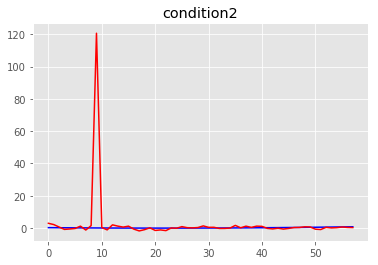

MSE condition2: 251.72888569394047
R2 condition2: -4885.530642599371


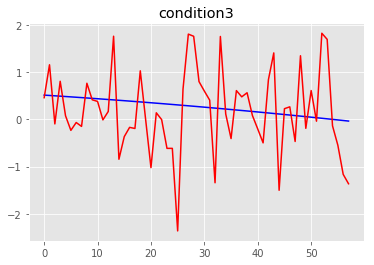

MSE condition3: 0.7983814515175958
R2 condition3: -29.587672461106468


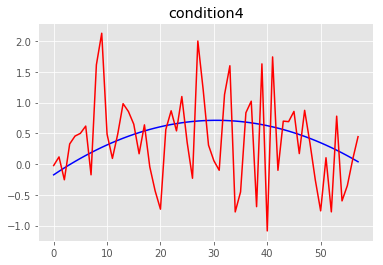

MSE condition4: 0.5399600478095791
R2 condition4: -7.8033386260455995
==== the test person number # 1 ====
==== the validated person number # 0 ====
==== the set of subject training data # [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19534200e-09 4.00596529e-09 3.79618159e-09 3.79689779e-09]
Global min values from training is:  [-4.18395381e-09 -4.018

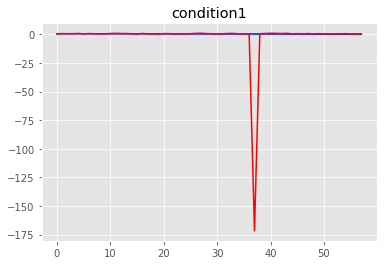

MSE condition1: 510.42071544805975
R2 condition1: -49762.84650229104


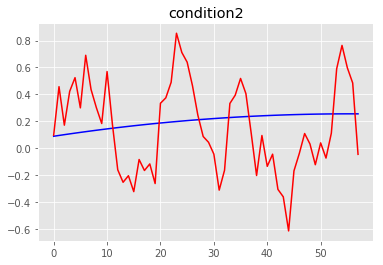

MSE condition2: 0.12238302404719559
R2 condition2: -46.68700813600783


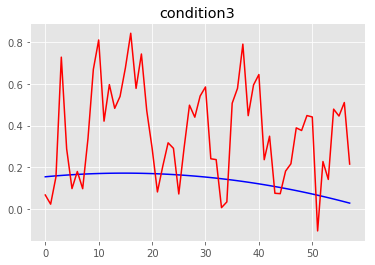

MSE condition3: 0.10493919936101902
R2 condition3: -57.77526877132421


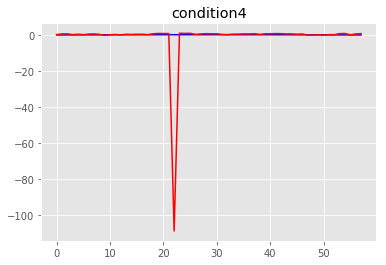

MSE condition4: 203.8679173344539
R2 condition4: -121745.67137030858
==== the test person number # 1 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30403955e-09 4.52059424e-09 4.01752881e-09 3.97219028e-09]
Global min values from training is:  [-4.29175015e-09 -4.5304

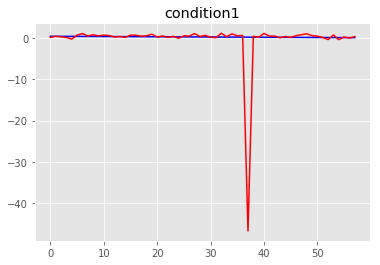

MSE condition1: 38.204908897533635
R2 condition1: -4068.2816872481962


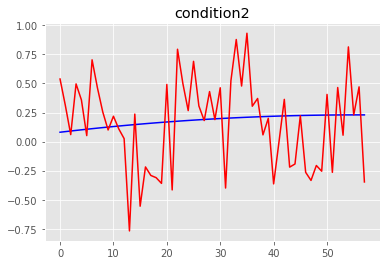

MSE condition2: 0.15406770331080435
R2 condition2: -73.58994874961809


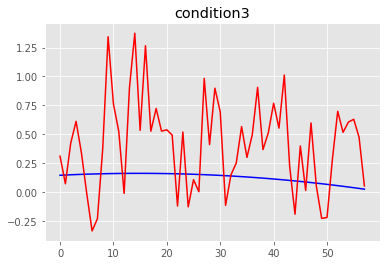

MSE condition3: 0.2373538246898613
R2 condition3: -146.28837003781106


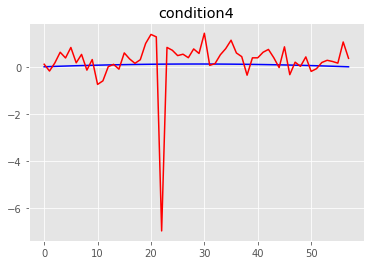

MSE condition4: 1.1436170797278682
R2 condition4: -862.8957441528357
==== the test person number # 1 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29200637e-09 4.48186740e-09 4.01041541e-09 3.96947143e-09]
Global min values from training is:  [-4.28098381e-09 -4.4916

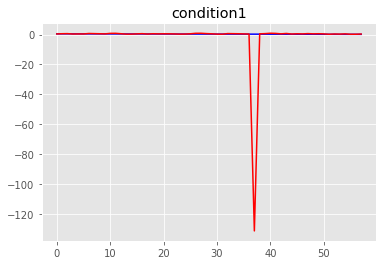

MSE condition1: 299.247704917058
R2 condition1: -30041.031651911948


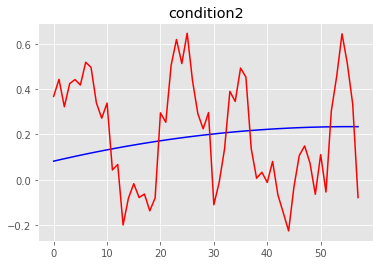

MSE condition2: 0.06584696540268951
R2 condition2: -29.606556749065746


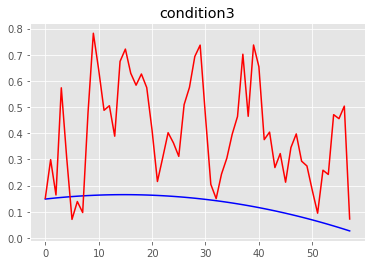

MSE condition3: 0.10886917084833111
R2 condition3: -64.76271028512916


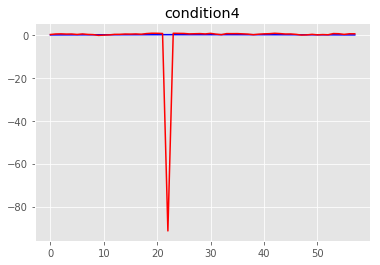

MSE condition4: 144.540580629789
R2 condition4: -106233.16562037448
==== the test person number # 1 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37821919e-09 4.60268327e-09 3.99629017e-09 4.05375221e-09]
Global min values from training is:  [-4.36479833e-09 -4.61420

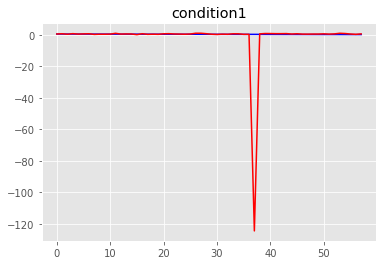

MSE condition1: 268.0961891671951
R2 condition1: -29948.37740480825


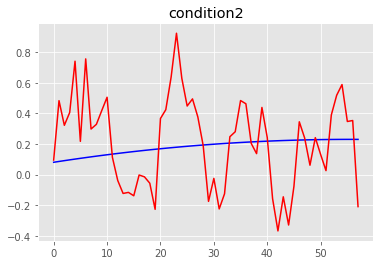

MSE condition2: 0.09427635110744761
R2 condition2: -44.49259685693111


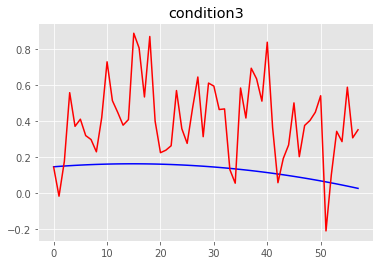

MSE condition3: 0.12143257904497039
R2 condition3: -74.53716318575546


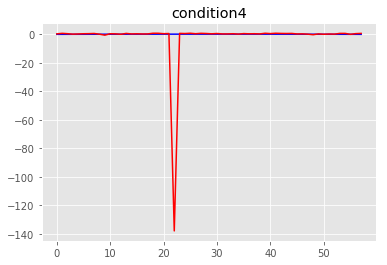

MSE condition4: 329.38134583135354
R2 condition4: -251186.28874973088
==== the test person number # 1 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35872142e-09 4.32356058e-09 3.98935166e-09 4.00894906e-09]
Global min values from training is:  [-4.34624978e-09 -4.316

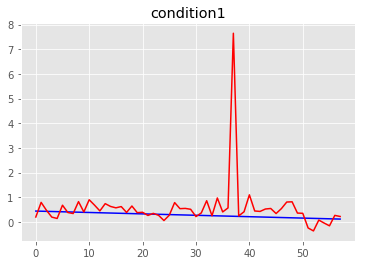

MSE condition1: 1.0476726107866654
R2 condition1: -114.31470704729098


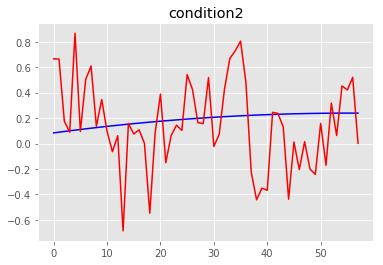

MSE condition2: 0.12710302254665673
R2 condition2: -55.81017239698782


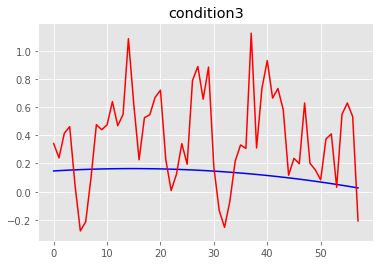

MSE condition3: 0.16979641771872764
R2 condition3: -103.73225619630595


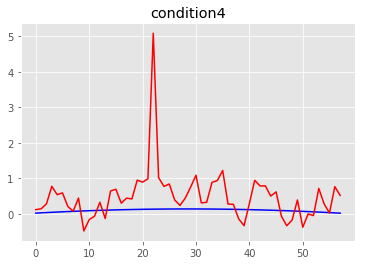

MSE condition4: 0.6749051849958755
R2 condition4: -501.05074087096693
==== the test person number # 1 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35933810e-09 4.59013526e-09 4.01101277e-09 4.02812418e-09]
Global min values from training is:  [-4.34658991e-09 -4.601

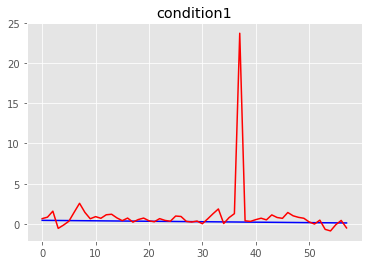

MSE condition1: 9.94808749605812
R2 condition1: -1105.5635482390205


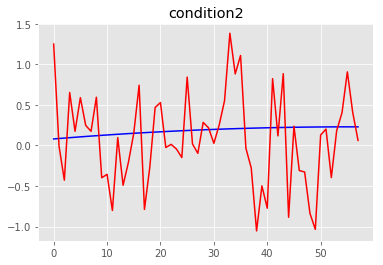

MSE condition2: 0.33257611737388887
R2 condition2: -160.36650987524555


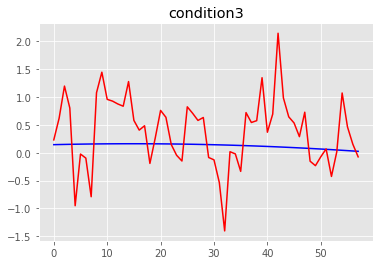

MSE condition3: 0.44349681667692803
R2 condition3: -275.2721546594497


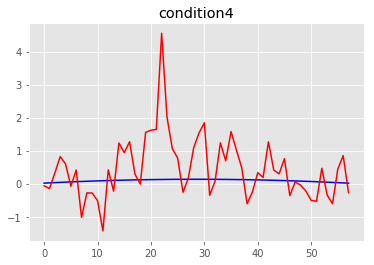

MSE condition4: 0.9656645702812902
R2 condition4: -731.1869712545835
==== the test person number # 1 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.95488074e-09 4.23960131e-09 3.65518125e-09 3.64205073e-09]
Global min values from training is:  [-3.94572564e-09 -4.2497

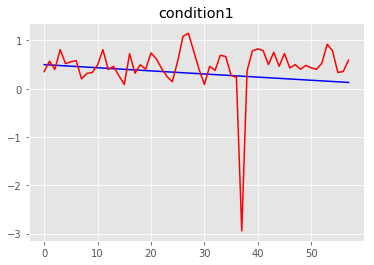

MSE condition1: 0.28581709963683377
R2 condition1: -23.37651989152255


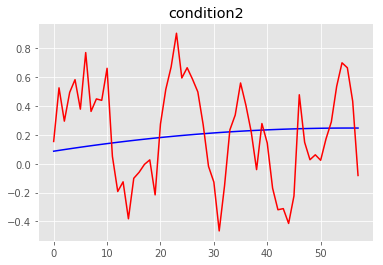

MSE condition2: 0.12308200909679258
R2 condition2: -50.606732223906924


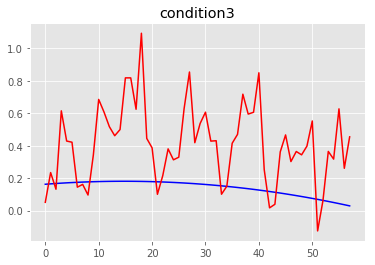

MSE condition3: 0.1272771280888235
R2 condition3: -63.16201912782002


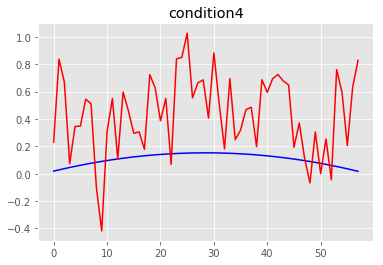

MSE condition4: 0.19099445841120685
R2 condition4: -109.95975604429424
==== the test person number # 1 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33459042e-09 4.56397210e-09 3.99267593e-09 3.91642910e-09]
Global min values from training is:  [-4.32049330e-09 -4.57

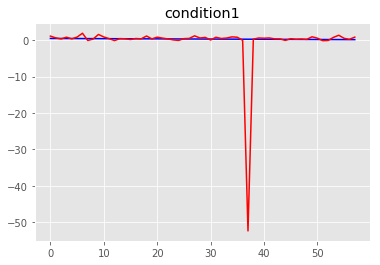

MSE condition1: 47.81254653797196
R2 condition1: -5333.796903792294


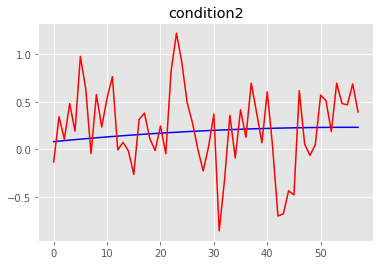

MSE condition2: 0.18389163326110688
R2 condition2: -85.9742527832895


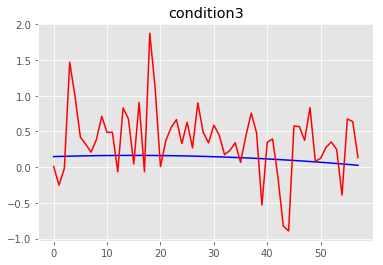

MSE condition3: 0.26957337726596053
R2 condition3: -163.02946514285156


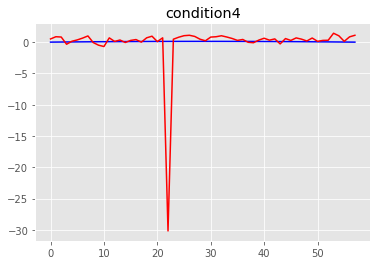

MSE condition4: 16.157313815224132
R2 condition4: -11862.259792465184
==== the test person number # 1 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.16700742e-09 4.47302806e-09 3.90621965e-09 3.85782026e-09]
Global min values from training is:  [-4.15691746e-09 -4.482

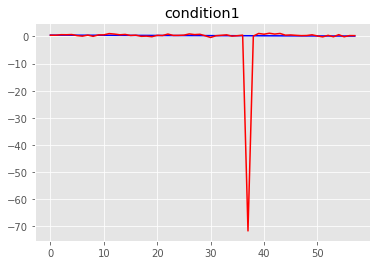

MSE condition1: 89.2484398720944
R2 condition1: -8446.968378477028


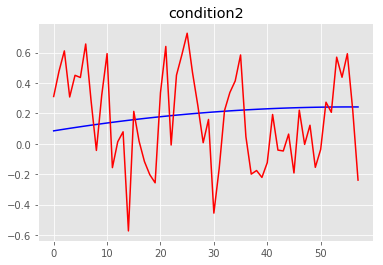

MSE condition2: 0.10240508434414851
R2 condition2: -43.54935191510309


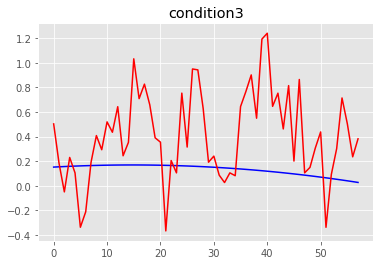

MSE condition3: 0.20790289968817038
R2 condition3: -118.58556390170568


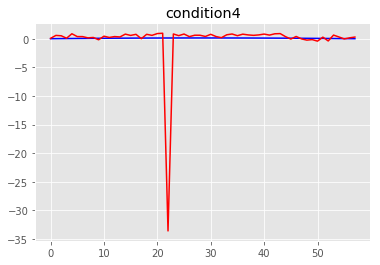

MSE condition4: 19.832974856259934
R2 condition4: -12469.402337759278
==== the test person number # 1 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32292210e-09 4.52755976e-09 3.94341082e-09 3.95794671e-09]
Global min values from training is:  [-4.30775870e-09 -4.536

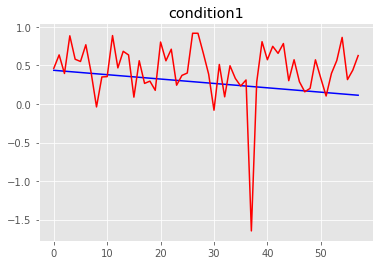

MSE condition1: 0.16161902867484154
R2 condition1: -16.888741026081767


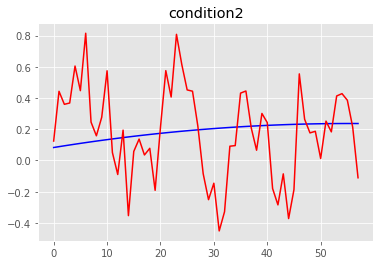

MSE condition2: 0.09445551920880253
R2 condition2: -42.08129123160155


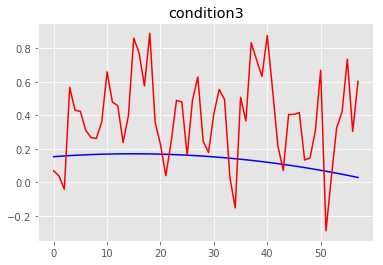

MSE condition3: 0.1289922774139453
R2 condition3: -74.0669742187215


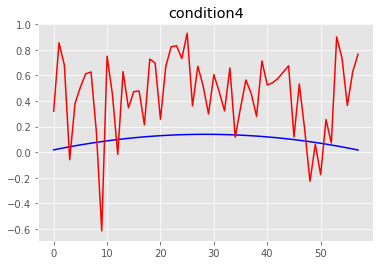

MSE condition4: 0.2144212328618715
R2 condition4: -149.3080954508865
==== the test person number # 1 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.90675336e-09 4.13818573e-09 3.68811169e-09 3.65871650e-09]
Global min values from training is:  [-3.90036553e-09 -4.1516

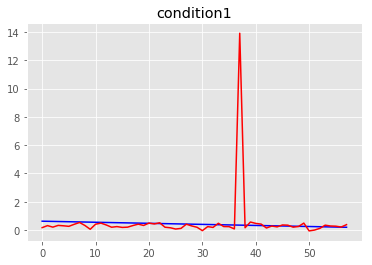

MSE condition1: 3.224402065760206
R2 condition1: -202.56137938312708


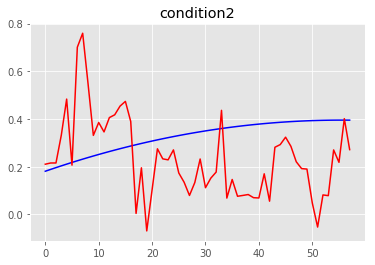

MSE condition2: 0.05041910717034243
R2 condition2: -10.823139426119097


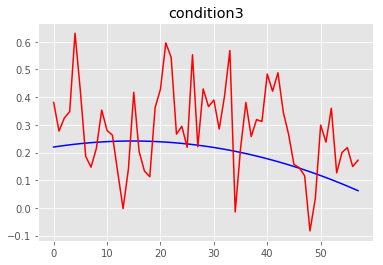

MSE condition3: 0.029557899496469756
R2 condition3: -9.651692107123676


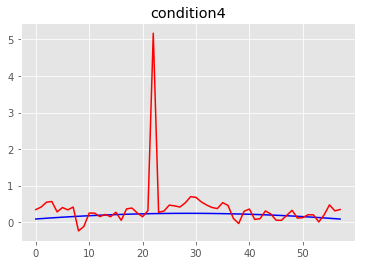

MSE condition4: 0.4641534320787445
R2 condition4: -199.6884137158219
==== the test person number # 1 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26394720e-09 4.44915774e-09 3.90288727e-09 3.94759614e-09]
Global min values from training is:  [-4.25083993e-09 -4.4593

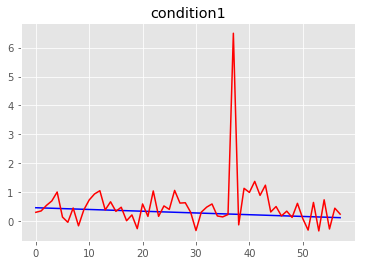

MSE condition1: 0.85847653697956
R2 condition1: -83.20258618562912


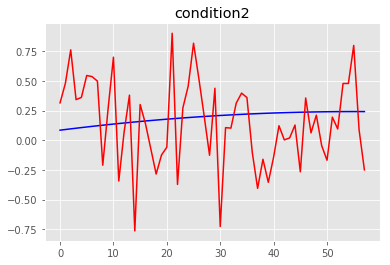

MSE condition2: 0.14308248091977158
R2 condition2: -61.827908213380496


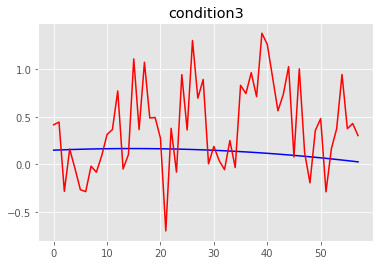

MSE condition3: 0.28524592464906384
R2 condition3: -168.27931937972338


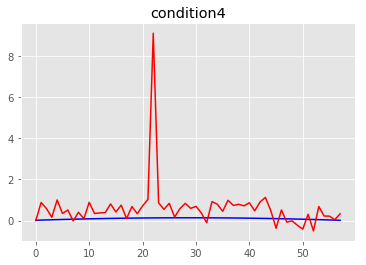

MSE condition4: 1.6509927497063612
R2 condition4: -1153.9468023066254
==== the test person number # 1 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31829824e-09 4.53770383e-09 3.94960942e-09 4.01671816e-09]
Global min values from training is:  [-4.30679851e-09 -4.549

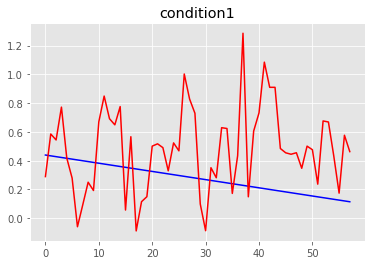

MSE condition1: 0.14146342745432575
R2 condition1: -14.555584306560954


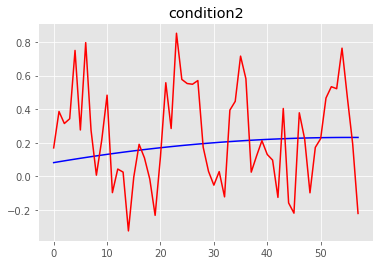

MSE condition2: 0.08952932304177849
R2 condition2: -41.76476795087849


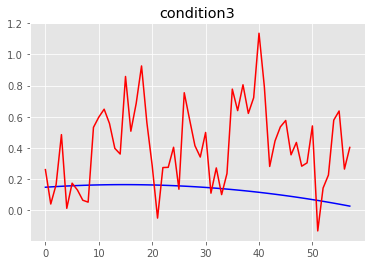

MSE condition3: 0.1516827372039729
R2 condition3: -91.55332480674956


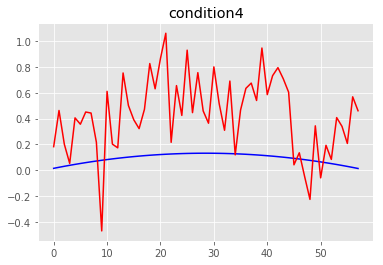

MSE condition4: 0.1937526493148705
R2 condition4: -146.55952266037306
==== the test person number # 1 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06281379e-09 4.29933914e-09 3.61899957e-09 3.80570244e-09]
Global min values from training is:  [-4.04474541e-09 -4.312

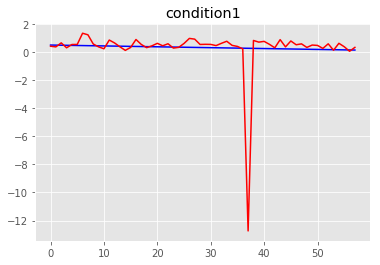

MSE condition1: 3.0151704014637675
R2 condition1: -277.08080747415715


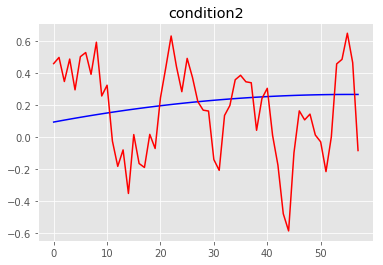

MSE condition2: 0.09258382149279694
R2 condition2: -32.57370370044174


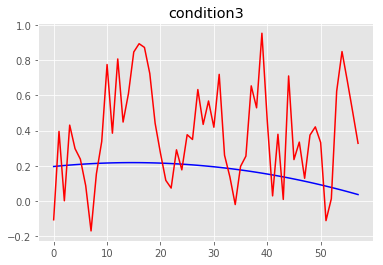

MSE condition3: 0.12459868366181608
R2 condition3: -42.82332032011878


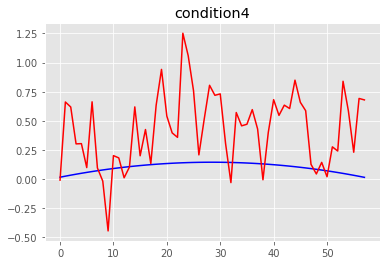

MSE condition4: 0.20166648564928888
R2 condition4: -126.16155856419921
==== the test person number # 1 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36537212e-09 4.59383674e-09 4.03474151e-09 4.07208662e-09]
Global min values from training is:  [-4.35296145e-09 -4.60

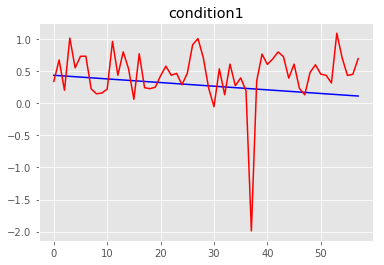

MSE condition1: 0.20952968337426722
R2 condition1: -22.158620152363028


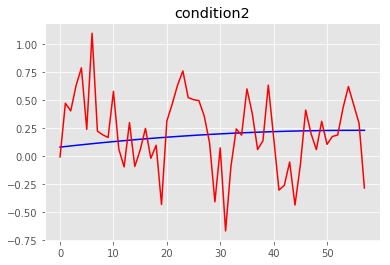

MSE condition2: 0.12301238016046796
R2 condition2: -57.62573303393016


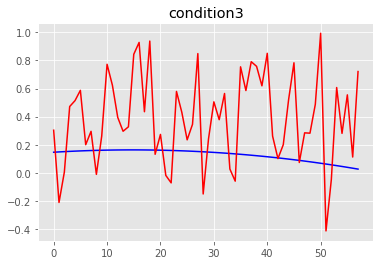

MSE condition3: 0.17005412813239087
R2 condition3: -104.3689672694047


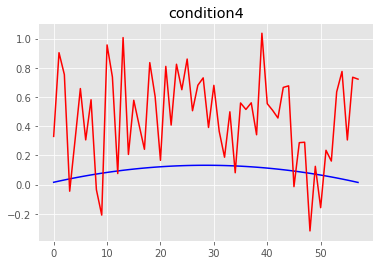

MSE condition4: 0.23155328691205826
R2 condition4: -176.87352570077556
==== the test person number # 2 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.24860551e-09 4.04936959e-09 3.85586975e-09 3.75710059e-09]
Global min values from training is:  [-4.23942601e-09 -4.06

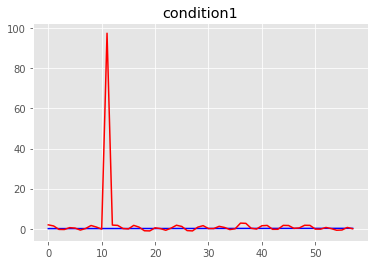

MSE condition1: 164.83824660212062
R2 condition1: -116184.46939494961


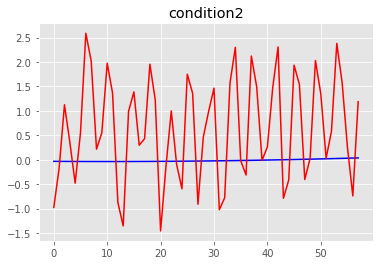

MSE condition2: 1.5822963536671062
R2 condition2: -3199.5774215113224


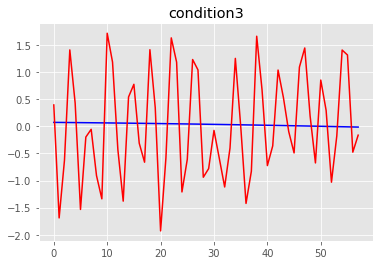

MSE condition3: 0.9692215371887861
R2 condition3: -1483.0011345690932


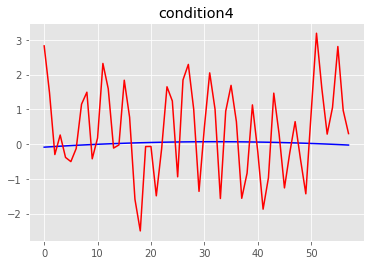

MSE condition4: 1.8180758898888725
R2 condition4: -1007.1405865060334
==== the test person number # 2 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30403955e-09 4.52059424e-09 4.01752881e-09 3.97219028e-09]
Global min values from training is:  [-4.29175015e-09 -4.530

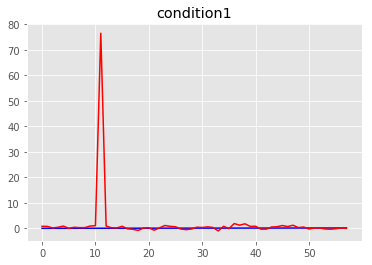

MSE condition1: 100.9223303227858
R2 condition1: -68035.83983498013


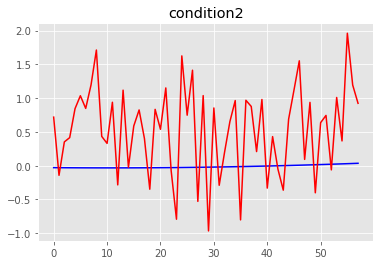

MSE condition2: 0.7250244536090173
R2 condition2: -1722.4410994729406


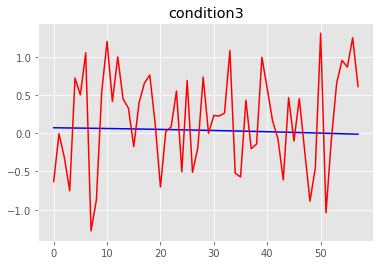

MSE condition3: 0.4132514837137934
R2 condition3: -662.7857184744813


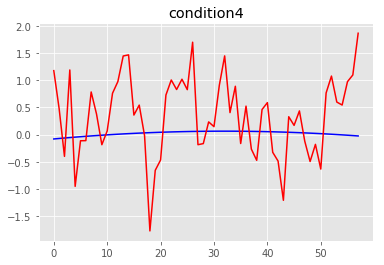

MSE condition4: 0.6422359806569097
R2 condition4: -427.55146894904124
==== the test person number # 2 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34526988e-09 4.52527169e-09 4.07010357e-09 3.92967423e-09]
Global min values from training is:  [-4.33645601e-09 -4.534

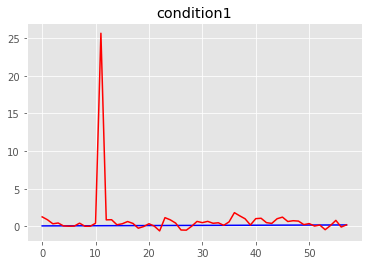

MSE condition1: 11.60126010169866
R2 condition1: -8403.263100037406


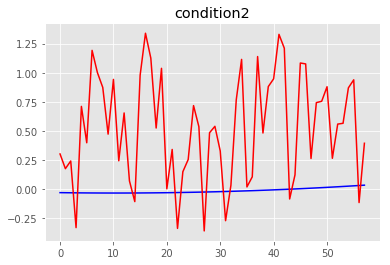

MSE condition2: 0.5006349438334868
R2 condition2: -1201.3908877668068


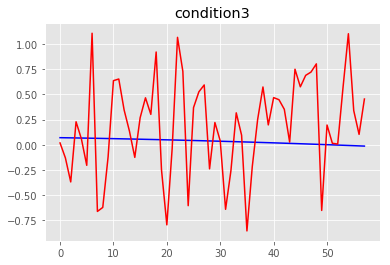

MSE condition3: 0.25769413452273376
R2 condition3: -423.683947781025


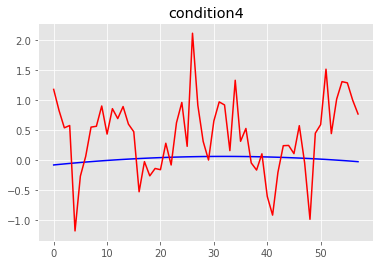

MSE condition4: 0.5368517132764123
R2 condition4: -363.5998658247137
==== the test person number # 2 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148270e-09 4.64608756e-09 4.05597833e-09 4.01395501e-09]
Global min values from training is:  [-4.42027053e-09 -4.6574

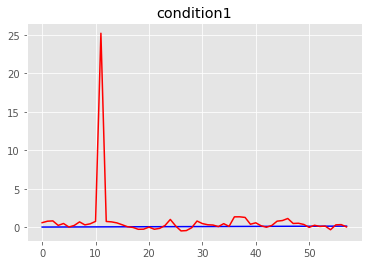

MSE condition1: 11.124444727033325
R2 condition1: -8907.406661388783


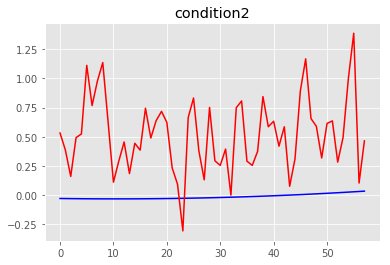

MSE condition2: 0.38357497295059967
R2 condition2: -954.4940461399153


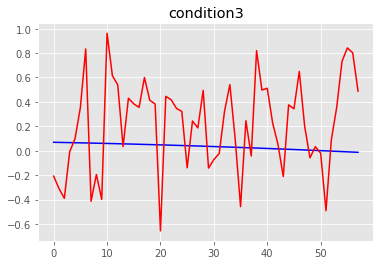

MSE condition3: 0.17731313125126985
R2 condition3: -299.6936383162929


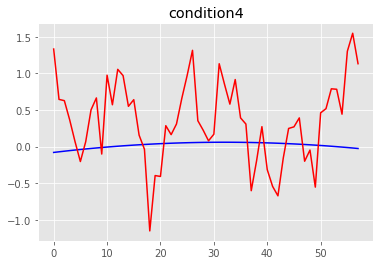

MSE condition4: 0.43867393125921234
R2 condition4: -307.86920202681614
==== the test person number # 2 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41198493e-09 4.36696487e-09 4.04903982e-09 3.96915186e-09]
Global min values from training is:  [-4.40172199e-09 -4.36

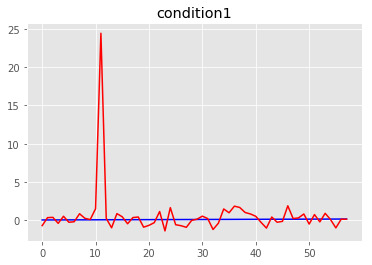

MSE condition1: 10.825109847414355
R2 condition1: -8547.81338896047


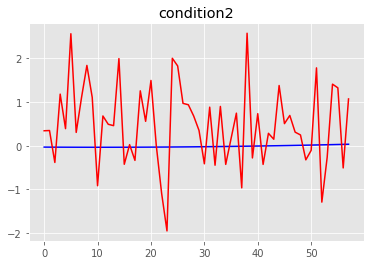

MSE condition2: 1.114943977892757
R2 condition2: -2576.5188285356658


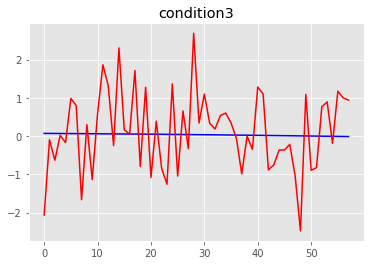

MSE condition3: 1.0861823815960625
R2 condition3: -1825.8663585652466


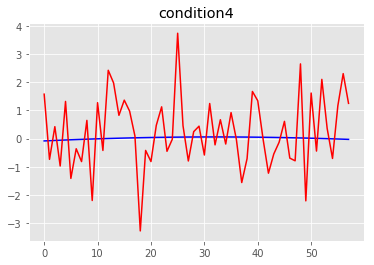

MSE condition4: 1.710570398374749
R2 condition4: -1174.4858811376619
==== the test person number # 2 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41260161e-09 4.63353955e-09 4.07070093e-09 3.98832699e-09]
Global min values from training is:  [-4.40206211e-09 -4.6443

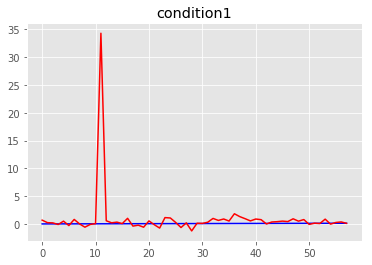

MSE condition1: 20.47131031189602
R2 condition1: -16326.486129753963


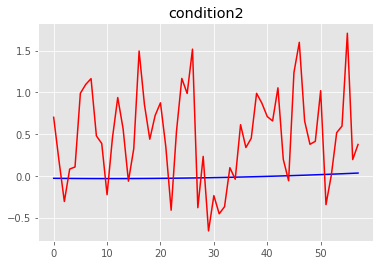

MSE condition2: 0.5474440125734078
R2 condition2: -1370.0171605446094


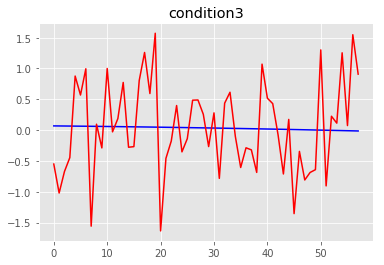

MSE condition3: 0.5621202797693966
R2 condition3: -953.5921540253387


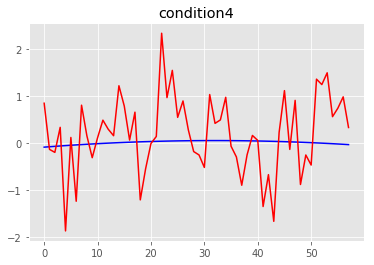

MSE condition4: 0.7003151207615403
R2 condition4: -489.3183412818352
==== the test person number # 2 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00814426e-09 4.28300560e-09 3.71486941e-09 3.60225353e-09]
Global min values from training is:  [-4.00119784e-09 -4.2930

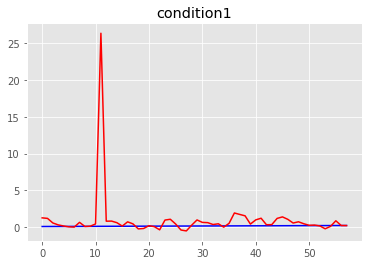

MSE condition1: 12.317102092277608
R2 condition1: -7661.26024408776


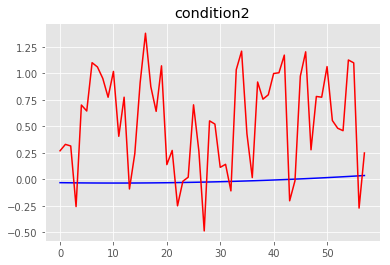

MSE condition2: 0.5329934505349169
R2 condition2: -1156.8078434723247


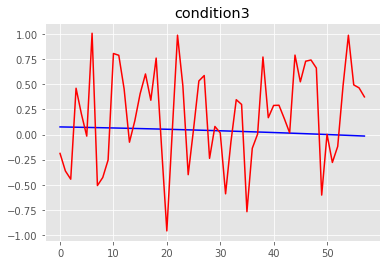

MSE condition3: 0.24441769956280263
R2 condition3: -336.8144578591471


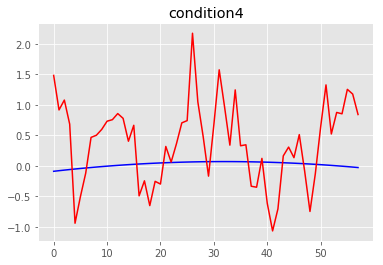

MSE condition4: 0.5907345696284094
R2 condition4: -317.8855248960265
==== the test person number # 2 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.38785393e-09 4.60737639e-09 4.05236409e-09 3.87663191e-09]
Global min values from training is:  [-4.37596550e-09 -4.6165

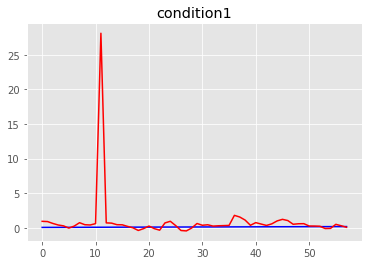

MSE condition1: 13.85174581486029
R2 condition1: -11078.917363167593


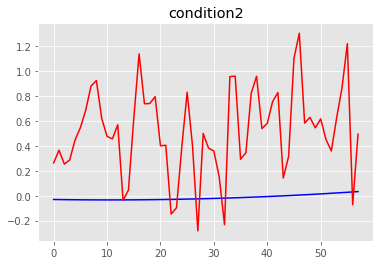

MSE condition2: 0.4064385840594989
R2 condition2: -991.8416826620082


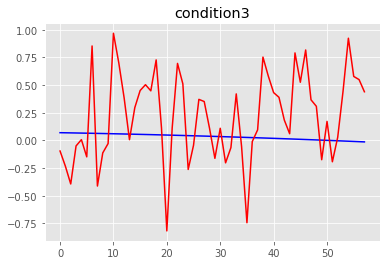

MSE condition3: 0.19314667111995687
R2 condition3: -319.58003772991697


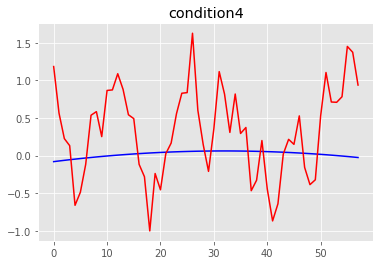

MSE condition4: 0.45702298462839885
R2 condition4: -309.0776455992761
==== the test person number # 2 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.22027093e-09 4.51643236e-09 3.96590781e-09 3.81802306e-09]
Global min values from training is:  [-4.21238966e-09 -4.525

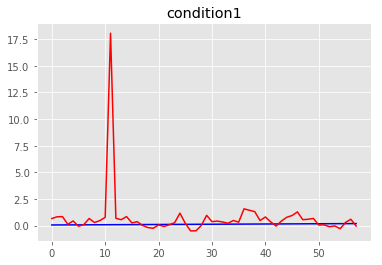

MSE condition1: 5.854111104547181
R2 condition1: -4012.766147655488


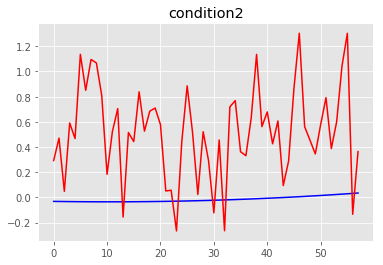

MSE condition2: 0.41845775503236016
R2 condition2: -941.2234279647927


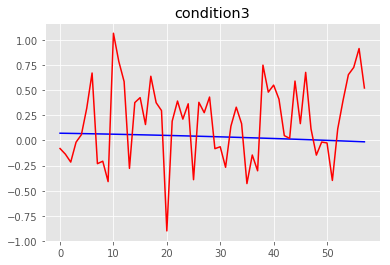

MSE condition3: 0.1785274978212021
R2 condition3: -279.52286934278936


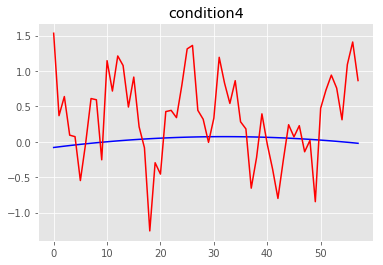

MSE condition4: 0.4818206321992995
R2 condition4: -279.9532925970683
==== the test person number # 2 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37618561e-09 4.57096406e-09 4.00309898e-09 3.91814952e-09]
Global min values from training is:  [-4.36323090e-09 -4.5795

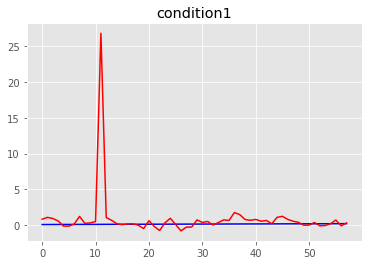

MSE condition1: 12.680512028281456
R2 condition1: -10065.792651169113


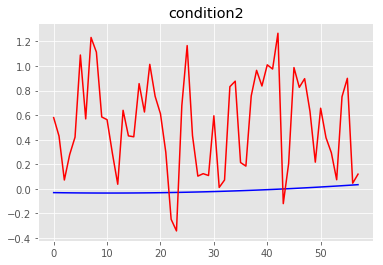

MSE condition2: 0.4427942004581568
R2 condition2: -1043.0400395957881


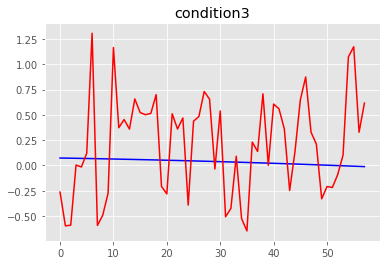

MSE condition3: 0.27387400017429675
R2 condition3: -434.25786534844553


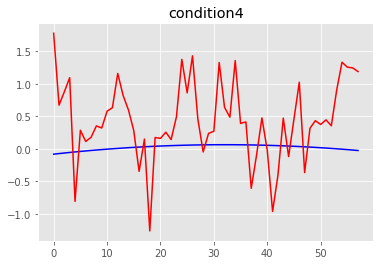

MSE condition4: 0.5575607892837031
R2 condition4: -360.54112963439997
==== the test person number # 2 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96001687e-09 4.18159003e-09 3.74779986e-09 3.61891930e-09]
Global min values from training is:  [-3.95583773e-09 -4.194

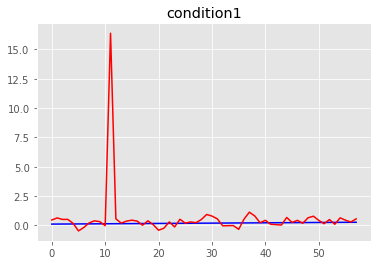

MSE condition1: 4.654249289468596
R2 condition1: -2190.0884899199445


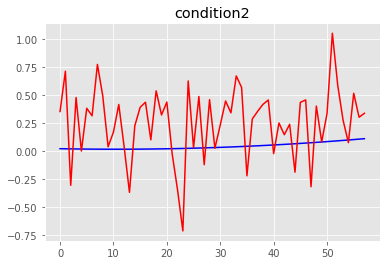

MSE condition2: 0.14387222562737584
R2 condition2: -176.92777656922138


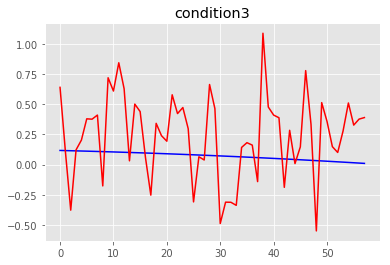

MSE condition3: 0.14587983162065402
R2 condition3: -144.6283651419236


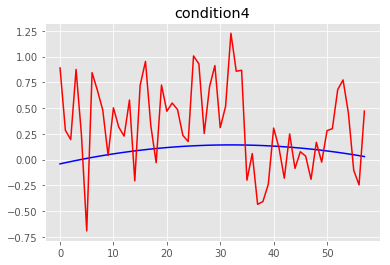

MSE condition4: 0.23356557383760623
R2 condition4: -93.58303186182548
==== the test person number # 2 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31721071e-09 4.49256203e-09 3.96257543e-09 3.90779894e-09]
Global min values from training is:  [-4.30631213e-09 -4.502

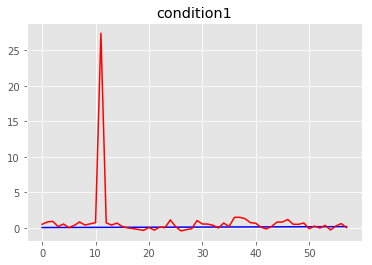

MSE condition1: 13.161287295410292
R2 condition1: -9328.01543821666


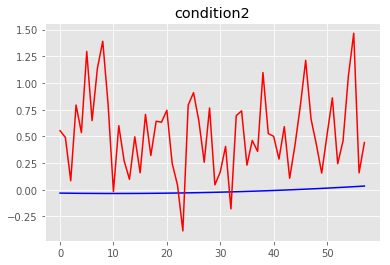

MSE condition2: 0.43552206734086124
R2 condition2: -988.5862034734288


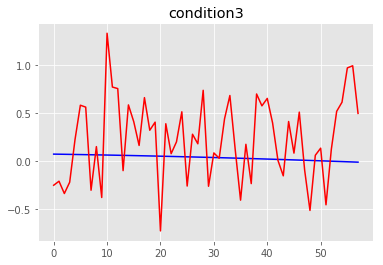

MSE condition3: 0.21956609311051772
R2 condition3: -354.66141218377805


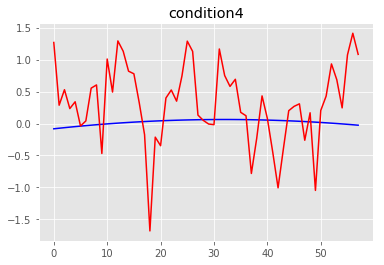

MSE condition4: 0.48351158743568196
R2 condition4: -311.8924428731568
==== the test person number # 2 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37156176e-09 4.58110812e-09 4.00929758e-09 3.97692096e-09]
Global min values from training is:  [-4.36227072e-09 -4.592

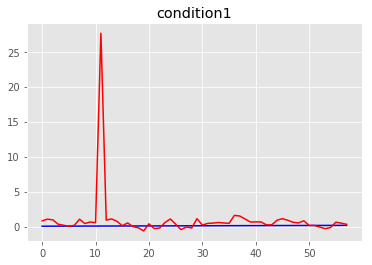

MSE condition1: 13.44049803490205
R2 condition1: -10603.672818323195


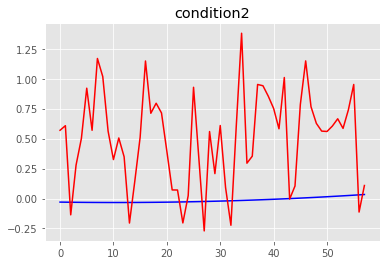

MSE condition2: 0.42490835449849945
R2 condition2: -1047.01000115352


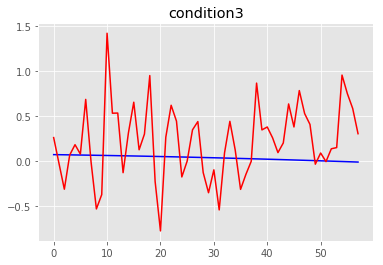

MSE condition3: 0.20509214089719133
R2 condition3: -340.3327517131352


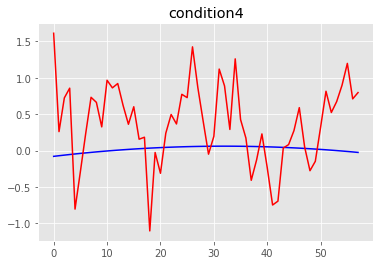

MSE condition4: 0.43888122218444275
R2 condition4: -307.612406130704
==== the test person number # 2 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11607731e-09 4.34274343e-09 3.67868774e-09 3.76590524e-09]
Global min values from training is:  [-4.10021761e-09 -4.3557

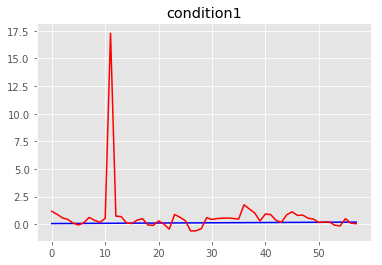

MSE condition1: 5.383576092583341
R2 condition1: -3601.5536551183272


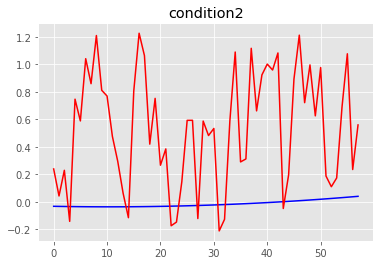

MSE condition2: 0.4691280983279926
R2 condition2: -883.8905754951305


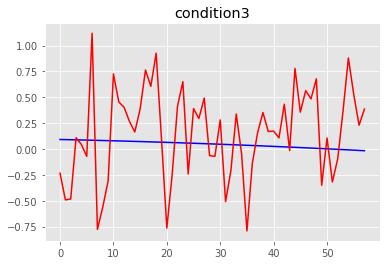

MSE condition3: 0.21008603062589967
R2 condition3: -203.85602611147903


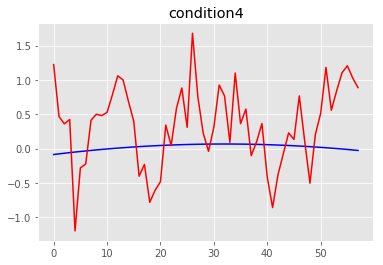

MSE condition4: 0.45322573447106446
R2 condition4: -264.01061850621545
==== the test person number # 2 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41863563e-09 4.63724104e-09 4.09442967e-09 4.03228943e-09]
Global min values from training is:  [-4.40843365e-09 -4.64

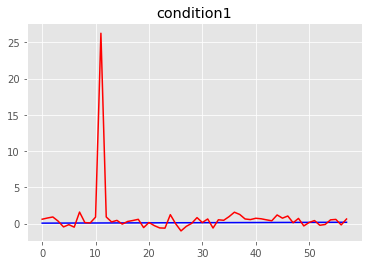

MSE condition1: 12.175614108857252
R2 condition1: -9652.007587796727


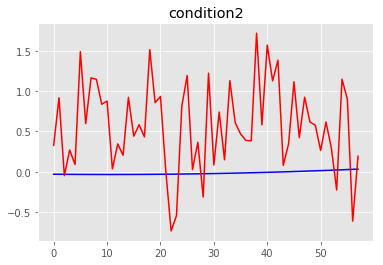

MSE condition2: 0.6392094199048792
R2 condition2: -1572.1002043891913


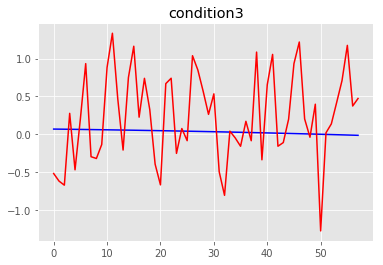

MSE condition3: 0.3805981467102423
R2 condition3: -641.9743450588071


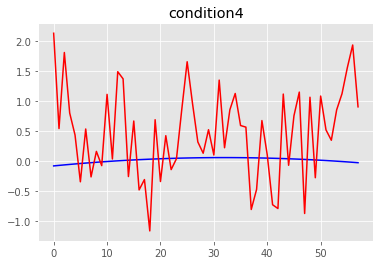

MSE condition4: 0.7840248043693091
R2 condition4: -554.9750014624078
==== the test person number # 3 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23657233e-09 4.01064275e-09 3.84875635e-09 3.75438175e-09]
Global min values from training is:  [-4.22865966e-09 -4.0229

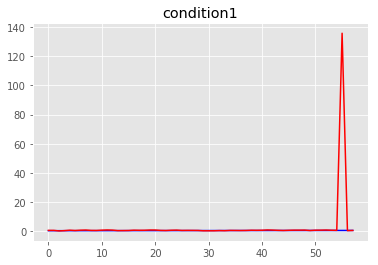

MSE condition1: 317.0749554163061
R2 condition1: -131181.2928463002


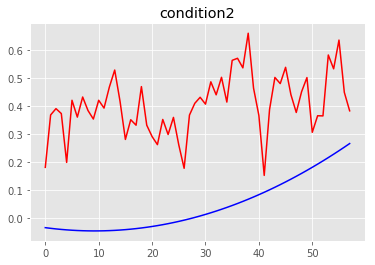

MSE condition2: 0.1440827094791797
R2 condition2: -15.116334936486478


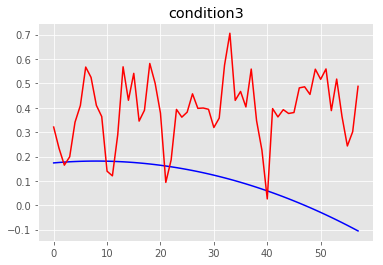

MSE condition3: 0.1144701807941439
R2 condition3: -14.054032465887813


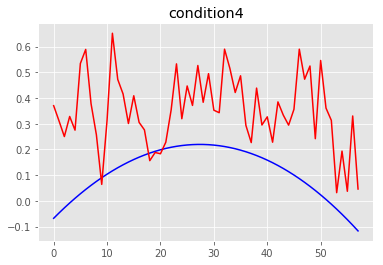

MSE condition4: 0.07788274621434155
R2 condition4: -7.254899212117268
==== the test person number # 3 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29200637e-09 4.48186740e-09 4.01041541e-09 3.96947143e-09]
Global min values from training is:  [-4.28098381e-09 -4.491

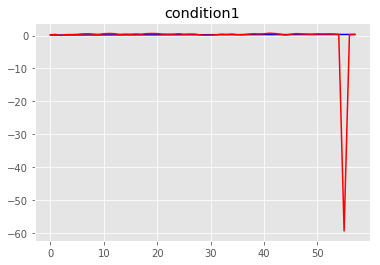

MSE condition1: 61.48299585679646
R2 condition1: -24296.256561402137


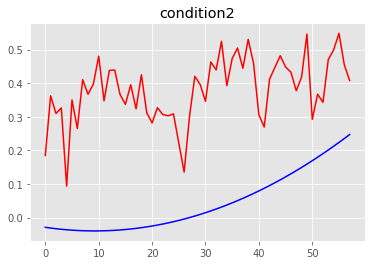

MSE condition2: 0.1237401417499835
R2 condition2: -15.321940860037376


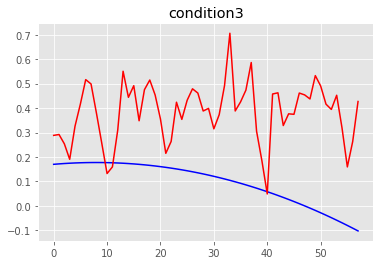

MSE condition3: 0.10489391907908806
R2 condition3: -13.481001276426541


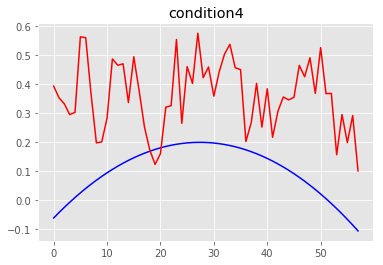

MSE condition4: 0.08456026976642968
R2 condition4: -9.814328810475596
==== the test person number # 3 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34526988e-09 4.52527169e-09 4.07010357e-09 3.92967423e-09]
Global min values from training is:  [-4.33645601e-09 -4.534

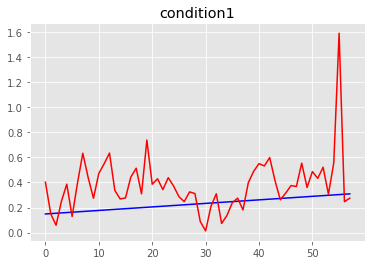

MSE condition1: 0.06942358329253501
R2 condition1: -30.278575892839324


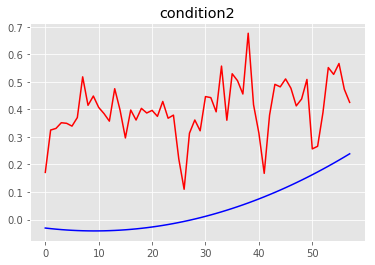

MSE condition2: 0.14220764141229647
R2 condition2: -18.740349669345775


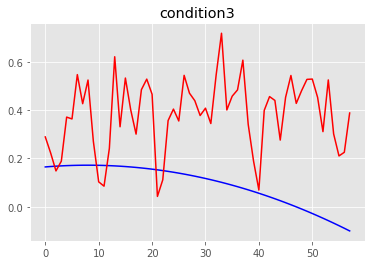

MSE condition3: 0.11440790421780041
R2 condition3: -15.647521066223401


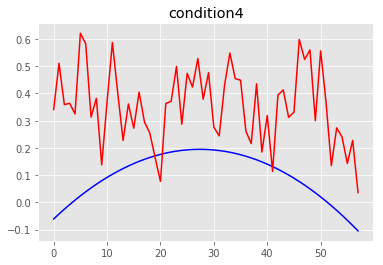

MSE condition4: 0.08816178464566744
R2 condition4: -10.794340853170242
==== the test person number # 3 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41944952e-09 4.60736072e-09 4.04886493e-09 4.01123617e-09]
Global min values from training is:  [-4.40950419e-09 -4.61

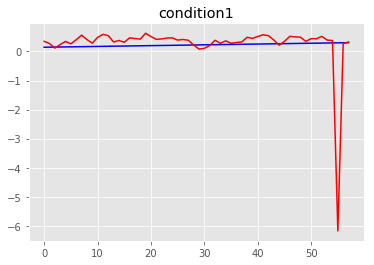

MSE condition1: 0.7637266658239216
R2 condition1: -359.29119223456655


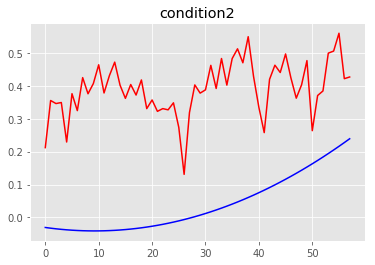

MSE condition2: 0.13315700668097136
R2 condition2: -17.42351797172708


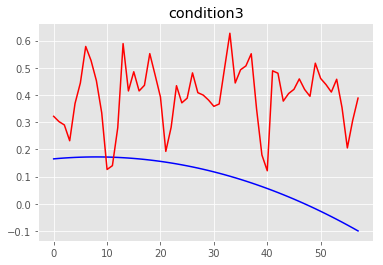

MSE condition3: 0.11193540338384621
R2 condition3: -15.326790447740766


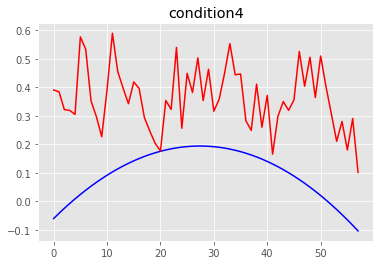

MSE condition4: 0.0847358346836556
R2 condition4: -10.443064029313518
==== the test person number # 3 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39995175e-09 4.32823803e-09 4.04192642e-09 3.96643301e-09]
Global min values from training is:  [-4.39095564e-09 -4.321

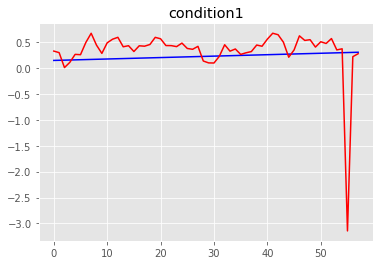

MSE condition1: 0.25533700841960877
R2 condition1: -117.74476074022488


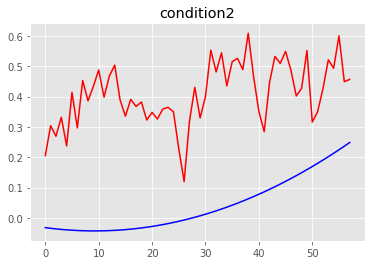

MSE condition2: 0.14601622002138606
R2 condition2: -17.72046657041491


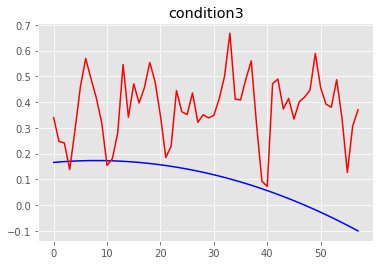

MSE condition3: 0.10356566154822346
R2 condition3: -13.98036881062432


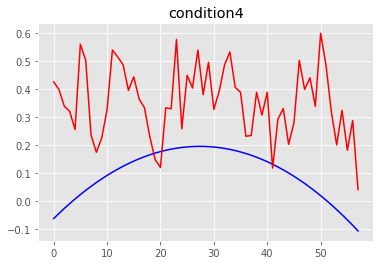

MSE condition4: 0.08459172264636478
R2 condition4: -10.145616817676391
==== the test person number # 3 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40056843e-09 4.59481271e-09 4.06358753e-09 3.98560814e-09]
Global min values from training is:  [-4.39129577e-09 -4.60

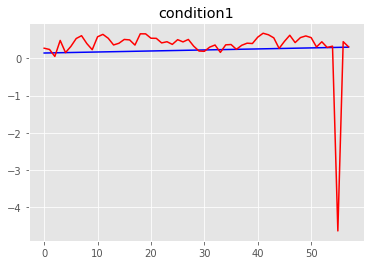

MSE condition1: 0.4819848450068377
R2 condition1: -225.439907946988


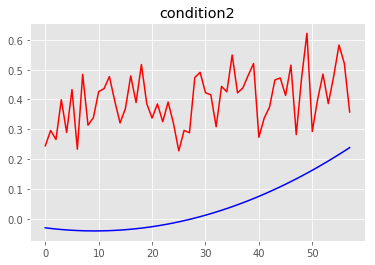

MSE condition2: 0.14030941460738267
R2 condition2: -18.51944491253177


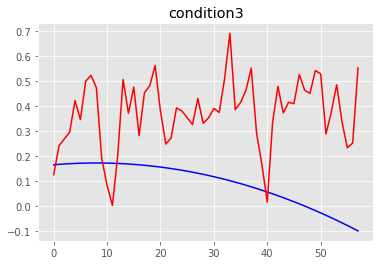

MSE condition3: 0.10735532403323368
R2 condition3: -14.68087107402914


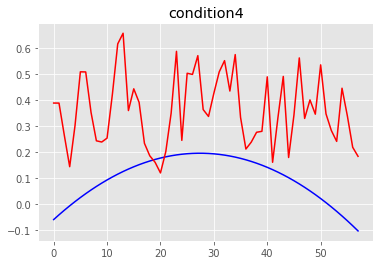

MSE condition4: 0.08965097864859814
R2 condition4: -11.03785695484992
==== the test person number # 3 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99611108e-09 4.24427876e-09 3.70775600e-09 3.59953469e-09]
Global min values from training is:  [-3.99043149e-09 -4.254

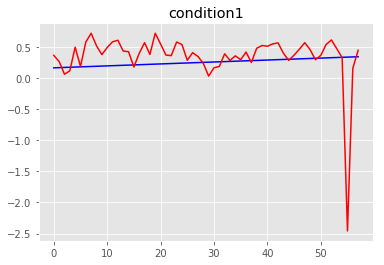

MSE condition1: 0.18263568305675243
R2 condition1: -65.4368476982111


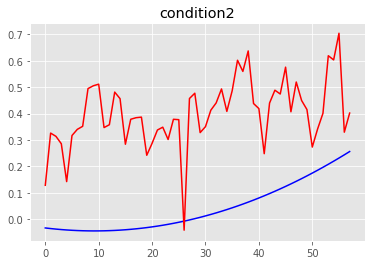

MSE condition2: 0.14439902379374883
R2 condition2: -16.372902508063863


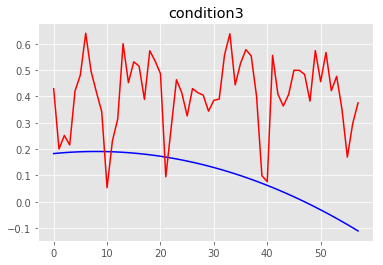

MSE condition3: 0.12154102916073997
R2 condition3: -13.40733933681008


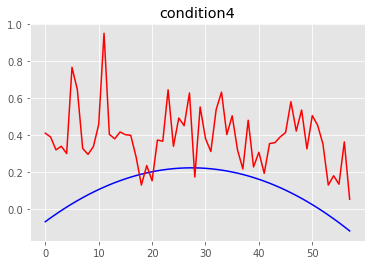

MSE condition4: 0.10475835199273964
R2 condition4: -9.804742365793604
==== the test person number # 3 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37582075e-09 4.56864955e-09 4.04525069e-09 3.87391306e-09]
Global min values from training is:  [-4.36519916e-09 -4.577

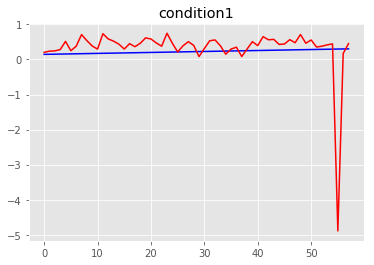

MSE condition1: 0.5289479374425073
R2 condition1: -248.24443603891822


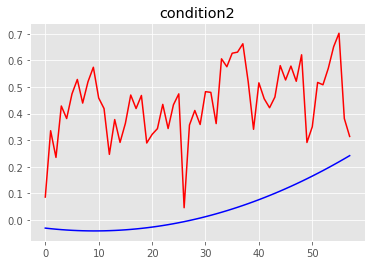

MSE condition2: 0.17771747352828715
R2 condition2: -23.10319155042944


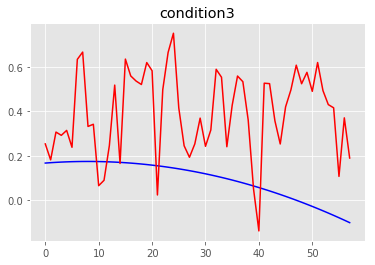

MSE condition3: 0.1321620604621935
R2 condition3: -17.861762158971494


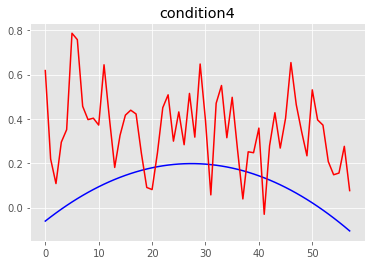

MSE condition4: 0.09920170370978916
R2 condition4: -11.902554107482533
==== the test person number # 3 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20823775e-09 4.47770552e-09 3.95879440e-09 3.81530421e-09]
Global min values from training is:  [-4.20162331e-09 -4.48

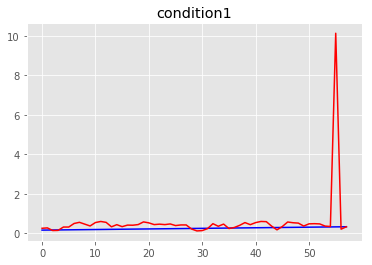

MSE condition1: 1.6970465282068994
R2 condition1: -681.4164785863395


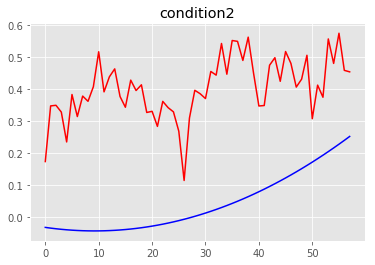

MSE condition2: 0.1403237908703223
R2 condition2: -16.512972003752406


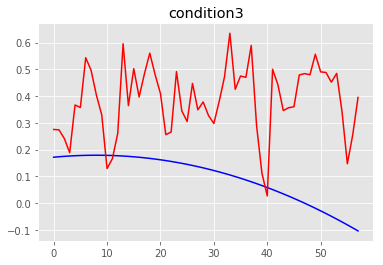

MSE condition3: 0.1077988181802969
R2 condition3: -13.553978903544177


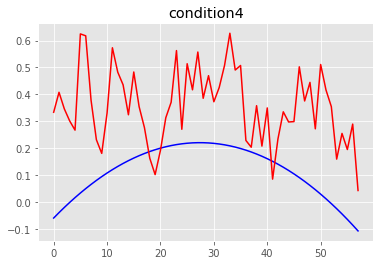

MSE condition4: 0.07970253230296717
R2 condition4: -7.890152226490466
==== the test person number # 3 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36415243e-09 4.53223722e-09 3.99598558e-09 3.91543067e-09]
Global min values from training is:  [-4.35246455e-09 -4.540

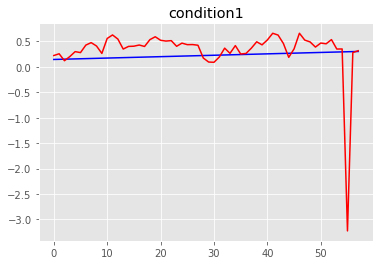

MSE condition1: 0.2631746206981634
R2 condition1: -122.0519666518374


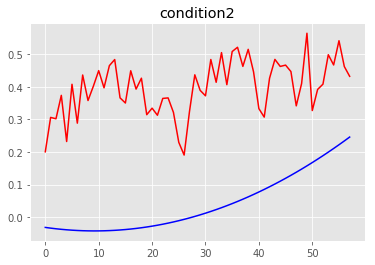

MSE condition2: 0.1367256706216751
R2 condition2: -16.885864699765367


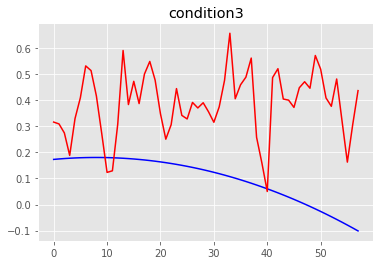

MSE condition3: 0.10631214145811117
R2 condition3: -13.51946819463246


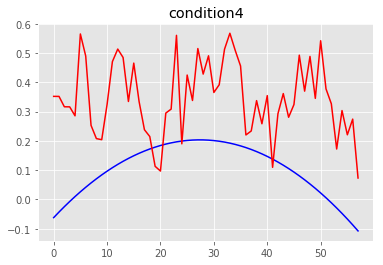

MSE condition4: 0.07782124439490683
R2 condition4: -8.667529879301261
==== the test person number # 3 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.94798369e-09 4.14286319e-09 3.74068645e-09 3.61620046e-09]
Global min values from training is:  [-3.94507138e-09 -4.156

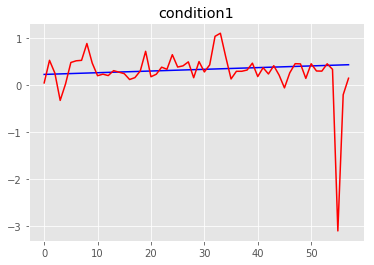

MSE condition1: 0.2788235297138682
R2 condition1: -75.03962435477744


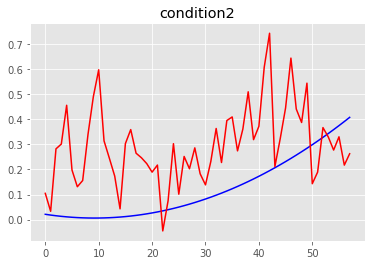

MSE condition2: 0.05786998200303388
R2 condition2: -2.9084490013692124


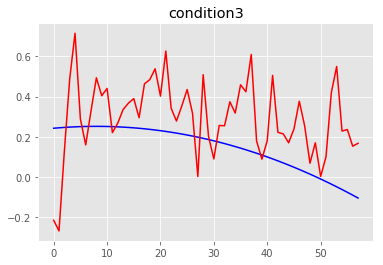

MSE condition3: 0.05944240767915376
R2 condition3: -4.063076033903797


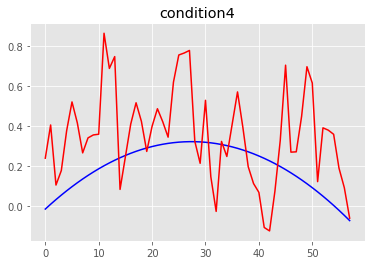

MSE condition4: 0.07955277267588937
R2 condition4: -5.126003513319587
==== the test person number # 3 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30517753e-09 4.45383519e-09 3.95546202e-09 3.90508009e-09]
Global min values from training is:  [-4.29554578e-09 -4.463

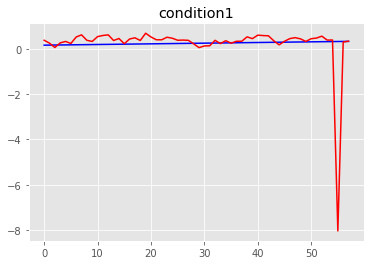

MSE condition1: 1.242562340061713
R2 condition1: -516.0668457362718


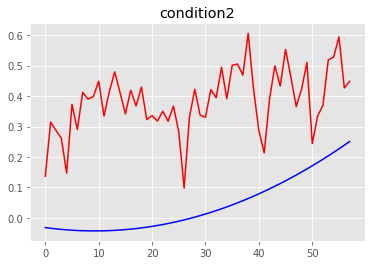

MSE condition2: 0.12890279995905385
R2 condition2: -15.237353939468711


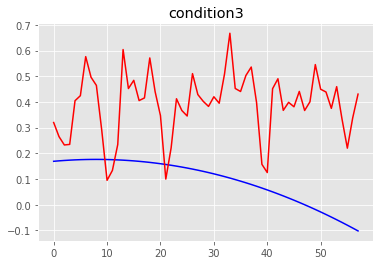

MSE condition3: 0.11014597586200923
R2 condition3: -14.33643423986524


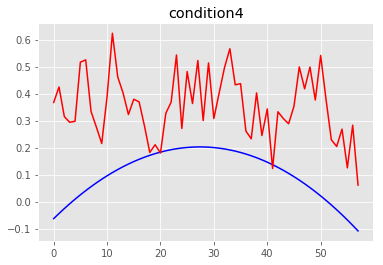

MSE condition4: 0.08000025353529829
R2 condition4: -8.91788628313261
==== the test person number # 3 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35952858e-09 4.54238128e-09 4.00218418e-09 3.97420212e-09]
Global min values from training is:  [-4.35150437e-09 -4.5540

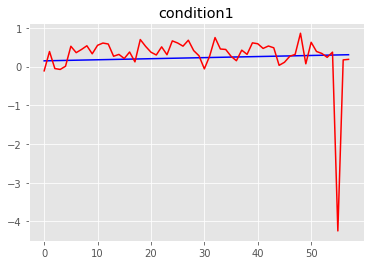

MSE condition1: 0.4229964612965102
R2 condition1: -195.53276710207592


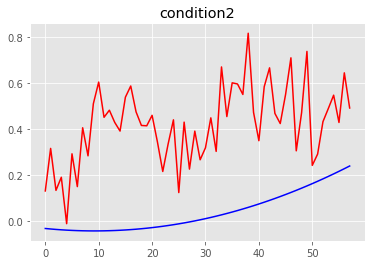

MSE condition2: 0.1717883196962689
R2 condition2: -22.52923725120682


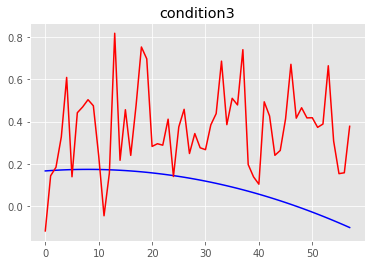

MSE condition3: 0.11931029575593823
R2 condition3: -16.074531695084655


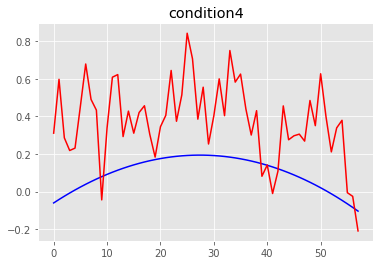

MSE condition4: 0.11215611800424793
R2 condition4: -14.126002805789728
==== the test person number # 3 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.10404413e-09 4.30401659e-09 3.67157433e-09 3.76318639e-09]
Global min values from training is:  [-4.08945127e-09 -4.31

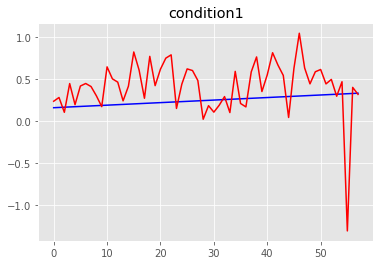

MSE condition1: 0.13118987215427713
R2 condition1: -50.450365644577445


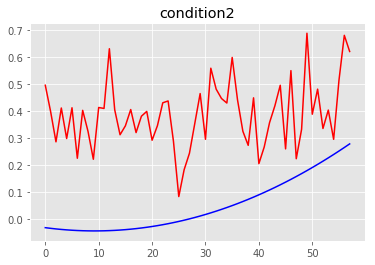

MSE condition2: 0.132678619809409
R2 condition2: -12.81728686473317


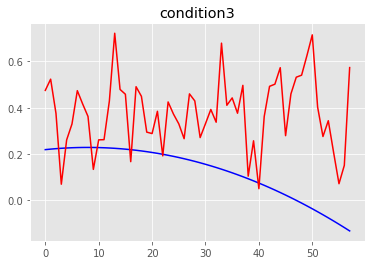

MSE condition3: 0.10118013127602118
R2 condition3: -7.4146690351359155


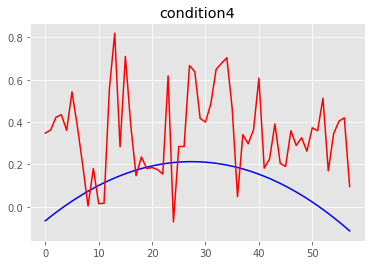

MSE condition4: 0.10002085329772188
R2 condition4: -10.18781653537848
==== the test person number # 3 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40660245e-09 4.59851420e-09 4.08731627e-09 4.02957058e-09]
Global min values from training is:  [-4.39766730e-09 -4.609

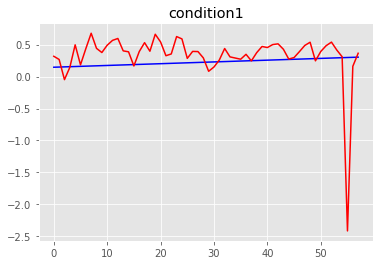

MSE condition1: 0.17391506184049504
R2 condition1: -80.20506141865643


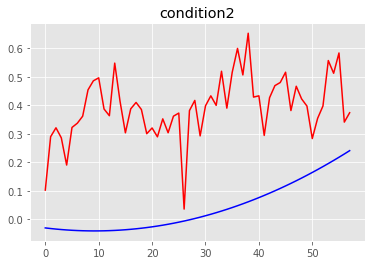

MSE condition2: 0.1386221846540278
R2 condition2: -17.943956481866092


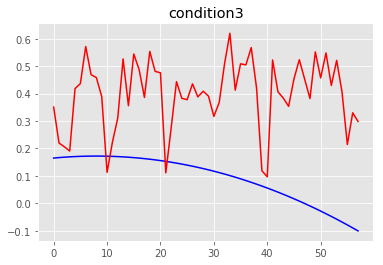

MSE condition3: 0.11704000226719409
R2 condition3: -16.005501224636173


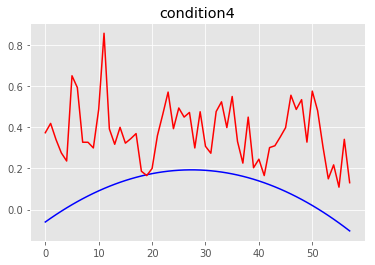

MSE condition4: 0.0989126645079391
R2 condition4: -12.454304854645084
==== the test person number # 4 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32278515e-09 4.13145862e-09 3.83463111e-09 3.83866253e-09]
Global min values from training is:  [-4.31247419e-09 -4.145

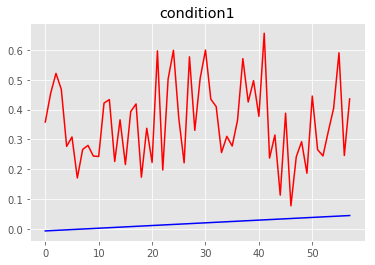

MSE condition1: 0.1326520521613966
R2 condition1: -575.4753685613464


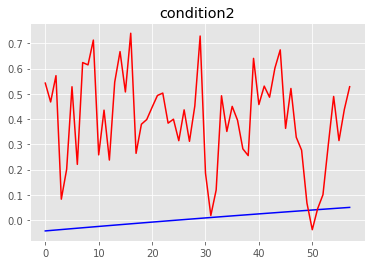

MSE condition2: 0.19265835088355315
R2 condition2: -255.8100834999331


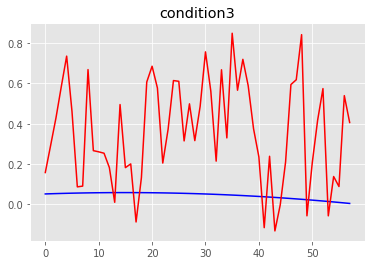

MSE condition3: 0.16573753268172095
R2 condition3: -664.4942205897781


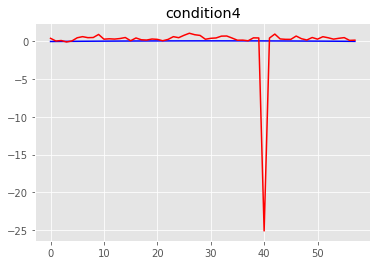

MSE condition4: 11.049976284283131
R2 condition4: -19702.48631892417
==== the test person number # 4 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37821919e-09 4.60268327e-09 3.99629017e-09 4.05375221e-09]
Global min values from training is:  [-4.36479833e-09 -4.6142

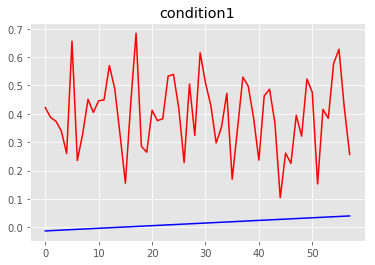

MSE condition1: 0.16335708944051242
R2 condition1: -678.7015226214185


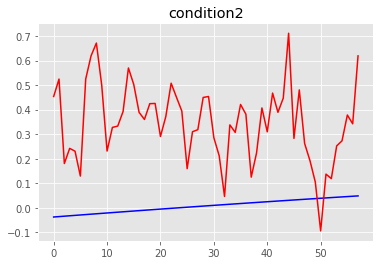

MSE condition2: 0.14312277056158884
R2 condition2: -223.2624788927281


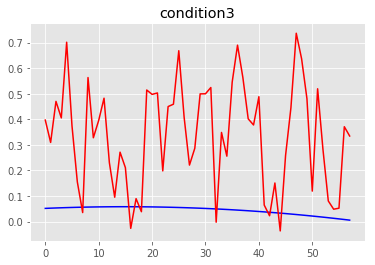

MSE condition3: 0.1262610328045241
R2 condition3: -530.825980290792


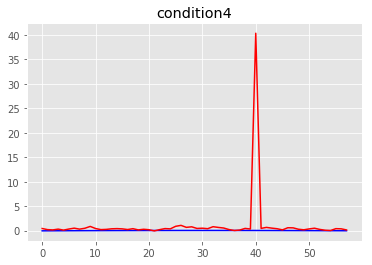

MSE condition4: 28.255777044865646
R2 condition4: -60573.5109890818
==== the test person number # 4 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148270e-09 4.64608756e-09 4.05597833e-09 4.01395501e-09]
Global min values from training is:  [-4.42027053e-09 -4.65745

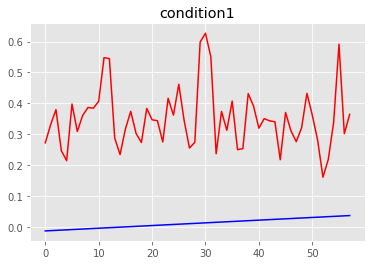

MSE condition1: 0.12492475899935082
R2 condition1: -587.7013503334869


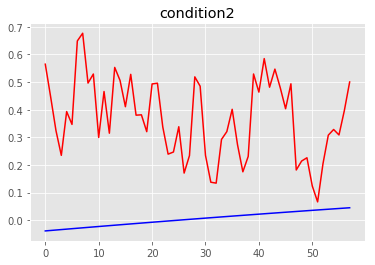

MSE condition2: 0.15645110665763487
R2 condition2: -256.74555919434823


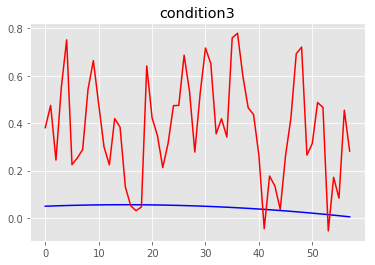

MSE condition3: 0.15843944040829394
R2 condition3: -701.8783064915559


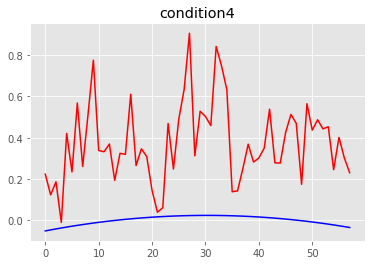

MSE condition4: 0.17577234710762474
R2 condition4: -392.85800882078985
==== the test person number # 4 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41944952e-09 4.60736072e-09 4.04886493e-09 4.01123617e-09]
Global min values from training is:  [-4.40950419e-09 -4.61

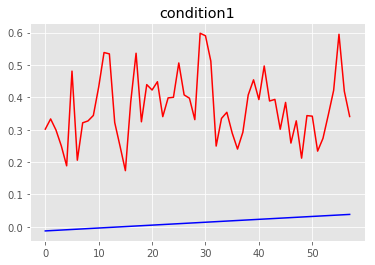

MSE condition1: 0.13763983171791153
R2 condition1: -613.3829778110377


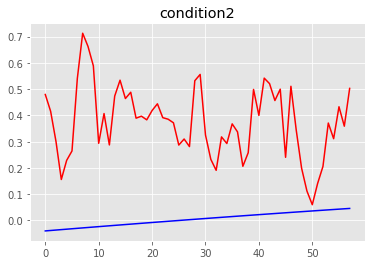

MSE condition2: 0.15717718641437403
R2 condition2: -247.84303381729652


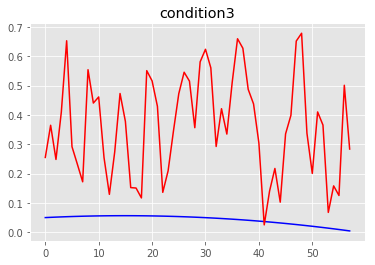

MSE condition3: 0.12999061148912058
R2 condition3: -560.7545580312147


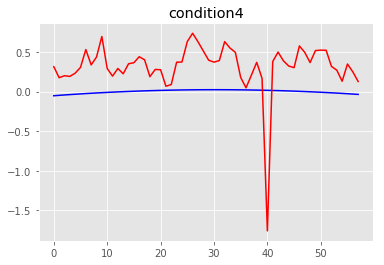

MSE condition4: 0.20238261703386198
R2 condition4: -440.5436392062423
==== the test person number # 4 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48616457e-09 4.44905391e-09 4.02780118e-09 4.05071379e-09]
Global min values from training is:  [-4.47477016e-09 -4.443

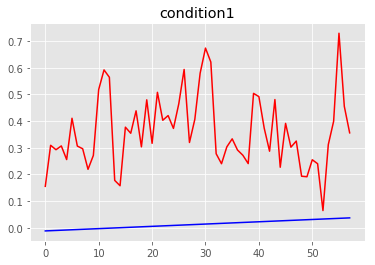

MSE condition1: 0.1408327608007653
R2 condition1: -682.9799966892035


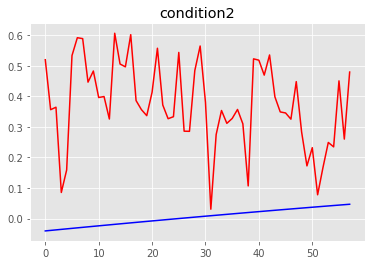

MSE condition2: 0.1582918485320335
R2 condition2: -240.20780968442241


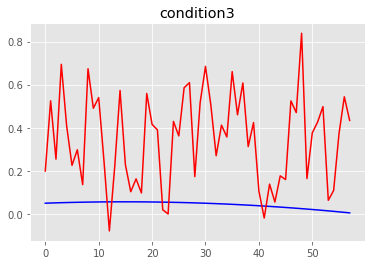

MSE condition3: 0.13786324479600873
R2 condition3: -607.016409443974


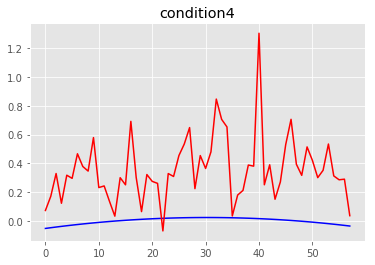

MSE condition4: 0.17438753585842234
R2 condition4: -383.9517179069559
==== the test person number # 4 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48678125e-09 4.71562859e-09 4.04946229e-09 4.06988892e-09]
Global min values from training is:  [-4.47511029e-09 -4.728

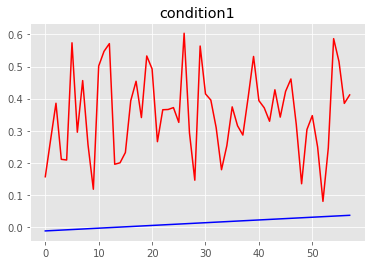

MSE condition1: 0.13281265589763572
R2 condition1: -650.30711945712


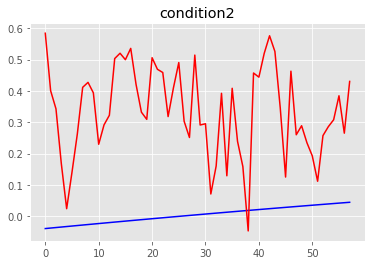

MSE condition2: 0.1315017656868192
R2 condition2: -216.10795115423218


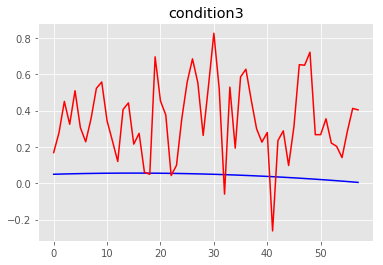

MSE condition3: 0.13626815133109094
R2 condition3: -605.7933422312051


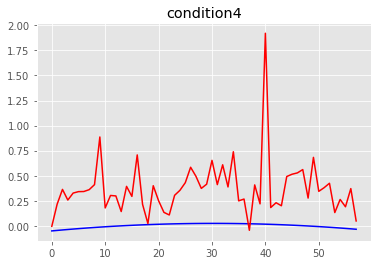

MSE condition4: 0.2115088521973766
R2 condition4: -474.65265220363483
==== the test person number # 4 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.08232390e-09 4.36509463e-09 3.69363077e-09 3.68381547e-09]
Global min values from training is:  [-4.07424601e-09 -4.376

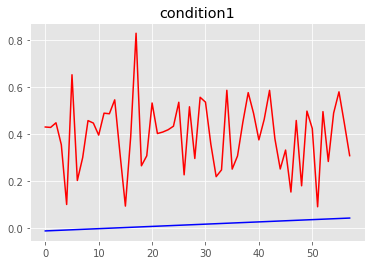

MSE condition1: 0.16905974627001663
R2 condition1: -649.3547855515679


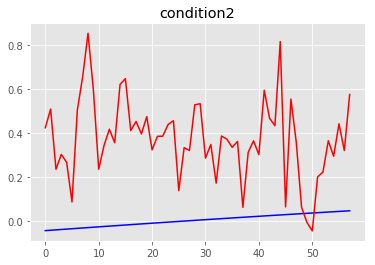

MSE condition2: 0.171832223997212
R2 condition2: -245.01259087379188


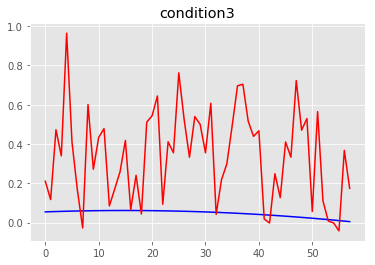

MSE condition3: 0.13983300295160261
R2 condition3: -505.9021483077589


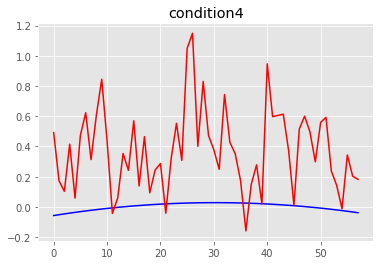

MSE condition4: 0.214096303856615
R2 condition4: -370.69364725070443
==== the test person number # 4 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46203357e-09 4.68946543e-09 4.03112545e-09 3.95819384e-09]
Global min values from training is:  [-4.44901368e-09 -4.7003

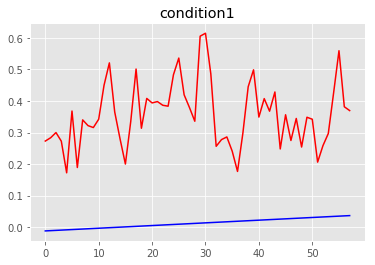

MSE condition1: 0.12875638038648696
R2 condition1: -632.207680734922


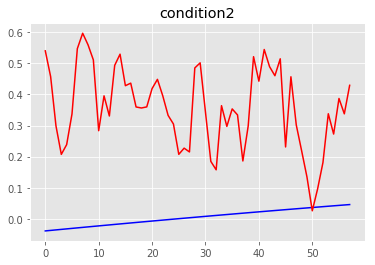

MSE condition2: 0.1436620542483764
R2 condition2: -230.33994371444837


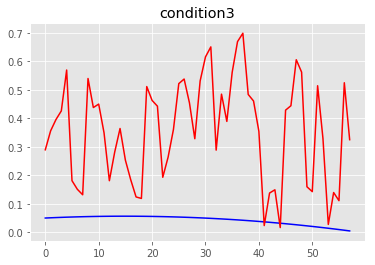

MSE condition3: 0.12987839805678023
R2 condition3: -564.2698078157093


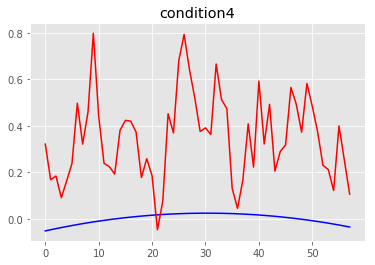

MSE condition4: 0.1526786359487776
R2 condition4: -331.77521018030757
==== the test person number # 4 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29445057e-09 4.59852139e-09 3.94466917e-09 3.89958499e-09]
Global min values from training is:  [-4.28543784e-09 -4.609

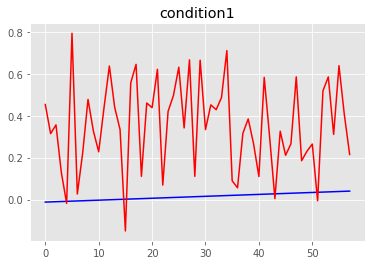

MSE condition1: 0.1607409343189804
R2 condition1: -678.9374877925522


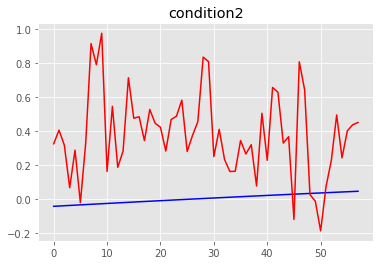

MSE condition2: 0.20445743729757296
R2 condition2: -302.43798275769257


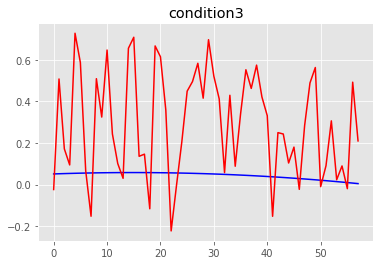

MSE condition3: 0.12398053279301587
R2 condition3: -509.87543327359685


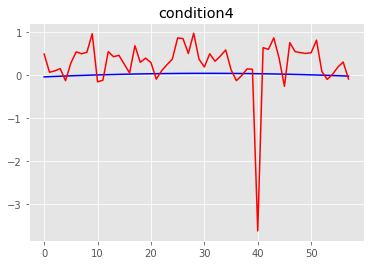

MSE condition4: 0.4224104651722032
R2 condition4: -790.8523028863567
==== the test person number # 4 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.45036525e-09 4.65305309e-09 3.98186034e-09 3.99971145e-09]
Global min values from training is:  [-4.43627908e-09 -4.6632

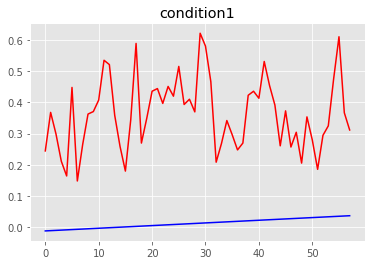

MSE condition1: 0.13654601402320382
R2 condition1: -665.5763386300566


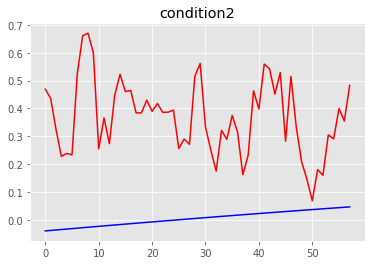

MSE condition2: 0.15252940163835926
R2 condition2: -236.06479310201797


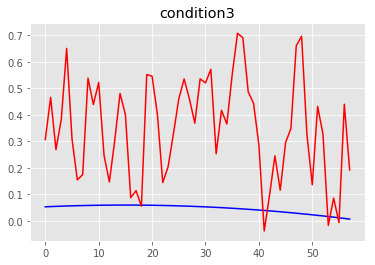

MSE condition3: 0.12682429648368393
R2 condition3: -527.555534187993


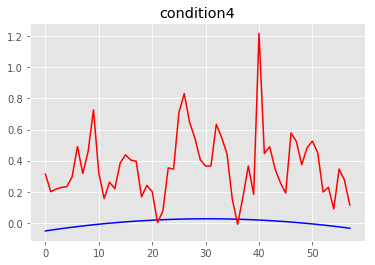

MSE condition4: 0.1711293209209934
R2 condition4: -355.5525059635788
==== the test person number # 4 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03419651e-09 4.26367906e-09 3.72656121e-09 3.70048123e-09]
Global min values from training is:  [-4.02888591e-09 -4.2787

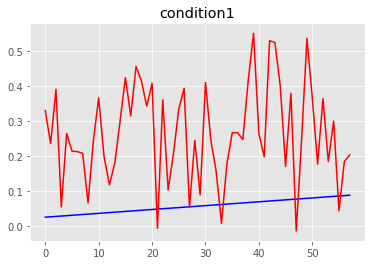

MSE condition1: 0.06269916293534396
R2 condition1: -182.86909162043443


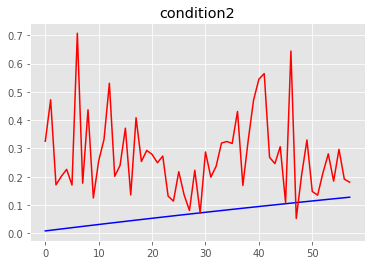

MSE condition2: 0.06256205432759396
R2 condition2: -49.936419695594374


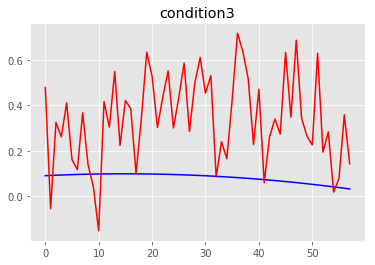

MSE condition3: 0.10352241641473664
R2 condition3: -270.1779650876033


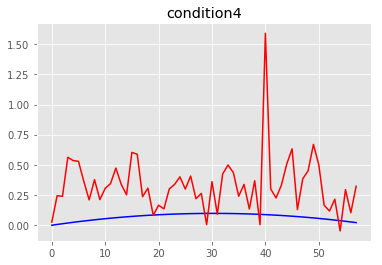

MSE condition4: 0.1245582614509059
R2 condition4: -161.48595329581488
==== the test person number # 4 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39139035e-09 4.57465106e-09 3.94133679e-09 3.98936087e-09]
Global min values from training is:  [-4.37936031e-09 -4.586

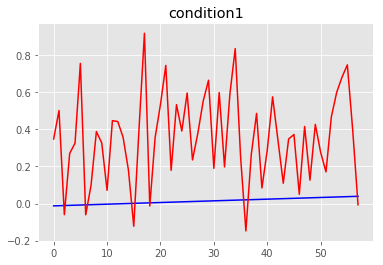

MSE condition1: 0.17428424116552638
R2 condition1: -760.5743106767052


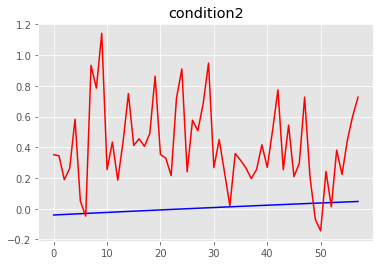

MSE condition2: 0.23954066442844787
R2 condition2: -357.75183352659593


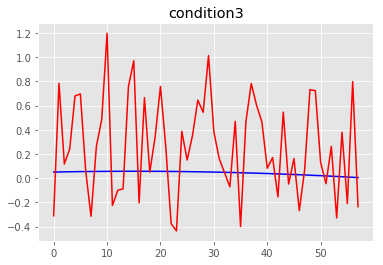

MSE condition3: 0.20744772312515689
R2 condition3: -880.1755785209668


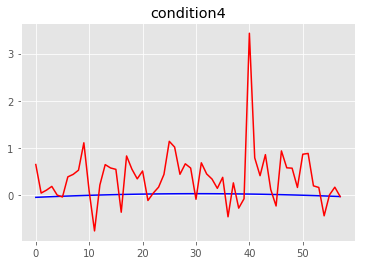

MSE condition4: 0.46053364827113036
R2 condition4: -956.6070730523423
==== the test person number # 4 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44574140e-09 4.66319716e-09 3.98805894e-09 4.05848289e-09]
Global min values from training is:  [-4.43531889e-09 -4.676

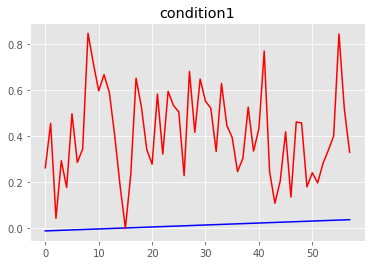

MSE condition1: 0.19545866940643292
R2 condition1: -947.4437315480056


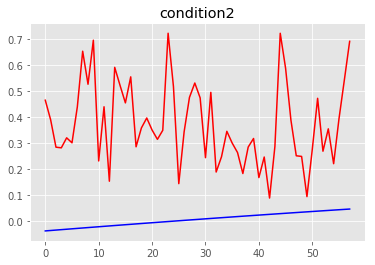

MSE condition2: 0.1639835424580993
R2 condition2: -265.6248913481317


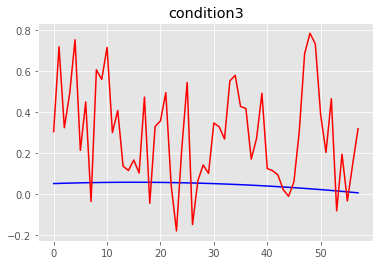

MSE condition3: 0.12117988084893937
R2 condition3: -527.8441164349066


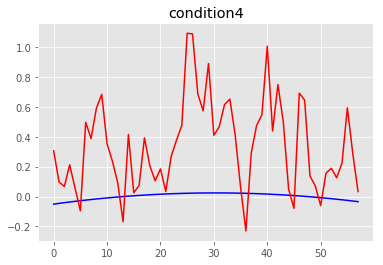

MSE condition4: 0.20152748743946522
R2 condition4: -454.16486357664957
==== the test person number # 4 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19025695e-09 4.42483247e-09 3.65744909e-09 3.84746717e-09]
Global min values from training is:  [-4.17326579e-09 -4.43

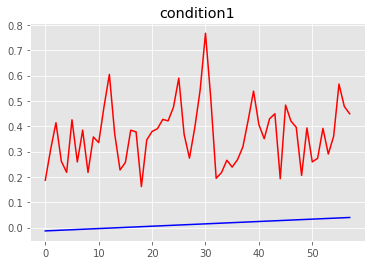

MSE condition1: 0.14011945909000537
R2 condition1: -577.8117583540313


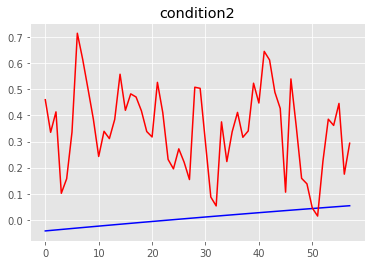

MSE condition2: 0.14387504854118602
R2 condition2: -177.81837235286875


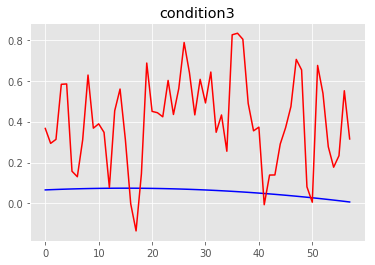

MSE condition3: 0.1701729085448273
R2 condition3: -434.43870652408225


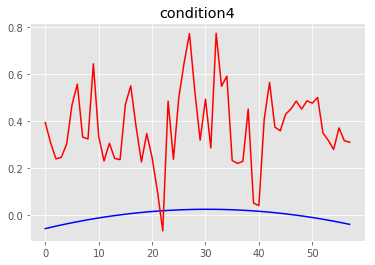

MSE condition4: 0.1670668917285617
R2 condition4: -313.0464029947285
==== the test person number # 4 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.49281527e-09 4.71933007e-09 4.07319103e-09 4.11385136e-09]
Global min values from training is:  [-4.48148183e-09 -4.7319

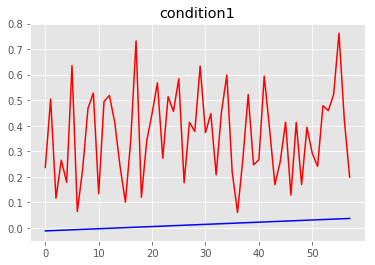

MSE condition1: 0.1524993895754801
R2 condition1: -742.4796406236355


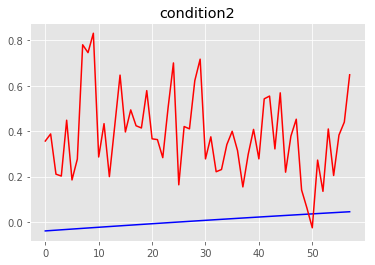

MSE condition2: 0.1796980046574703
R2 condition2: -290.5313050791087


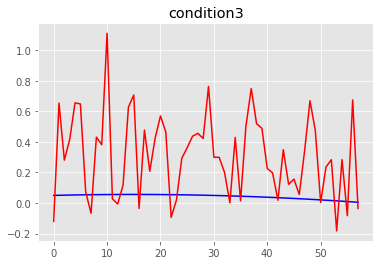

MSE condition3: 0.14431504813209356
R2 condition3: -638.2917490524146


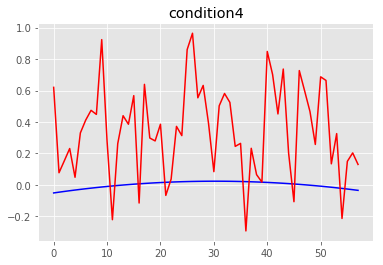

MSE condition4: 0.20289280866727477
R2 condition4: -461.1078524546897
==== the test person number # 5 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30328738e-09 3.85233593e-09 3.82769260e-09 3.79385937e-09]
Global min values from training is:  [-4.29392564e-09 -3.848

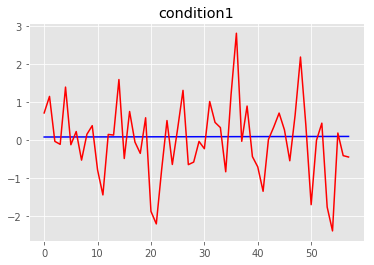

MSE condition1: 0.9817179347043917
R2 condition1: -50874.99312340851


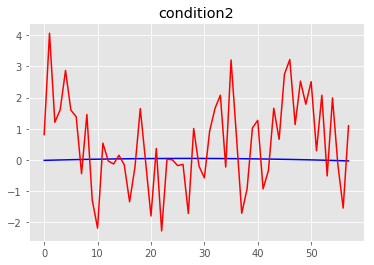

MSE condition2: 2.3666320500332034
R2 condition2: -4747.499898291695


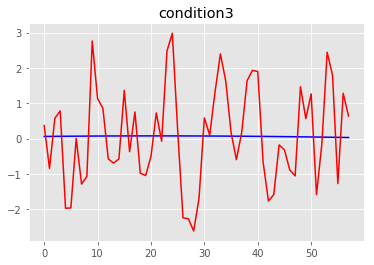

MSE condition3: 1.9259050899027854
R2 condition3: -12042.827628993397


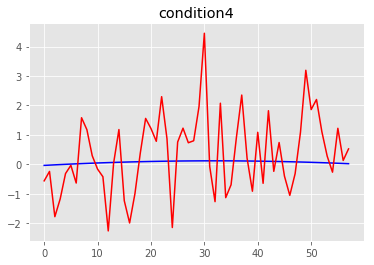

MSE condition4: 1.816026346837027
R2 condition4: -1025.9960575969183
==== the test person number # 5 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35872142e-09 4.32356058e-09 3.98935166e-09 4.00894906e-09]
Global min values from training is:  [-4.34624978e-09 -4.3168

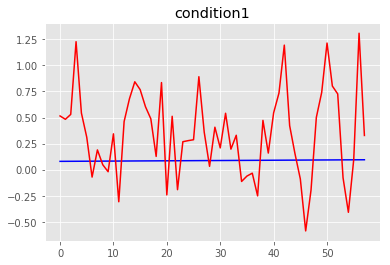

MSE condition1: 0.2410811023025879
R2 condition1: -11957.145570312188


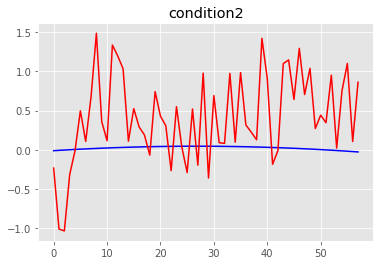

MSE condition2: 0.46700444870022934
R2 condition2: -1107.742631867537


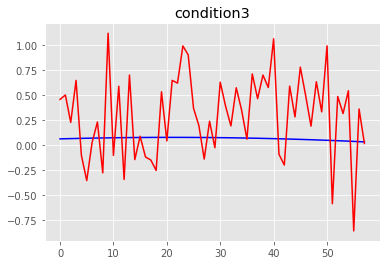

MSE condition3: 0.22458566977908345
R2 condition3: -1472.593197796648


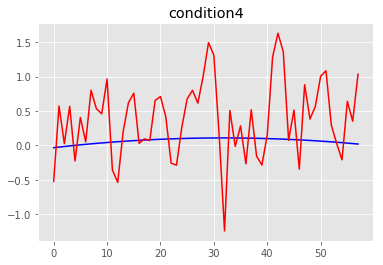

MSE condition4: 0.4070032292368396
R2 condition4: -276.39199729246417
==== the test person number # 5 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41198493e-09 4.36696487e-09 4.04903982e-09 3.96915186e-09]
Global min values from training is:  [-4.40172199e-09 -4.360

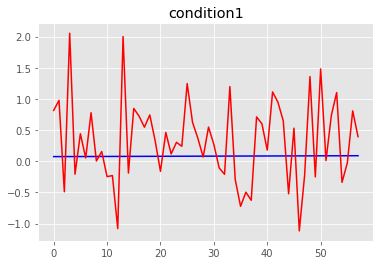

MSE condition1: 0.5076751461752085
R2 condition1: -28544.83212097725


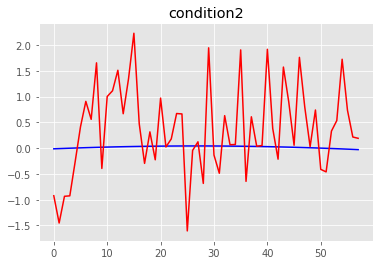

MSE condition2: 0.8570480361432513
R2 condition2: -2142.4747601885065


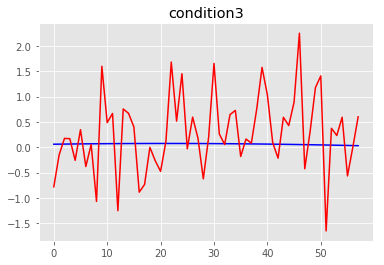

MSE condition3: 0.6214497163174617
R2 condition3: -4294.486793435109


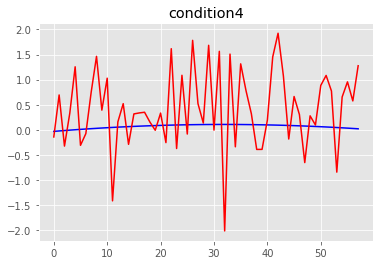

MSE condition4: 0.7367126330580152
R2 condition4: -524.0953270815673
==== the test person number # 5 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39995175e-09 4.32823803e-09 4.04192642e-09 3.96643301e-09]
Global min values from training is:  [-4.39095564e-09 -4.3212

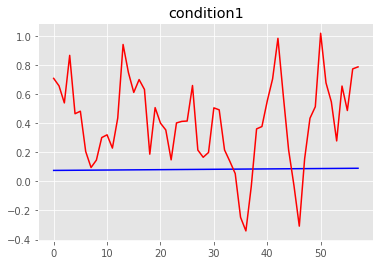

MSE condition1: 0.19549850942306582
R2 condition1: -10407.351532684383


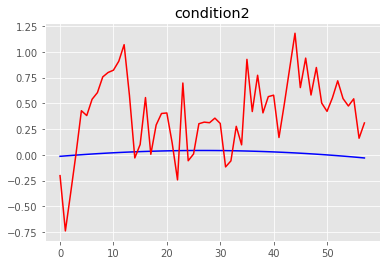

MSE condition2: 0.2810792862528743
R2 condition2: -673.5302447873955


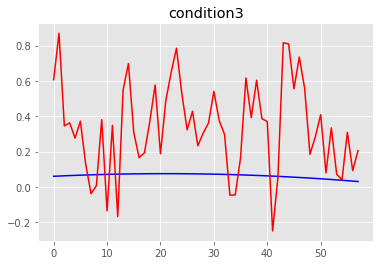

MSE condition3: 0.13911732412641803
R2 condition3: -935.6084603517822


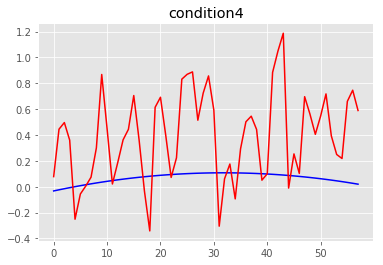

MSE condition4: 0.2200801855316741
R2 condition4: -151.68262334593112
==== the test person number # 5 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48616457e-09 4.44905391e-09 4.02780118e-09 4.05071379e-09]
Global min values from training is:  [-4.47477016e-09 -4.443

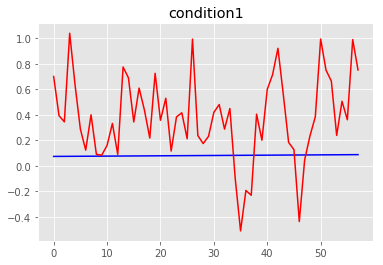

MSE condition1: 0.19776709153500704
R2 condition1: -11620.232607473787


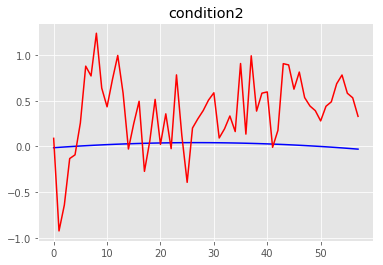

MSE condition2: 0.291507734674012
R2 condition2: -725.6285814380798


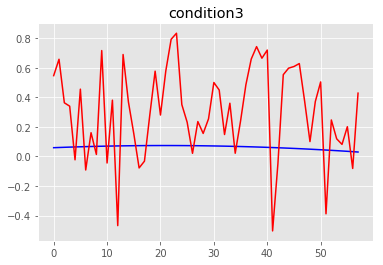

MSE condition3: 0.1507712599296062
R2 condition3: -1043.6101446123573


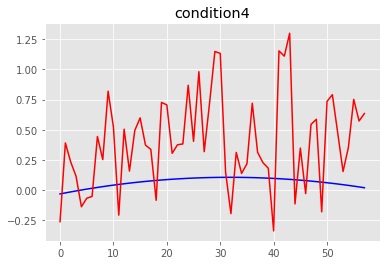

MSE condition4: 0.2574327510925355
R2 condition4: -184.20889501819929
==== the test person number # 5 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46728348e-09 4.43650590e-09 4.04252378e-09 4.02508576e-09]
Global min values from training is:  [-4.45656174e-09 -4.430

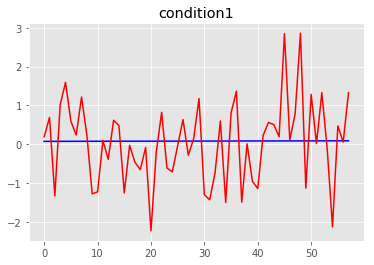

MSE condition1: 1.1221373530309804
R2 condition1: -65677.36834264219


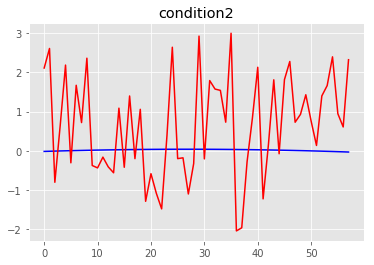

MSE condition2: 2.0437973321894125
R2 condition2: -5121.925610221106


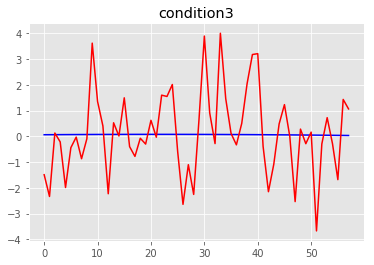

MSE condition3: 2.624026377842152
R2 condition3: -18204.848168736728


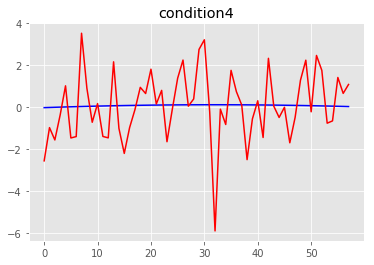

MSE condition4: 2.6394446691906337
R2 condition4: -1887.1828596738706
==== the test person number # 5 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06282612e-09 4.08597195e-09 3.68669226e-09 3.63901231e-09]
Global min values from training is:  [-4.05569747e-09 -4.079

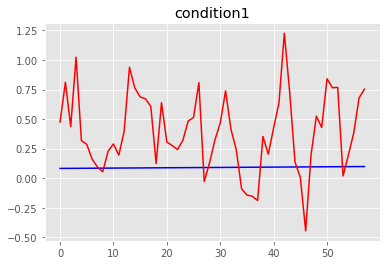

MSE condition1: 0.19863720100895615
R2 condition1: -9103.006981025057


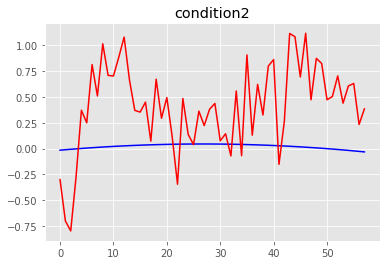

MSE condition2: 0.32874608216520035
R2 condition2: -709.5724416387812


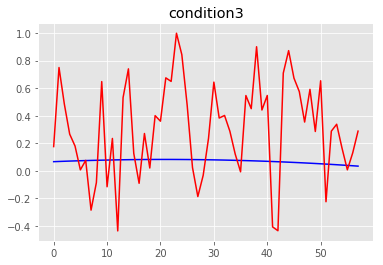

MSE condition3: 0.1735117850352335
R2 condition3: -978.1558612179563


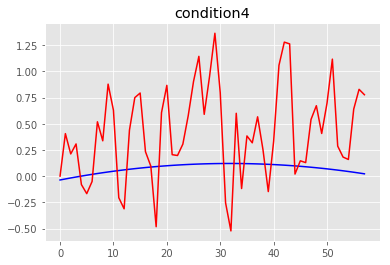

MSE condition4: 0.30888115329508353
R2 condition4: -169.00898694049513
==== the test person number # 5 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44253580e-09 4.41034274e-09 4.02418694e-09 3.91339069e-09]
Global min values from training is:  [-4.43046513e-09 -4.40

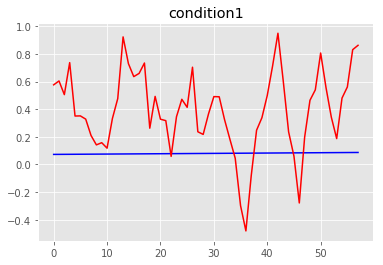

MSE condition1: 0.18117877980407912
R2 condition1: -10633.648558951732


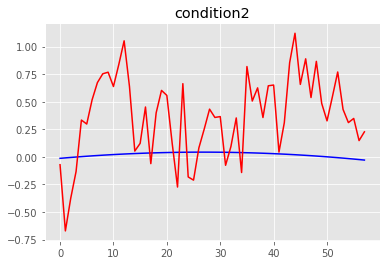

MSE condition2: 0.26110288970341206
R2 condition2: -636.7374104051586


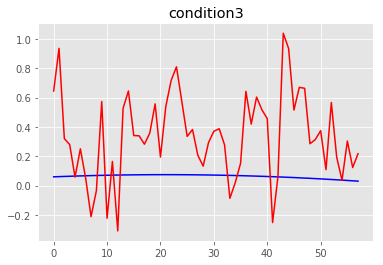

MSE condition3: 0.16145098717577913
R2 condition3: -1093.7493482698615


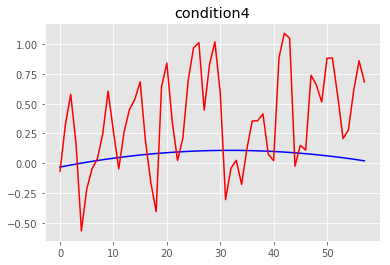

MSE condition4: 0.2458426923735036
R2 condition4: -169.38562066774446
==== the test person number # 5 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27495280e-09 4.31939870e-09 3.93773066e-09 3.85478184e-09]
Global min values from training is:  [-4.26688929e-09 -4.311

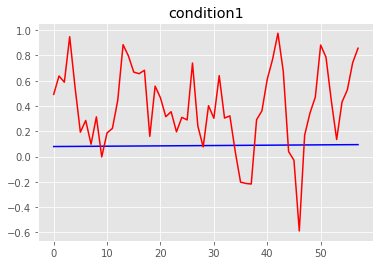

MSE condition1: 0.19391169050576307
R2 condition1: -9778.574637508105


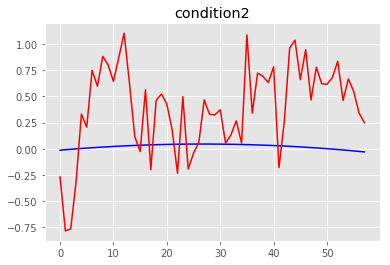

MSE condition2: 0.3170024704630155
R2 condition2: -710.308046647017


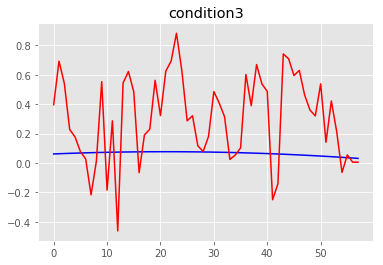

MSE condition3: 0.1416452868730346
R2 condition3: -908.1140143650299


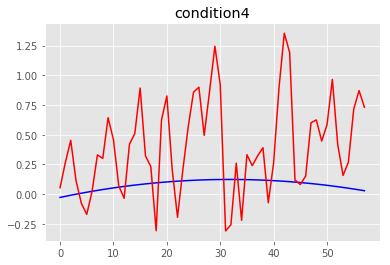

MSE condition4: 0.25488452336062184
R2 condition4: -150.63951843143175
==== the test person number # 5 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43086748e-09 4.37393040e-09 3.97492183e-09 3.95490830e-09]
Global min values from training is:  [-4.41773053e-09 -4.36

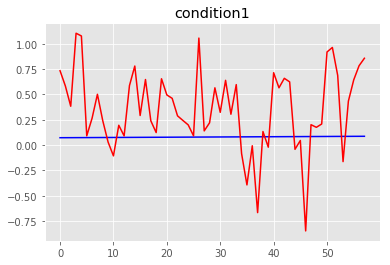

MSE condition1: 0.23061991310847793
R2 condition1: -13435.43629415334


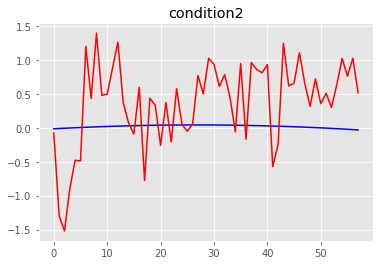

MSE condition2: 0.5125597215732484
R2 condition2: -1205.6505818350117


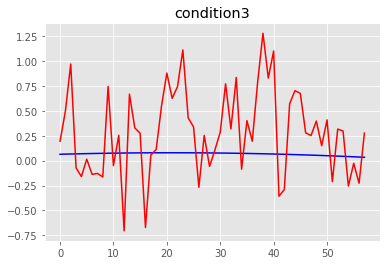

MSE condition3: 0.23136472233402502
R2 condition3: -1500.9693075376936


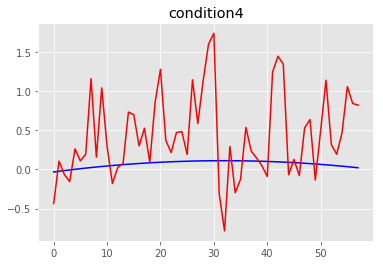

MSE condition4: 0.4152575212113431
R2 condition4: -273.9628445803218
==== the test person number # 5 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01469873e-09 3.98455637e-09 3.71962270e-09 3.65567808e-09]
Global min values from training is:  [-4.01033736e-09 -3.9813

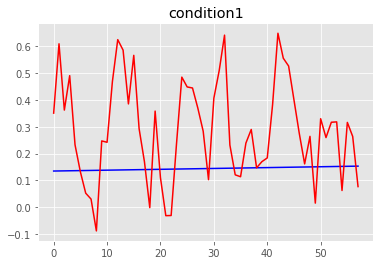

MSE condition1: 0.05575766085922209
R2 condition1: -1942.7296428037948


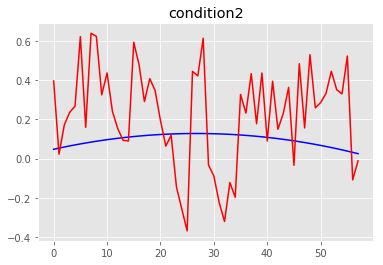

MSE condition2: 0.08331149637213761
R2 condition2: -98.68961547172398


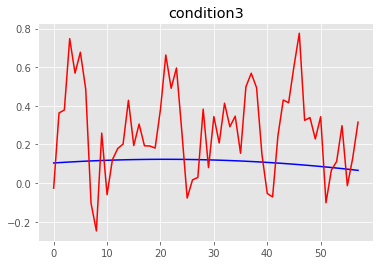

MSE condition3: 0.07909402822456525
R2 condition3: -321.0117163961773


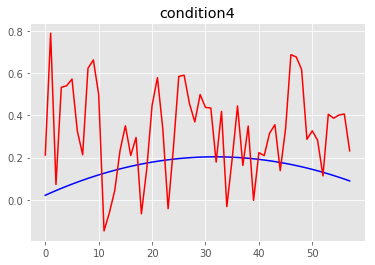

MSE condition4: 0.08159036046751869
R2 condition4: -32.59911812816943
==== the test person number # 5 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37189258e-09 4.29552838e-09 3.93439827e-09 3.94455772e-09]
Global min values from training is:  [-4.36081176e-09 -4.289

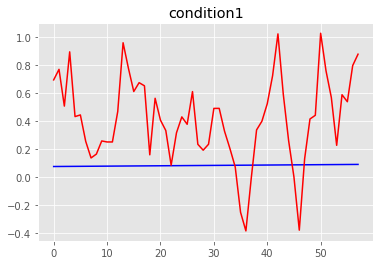

MSE condition1: 0.2018170870885928
R2 condition1: -10515.92663596254


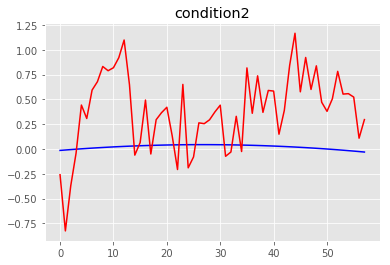

MSE condition2: 0.28175000652791815
R2 condition2: -637.2121046062346


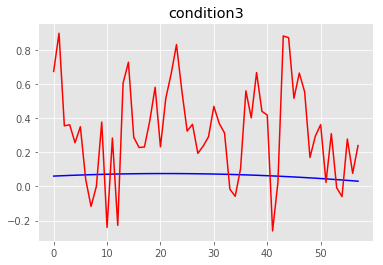

MSE condition3: 0.14563842173306388
R2 condition3: -962.6970964181389


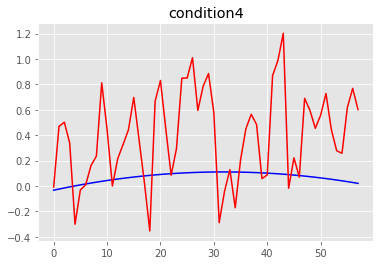

MSE condition4: 0.22967269638644422
R2 condition4: -150.76852184952529
==== the test person number # 5 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42624362e-09 4.38407447e-09 3.98112043e-09 4.01367974e-09]
Global min values from training is:  [-4.41677034e-09 -4.37

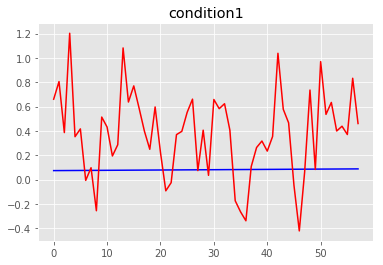

MSE condition1: 0.20922343021832315
R2 condition1: -12115.171298347039


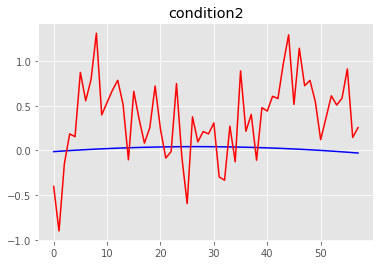

MSE condition2: 0.3125392916093716
R2 condition2: -770.0591072862561


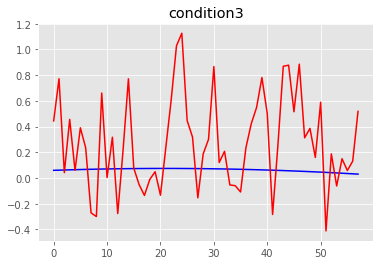

MSE condition3: 0.17563433114601268
R2 condition3: -1193.1712204866749


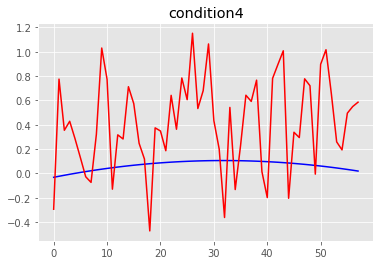

MSE condition4: 0.26503180315248864
R2 condition4: -189.42562114604445
==== the test person number # 5 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17075917e-09 4.14570978e-09 3.65051058e-09 3.80266402e-09]
Global min values from training is:  [-4.15471724e-09 -4.14

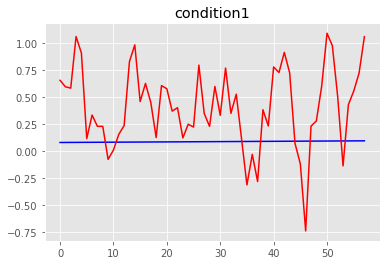

MSE condition1: 0.24304411931126582
R2 condition1: -11966.984240975626


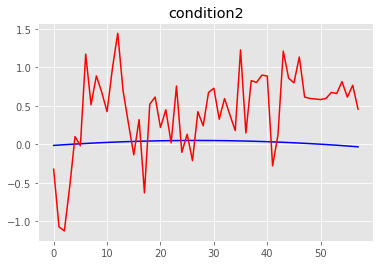

MSE condition2: 0.4376200355708492
R2 condition2: -815.2260227903782


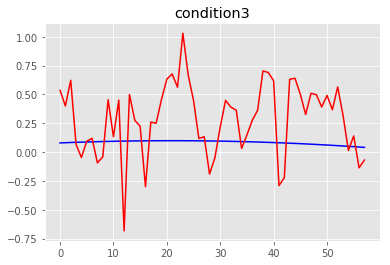

MSE condition3: 0.1386293642699502
R2 condition3: -550.2450568035787


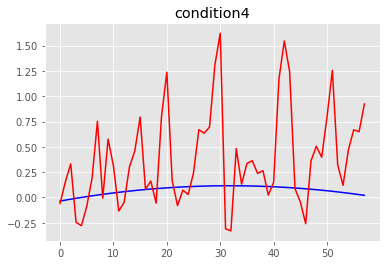

MSE condition4: 0.3114585503512465
R2 condition4: -184.81427383414527
==== the test person number # 5 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47331750e-09 4.44020738e-09 4.06625252e-09 4.06904821e-09]
Global min values from training is:  [-4.46293328e-09 -4.434

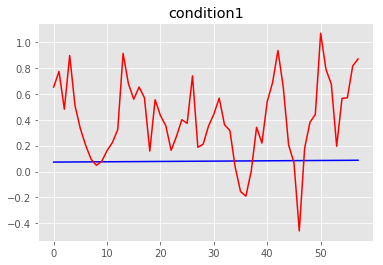

MSE condition1: 0.19683899885560474
R2 condition1: -11452.14175277347


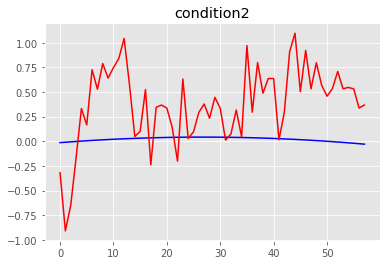

MSE condition2: 0.2817453953447824
R2 condition2: -692.4971118882546


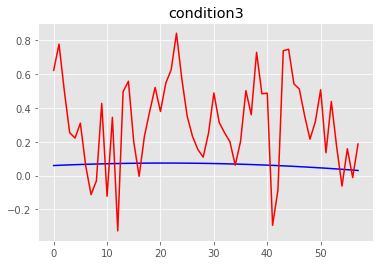

MSE condition3: 0.12955801040430373
R2 condition3: -893.2083178394037


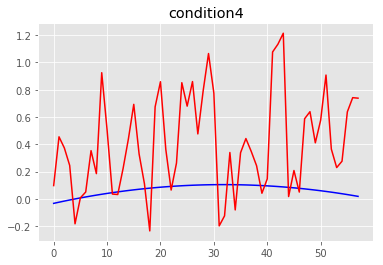

MSE condition4: 0.24147202560697445
R2 condition4: -173.97690621976992
==== the test person number # 6 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30390406e-09 4.11891061e-09 3.84935371e-09 3.81303450e-09]
Global min values from training is:  [-4.29426577e-09 -4.13

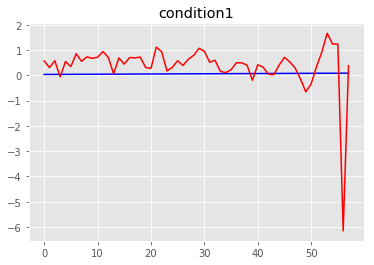

MSE condition1: 1.0217840060151335
R2 condition1: -4568.950077672428


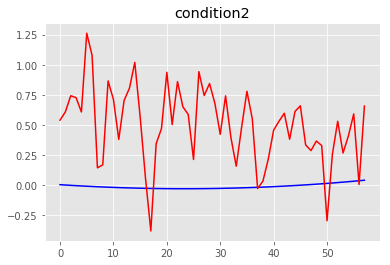

MSE condition2: 0.3652306252820275
R2 condition2: -1021.1904329186243


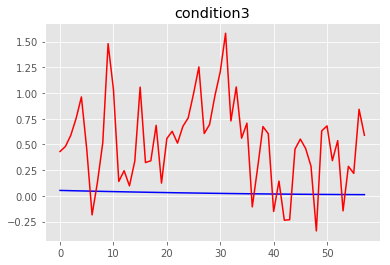

MSE condition3: 0.40667779081556915
R2 condition3: -2714.019600859004


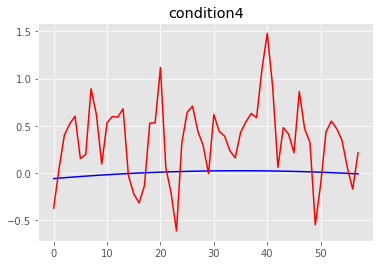

MSE condition4: 0.27771157106933725
R2 condition4: -545.5595306345615
==== the test person number # 6 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35933810e-09 4.59013526e-09 4.01101277e-09 4.02812418e-09]
Global min values from training is:  [-4.34658991e-09 -4.601

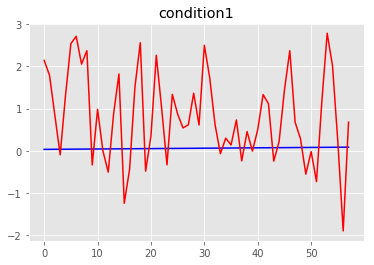

MSE condition1: 1.6778177521567272
R2 condition1: -7183.070014994072


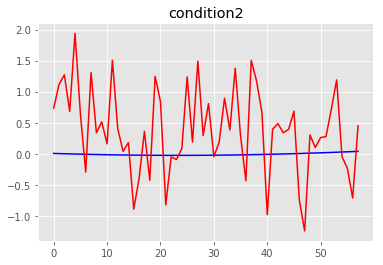

MSE condition2: 0.6256117455866107
R2 condition2: -2056.2766075719924


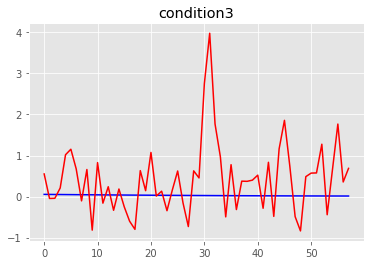

MSE condition3: 0.8926576258911347
R2 condition3: -6250.283488368443


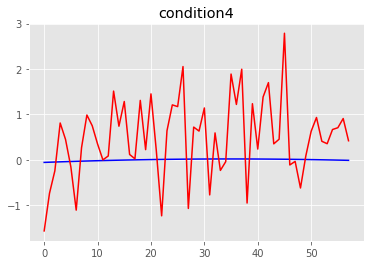

MSE condition4: 0.9715907265632084
R2 condition4: -2299.2214778735715
==== the test person number # 6 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41260161e-09 4.63353955e-09 4.07070093e-09 3.98832699e-09]
Global min values from training is:  [-4.40206211e-09 -4.644

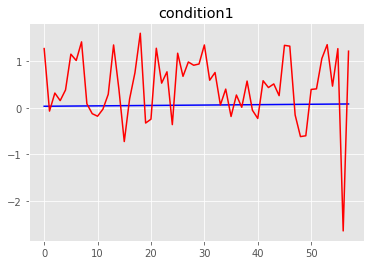

MSE condition1: 0.6703187189677402
R2 condition1: -3250.5149799713845


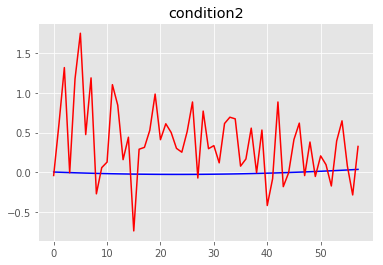

MSE condition2: 0.3514624187222064
R2 condition2: -1213.9892360232004


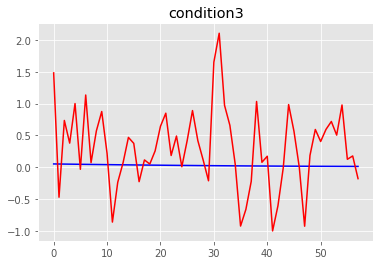

MSE condition3: 0.4607282505225392
R2 condition3: -3397.0507075802184


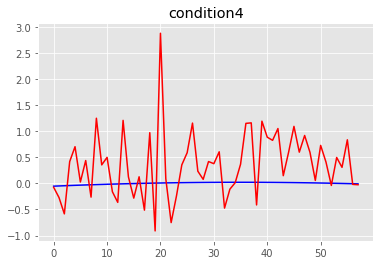

MSE condition4: 0.5208649093084163
R2 condition4: -1288.0586468628328
==== the test person number # 6 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40056843e-09 4.59481271e-09 4.06358753e-09 3.98560814e-09]
Global min values from training is:  [-4.39129577e-09 -4.605

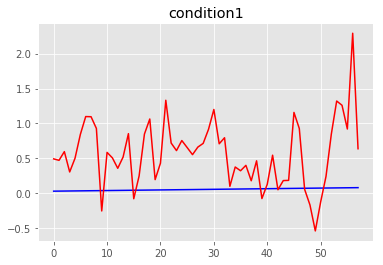

MSE condition1: 0.4848501746784611
R2 condition1: -2226.4727680968444


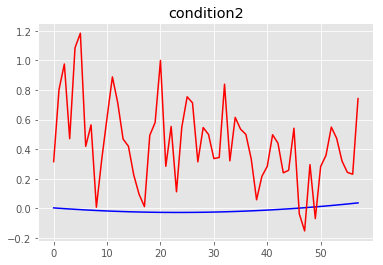

MSE condition2: 0.28468048383089817
R2 condition2: -944.8479155175852


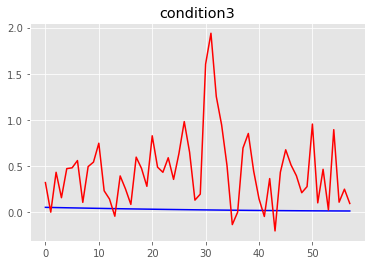

MSE condition3: 0.32973903804283516
R2 condition3: -2368.087704213693


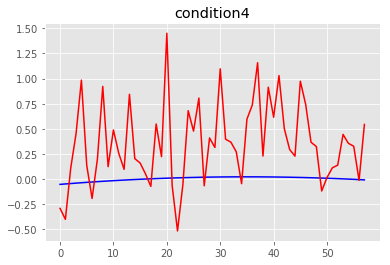

MSE condition4: 0.28556941739986014
R2 condition4: -687.0779475619285
==== the test person number # 6 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48678125e-09 4.71562859e-09 4.04946229e-09 4.06988892e-09]
Global min values from training is:  [-4.47511029e-09 -4.728

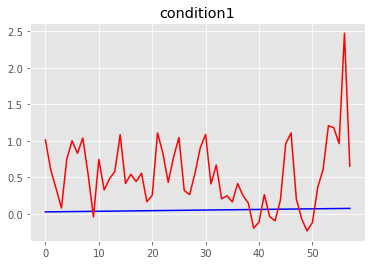

MSE condition1: 0.4493349227183538
R2 condition1: -2276.311541627101


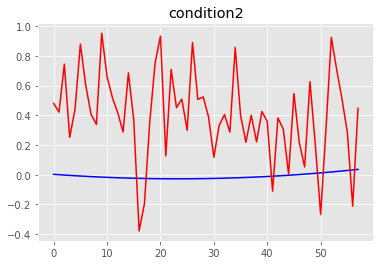

MSE condition2: 0.25777697040121
R2 condition2: -887.2675290959482


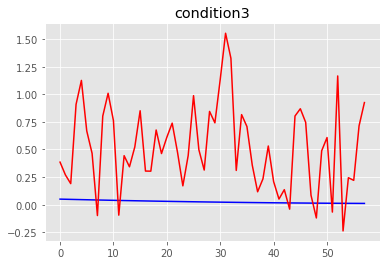

MSE condition3: 0.38934188742593606
R2 condition3: -2877.3293068128287


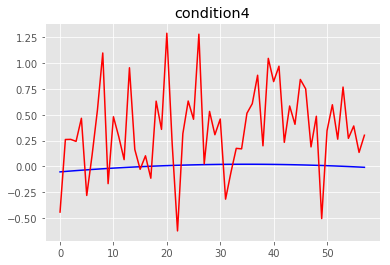

MSE condition4: 0.2926829567831898
R2 condition4: -730.0808348942551
==== the test person number # 6 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46728348e-09 4.43650590e-09 4.04252378e-09 4.02508576e-09]
Global min values from training is:  [-4.45656174e-09 -4.4307

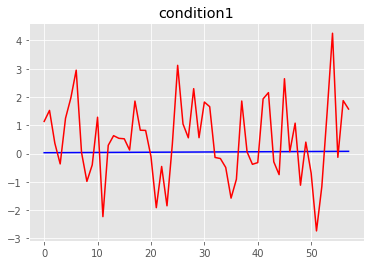

MSE condition1: 2.0758119138157807
R2 condition1: -10376.955066298153


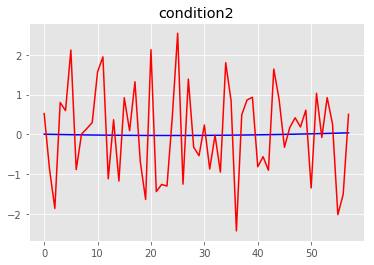

MSE condition2: 1.3131948250747076
R2 condition2: -4198.865004015651


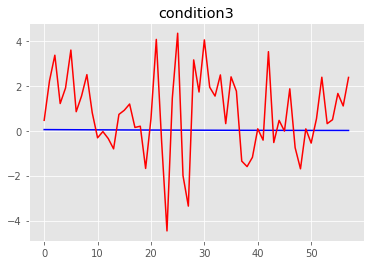

MSE condition3: 3.690905136707374
R2 condition3: -27061.607536671756


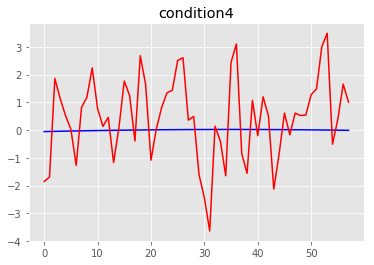

MSE condition4: 2.379253903473713
R2 condition4: -5799.583040508059
==== the test person number # 6 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06344281e-09 4.35254662e-09 3.70835337e-09 3.65818744e-09]
Global min values from training is:  [-4.05603759e-09 -4.36374

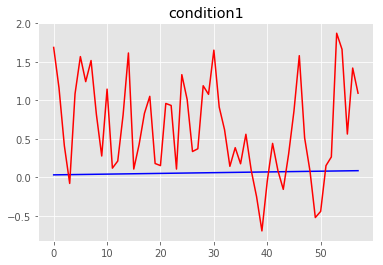

MSE condition1: 0.7210648632322303
R2 condition1: -2853.0098628987794


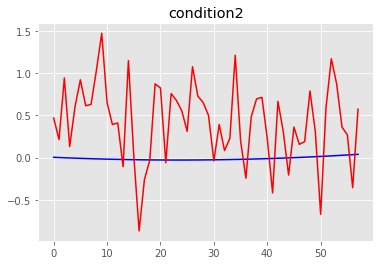

MSE condition2: 0.404783781832967
R2 condition2: -1215.53789016804


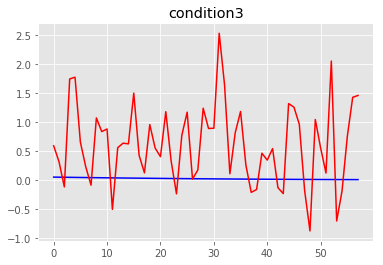

MSE condition3: 0.8205335707116388
R2 condition3: -4944.876367691913


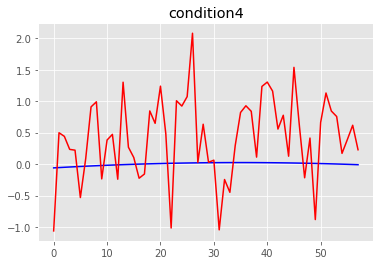

MSE condition4: 0.5841929429202274
R2 condition4: -1118.3272070215664
==== the test person number # 6 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44315248e-09 4.67691742e-09 4.04584805e-09 3.93256581e-09]
Global min values from training is:  [-4.43080526e-09 -4.687

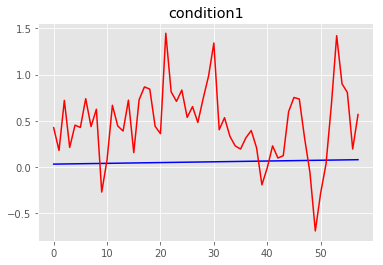

MSE condition1: 0.32791789277500333
R2 condition1: -1659.111903982033


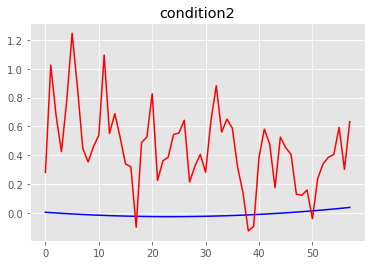

MSE condition2: 0.28842811300737226
R2 condition2: -973.6613814645837


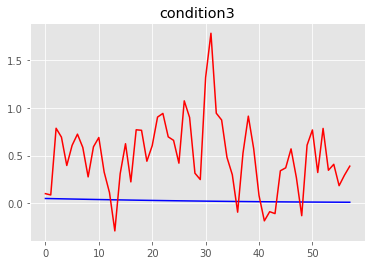

MSE condition3: 0.3547492630068835
R2 condition3: -2565.931911440767


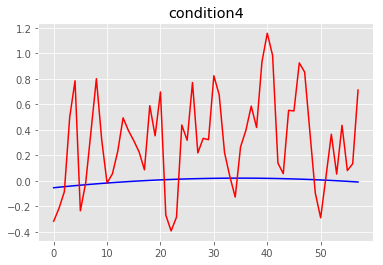

MSE condition4: 0.22703104507814856
R2 condition4: -545.4900235291668
==== the test person number # 6 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27556948e-09 4.58597338e-09 3.95939177e-09 3.87395696e-09]
Global min values from training is:  [-4.26722942e-09 -4.596

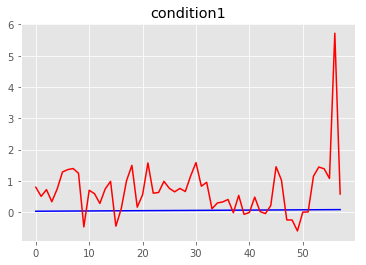

MSE condition1: 1.152632601831398
R2 condition1: -5016.5788510319435


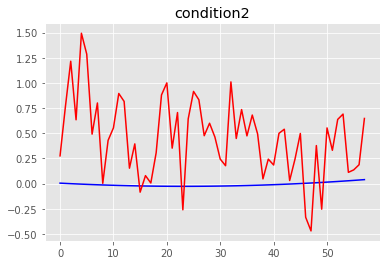

MSE condition2: 0.3699711963987439
R2 condition2: -1151.4985312778222


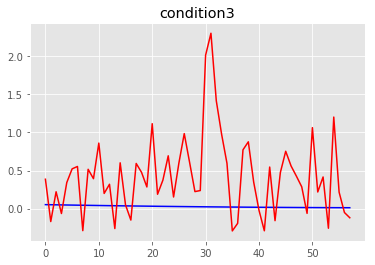

MSE condition3: 0.4290617383346493
R2 condition3: -2938.491630863024


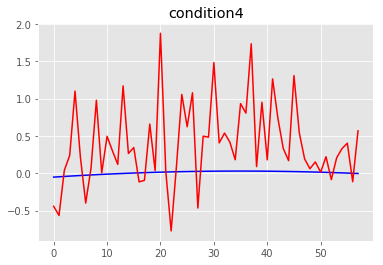

MSE condition4: 0.43795438232758543
R2 condition4: -905.2918440733351
==== the test person number # 6 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148416e-09 4.64050508e-09 3.99658294e-09 3.97408342e-09]
Global min values from training is:  [-4.41807066e-09 -4.650

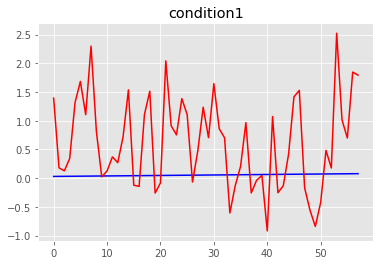

MSE condition1: 0.9659264665397467
R2 condition1: -4853.040908691939


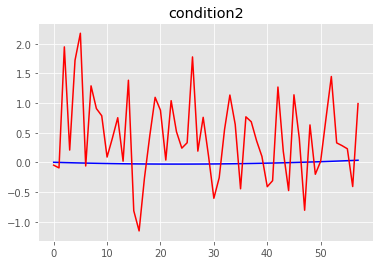

MSE condition2: 0.6894610192806729
R2 condition2: -2247.9139100232733


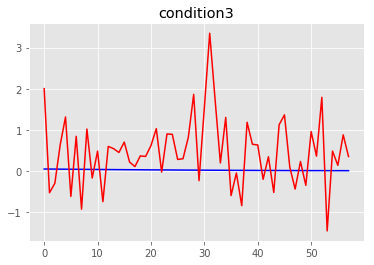

MSE condition3: 0.8817705180855387
R2 condition3: -6108.857837525317


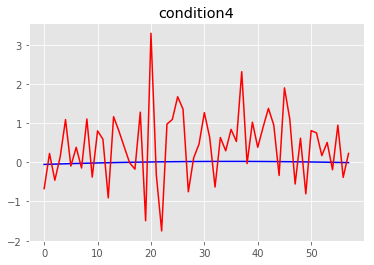

MSE condition4: 0.9529873516703676
R2 condition4: -2191.5718857999473
==== the test person number # 6 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01531542e-09 4.25113105e-09 3.74128381e-09 3.67485321e-09]
Global min values from training is:  [-4.01067749e-09 -4.265

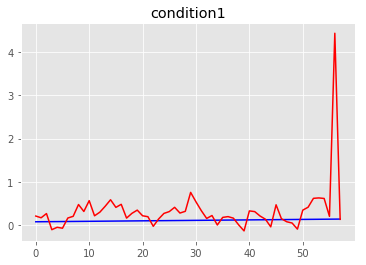

MSE condition1: 0.37773105517573563
R2 condition1: -1137.9879393072051


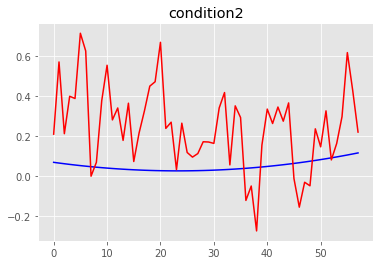

MSE condition2: 0.07978212966508111
R2 condition2: -135.61067172380075


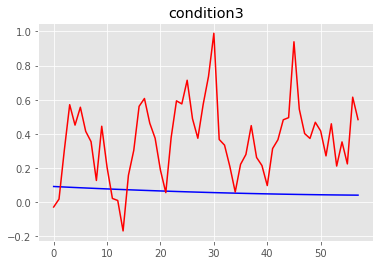

MSE condition3: 0.14568488150289194
R2 condition3: -633.7240829480243


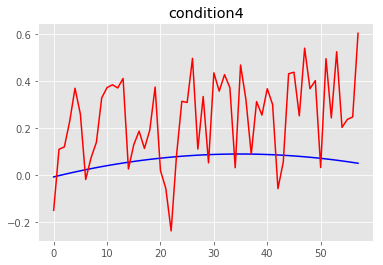

MSE condition4: 0.06467645484741816
R2 condition4: -92.02209547816355
==== the test person number # 6 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37250926e-09 4.56210305e-09 3.95605939e-09 3.96373285e-09]
Global min values from training is:  [-4.36115189e-09 -4.573

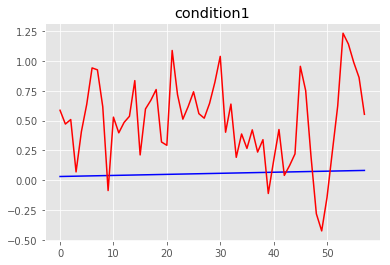

MSE condition1: 0.3103722003089127
R2 condition1: -1394.8140186785388


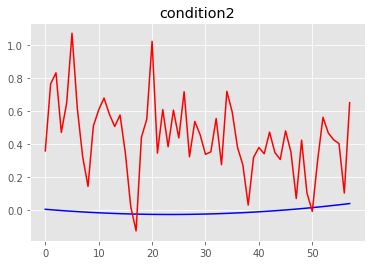

MSE condition2: 0.25521188449677734
R2 condition2: -801.250722064487


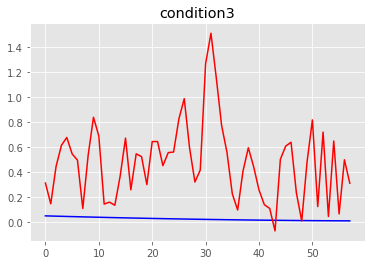

MSE condition3: 0.29809168954204884
R2 condition3: -2104.159977731387


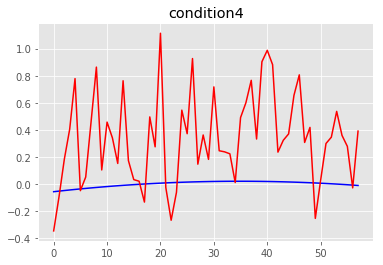

MSE condition4: 0.22238791186566653
R2 condition4: -509.6251912551225
==== the test person number # 6 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42686031e-09 4.65064915e-09 4.00278154e-09 4.03285487e-09]
Global min values from training is:  [-4.41711047e-09 -4.663

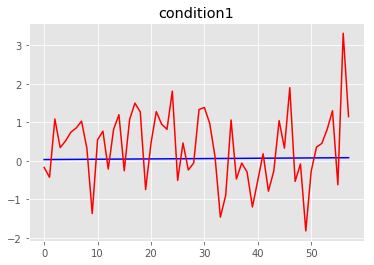

MSE condition1: 0.9536326059693129
R2 condition1: -4762.443760303697


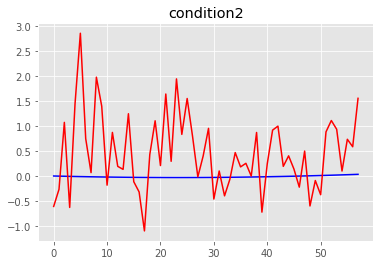

MSE condition2: 0.8042052437610668
R2 condition2: -2742.870659439561


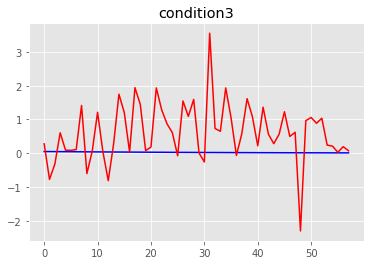

MSE condition3: 1.1004205554480777
R2 condition3: -7983.155799388337


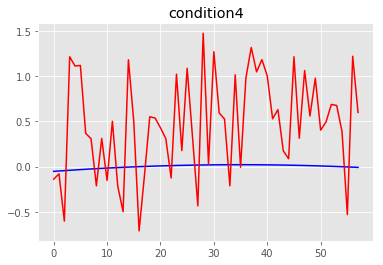

MSE condition4: 0.5283183188269619
R2 condition4: -1316.94795676006
==== the test person number # 6 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17137586e-09 4.41228446e-09 3.67217169e-09 3.82183914e-09]
Global min values from training is:  [-4.15505737e-09 -4.42643

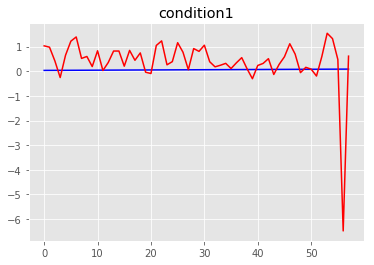

MSE condition1: 1.143097664327575
R2 condition1: -4858.1577425383275


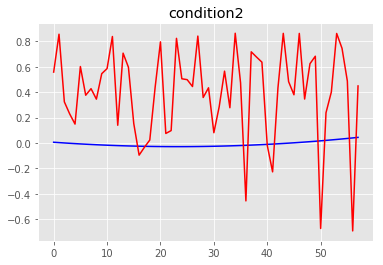

MSE condition2: 0.2937882664723859
R2 condition2: -765.8199683580989


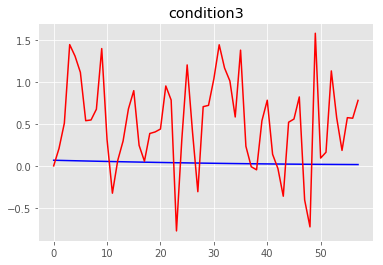

MSE condition3: 0.5084311007220592
R2 condition3: -2162.85670121153


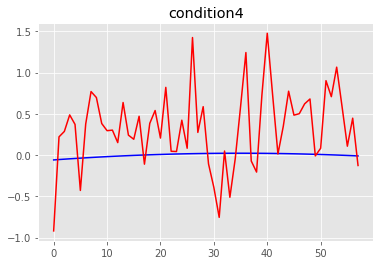

MSE condition4: 0.32296902336444167
R2 condition4: -669.189569161632
==== the test person number # 6 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47393418e-09 4.70678206e-09 4.08791363e-09 4.08822333e-09]
Global min values from training is:  [-4.46327341e-09 -4.7188

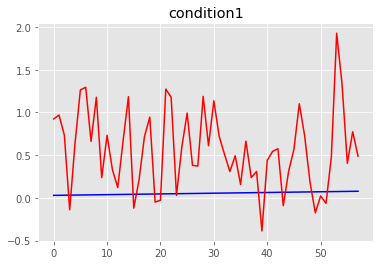

MSE condition1: 0.4833507740594557
R2 condition1: -2424.7763903015025


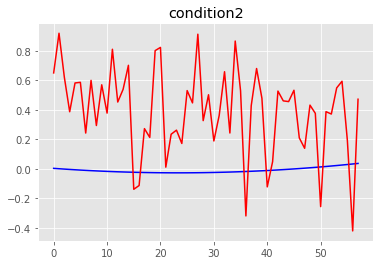

MSE condition2: 0.24933824417574463
R2 condition2: -847.8476049641089


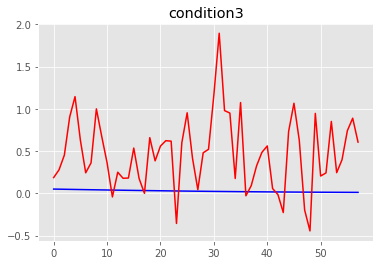

MSE condition3: 0.3803315588255555
R2 condition3: -2800.034484869546


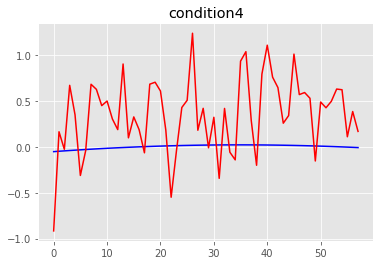

MSE condition4: 0.28608163944327425
R2 condition4: -718.6893079580047
==== the test person number # 7 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.89944670e-09 3.76837666e-09 3.49352219e-09 3.42696105e-09]
Global min values from training is:  [-3.89340149e-09 -3.781

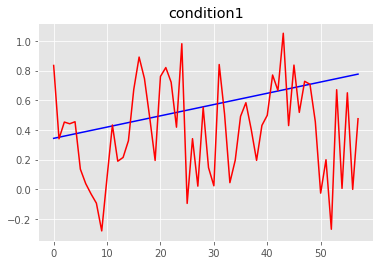

MSE condition1: 0.13640109479013943
R2 condition1: -7.458385650779292


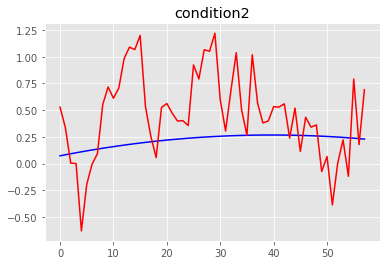

MSE condition2: 0.20632975035702344
R2 condition2: -65.74415025199534


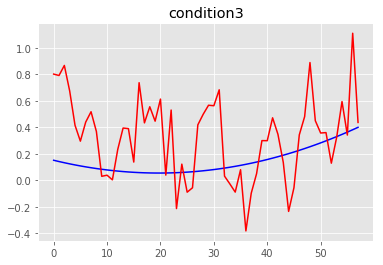

MSE condition3: 0.12405543893024816
R2 condition3: -12.442928244687328


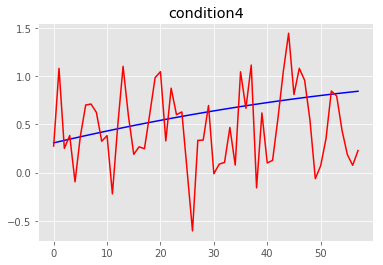

MSE condition4: 0.20261026897293277
R2 condition4: -7.117753798617395
==== the test person number # 7 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.95488074e-09 4.23960131e-09 3.65518125e-09 3.64205073e-09]
Global min values from training is:  [-3.94572564e-09 -4.249

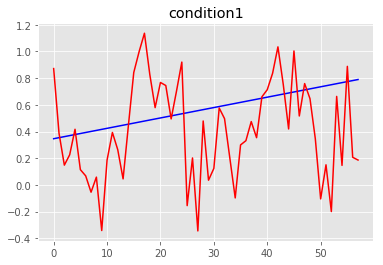

MSE condition1: 0.16264320217371545
R2 condition1: -8.596745910572098


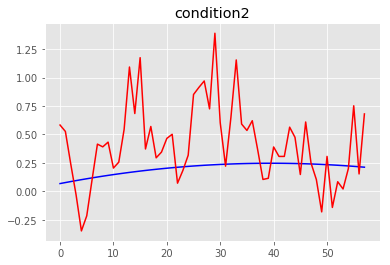

MSE condition2: 0.1630836266854327
R2 condition2: -61.780583316084346


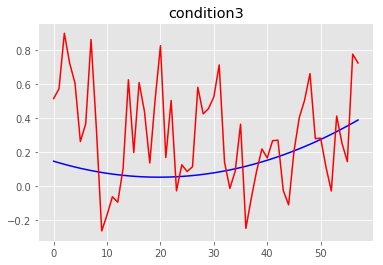

MSE condition3: 0.11480462137987614
R2 condition3: -12.120424588433432


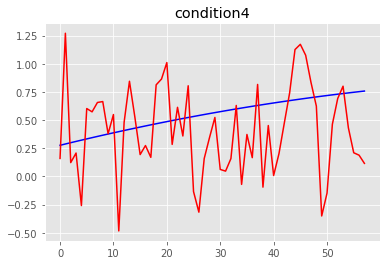

MSE condition4: 0.19547449643260761
R2 condition4: -8.68641868327125
==== the test person number # 7 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00814426e-09 4.28300560e-09 3.71486941e-09 3.60225353e-09]
Global min values from training is:  [-4.00119784e-09 -4.2930

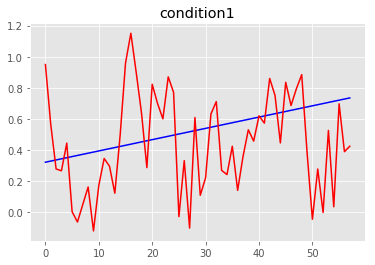

MSE condition1: 0.11201693230564023
R2 condition1: -6.616901483825035


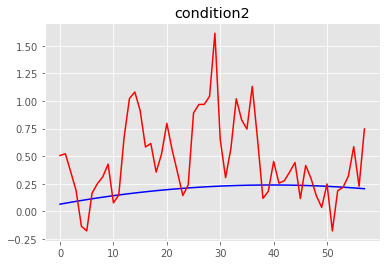

MSE condition2: 0.20064981159063974
R2 condition2: -80.50448036978669


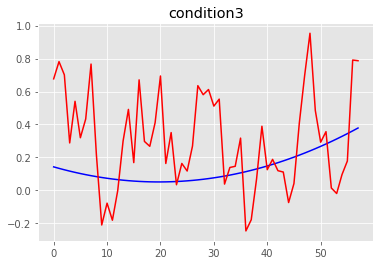

MSE condition3: 0.11521354032618808
R2 condition3: -12.946611560475215


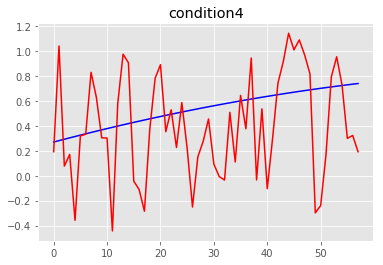

MSE condition4: 0.19064541896108853
R2 condition4: -8.93732622733547
==== the test person number # 7 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99611108e-09 4.24427876e-09 3.70775600e-09 3.59953469e-09]
Global min values from training is:  [-3.99043149e-09 -4.2542

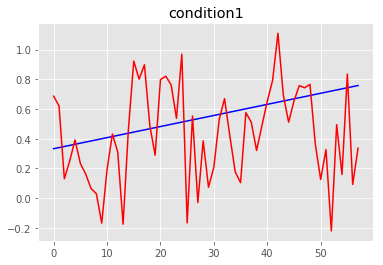

MSE condition1: 0.11867516807641355
R2 condition1: -6.587244453029805


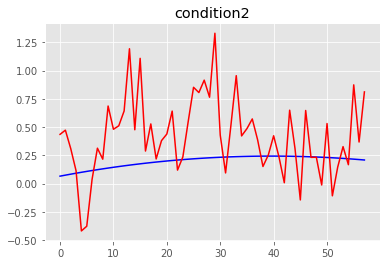

MSE condition2: 0.16390832686798582
R2 condition2: -62.801349244783424


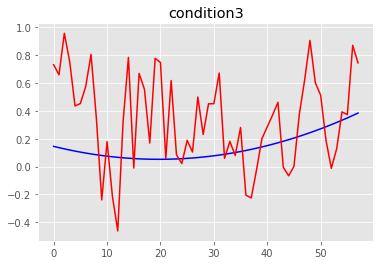

MSE condition3: 0.14720231400801365
R2 condition3: -16.30863759598936


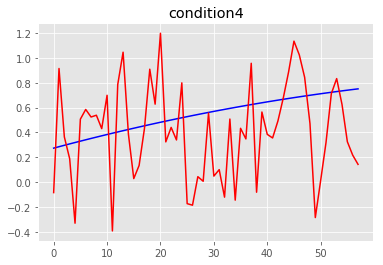

MSE condition4: 0.18012255077083458
R2 condition4: -8.106750951876377
==== the test person number # 7 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.08232390e-09 4.36509463e-09 3.69363077e-09 3.68381547e-09]
Global min values from training is:  [-4.07424601e-09 -4.376

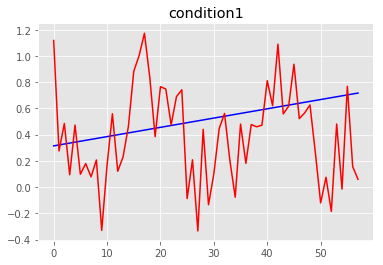

MSE condition1: 0.15875311258919272
R2 condition1: -10.34367727865283


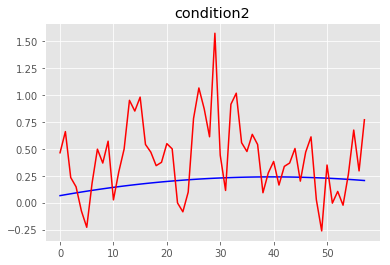

MSE condition2: 0.16955762869697819
R2 condition2: -67.63779761799356


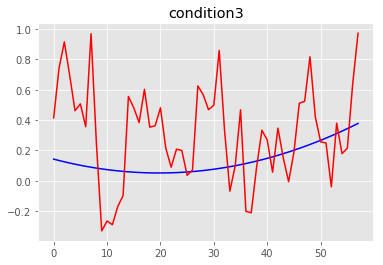

MSE condition3: 0.12990906189242446
R2 condition3: -14.766670725904827


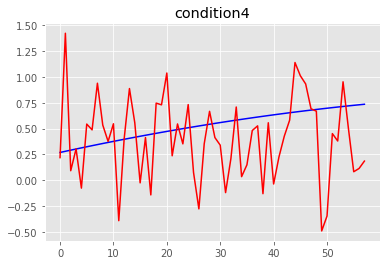

MSE condition4: 0.20054632557177154
R2 condition4: -9.564162722477668
==== the test person number # 7 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06282612e-09 4.08597195e-09 3.68669226e-09 3.63901231e-09]
Global min values from training is:  [-4.05569747e-09 -4.079

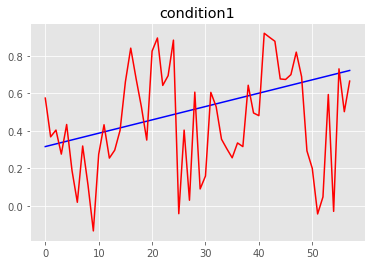

MSE condition1: 0.08348908674169593
R2 condition1: -4.8744164596806465


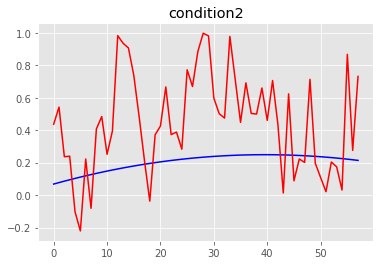

MSE condition2: 0.14849531028548404
R2 condition2: -54.478436678813004


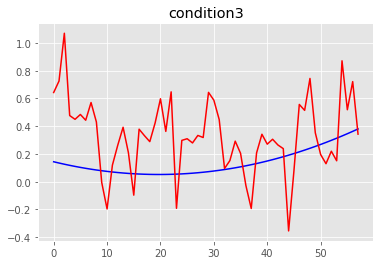

MSE condition3: 0.11006827469276699
R2 condition3: -12.237386284228453


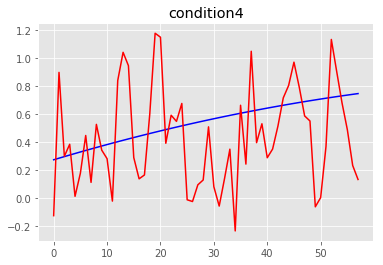

MSE condition4: 0.14593938597213574
R2 condition4: -6.4780810239934485
==== the test person number # 7 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06344281e-09 4.35254662e-09 3.70835337e-09 3.65818744e-09]
Global min values from training is:  [-4.05603759e-09 -4.36

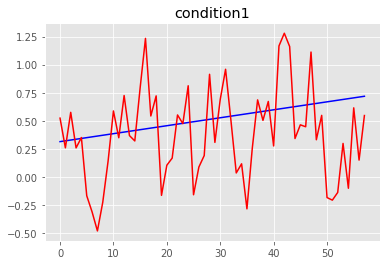

MSE condition1: 0.19039936865905294
R2 condition1: -12.54447627463314


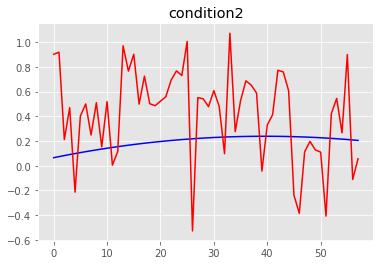

MSE condition2: 0.18997144123604287
R2 condition2: -76.34435270833212


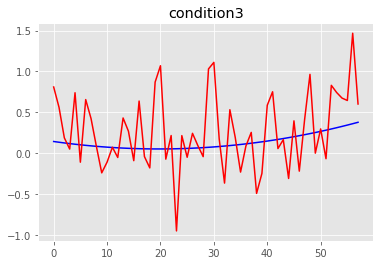

MSE condition3: 0.20550404190764657
R2 condition3: -23.979886853627903


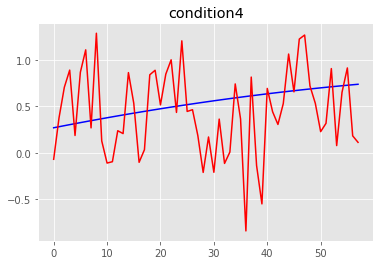

MSE condition4: 0.24023013198107654
R2 condition4: -11.573785481623268
==== the test person number # 7 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03869512e-09 4.32638346e-09 3.69001653e-09 3.54649236e-09]
Global min values from training is:  [-4.02994098e-09 -4.33

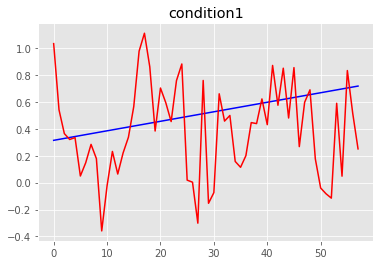

MSE condition1: 0.14598458351656274
R2 condition1: -9.4182940696088


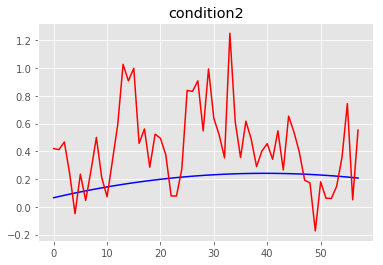

MSE condition2: 0.13837430274995108
R2 condition2: -53.85144855109879


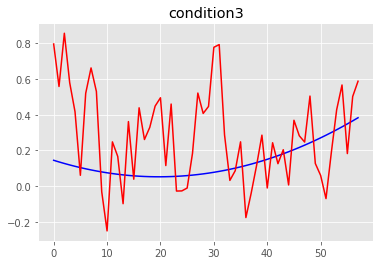

MSE condition3: 0.09332383298470816
R2 condition3: -10.060159968720317


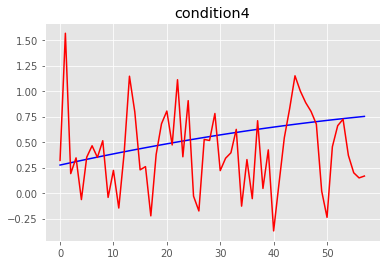

MSE condition4: 0.19185570106207883
R2 condition4: -8.689037312863533
==== the test person number # 7 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.87111213e-09 4.23543943e-09 3.60356024e-09 3.48788351e-09]
Global min values from training is:  [-3.86636514e-09 -4.244

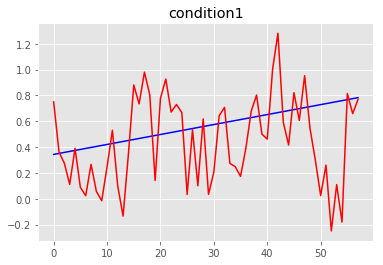

MSE condition1: 0.13259084482839006
R2 condition1: -6.972486072678735


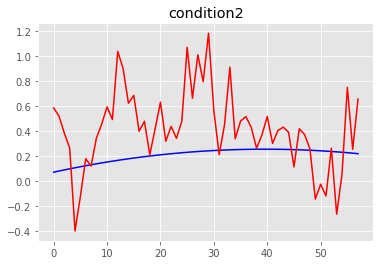

MSE condition2: 0.14269662438440597
R2 condition2: -50.821051414831366


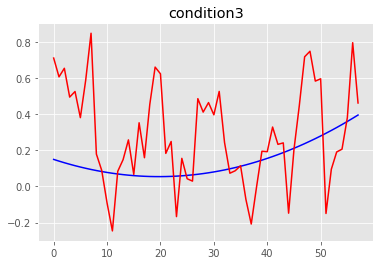

MSE condition3: 0.09494068669889213
R2 condition3: -9.588599308467298


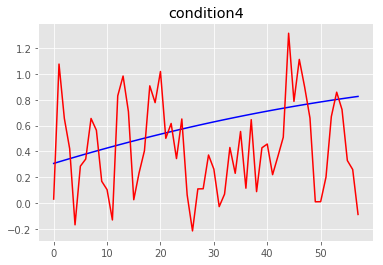

MSE condition4: 0.1771856216554728
R2 condition4: -6.52317413358422
==== the test person number # 7 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02702681e-09 4.28997113e-09 3.64075142e-09 3.58800997e-09]
Global min values from training is:  [-4.01720638e-09 -4.29887

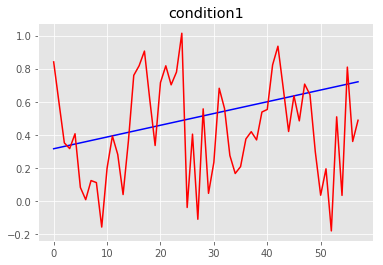

MSE condition1: 0.10669144020981162
R2 condition1: -6.550757464682002


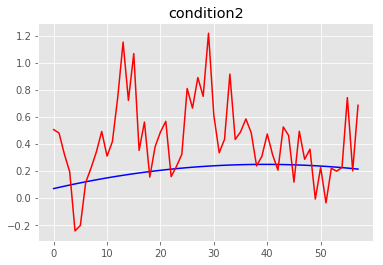

MSE condition2: 0.1337031342244066
R2 condition2: -50.022809423810166


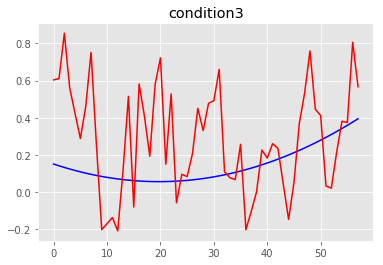

MSE condition3: 0.09995292665426032
R2 condition3: -10.289099606360114


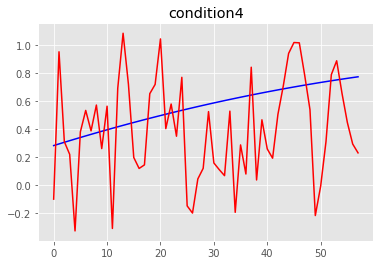

MSE condition4: 0.16716281634928887
R2 condition4: -7.016963410503296
==== the test person number # 7 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.61085806e-09 3.90059710e-09 3.38545229e-09 3.28877976e-09]
Global min values from training is:  [-3.60981321e-09 -3.914

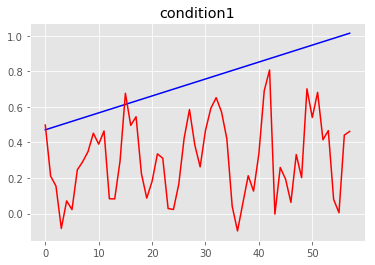

MSE condition1: 0.25036847496401693
R2 condition1: -8.844857008363523


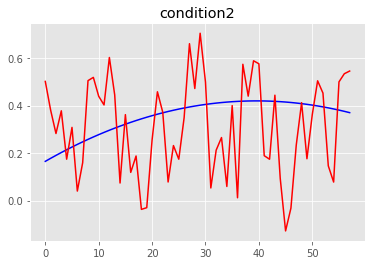

MSE condition2: 0.04977363875944206
R2 condition2: -8.402594264732405


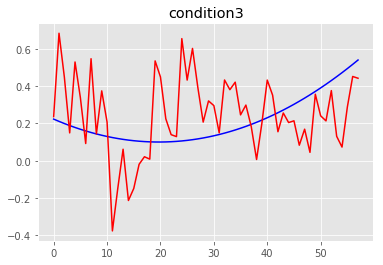

MSE condition3: 0.05524959175396309
R2 condition3: -2.6969231085293335


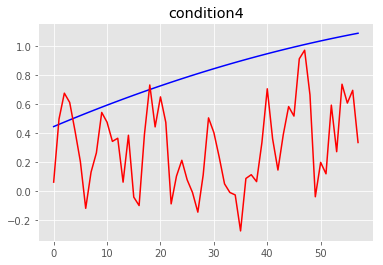

MSE condition4: 0.3482222555992388
R2 condition4: -8.654980418960216
==== the test person number # 7 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96805190e-09 4.21156910e-09 3.60022786e-09 3.57765940e-09]
Global min values from training is:  [-3.96028761e-09 -4.2220

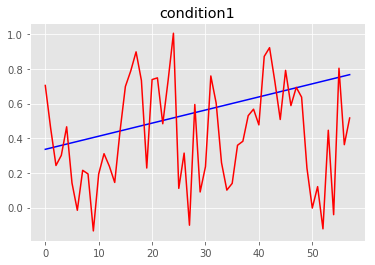

MSE condition1: 0.11174696496537204
R2 condition1: -5.973144671162465


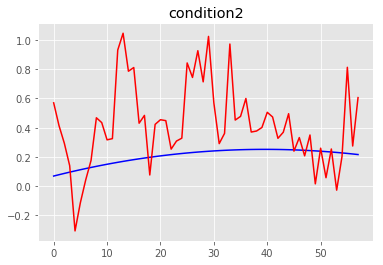

MSE condition2: 0.12307425978800673
R2 condition2: -44.13388627675938


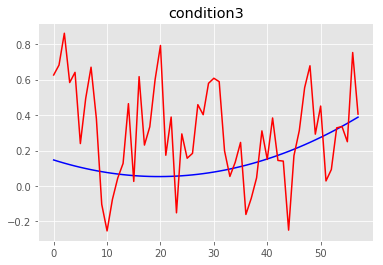

MSE condition3: 0.10491432996118029
R2 condition3: -11.10266161528524


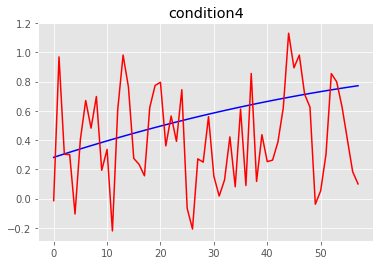

MSE condition4: 0.13960453470643183
R2 condition4: -5.679858528662893
==== the test person number # 7 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02240295e-09 4.30011519e-09 3.64695002e-09 3.64678142e-09]
Global min values from training is:  [-4.01624620e-09 -4.312

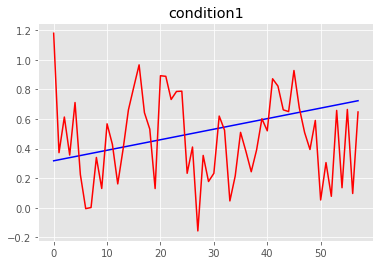

MSE condition1: 0.1019507900644786
R2 condition1: -6.166248221617506


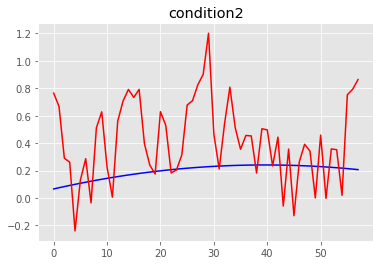

MSE condition2: 0.13817379308354838
R2 condition2: -54.34139575790415


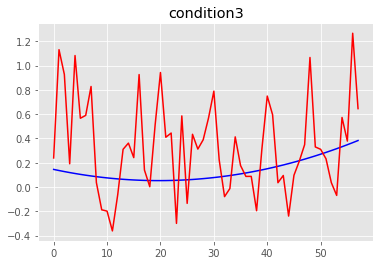

MSE condition3: 0.18271592553050092
R2 condition3: -20.71959279221297


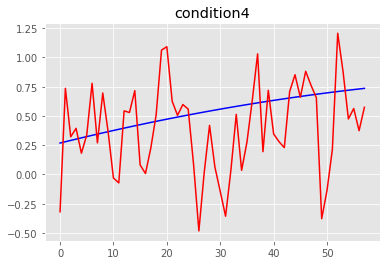

MSE condition4: 0.16777066786045405
R2 condition4: -7.824556889329093
==== the test person number # 7 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.76691850e-09 4.06175050e-09 3.31634017e-09 3.43576569e-09]
Global min values from training is:  [-3.75419309e-09 -4.075

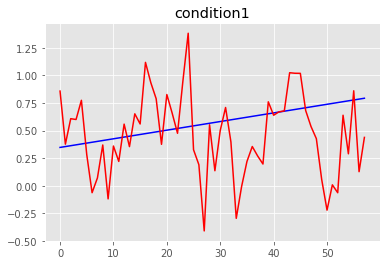

MSE condition1: 0.17204751715075078
R2 condition1: -9.067933383343256


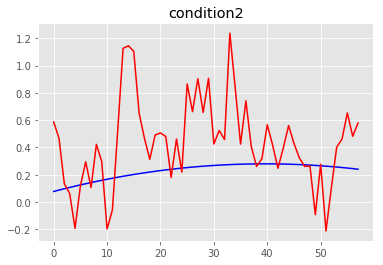

MSE condition2: 0.14087043537542154
R2 condition2: -41.24874415798543


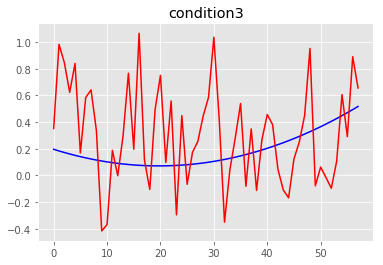

MSE condition3: 0.16193548056634158
R2 condition3: -9.548361169252697


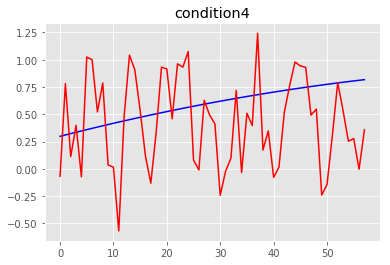

MSE condition4: 0.22900274469420476
R2 condition4: -8.754275932607314
==== the test person number # 7 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06947682e-09 4.35624811e-09 3.73208211e-09 3.70214988e-09]
Global min values from training is:  [-4.06240913e-09 -4.367

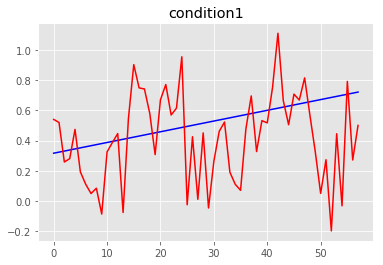

MSE condition1: 0.10241960290873878
R2 condition1: -6.237672560083148


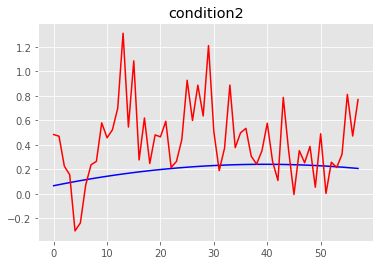

MSE condition2: 0.14928121972095318
R2 condition2: -58.648933321950885


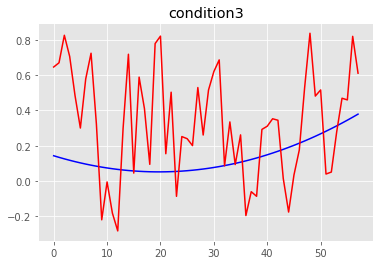

MSE condition3: 0.13001171774288203
R2 condition3: -14.712689071983663


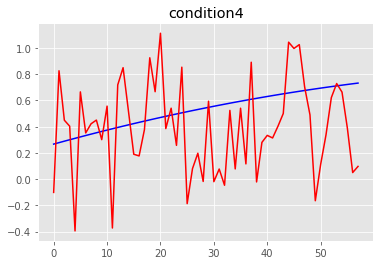

MSE condition4: 0.1561558481556127
R2 condition4: -7.292610980600857
==== the test person number # 8 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27915638e-09 4.09274745e-09 3.83101687e-09 3.70133942e-09]
Global min values from training is:  [-4.26816916e-09 -4.1045

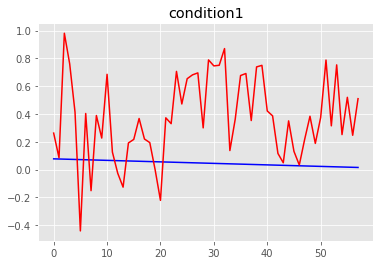

MSE condition1: 0.19860697095536028
R2 condition1: -600.5479020295403


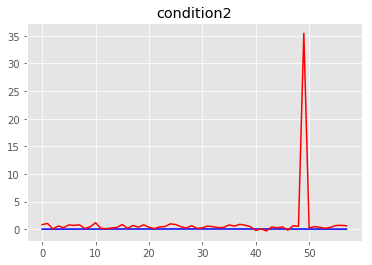

MSE condition2: 21.863091870540043
R2 condition2: -273743.06011027144


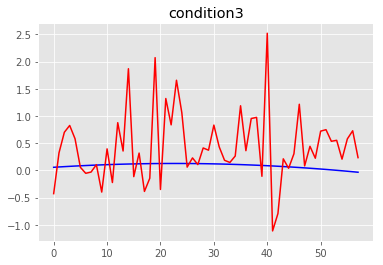

MSE condition3: 0.5391293216613463
R2 condition3: -284.35364222496


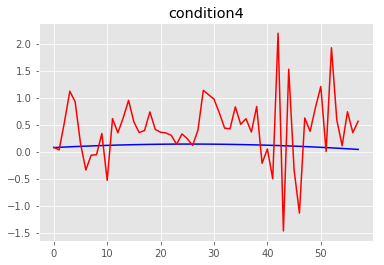

MSE condition4: 0.467401553363082
R2 condition4: -640.2177271694925
==== the test person number # 8 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33459042e-09 4.56397210e-09 3.99267593e-09 3.91642910e-09]
Global min values from training is:  [-4.32049330e-09 -4.57330

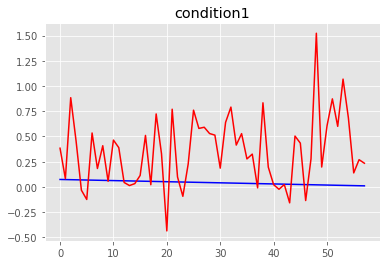

MSE condition1: 0.21976198929057525
R2 condition1: -636.2804077069922


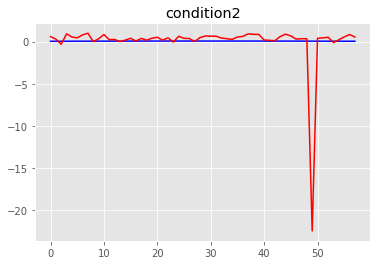

MSE condition2: 8.957092295764097
R2 condition2: -132055.929607088


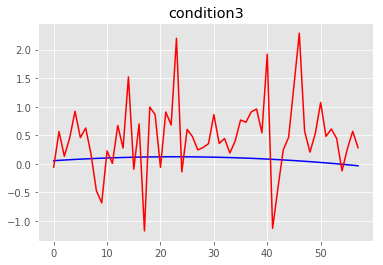

MSE condition3: 0.5557694087095902
R2 condition3: -307.74159670474916


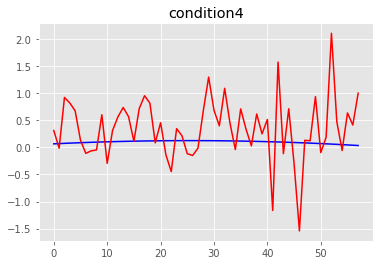

MSE condition4: 0.395696761440599
R2 condition4: -654.0641651142753
==== the test person number # 8 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.38785393e-09 4.60737639e-09 4.05236409e-09 3.87663191e-09]
Global min values from training is:  [-4.37596550e-09 -4.61655

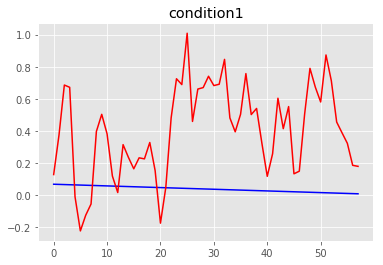

MSE condition1: 0.2149307431968257
R2 condition1: -704.9504906803942


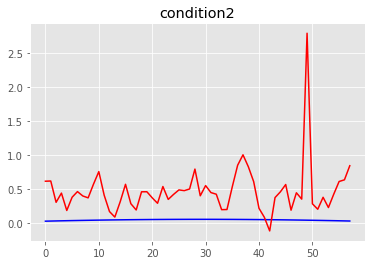

MSE condition2: 0.31858250666885096
R2 condition2: -4939.800480921232


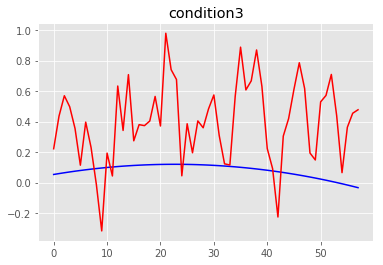

MSE condition3: 0.17232480677608486
R2 condition3: -99.88147558564432


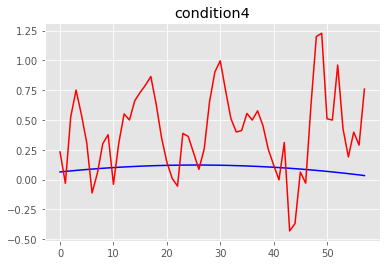

MSE condition4: 0.21314103506378493
R2 condition4: -368.11211348491804
==== the test person number # 8 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37582075e-09 4.56864955e-09 4.04525069e-09 3.87391306e-09]
Global min values from training is:  [-4.36519916e-09 -4.57

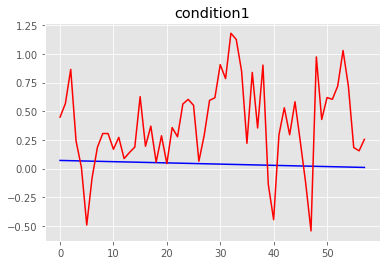

MSE condition1: 0.2602020192461142
R2 condition1: -808.5085372467286


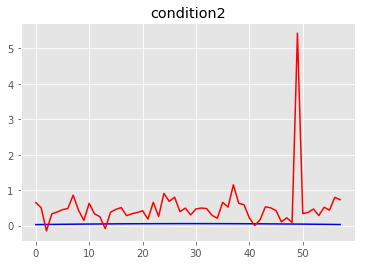

MSE condition2: 0.697388980597033
R2 condition2: -10388.68619660763


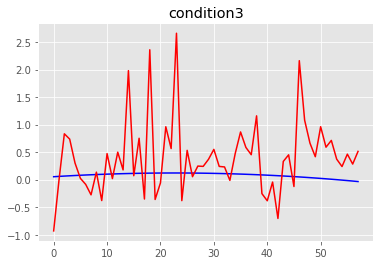

MSE condition3: 0.556636559693267
R2 condition3: -316.34330282058846


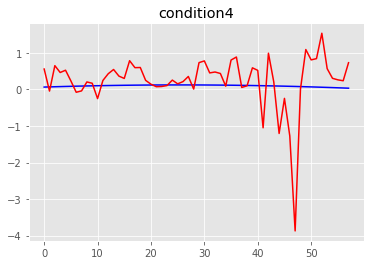

MSE condition4: 0.5500816239634821
R2 condition4: -926.0675218300379
==== the test person number # 8 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46203357e-09 4.68946543e-09 4.03112545e-09 3.95819384e-09]
Global min values from training is:  [-4.44901368e-09 -4.7003

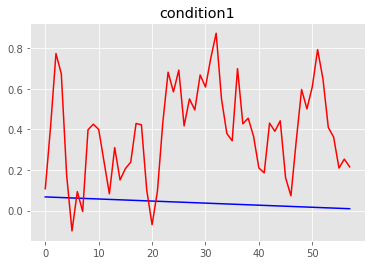

MSE condition1: 0.1744579790351381
R2 condition1: -597.6694931554129


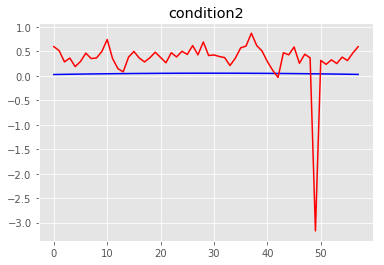

MSE condition2: 0.329461421044813
R2 condition2: -5091.940591849006


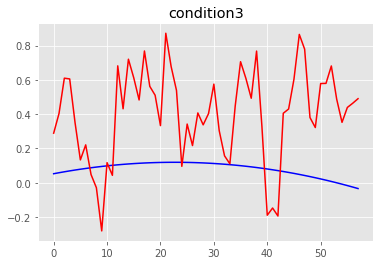

MSE condition3: 0.17925142780849707
R2 condition3: -104.18707256069838


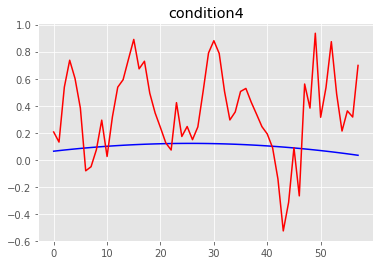

MSE condition4: 0.16495410695916482
R2 condition4: -287.36217355013457
==== the test person number # 8 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44253580e-09 4.41034274e-09 4.02418694e-09 3.91339069e-09]
Global min values from training is:  [-4.43046513e-09 -4.40

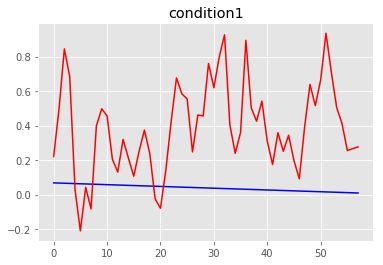

MSE condition1: 0.1899189662886696
R2 condition1: -641.9016880538297


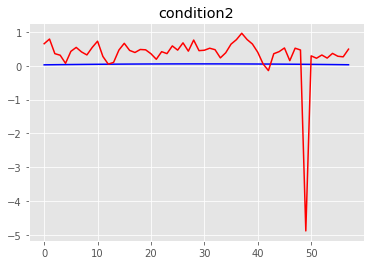

MSE condition2: 0.6023279359182764
R2 condition2: -8632.544494401625


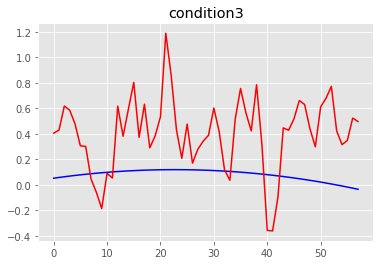

MSE condition3: 0.1894496928990001
R2 condition3: -109.25033152381124


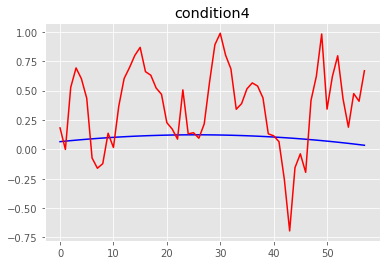

MSE condition4: 0.1878478080672332
R2 condition4: -319.3885666279089
==== the test person number # 8 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44315248e-09 4.67691742e-09 4.04584805e-09 3.93256581e-09]
Global min values from training is:  [-4.43080526e-09 -4.6872

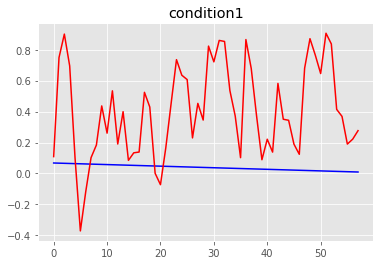

MSE condition1: 0.22531722494248052
R2 condition1: -769.1576068979123


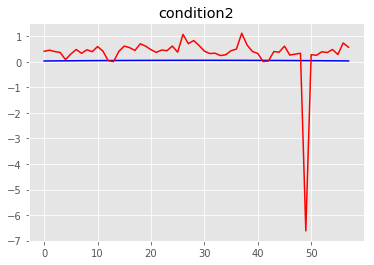

MSE condition2: 0.9560684514663982
R2 condition2: -14858.53161377179


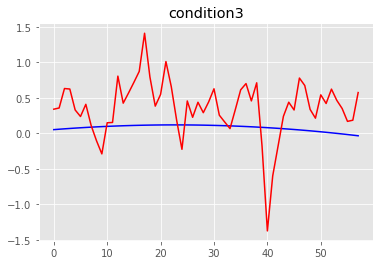

MSE condition3: 0.24118931859311757
R2 condition3: -140.73231783737793


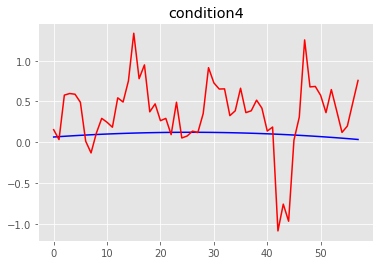

MSE condition4: 0.24590543589070657
R2 condition4: -426.42605287921015
==== the test person number # 8 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03869512e-09 4.32638346e-09 3.69001653e-09 3.54649236e-09]
Global min values from training is:  [-4.02994098e-09 -4.33

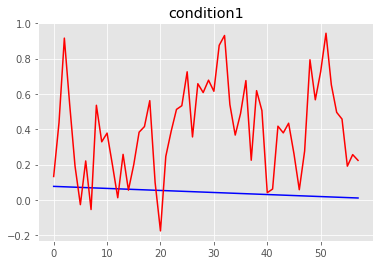

MSE condition1: 0.19933615773824512
R2 condition1: -533.408170385643


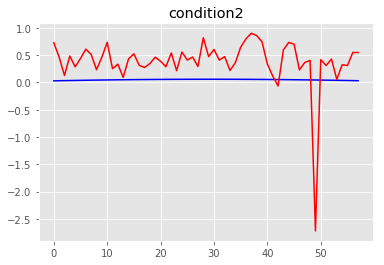

MSE condition2: 0.32213785607314377
R2 condition2: -4334.474410392256


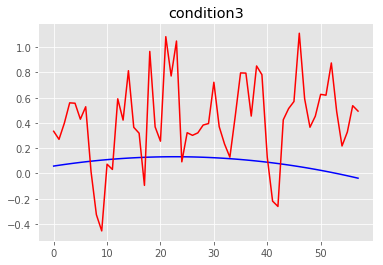

MSE condition3: 0.22824595728520314
R2 condition3: -107.93481734621118


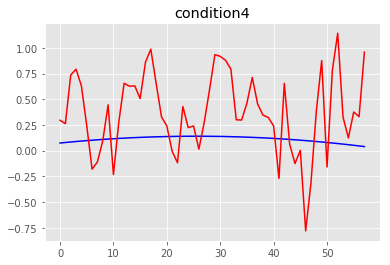

MSE condition4: 0.2160399721667386
R2 condition4: -287.4018821065458
==== the test person number # 8 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.25082180e-09 4.55981022e-09 3.94105493e-09 3.76226188e-09]
Global min values from training is:  [-4.24113281e-09 -4.5682

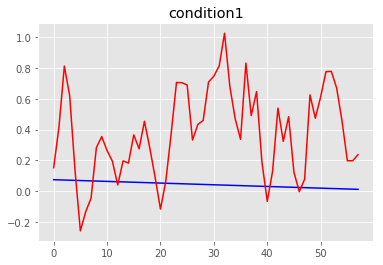

MSE condition1: 0.19679797722520834
R2 condition1: -579.1831911055592


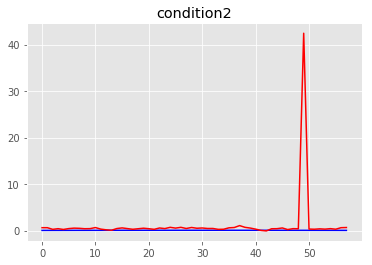

MSE condition2: 31.173241094628555
R2 condition2: -435064.18419774104


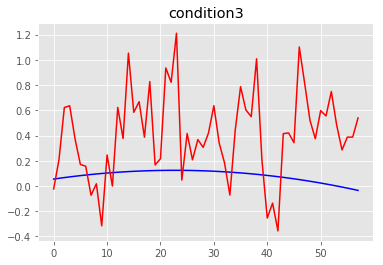

MSE condition3: 0.22511398950512873
R2 condition3: -121.30885965330592


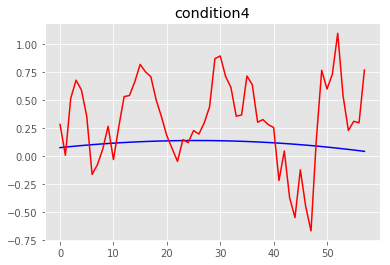

MSE condition4: 0.18207799910583627
R2 condition4: -261.8763822854203
==== the test person number # 8 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40673648e-09 4.61434192e-09 3.97824610e-09 3.86238834e-09]
Global min values from training is:  [-4.39197405e-09 -4.622

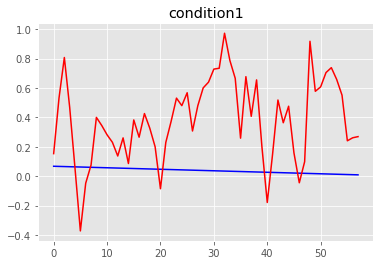

MSE condition1: 0.1988564662700315
R2 condition1: -675.6254711143503


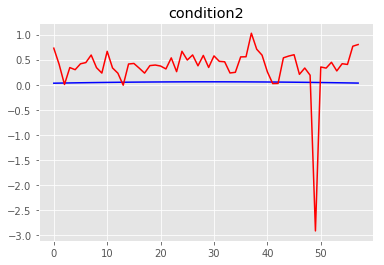

MSE condition2: 0.3235404302359489
R2 condition2: -4729.996482837866


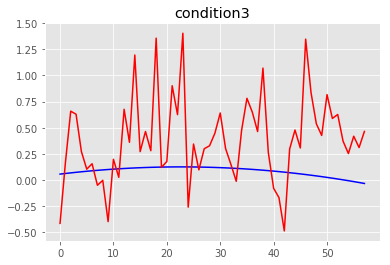

MSE condition3: 0.2603457350855739
R2 condition3: -142.08286766918746


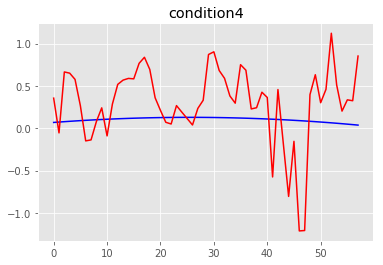

MSE condition4: 0.2389449469536507
R2 condition4: -383.2349860529636
==== the test person number # 8 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99056774e-09 4.22496789e-09 3.72294697e-09 3.56315813e-09]
Global min values from training is:  [-3.98458088e-09 -4.2378

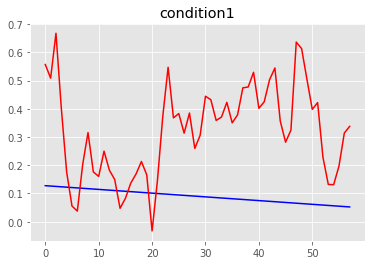

MSE condition1: 0.08275865642344182
R2 condition1: -168.10579875039735


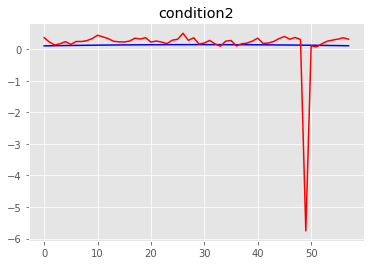

MSE condition2: 0.6216660184003328
R2 condition2: -4724.244290751304


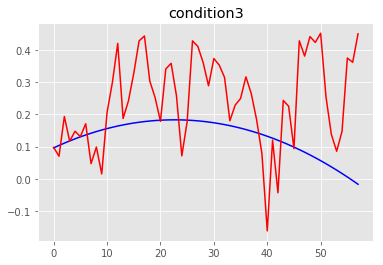

MSE condition3: 0.03503249375650021
R2 condition3: -11.031093560947467


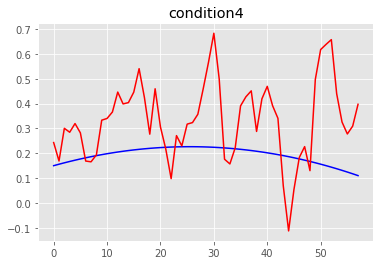

MSE condition4: 0.0448557107832442
R2 condition4: -43.69931414084847
==== the test person number # 8 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34776158e-09 4.53593989e-09 3.93772255e-09 3.85203777e-09]
Global min values from training is:  [-4.33505528e-09 -4.5455

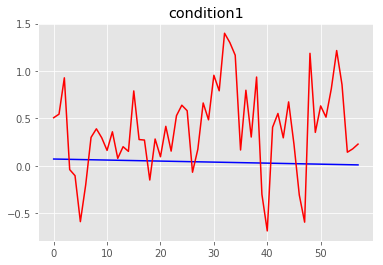

MSE condition1: 0.3288341075546358
R2 condition1: -1000.4778993031442


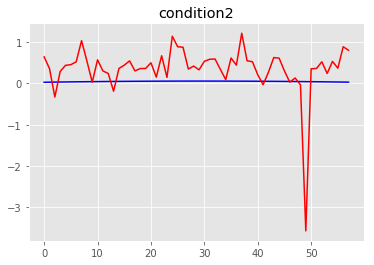

MSE condition2: 0.4557613531963848
R2 condition2: -6418.4602524452885


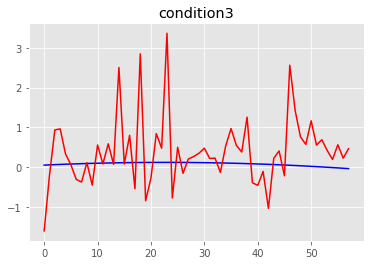

MSE condition3: 0.8563379163792078
R2 condition3: -478.77728845704354


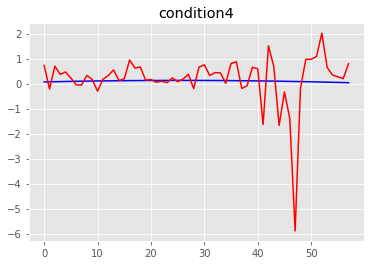

MSE condition4: 1.0336884529306312
R2 condition4: -1657.8177454561142
==== the test person number # 8 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40211262e-09 4.62448599e-09 3.98444470e-09 3.92115979e-09]
Global min values from training is:  [-4.39101386e-09 -4.635

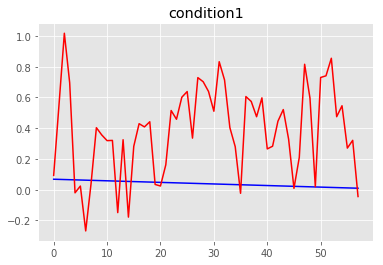

MSE condition1: 0.20358384773556942
R2 condition1: -687.5512301874583


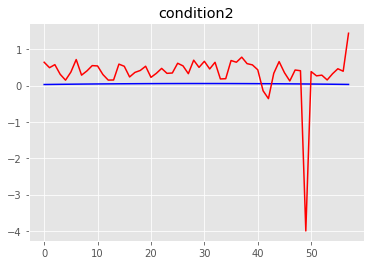

MSE condition2: 0.48133609343678624
R2 condition2: -7365.401478994366


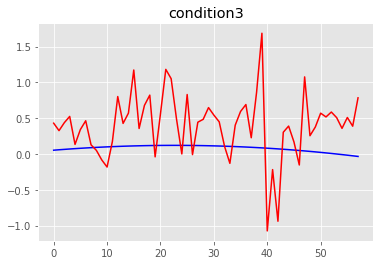

MSE condition3: 0.3034055967226926
R2 condition3: -173.69894709332854


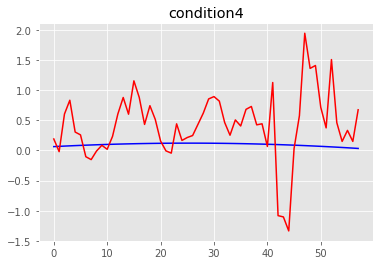

MSE condition4: 0.4207374201112219
R2 condition4: -733.5341735374916
==== the test person number # 8 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.14662817e-09 4.38612130e-09 3.65383485e-09 3.71014406e-09]
Global min values from training is:  [-4.12896076e-09 -4.3986

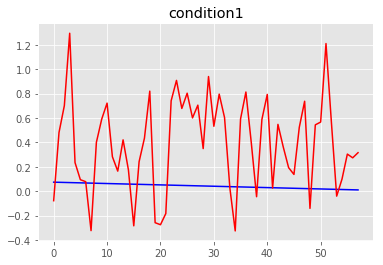

MSE condition1: 0.26356566100273965
R2 condition1: -757.7934345898757


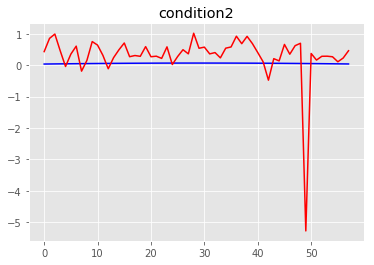

MSE condition2: 0.686448526124761
R2 condition2: -8006.651596380415


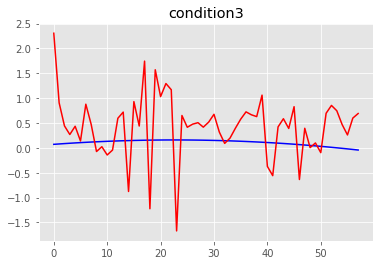

MSE condition3: 0.5227264856309438
R2 condition3: -174.29949440013826


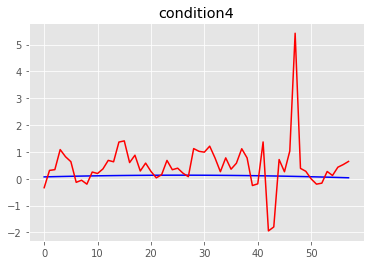

MSE condition4: 0.9379572075310236
R2 condition4: -1356.9866009942018
==== the test person number # 8 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44918650e-09 4.68061890e-09 4.06957679e-09 3.97652825e-09]
Global min values from training is:  [-4.43717680e-09 -4.691

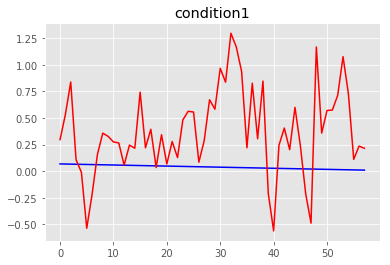

MSE condition1: 0.2780438188333966
R2 condition1: -943.8256224704256


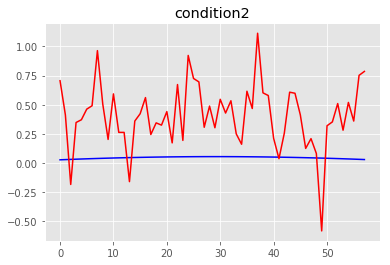

MSE condition2: 0.20591633940334417
R2 condition2: -3143.342125007137


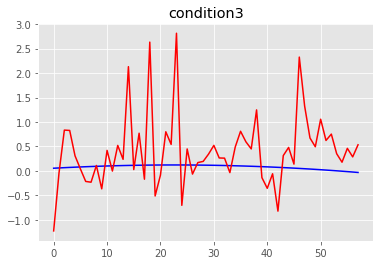

MSE condition3: 0.6533952092623361
R2 condition3: -380.94727026025834


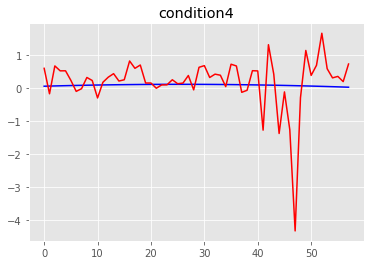

MSE condition4: 0.6380243133525237
R2 condition4: -1122.4353207101874
==== the test person number # 9 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11157338e-09 4.00180341e-09 3.74456059e-09 3.64273057e-09]
Global min values from training is:  [-4.10459332e-09 -4.013

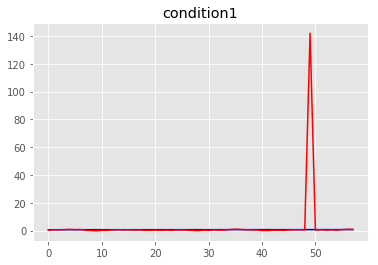

MSE condition1: 344.28163526876307
R2 condition1: -806586.6331943203


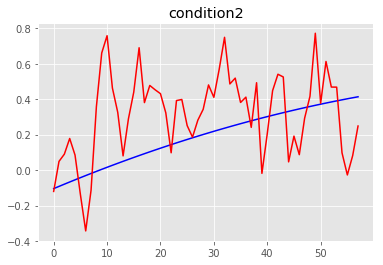

MSE condition2: 0.07819456338544113
R2 condition2: -2.3438655743231798


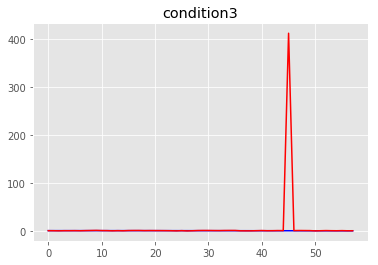

MSE condition3: 2914.5353193025408
R2 condition3: -201259.89138290982


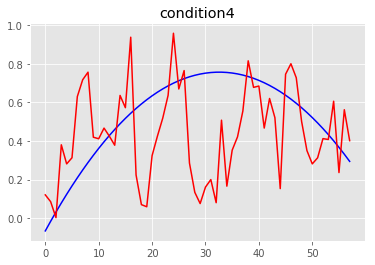

MSE condition4: 0.09389372834772086
R2 condition4: -0.9220984344728889
==== the test person number # 9 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.16700742e-09 4.47302806e-09 3.90621965e-09 3.85782026e-09]
Global min values from training is:  [-4.15691746e-09 -4.48

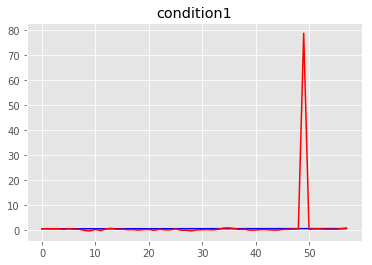

MSE condition1: 105.51539219127845
R2 condition1: -235805.1354308114


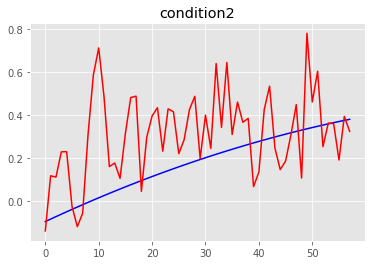

MSE condition2: 0.05867349858039308
R2 condition2: -1.9760305019795594


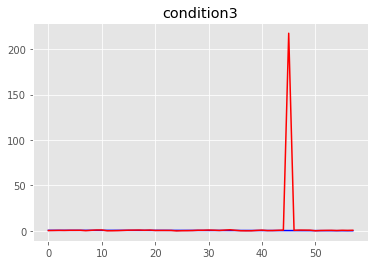

MSE condition3: 814.6249923465998
R2 condition3: -59123.10679299539


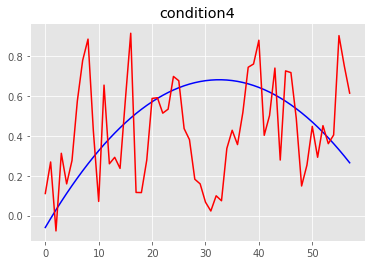

MSE condition4: 0.09561616077147785
R2 condition4: -1.3999461719042308
==== the test person number # 9 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.22027093e-09 4.51643236e-09 3.96590781e-09 3.81802306e-09]
Global min values from training is:  [-4.21238966e-09 -4.52

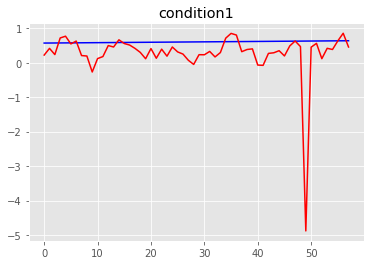

MSE condition1: 0.6337668547187043
R2 condition1: -1619.8767264194544


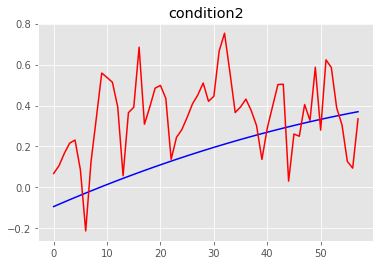

MSE condition2: 0.07302827799395785
R2 condition2: -2.9047548172259954


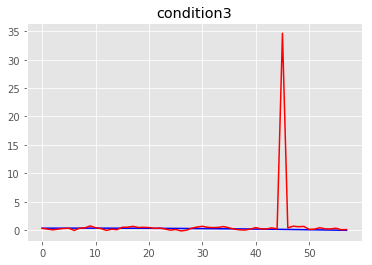

MSE condition3: 20.61603533977591
R2 condition3: -1578.122047539446


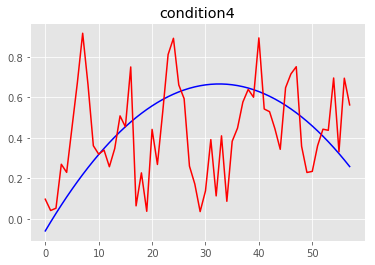

MSE condition4: 0.07987299866419457
R2 condition4: -1.1047410139606888
==== the test person number # 9 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20823775e-09 4.47770552e-09 3.95879440e-09 3.81530421e-09]
Global min values from training is:  [-4.20162331e-09 -4.48

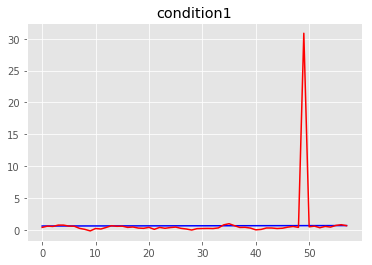

MSE condition1: 15.856556222443999
R2 condition1: -38241.697379492


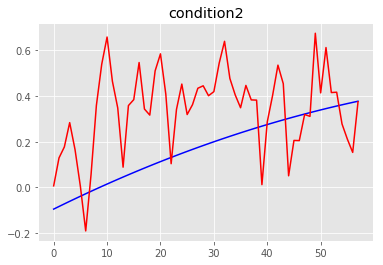

MSE condition2: 0.0669966273752135
R2 condition2: -2.4353779660838875


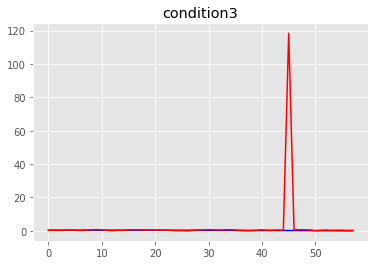

MSE condition3: 241.2514197827305
R2 condition3: -17981.612309479016


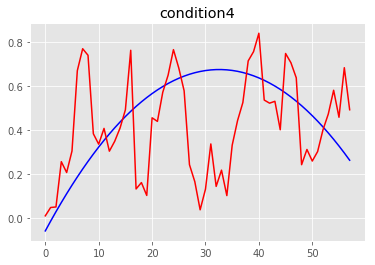

MSE condition4: 0.07472580876502379
R2 condition4: -0.9121700104564028
==== the test person number # 9 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29445057e-09 4.59852139e-09 3.94466917e-09 3.89958499e-09]
Global min values from training is:  [-4.28543784e-09 -4.60

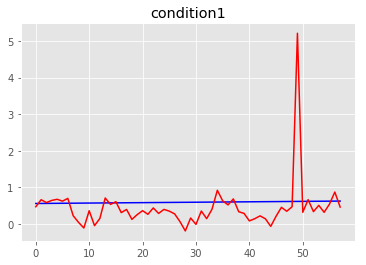

MSE condition1: 0.47535266943500265
R2 condition1: -1273.5678917042428


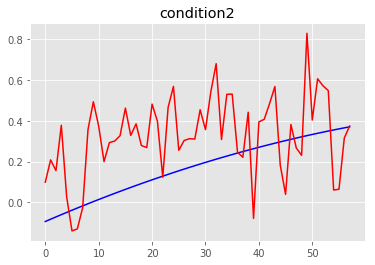

MSE condition2: 0.06359254809868982
R2 condition2: -2.388744755114788


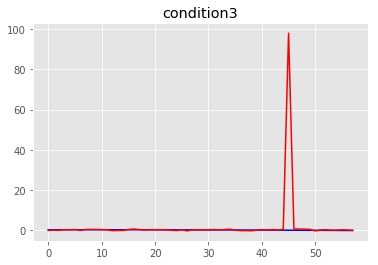

MSE condition3: 165.0263472452884
R2 condition3: -12670.519651453307


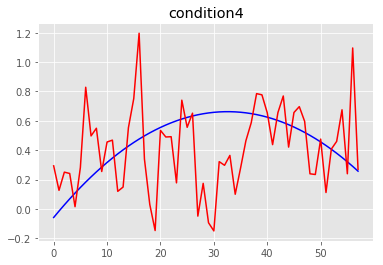

MSE condition4: 0.11197541459980634
R2 condition4: -1.9807516013584312
==== the test person number # 9 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27495280e-09 4.31939870e-09 3.93773066e-09 3.85478184e-09]
Global min values from training is:  [-4.26688929e-09 -4.31

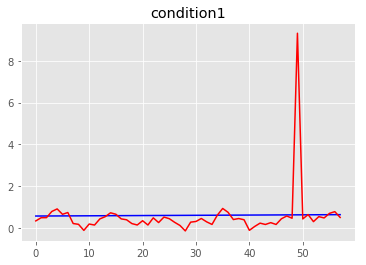

MSE condition1: 1.4057646480864512
R2 condition1: -3713.280255427268


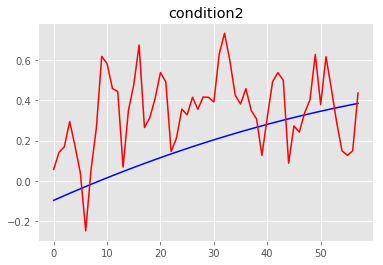

MSE condition2: 0.07169777029015693
R2 condition2: -2.531317337725346


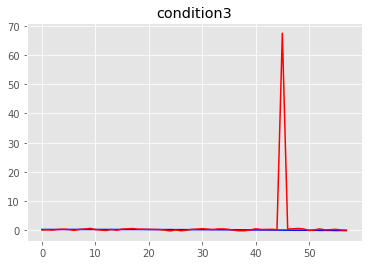

MSE condition3: 78.12583576042316
R2 condition3: -5946.794072726216


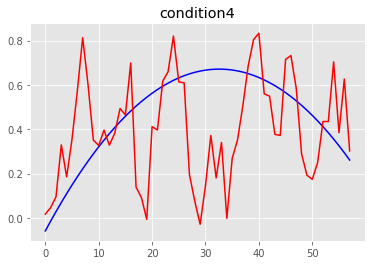

MSE condition4: 0.08150539610366611
R2 condition4: -1.1127186365864539
==== the test person number # 9 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27556948e-09 4.58597338e-09 3.95939177e-09 3.87395696e-09]
Global min values from training is:  [-4.26722942e-09 -4.59

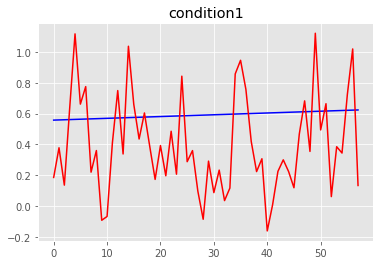

MSE condition1: 0.13451522541408797
R2 condition1: -358.1479399683742


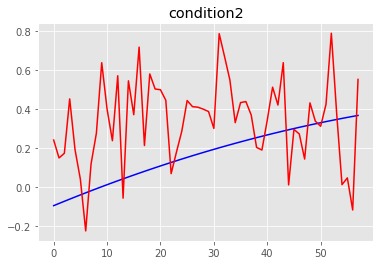

MSE condition2: 0.08895932803064499
R2 condition2: -3.7673170479464364


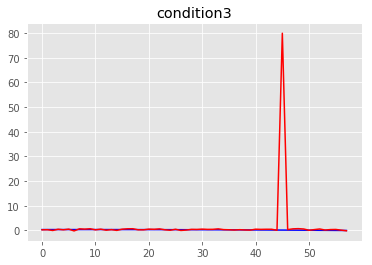

MSE condition3: 109.98011381093065
R2 condition3: -8456.02455919223


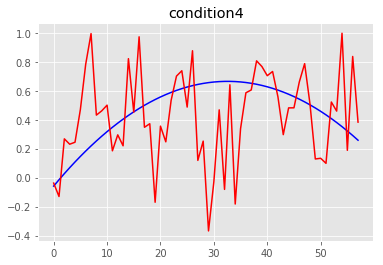

MSE condition4: 0.12547233833727758
R2 condition4: -2.31951157878629
==== the test person number # 9 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.87111213e-09 4.23543943e-09 3.60356024e-09 3.48788351e-09]
Global min values from training is:  [-3.86636514e-09 -4.2447

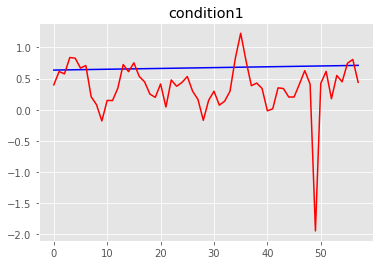

MSE condition1: 0.26460796341768644
R2 condition1: -541.9579472246159


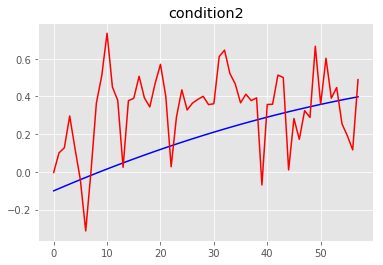

MSE condition2: 0.06808998486256047
R2 condition2: -2.1401332536216757


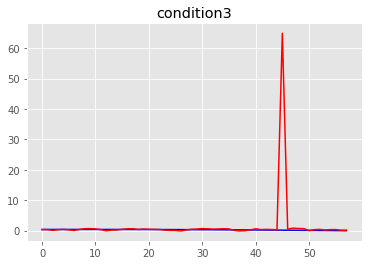

MSE condition3: 72.4486007496631
R2 condition3: -4496.217973165078


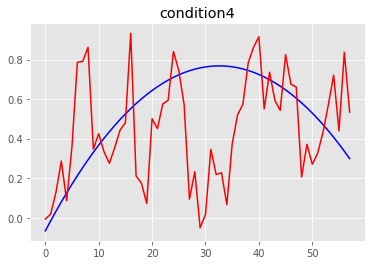

MSE condition4: 0.10730077970991375
R2 condition4: -1.1321841136507955
==== the test person number # 9 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.25082180e-09 4.55981022e-09 3.94105493e-09 3.76226188e-09]
Global min values from training is:  [-4.24113281e-09 -4.56

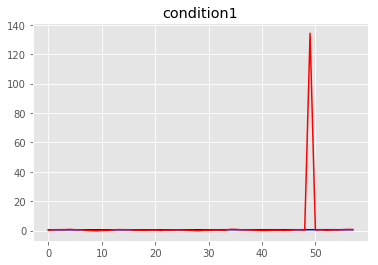

MSE condition1: 307.76874891050824
R2 condition1: -824240.9115582336


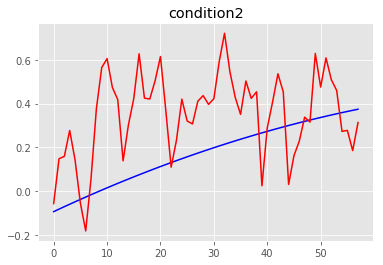

MSE condition2: 0.07301504014883309
R2 condition2: -2.81149024580642


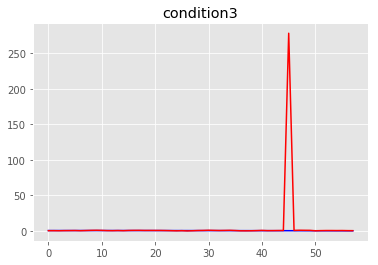

MSE condition3: 1334.5422135794886
R2 condition3: -100211.23849111592


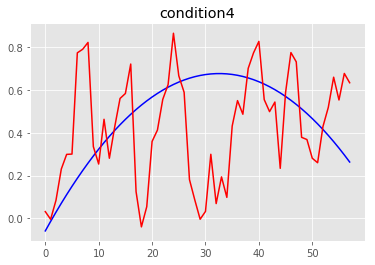

MSE condition4: 0.09440710549980706
R2 condition4: -1.4131810667451927
==== the test person number # 9 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23915348e-09 4.52339788e-09 3.89178982e-09 3.80377949e-09]
Global min values from training is:  [-4.22839821e-09 -4.53

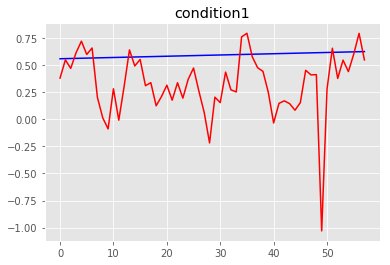

MSE condition1: 0.15315796795714892
R2 condition1: -405.92068161816485


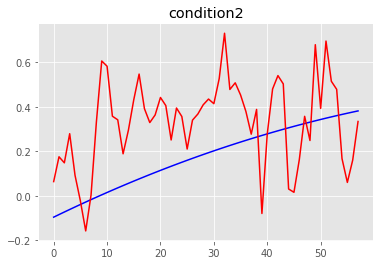

MSE condition2: 0.06861316246111515
R2 condition2: -2.4504840416328495


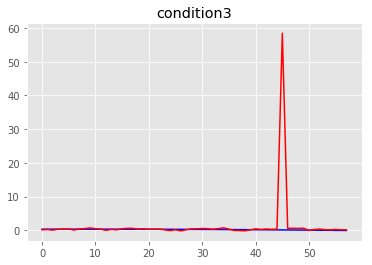

MSE condition3: 58.67249059397704
R2 condition3: -4210.576313019966


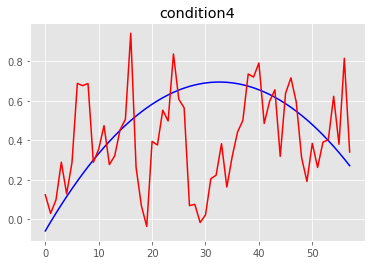

MSE condition4: 0.08958523130828651
R2 condition4: -1.17900758875989
==== the test person number # 9 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.82298474e-09 4.13402385e-09 3.63649069e-09 3.50454928e-09]
Global min values from training is:  [-3.82100504e-09 -4.1466

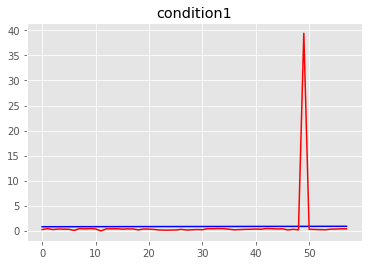

MSE condition1: 25.97191854942944
R2 condition1: -39567.75196749087


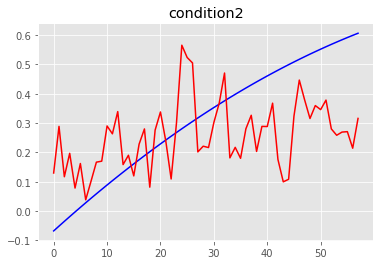

MSE condition2: 0.037915131128234435
R2 condition2: 0.041491214746506744


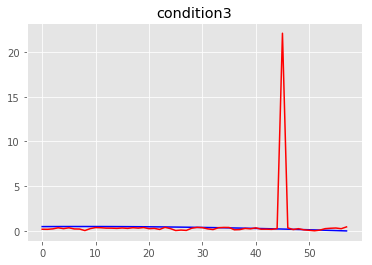

MSE condition3: 8.327357967965686
R2 condition3: -366.8637132741293


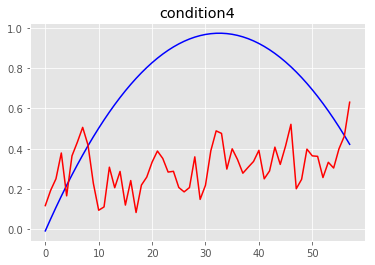

MSE condition4: 0.23064316704284432
R2 condition4: -2.324329400837031
==== the test person number # 9 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.18017858e-09 4.44499586e-09 3.85126626e-09 3.79342892e-09]
Global min values from training is:  [-4.17147944e-09 -4.454

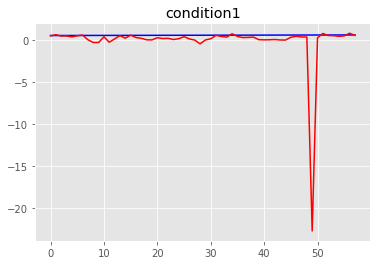

MSE condition1: 9.572551155106673
R2 condition1: -22559.766022016633


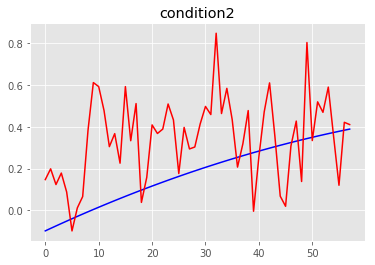

MSE condition2: 0.0719888044159984
R2 condition2: -2.481532264448349


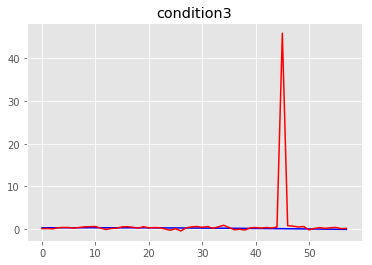

MSE condition3: 36.0811976519286
R2 condition3: -2640.720946341467


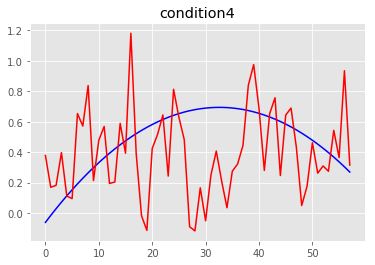

MSE condition4: 0.12580331327836472
R2 condition4: -2.0531730932339665
==== the test person number # 9 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23452963e-09 4.53354195e-09 3.89798842e-09 3.86255094e-09]
Global min values from training is:  [-4.22743802e-09 -4.54

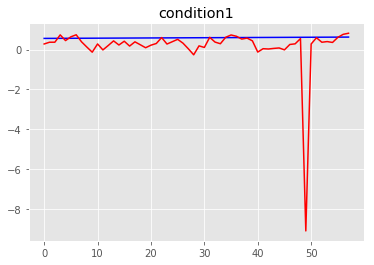

MSE condition1: 1.753849010889016
R2 condition1: -4628.570984253157


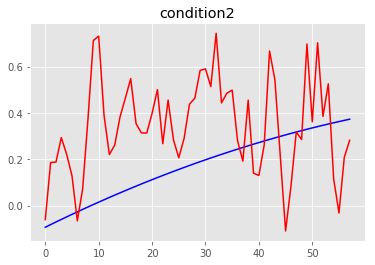

MSE condition2: 0.0841048851315707
R2 condition2: -3.4352165554400376


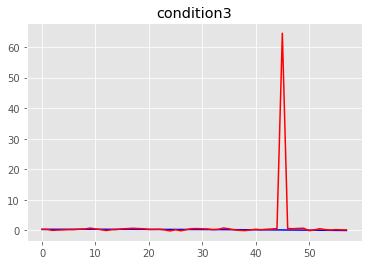

MSE condition3: 71.57142767320545
R2 condition3: -5388.551657926137


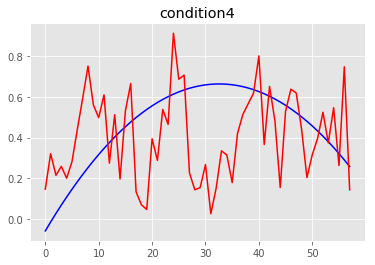

MSE condition4: 0.07793727158187912
R2 condition4: -1.071710379212111
==== the test person number # 9 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97904517e-09 4.29517726e-09 3.56737857e-09 3.65153522e-09]
Global min values from training is:  [-3.96538492e-09 -4.307

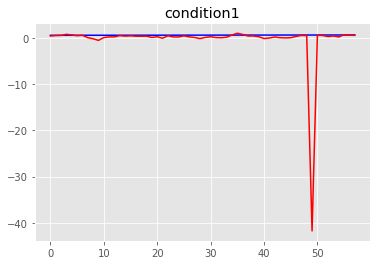

MSE condition1: 31.216482105136212
R2 condition1: -69215.56866681254


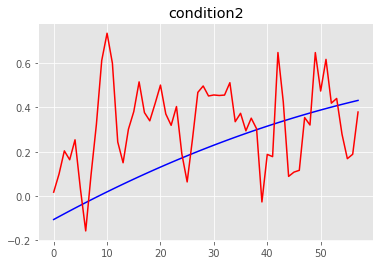

MSE condition2: 0.0632050701611799
R2 condition2: -1.509761716540594


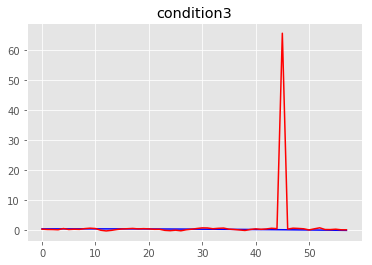

MSE condition3: 73.98034818202393
R2 condition3: -3187.513710802399


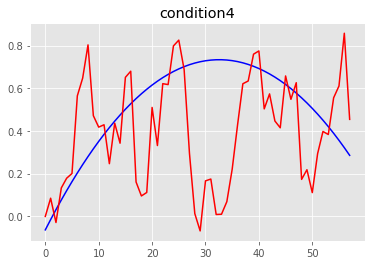

MSE condition4: 0.10789655066198335
R2 condition4: -1.342081076163196
==== the test person number # 9 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.28160350e-09 4.58967486e-09 3.98312051e-09 3.91791941e-09]
Global min values from training is:  [-4.27360096e-09 -4.599

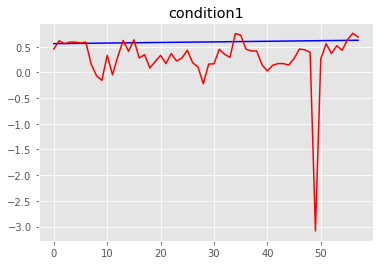

MSE condition1: 0.3445599942391123
R2 condition1: -913.1552869082933


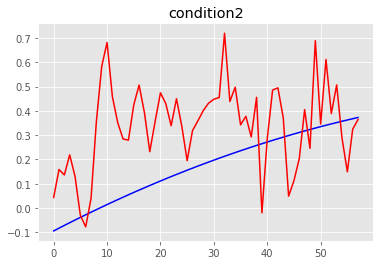

MSE condition2: 0.06493769602989947
R2 condition2: -2.4165042419396796


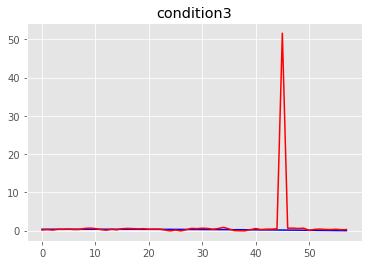

MSE condition3: 45.71035497366673
R2 condition3: -3494.9990939169024


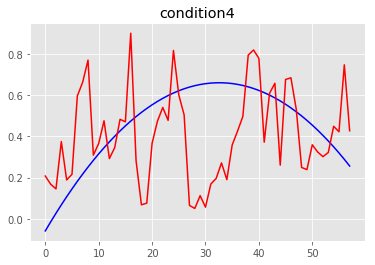

MSE condition4: 0.08036886609612398
R2 condition4: -1.1561135074652196
==== the test person number # 10 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26748806e-09 4.05633511e-09 3.78175176e-09 3.74285703e-09]
Global min values from training is:  [-4.25543456e-09 -4.06

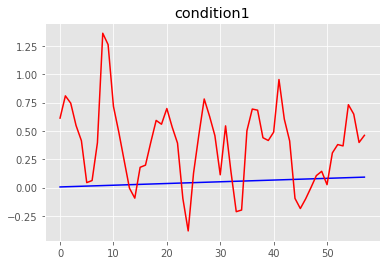

MSE condition1: 0.23465299272388637
R2 condition1: -361.76412452232233


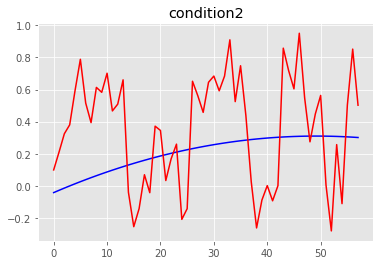

MSE condition2: 0.14653301935612392
R2 condition2: -11.729248145042105


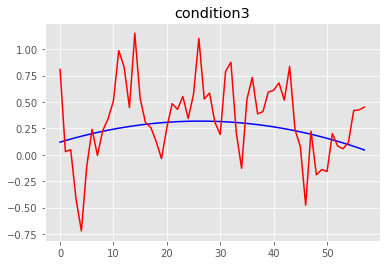

MSE condition3: 0.13327319837451274
R2 condition3: -22.366326564211


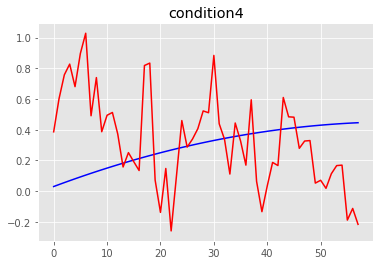

MSE condition4: 0.14742650089261236
R2 condition4: -8.509700532907965
==== the test person number # 10 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32292210e-09 4.52755976e-09 3.94341082e-09 3.95794671e-09]
Global min values from training is:  [-4.30775870e-09 -4.536

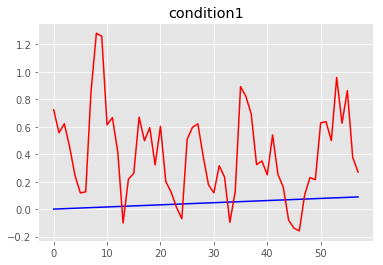

MSE condition1: 0.2387994762985037
R2 condition1: -352.3935612423924


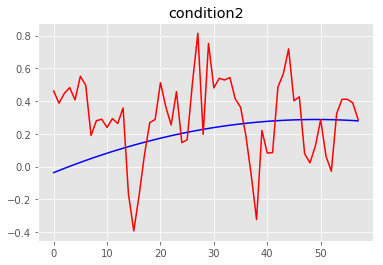

MSE condition2: 0.08199705791727455
R2 condition2: -7.413604357734243


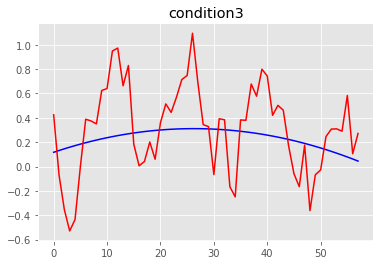

MSE condition3: 0.12474734391398117
R2 condition3: -21.98097329669298


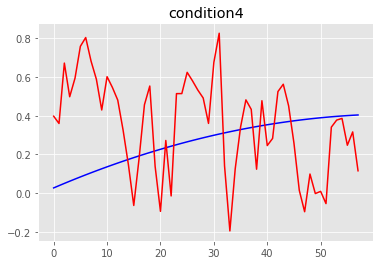

MSE condition4: 0.1051935539440361
R2 condition4: -7.226097237969265
==== the test person number # 10 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37618561e-09 4.57096406e-09 4.00309898e-09 3.91814952e-09]
Global min values from training is:  [-4.36323090e-09 -4.5795

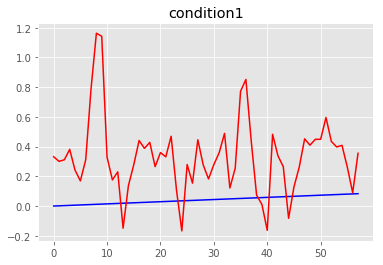

MSE condition1: 0.15078696491381646
R2 condition1: -251.87030526770408


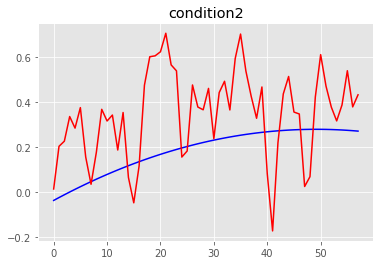

MSE condition2: 0.06093583705615769
R2 condition2: -5.583174468812872


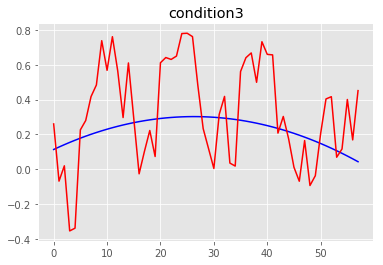

MSE condition3: 0.08406281210971601
R2 condition3: -15.338432425023889


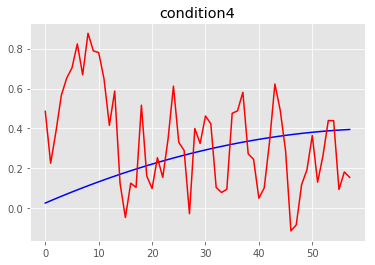

MSE condition4: 0.1026171067702237
R2 condition4: -7.403258558470402
==== the test person number # 10 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36415243e-09 4.53223722e-09 3.99598558e-09 3.91543067e-09]
Global min values from training is:  [-4.35246455e-09 -4.5407

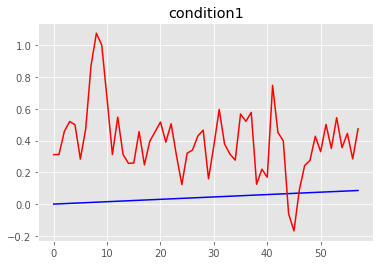

MSE condition1: 0.17449549986016485
R2 condition1: -276.1169019786115


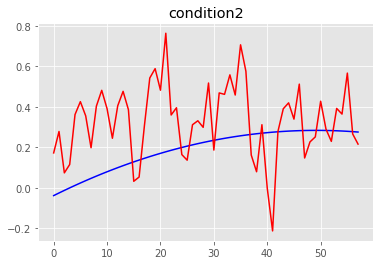

MSE condition2: 0.05916434289113176
R2 condition2: -5.135640232520832


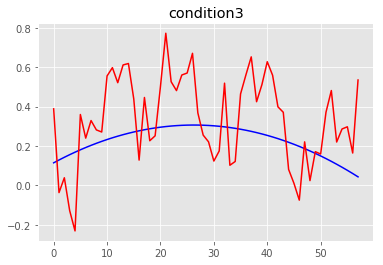

MSE condition3: 0.05438970527398643
R2 condition3: -9.288758358995326


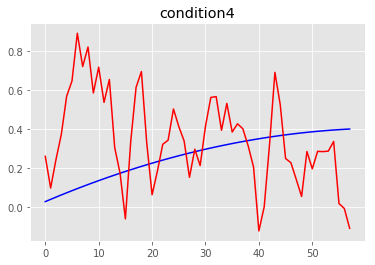

MSE condition4: 0.09481600090411596
R2 condition4: -6.551449449758355
==== the test person number # 10 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.45036525e-09 4.65305309e-09 3.98186034e-09 3.99971145e-09]
Global min values from training is:  [-4.43627908e-09 -4.663

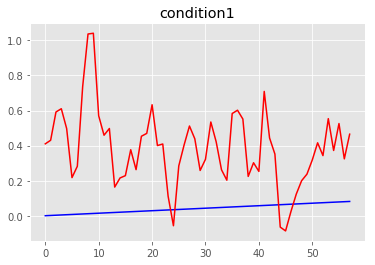

MSE condition1: 0.17154614455017517
R2 condition1: -299.61227358970996


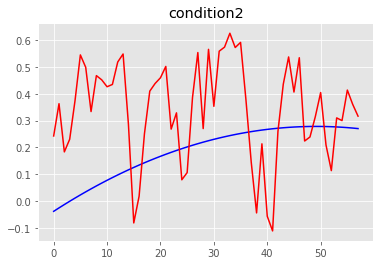

MSE condition2: 0.0679941518694983
R2 condition2: -6.321458059526164


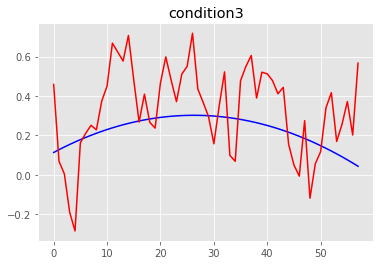

MSE condition3: 0.05338052716803253
R2 condition3: -9.400355187559668


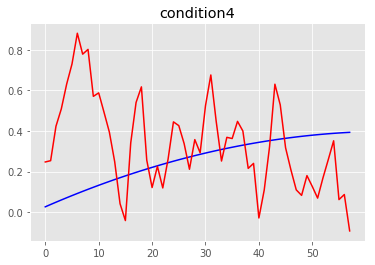

MSE condition4: 0.0906200934148434
R2 condition4: -6.492550802629355
==== the test person number # 10 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43086748e-09 4.37393040e-09 3.97492183e-09 3.95490830e-09]
Global min values from training is:  [-4.41773053e-09 -4.3658

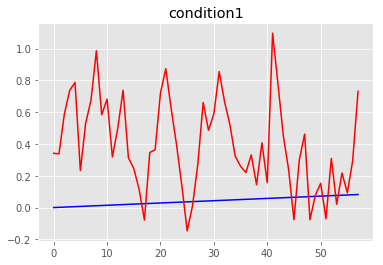

MSE condition1: 0.21208603775527804
R2 condition1: -365.6028121335837


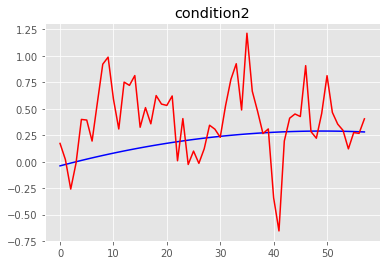

MSE condition2: 0.15613754531266744
R2 condition2: -14.567803554916532


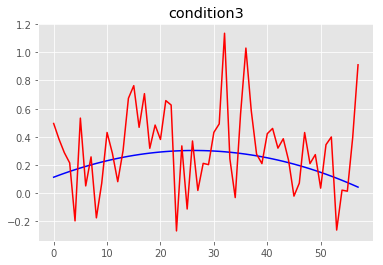

MSE condition3: 0.0910650074602861
R2 condition3: -16.592344675265938


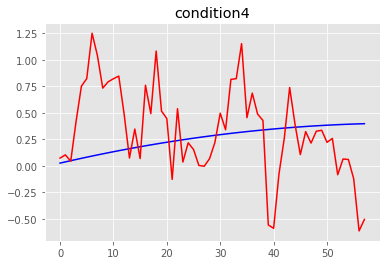

MSE condition4: 0.22837742117361046
R2 condition4: -17.412322465283314
==== the test person number # 10 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148416e-09 4.64050508e-09 3.99658294e-09 3.97408342e-09]
Global min values from training is:  [-4.41807066e-09 -4.65

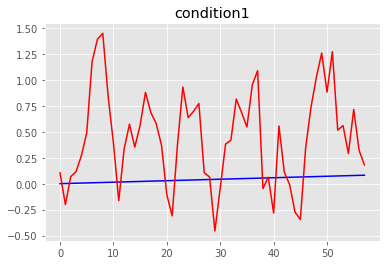

MSE condition1: 0.37215572171739014
R2 condition1: -648.5805863911136


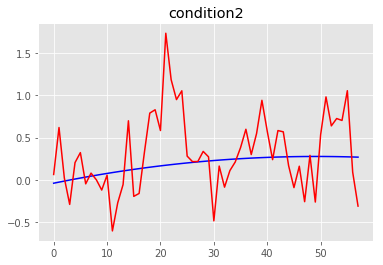

MSE condition2: 0.2079553294491918
R2 condition2: -21.515944285878582


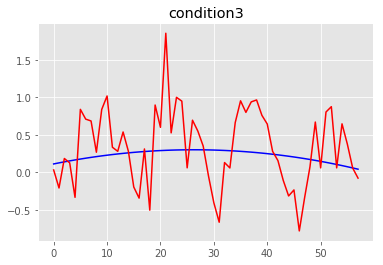

MSE condition3: 0.26068711532307154
R2 condition3: -49.8638630278913


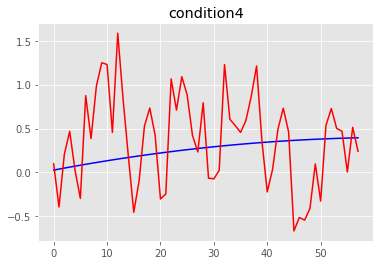

MSE condition4: 0.3107854082412618
R2 condition4: -24.54623235252343
==== the test person number # 10 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02702681e-09 4.28997113e-09 3.64075142e-09 3.58800997e-09]
Global min values from training is:  [-4.01720638e-09 -4.2988

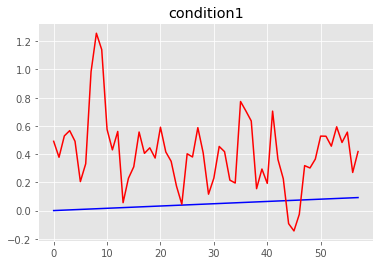

MSE condition1: 0.2031737165339519
R2 condition1: -276.8829250978027


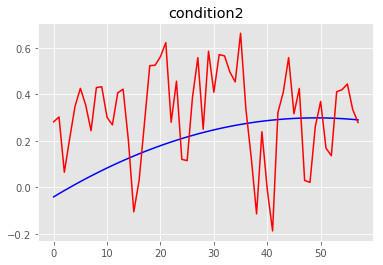

MSE condition2: 0.06119772821176886
R2 condition2: -4.722388275703521


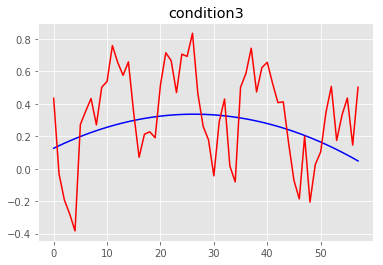

MSE condition3: 0.08090436583616148
R2 condition3: -11.759298411446586


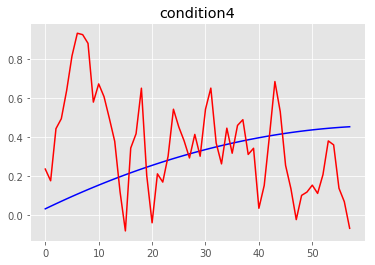

MSE condition4: 0.10657340739219479
R2 condition4: -5.684682642078916
==== the test person number # 10 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40673648e-09 4.61434192e-09 3.97824610e-09 3.86238834e-09]
Global min values from training is:  [-4.39197405e-09 -4.622

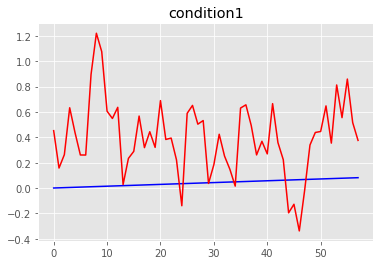

MSE condition1: 0.21602472034088271
R2 condition1: -377.1360474919057


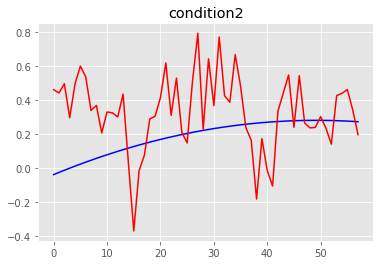

MSE condition2: 0.08195563248634663
R2 condition2: -7.648880703427725


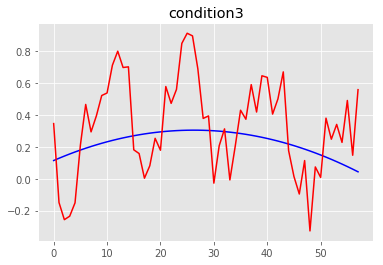

MSE condition3: 0.09050781012596942
R2 condition3: -16.24723564224682


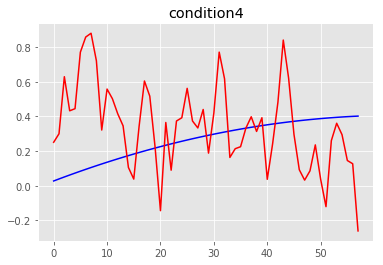

MSE condition4: 0.10237983496338313
R2 condition4: -7.145488654702637
==== the test person number # 10 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23915348e-09 4.52339788e-09 3.89178982e-09 3.80377949e-09]
Global min values from training is:  [-4.22839821e-09 -4.531

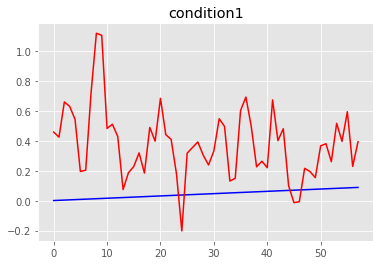

MSE condition1: 0.17232945633949157
R2 condition1: -258.2865724394159


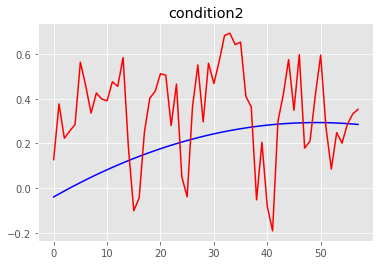

MSE condition2: 0.07468961972548006
R2 condition2: -6.247358692736999


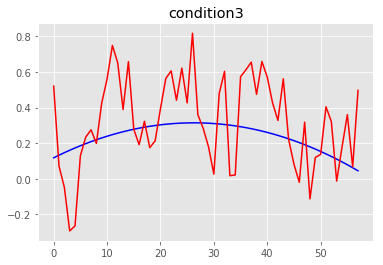

MSE condition3: 0.06227671780899165
R2 condition3: -10.214995992901873


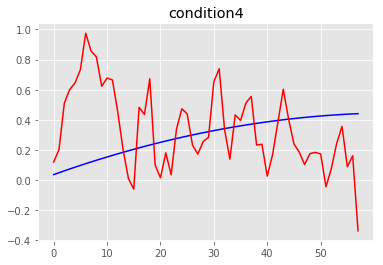

MSE condition4: 0.11477575298580778
R2 condition4: -6.801623838997499
==== the test person number # 10 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97889942e-09 4.18855556e-09 3.67368186e-09 3.60467574e-09]
Global min values from training is:  [-3.97184628e-09 -4.200

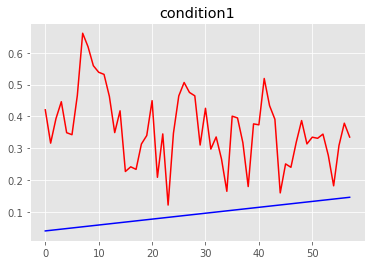

MSE condition1: 0.0880238138265308
R2 condition1: -90.64812292552577


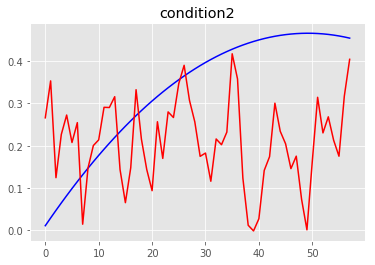

MSE condition2: 0.0467254591088879
R2 condition2: -1.4363468208132066


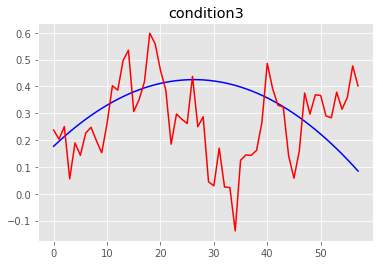

MSE condition3: 0.03696488258192604
R2 condition3: -3.158356807670473


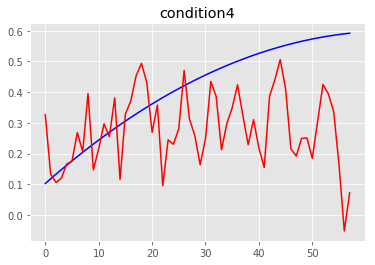

MSE condition4: 0.047894398290590584
R2 condition4: -1.2240810558010287
==== the test person number # 10 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33609326e-09 4.49952756e-09 3.88845744e-09 3.89355538e-09]
Global min values from training is:  [-4.32232067e-09 -4.5

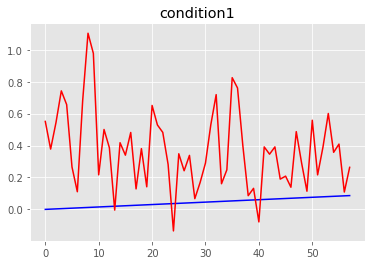

MSE condition1: 0.17171216311444615
R2 condition1: -265.9300511489818


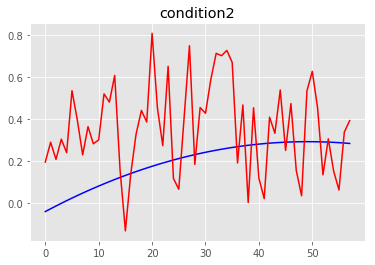

MSE condition2: 0.0777160404576058
R2 condition2: -6.611912383904536


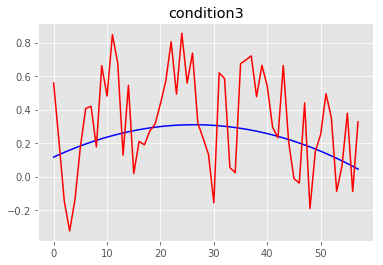

MSE condition3: 0.0841584297437583
R2 condition3: -14.639102149832503


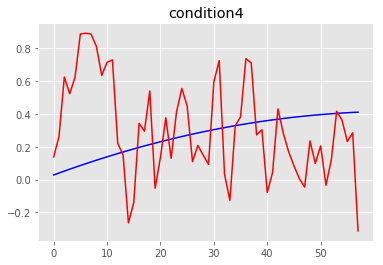

MSE condition4: 0.13123993111091126
R2 condition4: -8.941208294213881
==== the test person number # 10 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39044430e-09 4.58807365e-09 3.93517959e-09 3.96267740e-09]
Global min values from training is:  [-4.37827926e-09 -4.598

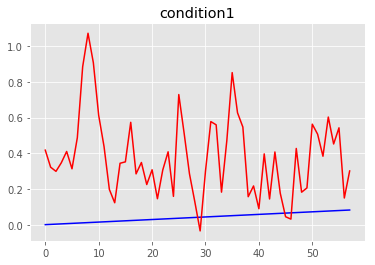

MSE condition1: 0.16805122025816624
R2 condition1: -289.2289082248615


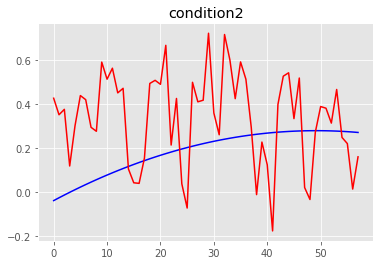

MSE condition2: 0.07871717544855364
R2 condition2: -7.389968292110922


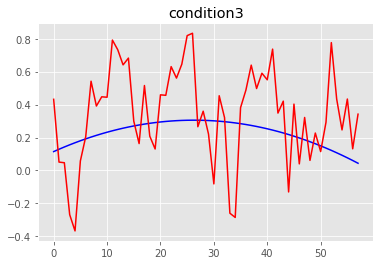

MSE condition3: 0.0906420160046559
R2 condition3: -16.32130101420341


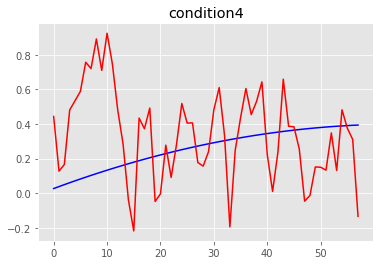

MSE condition4: 0.10541442552332259
R2 condition4: -7.703979365946614
==== the test person number # 10 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13495985e-09 4.34970896e-09 3.60456974e-09 3.75166167e-09]
Global min values from training is:  [-4.11622616e-09 -4.361

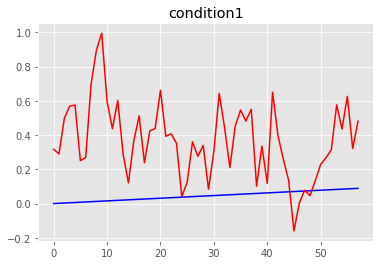

MSE condition1: 0.1575975134704697
R2 condition1: -230.53609180536432


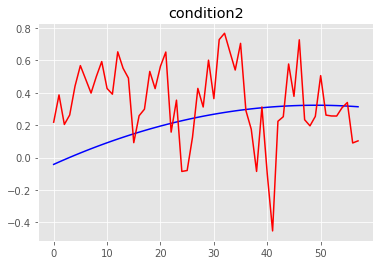

MSE condition2: 0.09470963708045504
R2 condition2: -6.654245573075186


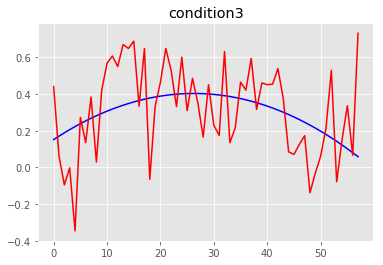

MSE condition3: 0.05277976559770767
R2 condition3: -4.793917020970318


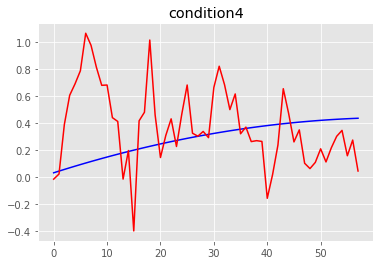

MSE condition4: 0.12843503786649843
R2 condition4: -7.755225564615687
==== the test person number # 10 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43751818e-09 4.64420657e-09 4.02031168e-09 4.01804586e-09]
Global min values from training is:  [-4.42444219e-09 -4.653

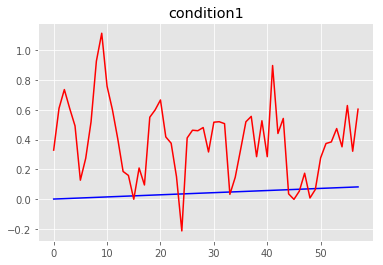

MSE condition1: 0.19000238845211473
R2 condition1: -328.6940783893109


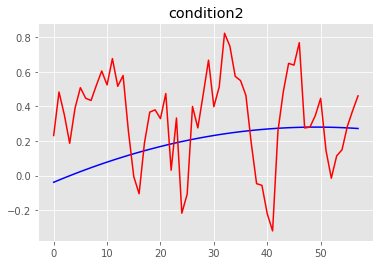

MSE condition2: 0.10427315576465573
R2 condition2: -10.088631616295087


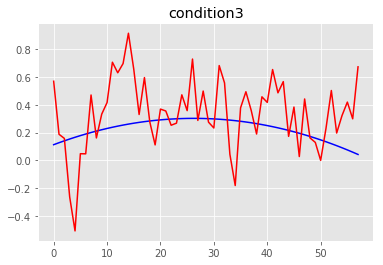

MSE condition3: 0.07692468521217453
R2 condition3: -13.92870286453776


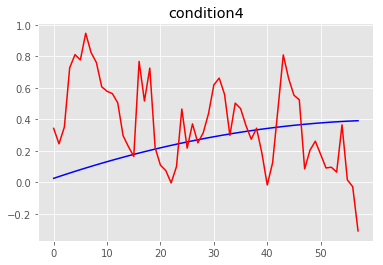

MSE condition4: 0.12458469101095546
R2 condition4: -9.37712124305224
==== the test person number # 11 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.85131932e-09 3.66696108e-09 3.52645263e-09 3.44362682e-09]
Global min values from training is:  [-3.84804139e-09 -3.6829

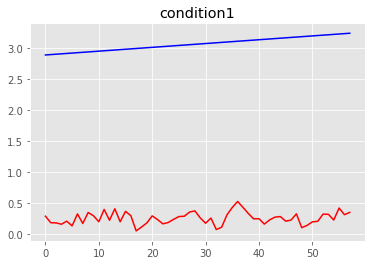

MSE condition1: 7.920536870218603
R2 condition1: -744.8358630969557


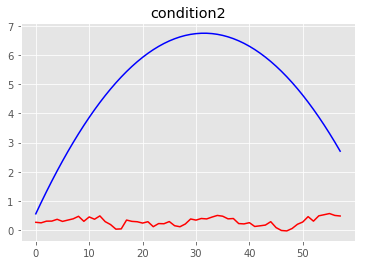

MSE condition2: 24.558558135470314
R2 condition2: -7.687627431785595


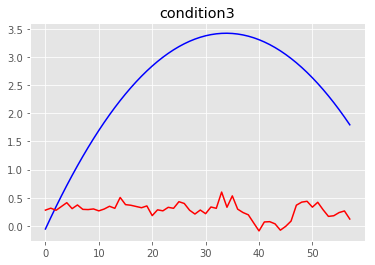

MSE condition3: 5.802225078685295
R2 condition3: -5.643170670553586


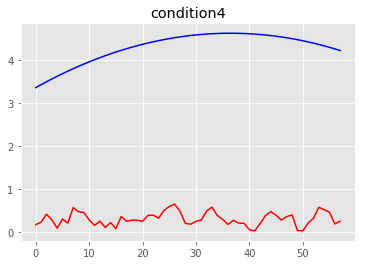

MSE condition4: 16.06385935141227
R2 condition4: -131.89492359472695
==== the test person number # 11 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.90675336e-09 4.13818573e-09 3.68811169e-09 3.65871650e-09]
Global min values from training is:  [-3.90036553e-09 -4.1516

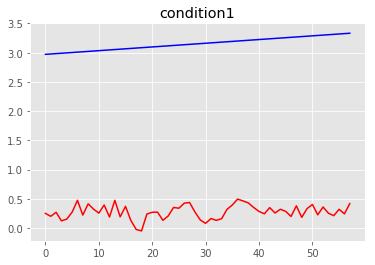

MSE condition1: 8.290217501987678
R2 condition1: -735.9199952769602


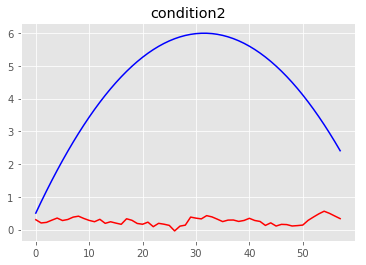

MSE condition2: 19.451095260956293
R2 condition2: -7.714478523103939


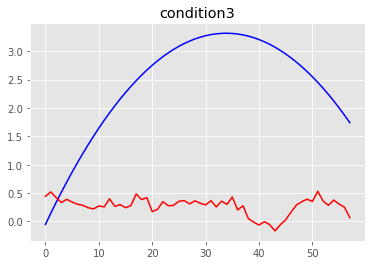

MSE condition3: 5.502251090721339
R2 condition3: -5.709996418455572


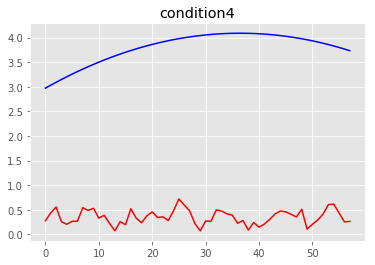

MSE condition4: 12.003500851954108
R2 condition4: -126.32213014617618
==== the test person number # 11 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96001687e-09 4.18159003e-09 3.74779986e-09 3.61891930e-09]
Global min values from training is:  [-3.95583773e-09 -4.194

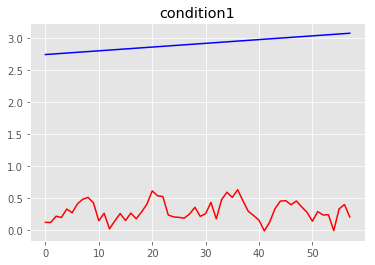

MSE condition1: 6.8335052124623115
R2 condition1: -714.655066018394


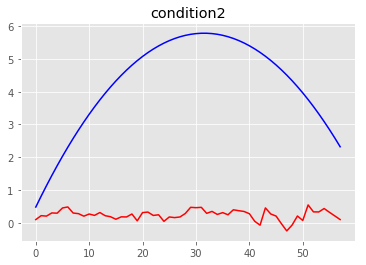

MSE condition2: 18.05201107258367
R2 condition2: -7.687143053966539


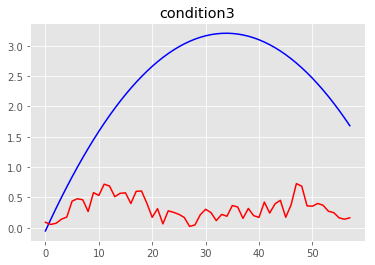

MSE condition3: 4.823552684941048
R2 condition3: -5.295255093466604


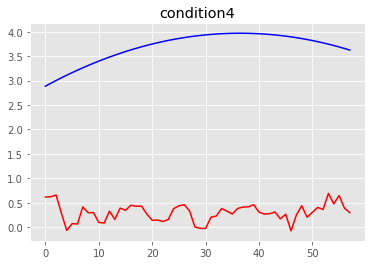

MSE condition4: 11.627793846683081
R2 condition4: -129.7703555336575
==== the test person number # 11 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.94798369e-09 4.14286319e-09 3.74068645e-09 3.61620046e-09]
Global min values from training is:  [-3.94507138e-09 -4.1561

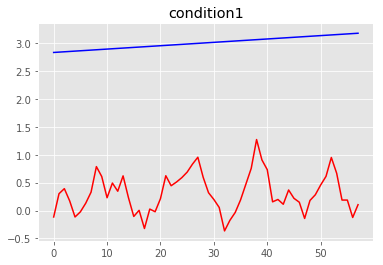

MSE condition1: 7.370147610309792
R2 condition1: -717.9376074003153


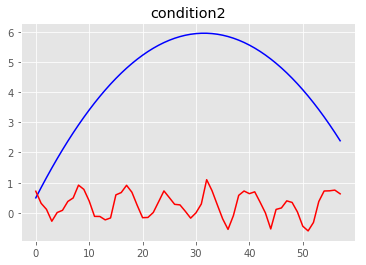

MSE condition2: 19.275984901643795
R2 condition2: -7.764857926411002


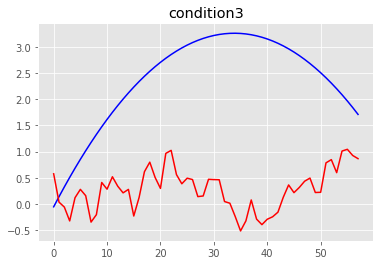

MSE condition3: 5.344289754135634
R2 condition3: -5.740178670608815


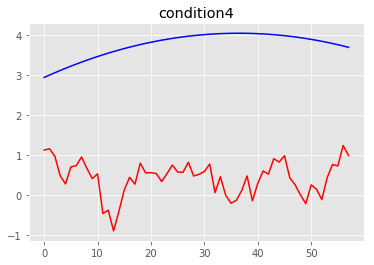

MSE condition4: 11.394089953058494
R2 condition4: -122.70236549419702
==== the test person number # 11 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03419651e-09 4.26367906e-09 3.72656121e-09 3.70048123e-09]
Global min values from training is:  [-4.02888591e-09 -4.278

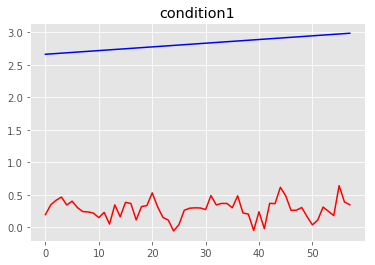

MSE condition1: 6.502929519031827
R2 condition1: -719.9101796384371


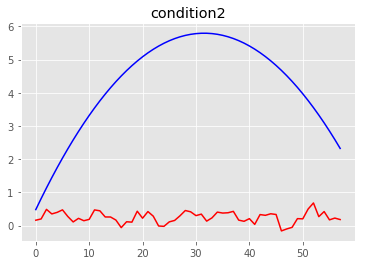

MSE condition2: 18.14094270408902
R2 condition2: -7.690145108192112


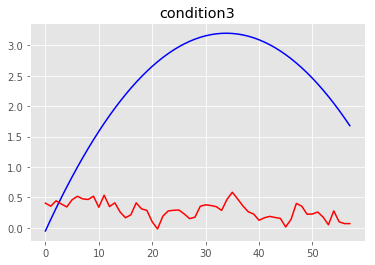

MSE condition3: 5.014084479005797
R2 condition3: -5.564077961812769


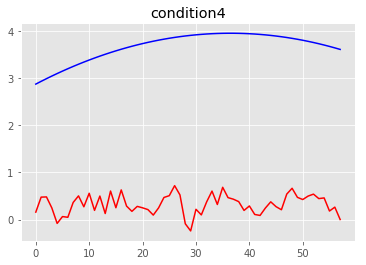

MSE condition4: 11.314814456654938
R2 condition4: -127.8077376816652
==== the test person number # 11 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01469873e-09 3.98455637e-09 3.71962270e-09 3.65567808e-09]
Global min values from training is:  [-4.01033736e-09 -3.9813

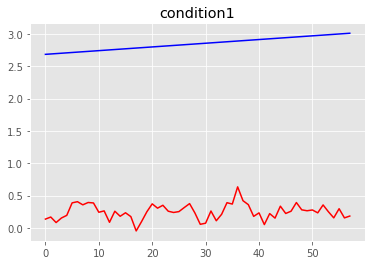

MSE condition1: 6.766910994865679
R2 condition1: -736.0355565936995


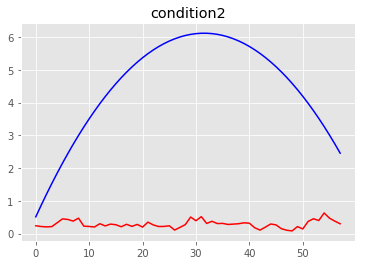

MSE condition2: 19.99395666203798
R2 condition2: -7.605258380551785


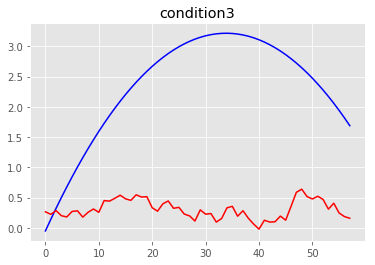

MSE condition3: 4.941119420336502
R2 condition3: -5.399507404453512


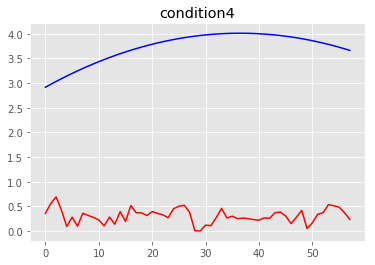

MSE condition4: 11.817733328816864
R2 condition4: -129.306842614884
==== the test person number # 11 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01531542e-09 4.25113105e-09 3.74128381e-09 3.67485321e-09]
Global min values from training is:  [-4.01067749e-09 -4.26565

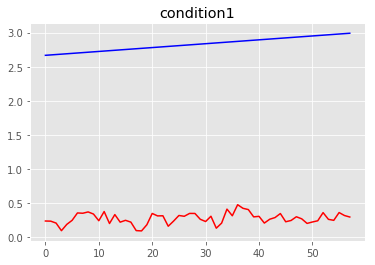

MSE condition1: 6.55555250704339
R2 condition1: -722.0443679395921


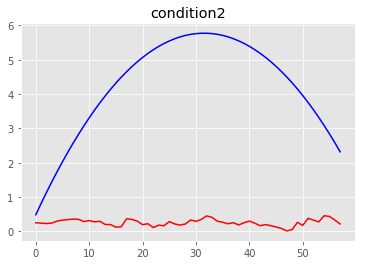

MSE condition2: 17.9771552174664
R2 condition2: -7.677491678063186


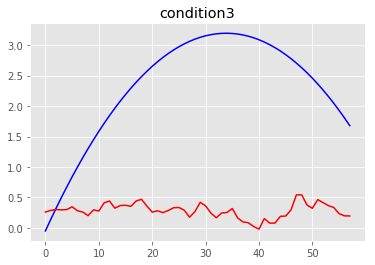

MSE condition3: 4.97767871159802
R2 condition3: -5.528246327908641


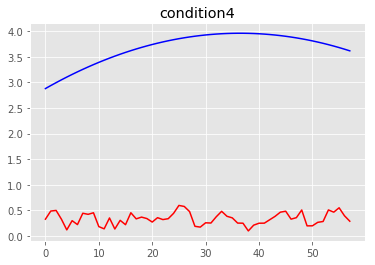

MSE condition4: 11.2891476455826
R2 condition4: -126.56916261645027
==== the test person number # 11 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.61085806e-09 3.90059710e-09 3.38545229e-09 3.28877976e-09]
Global min values from training is:  [-3.60981321e-09 -3.91431

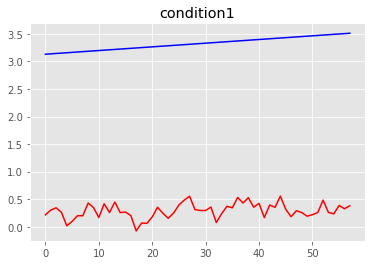

MSE condition1: 9.203716068789426
R2 condition1: -735.5404762144263


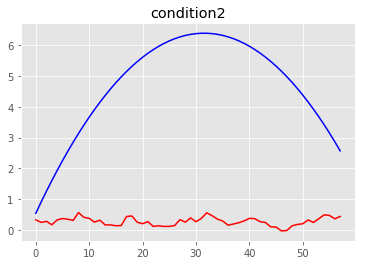

MSE condition2: 22.220295102064554
R2 condition2: -7.734833025983729


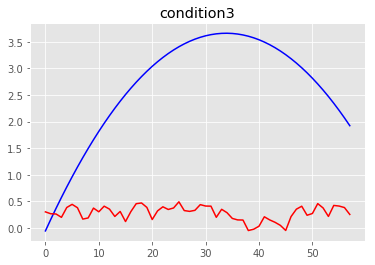

MSE condition3: 6.733512591847104
R2 condition3: -5.72556856274579


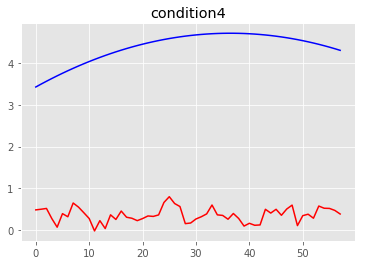

MSE condition4: 16.30137871263273
R2 condition4: -128.9948169672718
==== the test person number # 11 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99056774e-09 4.22496789e-09 3.72294697e-09 3.56315813e-09]
Global min values from training is:  [-3.98458088e-09 -4.23782

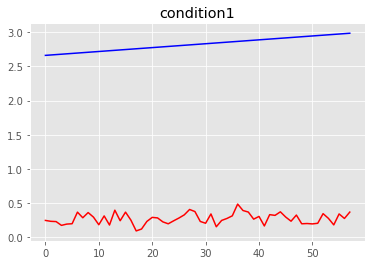

MSE condition1: 6.512685585325963
R2 condition1: -719.9604287426037


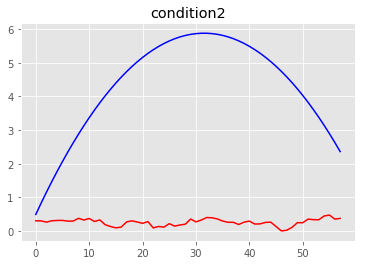

MSE condition2: 18.662103958777177
R2 condition2: -7.694047623534132


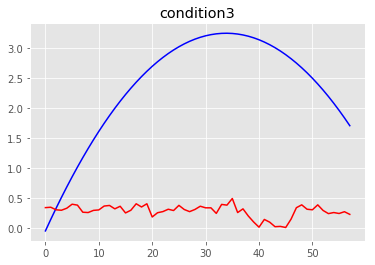

MSE condition3: 5.1564769052816475
R2 condition3: -5.5639964302301985


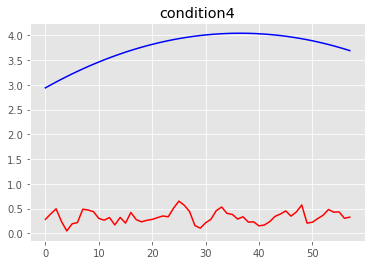

MSE condition4: 11.839577087071238
R2 condition4: -127.37134004653325
==== the test person number # 11 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.82298474e-09 4.13402385e-09 3.63649069e-09 3.50454928e-09]
Global min values from training is:  [-3.82100504e-09 -4.146

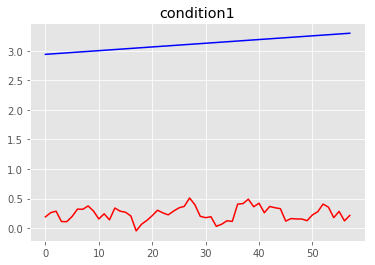

MSE condition1: 8.28006971663503
R2 condition1: -751.3205039938192


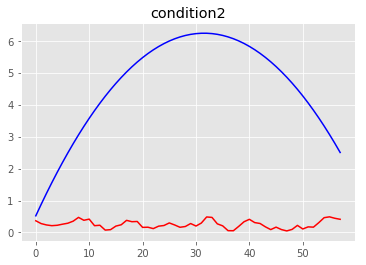

MSE condition2: 21.16982958880861
R2 condition2: -7.769706488618684


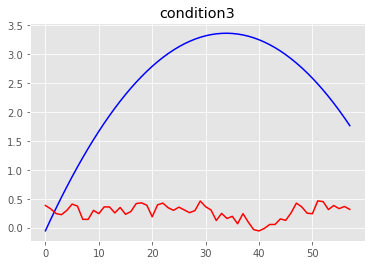

MSE condition3: 5.638603707134965
R2 condition3: -5.680354078804508


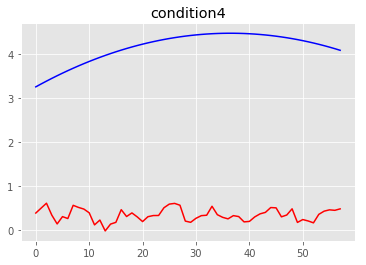

MSE condition4: 14.755324663245506
R2 condition4: -129.69827826254055
==== the test person number # 11 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97889942e-09 4.18855556e-09 3.67368186e-09 3.60467574e-09]
Global min values from training is:  [-3.97184628e-09 -4.200

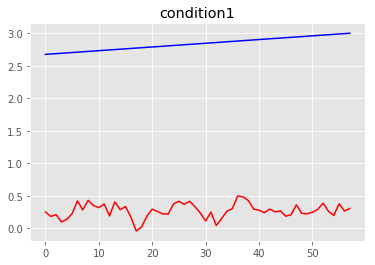

MSE condition1: 6.612481386208456
R2 condition1: -724.0335426781213


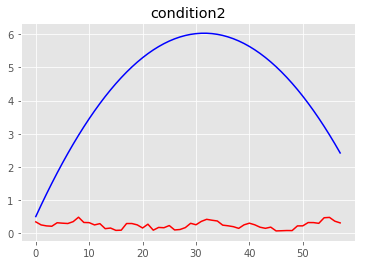

MSE condition2: 19.790849805421647
R2 condition2: -7.7636942207240764


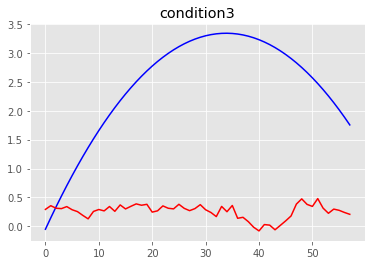

MSE condition3: 5.601918356802524
R2 condition3: -5.736807406826691


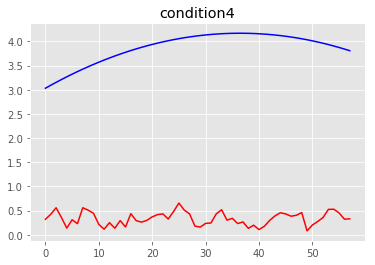

MSE condition4: 12.657272574648681
R2 condition4: -128.2561239803238
==== the test person number # 11 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.91992451e-09 4.11015353e-09 3.63315831e-09 3.59432516e-09]
Global min values from training is:  [-3.91492751e-09 -4.1239

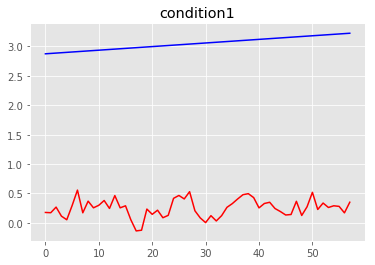

MSE condition1: 7.859986308937872
R2 condition1: -744.5253334278065


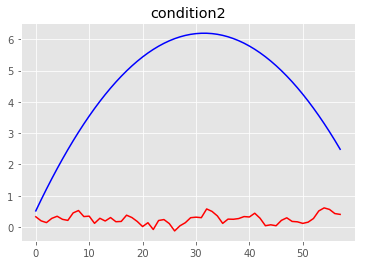

MSE condition2: 20.860667277003344
R2 condition2: -7.756322459572017


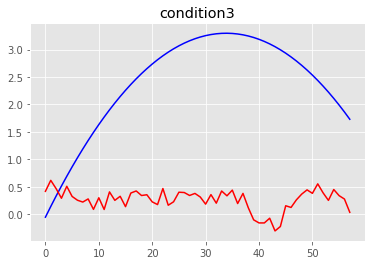

MSE condition3: 5.495834722472908
R2 condition3: -5.776611124209852


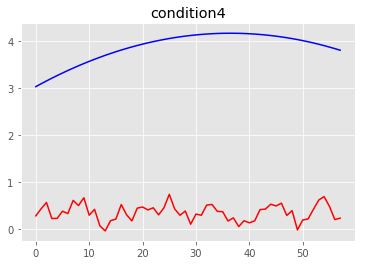

MSE condition4: 12.594123470706192
R2 condition4: -127.26664704460921
==== the test person number # 11 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97427556e-09 4.19869962e-09 3.67988046e-09 3.66344718e-09]
Global min values from training is:  [-3.97088609e-09 -4.214

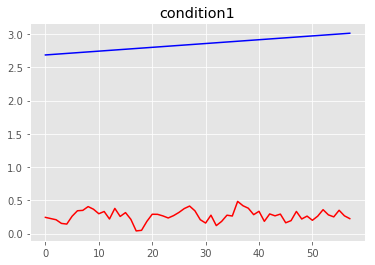

MSE condition1: 6.674812377843322
R2 condition1: -725.1722512584064


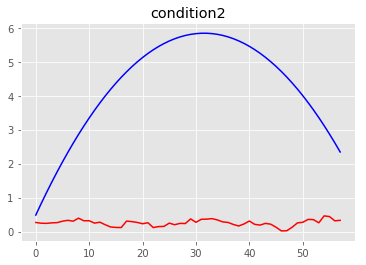

MSE condition2: 18.37294360854261
R2 condition2: -7.677847920670031


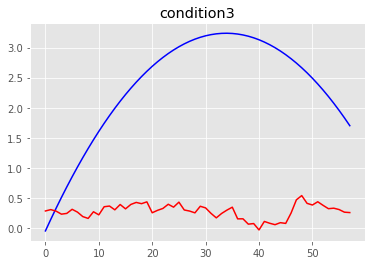

MSE condition3: 5.134087857658521
R2 condition3: -5.558710513056655


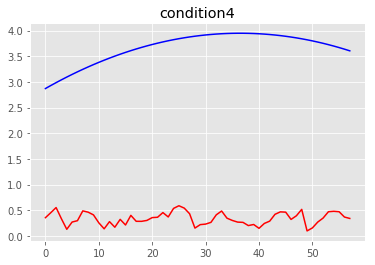

MSE condition4: 11.215218429139245
R2 condition4: -126.45587256405082
==== the test person number # 11 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.71879111e-09 3.96033493e-09 3.34927062e-09 3.45243146e-09]
Global min values from training is:  [-3.70883299e-09 -3.977

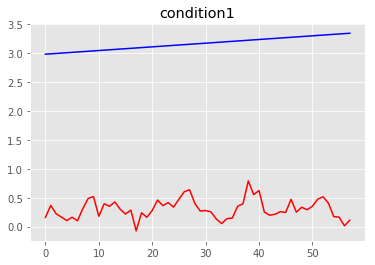

MSE condition1: 8.214954885985806
R2 condition1: -722.2332348162942


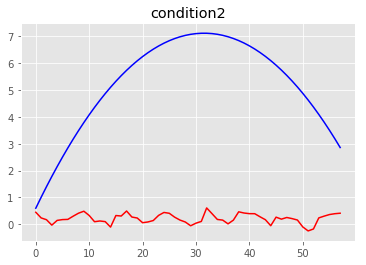

MSE condition2: 28.17562115238909
R2 condition2: -7.972513532610222


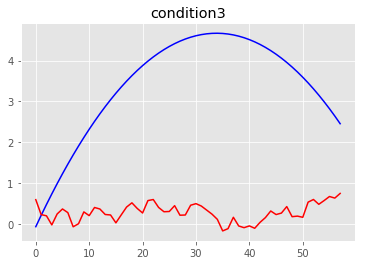

MSE condition3: 11.460302334055388
R2 condition3: -6.048929175761732


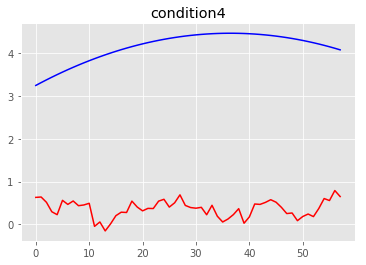

MSE condition4: 14.480814998444584
R2 condition4: -127.74673822759718
==== the test person number # 11 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02134944e-09 4.25483254e-09 3.76501255e-09 3.71881565e-09]
Global min values from training is:  [-4.01704903e-09 -4.269

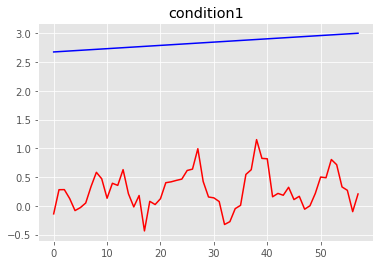

MSE condition1: 6.656227032385849
R2 condition1: -727.5885676985001


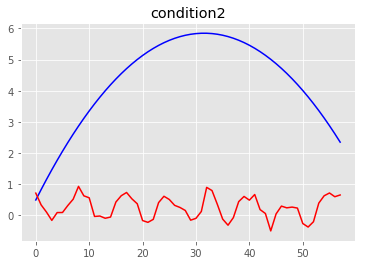

MSE condition2: 18.644438818003213
R2 condition2: -7.778457221599631


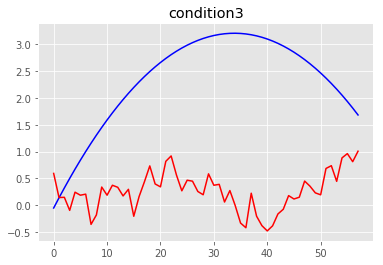

MSE condition3: 5.251883915435312
R2 condition3: -5.8413380344054815


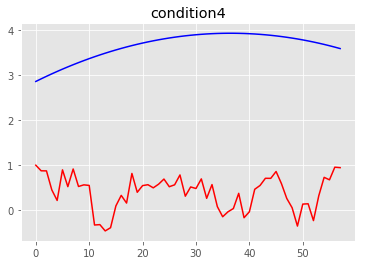

MSE condition4: 10.929030150682902
R2 condition4: -124.58194304415476
==== the test person number # 12 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20851316e-09 3.97793309e-09 3.74122821e-09 3.73250645e-09]
Global min values from training is:  [-4.19851579e-09 -3.990

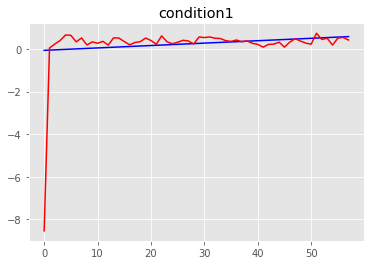

MSE condition1: 1.3041939412763928
R2 condition1: -35.43696757884169


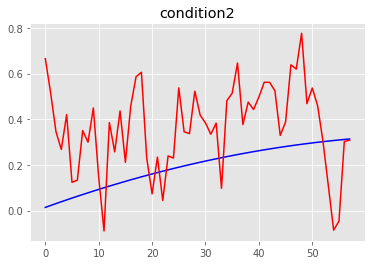

MSE condition2: 0.0692410439293321
R2 condition2: -7.7205613756321


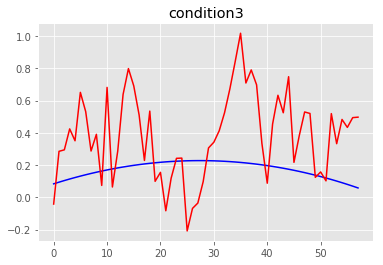

MSE condition3: 0.11524162006835605
R2 condition3: -47.296743632380156


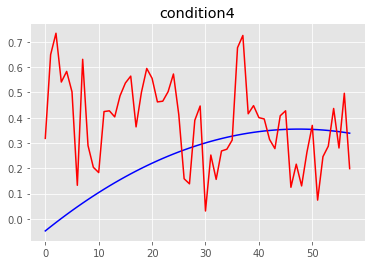

MSE condition4: 0.07691727636334822
R2 condition4: -4.171527653772215
==== the test person number # 12 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26394720e-09 4.44915774e-09 3.90288727e-09 3.94759614e-09]
Global min values from training is:  [-4.25083993e-09 -4.459

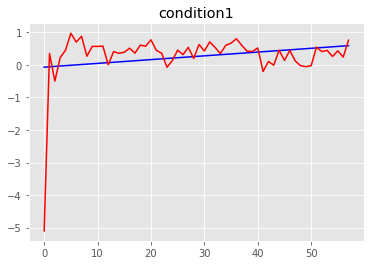

MSE condition1: 0.5771247326217689
R2 condition1: -14.393183369970794


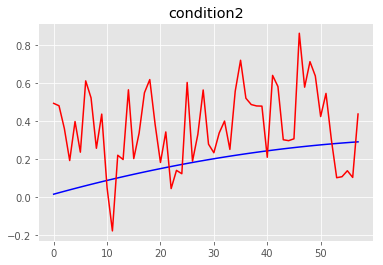

MSE condition2: 0.07901002728383875
R2 condition2: -10.793063652906401


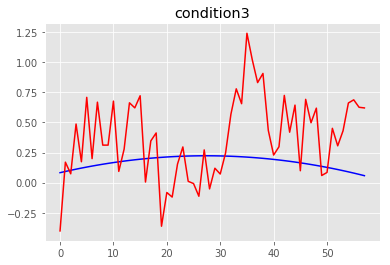

MSE condition3: 0.15674801334327473
R2 condition3: -67.99032530533673


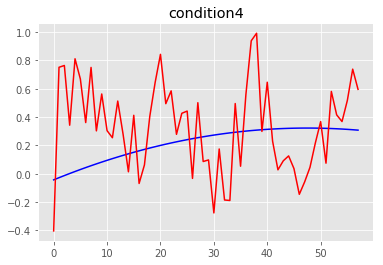

MSE condition4: 0.13780229683988496
R2 condition4: -10.234548111227411
==== the test person number # 12 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31721071e-09 4.49256203e-09 3.96257543e-09 3.90779894e-09]
Global min values from training is:  [-4.30631213e-09 -4.50

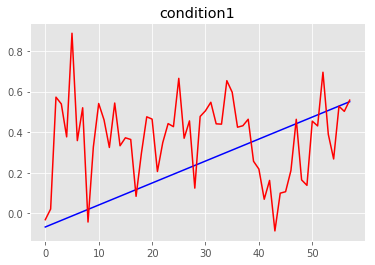

MSE condition1: 0.09007409662007568
R2 condition1: -1.7430949186461953


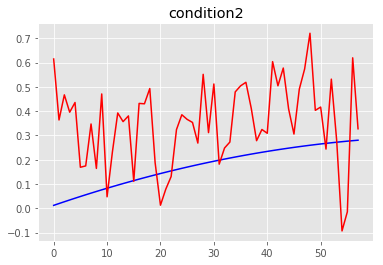

MSE condition2: 0.06377125394955827
R2 condition2: -9.031632758579331


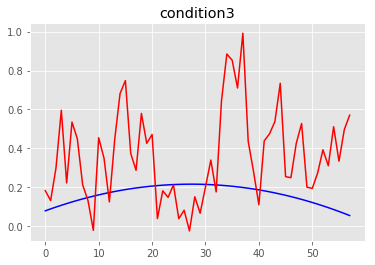

MSE condition3: 0.09643793272051934
R2 condition3: -43.75894044891736


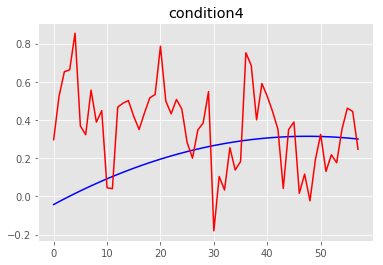

MSE condition4: 0.09526125573619096
R2 condition4: -7.133157329611738
==== the test person number # 12 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30517753e-09 4.45383519e-09 3.95546202e-09 3.90508009e-09]
Global min values from training is:  [-4.29554578e-09 -4.463

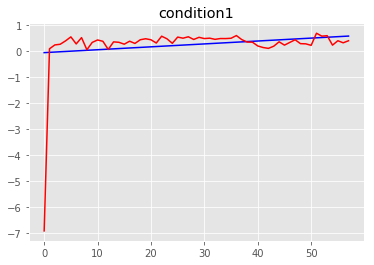

MSE condition1: 0.8654679148643936
R2 condition1: -23.879261541048713


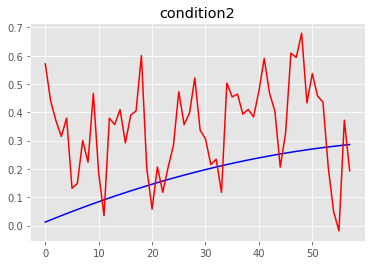

MSE condition2: 0.05686876184023762
R2 condition2: -7.58069548119885


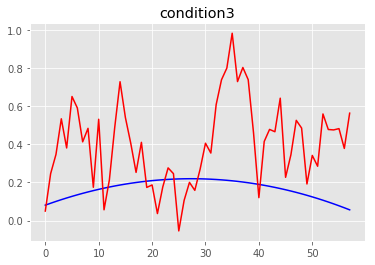

MSE condition3: 0.10640493905249616
R2 condition3: -47.07792869952048


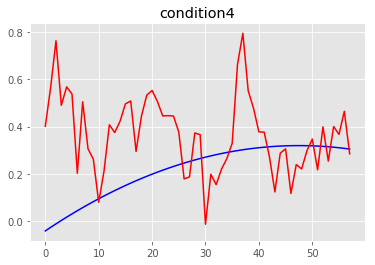

MSE condition4: 0.07095407023067468
R2 condition4: -4.891537113835239
==== the test person number # 12 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39139035e-09 4.57465106e-09 3.94133679e-09 3.98936087e-09]
Global min values from training is:  [-4.37936031e-09 -4.586

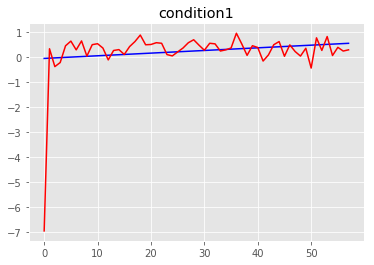

MSE condition1: 0.93386319915765
R2 condition1: -28.79312683884988


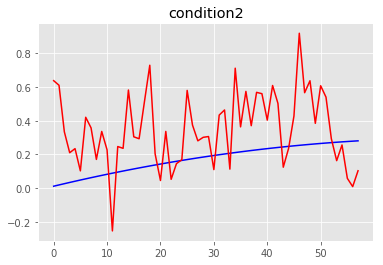

MSE condition2: 0.07907285157611531
R2 condition2: -11.396830183014126


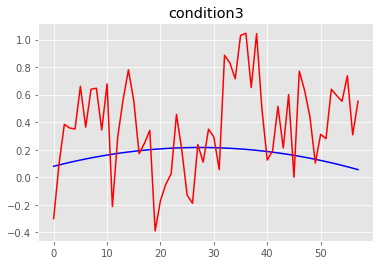

MSE condition3: 0.16203560615121143
R2 condition3: -74.38608150135653


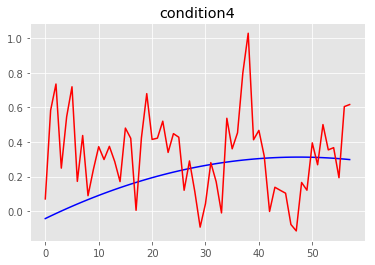

MSE condition4: 0.08727518492666214
R2 condition4: -6.523416241457676
==== the test person number # 12 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37189258e-09 4.29552838e-09 3.93439827e-09 3.94455772e-09]
Global min values from training is:  [-4.36081176e-09 -4.289

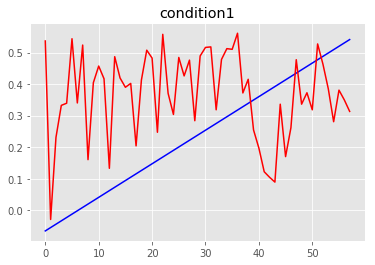

MSE condition1: 0.0695754854349853
R2 condition1: -1.1877986712749524


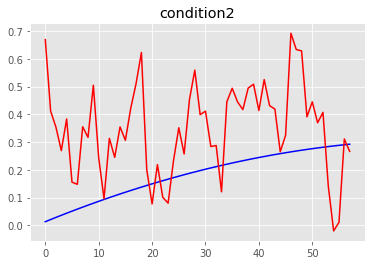

MSE condition2: 0.05929635758455452
R2 condition2: -7.595435994557855


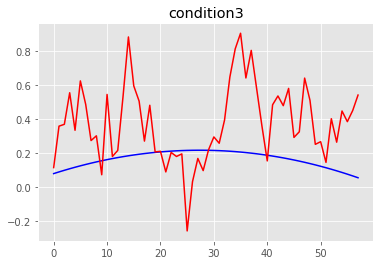

MSE condition3: 0.0982859792967979
R2 condition3: -44.34341410084335


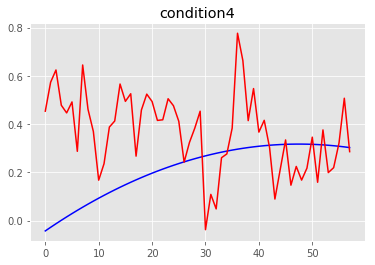

MSE condition4: 0.07522494517279493
R2 condition4: -5.323031241088718
==== the test person number # 12 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37250926e-09 4.56210305e-09 3.95605939e-09 3.96373285e-09]
Global min values from training is:  [-4.36115189e-09 -4.573

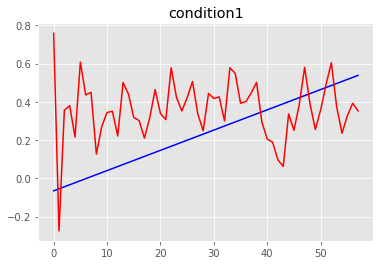

MSE condition1: 0.06960381080388149
R2 condition1: -1.2113144655450303


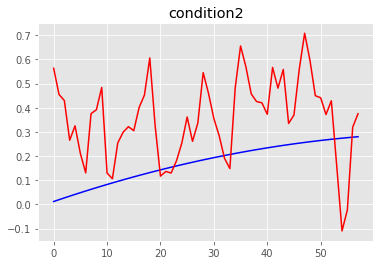

MSE condition2: 0.06379995714939254
R2 condition2: -9.058713868711262


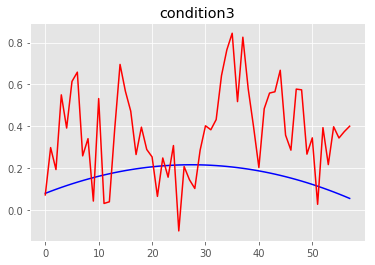

MSE condition3: 0.08872379498196015
R2 condition3: -40.33703958992308


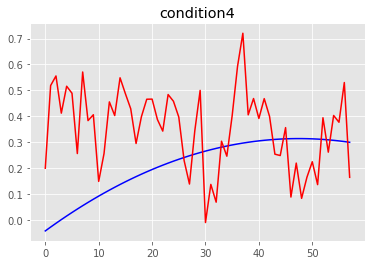

MSE condition4: 0.06355461290969434
R2 condition4: -4.446655167576006
==== the test person number # 12 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96805190e-09 4.21156910e-09 3.60022786e-09 3.57765940e-09]
Global min values from training is:  [-3.96028761e-09 -4.222

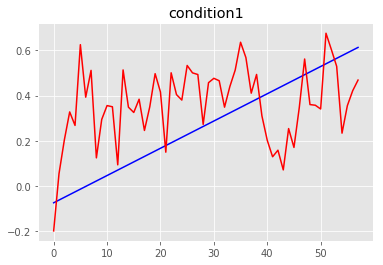

MSE condition1: 0.06022145641420208
R2 condition1: -0.4770709784522553


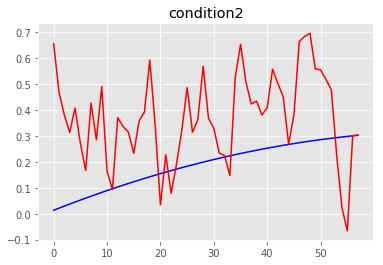

MSE condition2: 0.06588439448106198
R2 condition2: -7.94526367143963


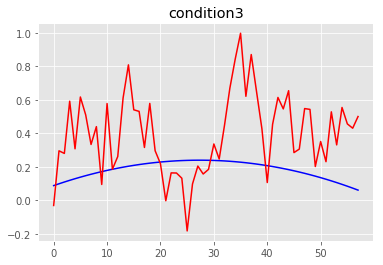

MSE condition3: 0.10443451518923567
R2 condition3: -38.41222581778594


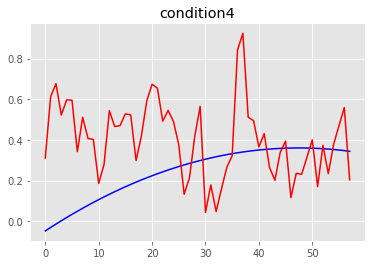

MSE condition4: 0.08770028642228714
R2 condition4: -4.7335378131278985
==== the test person number # 12 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34776158e-09 4.53593989e-09 3.93772255e-09 3.85203777e-09]
Global min values from training is:  [-4.33505528e-09 -4.54

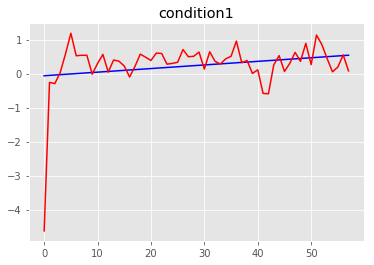

MSE condition1: 0.511872528927807
R2 condition1: -15.311207658852215


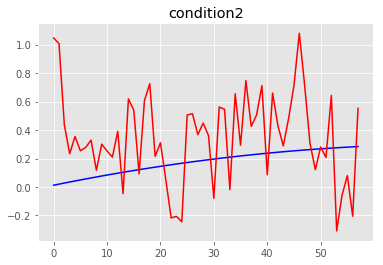

MSE condition2: 0.14010817027270758
R2 condition2: -20.519756945865566


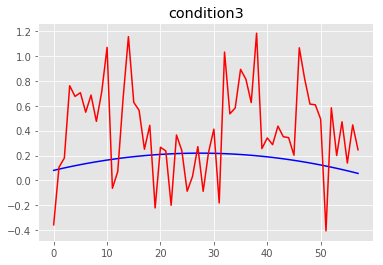

MSE condition3: 0.19199001375196795
R2 condition3: -86.38144146357736


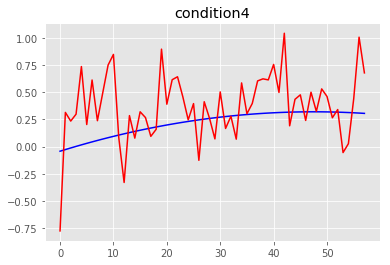

MSE condition4: 0.11407005486457394
R2 condition4: -8.461860267143571
==== the test person number # 12 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.18017858e-09 4.44499586e-09 3.85126626e-09 3.79342892e-09]
Global min values from training is:  [-4.17147944e-09 -4.454

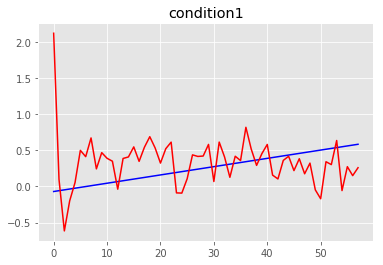

MSE condition1: 0.18440773827322784
R2 condition1: -4.005868145621233


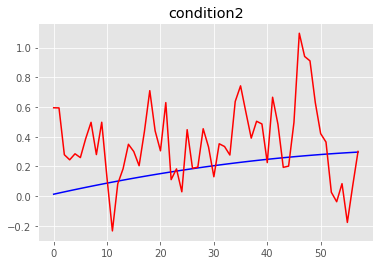

MSE condition2: 0.09854805166385991
R2 condition2: -12.894927205147248


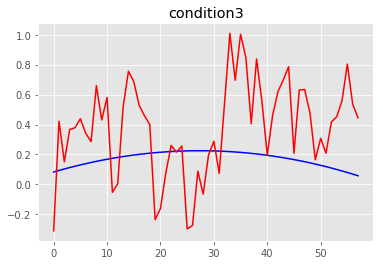

MSE condition3: 0.14542101912440106
R2 condition3: -61.5815357993965


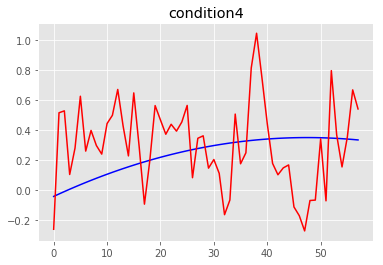

MSE condition4: 0.10416879647683752
R2 condition4: -6.38077108644684
==== the test person number # 12 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33609326e-09 4.49952756e-09 3.88845744e-09 3.89355538e-09]
Global min values from training is:  [-4.32232067e-09 -4.5084

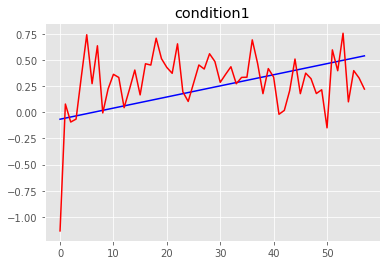

MSE condition1: 0.09645697821605884
R2 condition1: -2.0496769745628027


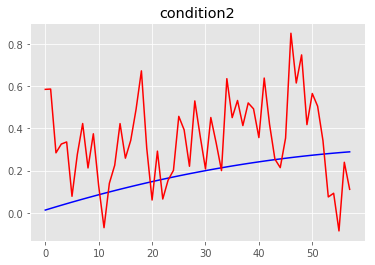

MSE condition2: 0.06969677875879782
R2 condition2: -9.31458287268229


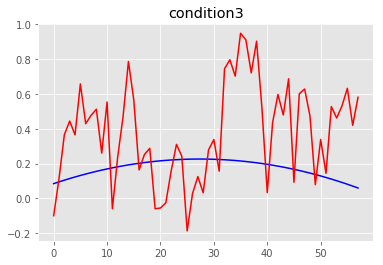

MSE condition3: 0.1250972733483965
R2 condition3: -53.46428640449995


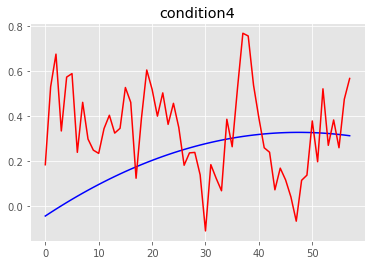

MSE condition4: 0.07244079711175173
R2 condition4: -4.732560011661128
==== the test person number # 12 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.91992451e-09 4.11015353e-09 3.63315831e-09 3.59432516e-09]
Global min values from training is:  [-3.91492751e-09 -4.123

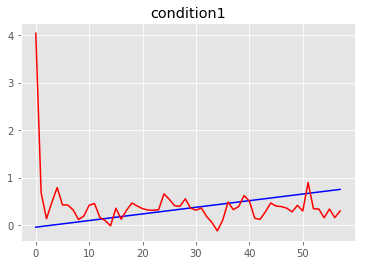

MSE condition1: 0.3774613702653436
R2 condition1: -5.914593646129285


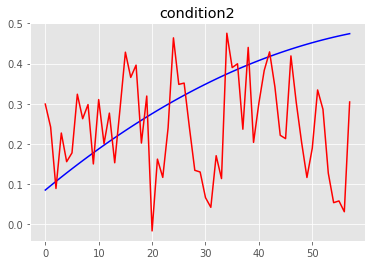

MSE condition2: 0.033430441985337275
R2 condition2: -1.496630535487116


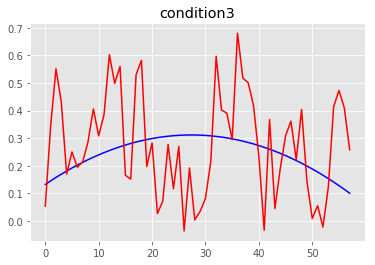

MSE condition3: 0.03934685868982224
R2 condition3: -9.632950966812011


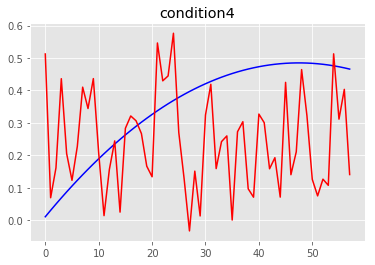

MSE condition4: 0.05848232445323182
R2 condition4: -1.8295509902876015
==== the test person number # 12 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33146940e-09 4.50967163e-09 3.89465604e-09 3.95232682e-09]
Global min values from training is:  [-4.32136049e-09 -4.52

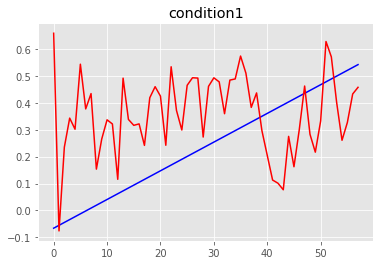

MSE condition1: 0.06431603527339842
R2 condition1: -1.0205219870493822


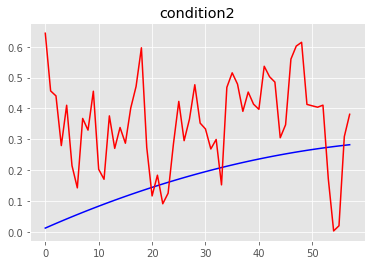

MSE condition2: 0.05810268980465714
R2 condition2: -8.014903931628712


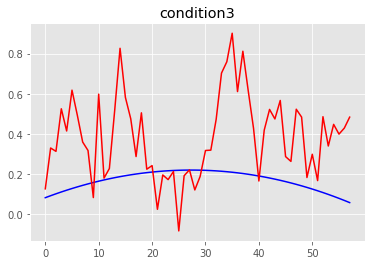

MSE condition3: 0.09254850017344927
R2 condition3: -41.23921247998431


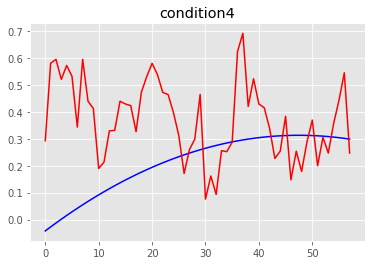

MSE condition4: 0.06895852622258522
R2 condition4: -4.93641574876348
==== the test person number # 12 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.07598495e-09 4.27130693e-09 3.56404619e-09 3.74131110e-09]
Global min values from training is:  [-4.05930739e-09 -4.2846

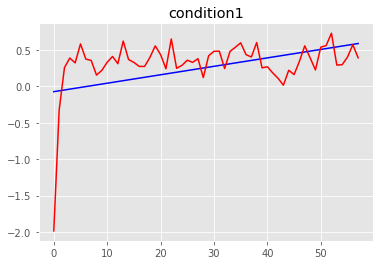

MSE condition1: 0.12586258444700107
R2 condition1: -2.3312137341300647


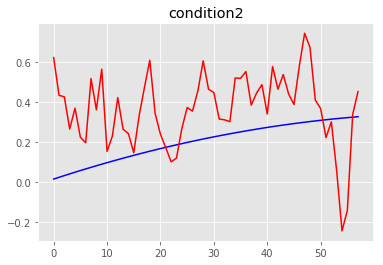

MSE condition2: 0.06771293525300788
R2 condition2: -6.921851786994226


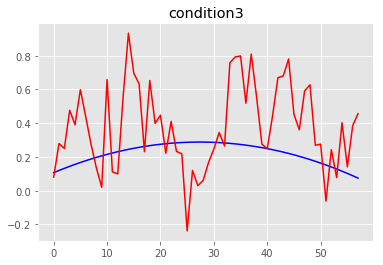

MSE condition3: 0.08804427520455645
R2 condition3: -22.2247010161015


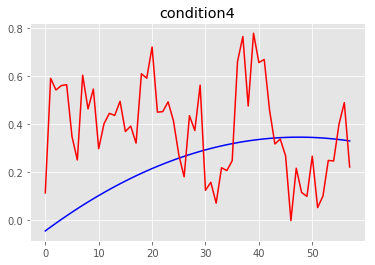

MSE condition4: 0.08460710143557043
R2 condition4: -5.012031619050518
==== the test person number # 12 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37854328e-09 4.56580454e-09 3.97978813e-09 4.00769529e-09]
Global min values from training is:  [-4.36752342e-09 -4.577

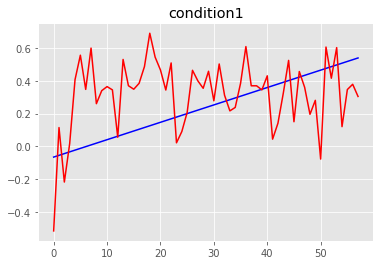

MSE condition1: 0.07259066162121623
R2 condition1: -1.2919010274079752


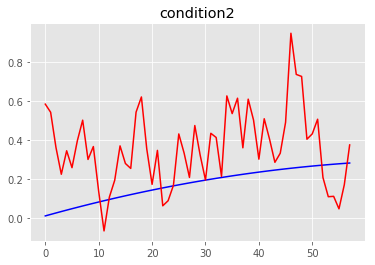

MSE condition2: 0.07346424612996733
R2 condition2: -10.372003164361953


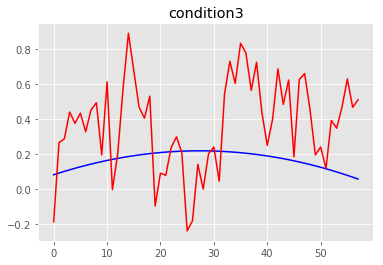

MSE condition3: 0.11150441743190091
R2 condition3: -50.67494456956571


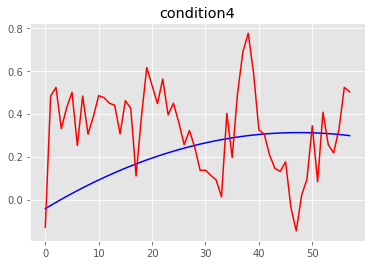

MSE condition4: 0.07189672533183324
R2 condition4: -5.243723505700182
==== the test person number # 13 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26286420e-09 4.06647918e-09 3.78795036e-09 3.80162848e-09]
Global min values from training is:  [-4.25447437e-09 -4.080

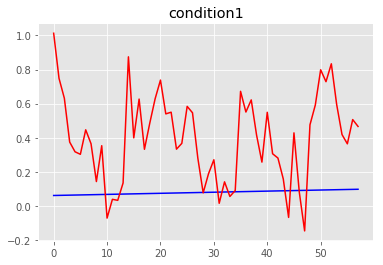

MSE condition1: 0.1647969139908861
R2 condition1: -1434.1110581841174


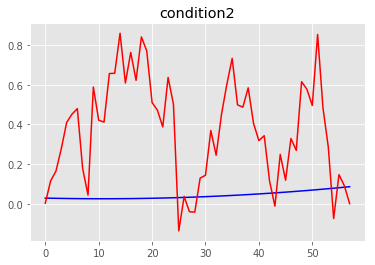

MSE condition2: 0.17795315633967845
R2 condition2: -528.6848330035797


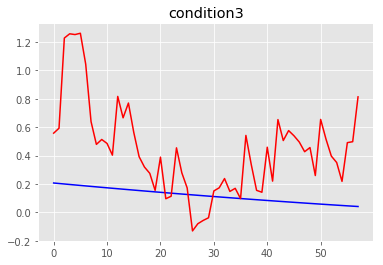

MSE condition3: 0.19759353920547237
R2 condition3: -82.3483950693182


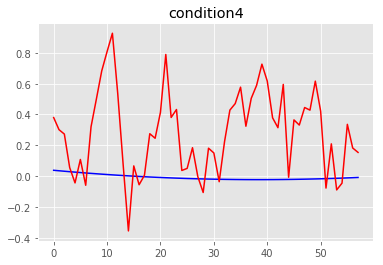

MSE condition4: 0.1583346985180741
R2 condition4: -539.1919807086781
==== the test person number # 13 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31829824e-09 4.53770383e-09 3.94960942e-09 4.01671816e-09]
Global min values from training is:  [-4.30679851e-09 -4.5495

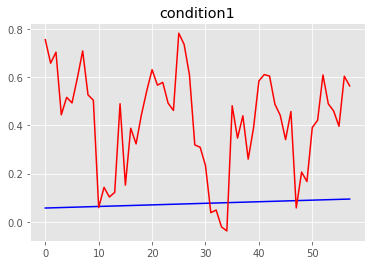

MSE condition1: 0.1609887242439667
R2 condition1: -1340.8295495605619


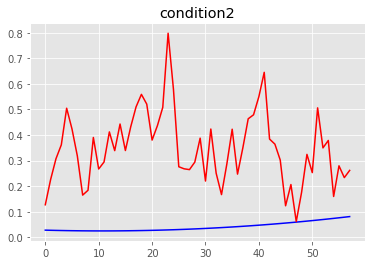

MSE condition2: 0.11542481085219039
R2 condition2: -403.2105470699731


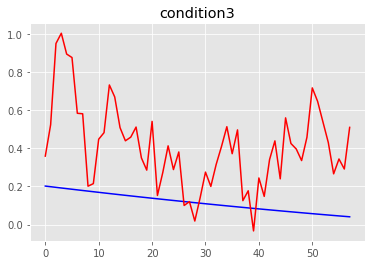

MSE condition3: 0.12926472081417975
R2 condition3: -56.224884585603085


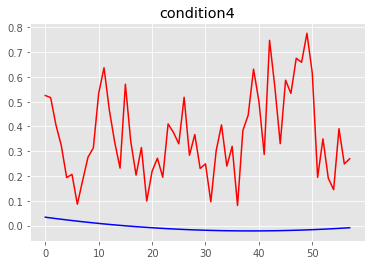

MSE condition4: 0.16916197523114784
R2 condition4: -692.9554649136044
==== the test person number # 13 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37156176e-09 4.58110812e-09 4.00929758e-09 3.97692096e-09]
Global min values from training is:  [-4.36227072e-09 -4.592

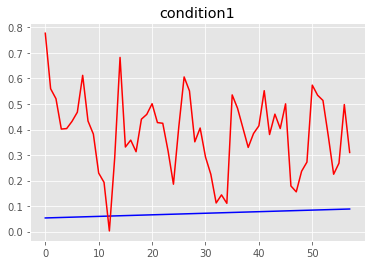

MSE condition1: 0.12218803708673033
R2 condition1: -1153.548183954638


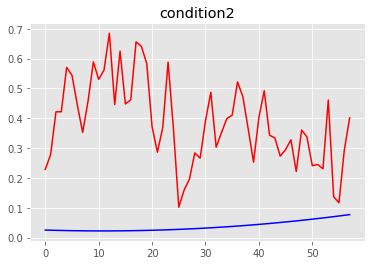

MSE condition2: 0.1433562599090897
R2 condition2: -526.958004759131


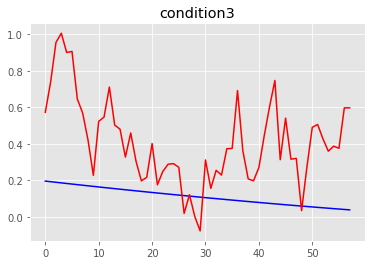

MSE condition3: 0.1368197496454827
R2 condition3: -62.82422049141108


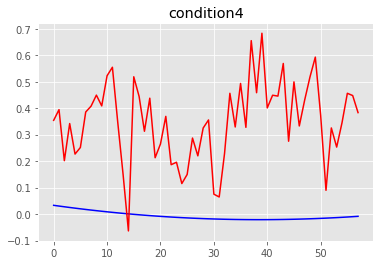

MSE condition4: 0.15037363979345567
R2 condition4: -643.7920882041178
==== the test person number # 13 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35952858e-09 4.54238128e-09 4.00218418e-09 3.97420212e-09]
Global min values from training is:  [-4.35150437e-09 -4.554

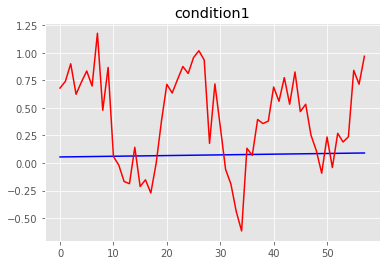

MSE condition1: 0.2830102106513438
R2 condition1: -2530.9570356743375


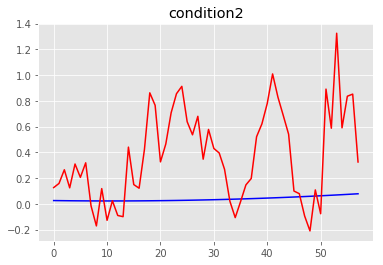

MSE condition2: 0.23322952278670037
R2 condition2: -824.2830200186389


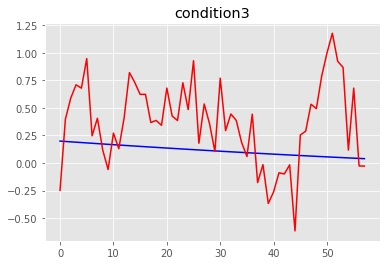

MSE condition3: 0.20134124299866069
R2 condition3: -90.47010509150876


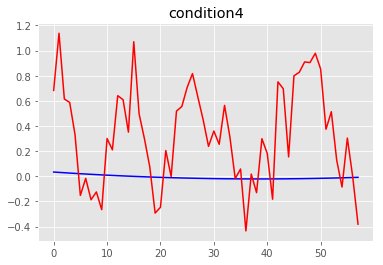

MSE condition4: 0.2670216625103082
R2 condition4: -1113.803105142114
==== the test person number # 13 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44574140e-09 4.66319716e-09 3.98805894e-09 4.05848289e-09]
Global min values from training is:  [-4.43531889e-09 -4.6765

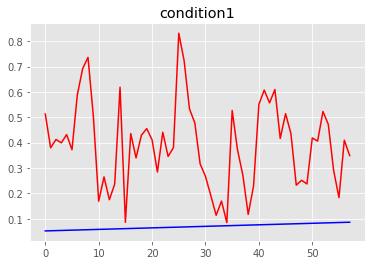

MSE condition1: 0.1336327965349424
R2 condition1: -1318.612228987046


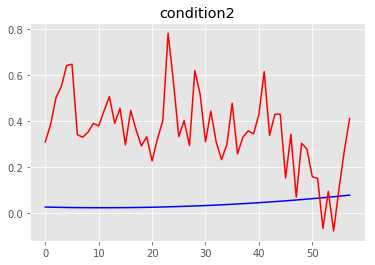

MSE condition2: 0.12977271548505884
R2 condition2: -475.38880820531796


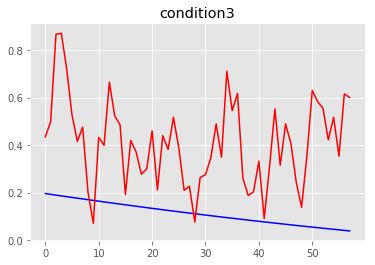

MSE condition3: 0.1212203552709248
R2 condition3: -55.68223861596269


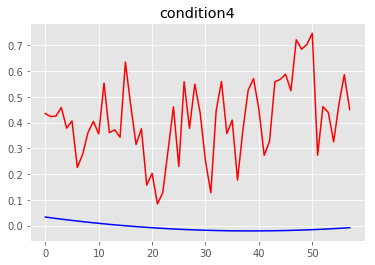

MSE condition4: 0.20100413857977684
R2 condition4: -868.8907161015115
==== the test person number # 13 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42624362e-09 4.38407447e-09 3.98112043e-09 4.01367974e-09]
Global min values from training is:  [-4.41677034e-09 -4.379

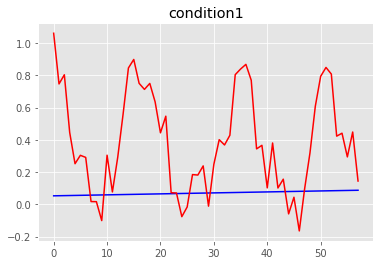

MSE condition1: 0.19877250911697544
R2 condition1: -1935.1080421247918


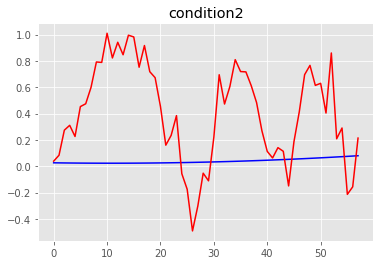

MSE condition2: 0.27424992764457745
R2 condition2: -932.8512831662948


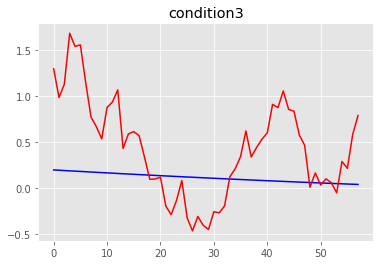

MSE condition3: 0.3615197427508215
R2 condition3: -166.64655116441259


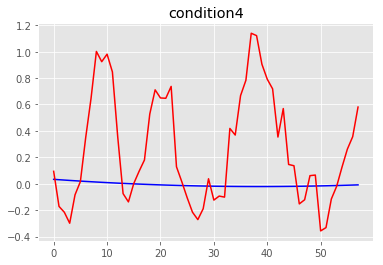

MSE condition4: 0.2476461045080861
R2 condition4: -1045.1089701897993
==== the test person number # 13 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42686031e-09 4.65064915e-09 4.00278154e-09 4.03285487e-09]
Global min values from training is:  [-4.41711047e-09 -4.663

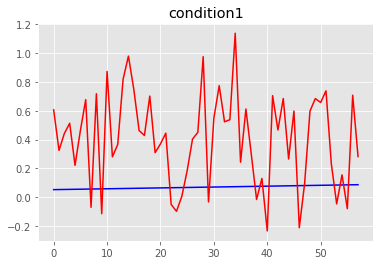

MSE condition1: 0.21705795754285845
R2 condition1: -2133.943542643088


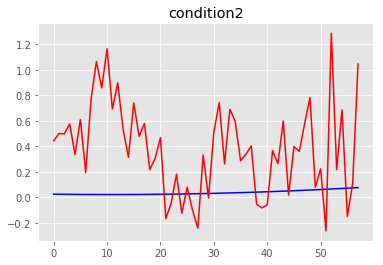

MSE condition2: 0.25160544359245984
R2 condition2: -927.6220075233956


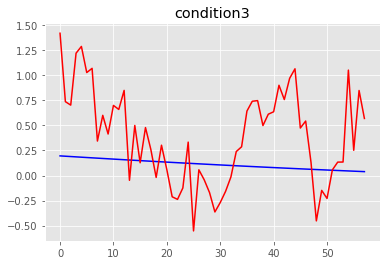

MSE condition3: 0.286347551328626
R2 condition3: -133.08344542509423


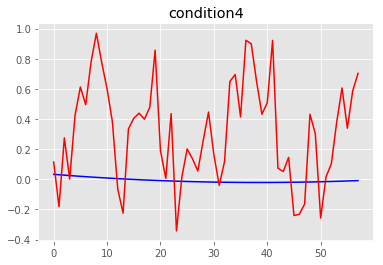

MSE condition4: 0.21735720803901754
R2 condition4: -934.3955613190019
==== the test person number # 13 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02240295e-09 4.30011519e-09 3.64695002e-09 3.64678142e-09]
Global min values from training is:  [-4.01624620e-09 -4.312

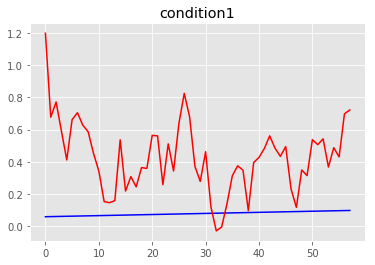

MSE condition1: 0.17306232424106405
R2 condition1: -1331.781449287838


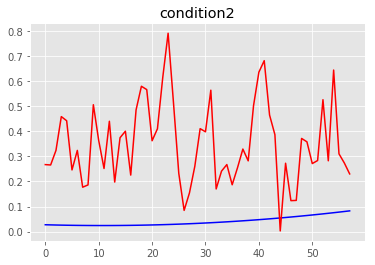

MSE condition2: 0.12340015084378662
R2 condition2: -393.6613229097492


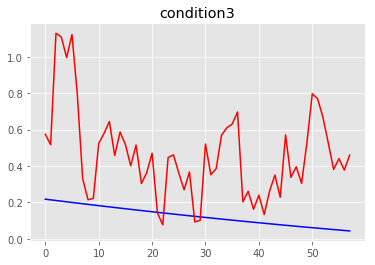

MSE condition3: 0.16842116979816854
R2 condition3: -63.07079869809738


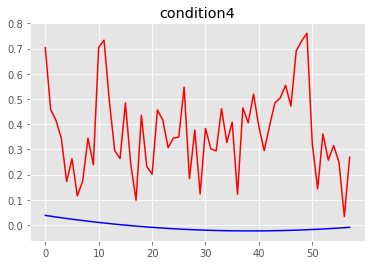

MSE condition4: 0.17125449410165788
R2 condition4: -567.8525434719728
==== the test person number # 13 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40211262e-09 4.62448599e-09 3.98444470e-09 3.92115979e-09]
Global min values from training is:  [-4.39101386e-09 -4.635

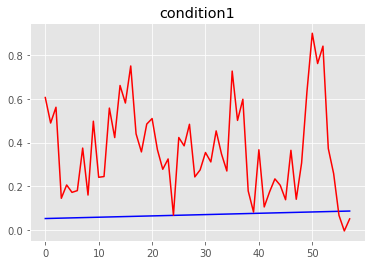

MSE condition1: 0.13207896068421376
R2 condition1: -1301.819796713353


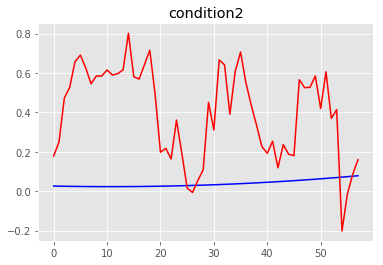

MSE condition2: 0.18630190013902853
R2 condition2: -669.5736455730005


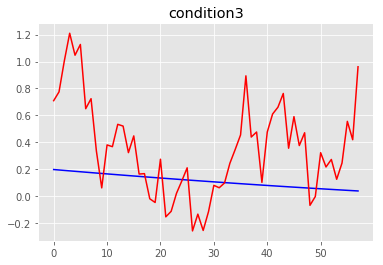

MSE condition3: 0.1739722484156481
R2 condition3: -78.60495169248875


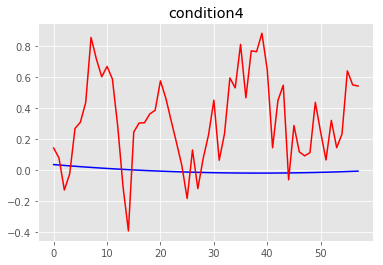

MSE condition4: 0.1873833613069005
R2 condition4: -780.5462549423975
==== the test person number # 13 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23452963e-09 4.53354195e-09 3.89798842e-09 3.86255094e-09]
Global min values from training is:  [-4.22743802e-09 -4.5445

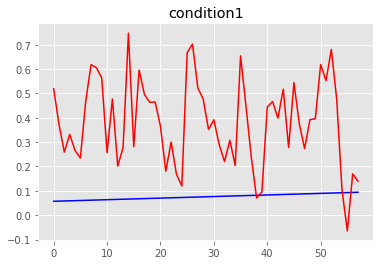

MSE condition1: 0.1255649724102184
R2 condition1: -1063.1164430957233


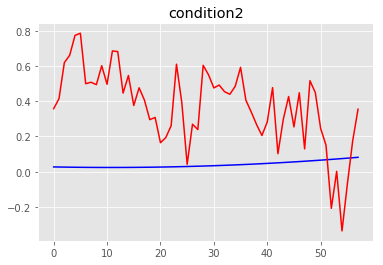

MSE condition2: 0.16414984478914932
R2 condition2: -543.3098740408703


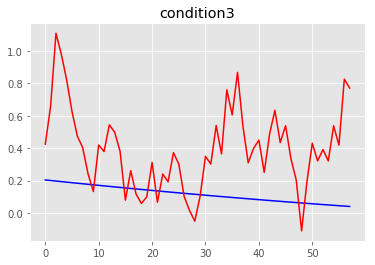

MSE condition3: 0.13982125391090167
R2 condition3: -59.54057519171016


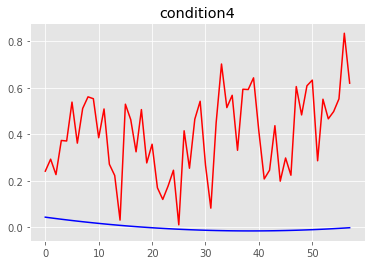

MSE condition4: 0.19299633161485588
R2 condition4: -691.2525489032136
==== the test person number # 13 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39044430e-09 4.58807365e-09 3.93517959e-09 3.96267740e-09]
Global min values from training is:  [-4.37827926e-09 -4.598

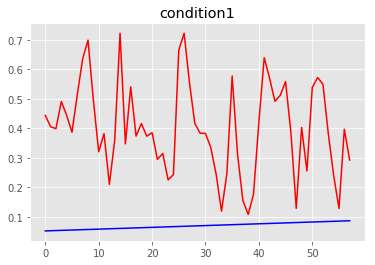

MSE condition1: 0.13529921042834397
R2 condition1: -1323.695381223491


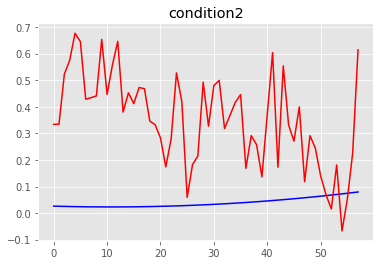

MSE condition2: 0.13274445754658976
R2 condition2: -460.07589840681794


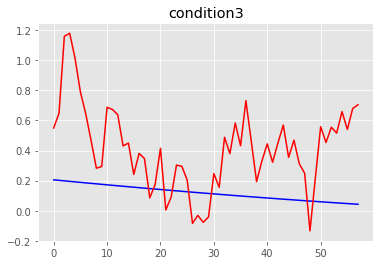

MSE condition3: 0.161166218336004
R2 condition3: -69.5865740188408


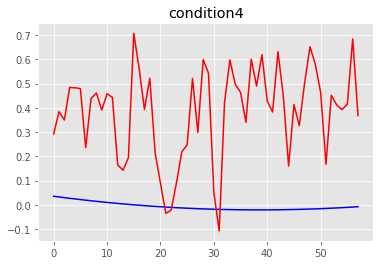

MSE condition4: 0.1861588443602129
R2 condition4: -741.1994249639249
==== the test person number # 13 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97427556e-09 4.19869962e-09 3.67988046e-09 3.66344718e-09]
Global min values from training is:  [-3.97088609e-09 -4.2140

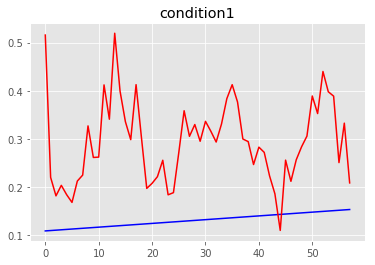

MSE condition1: 0.03384911560437881
R2 condition1: -197.24371681958056


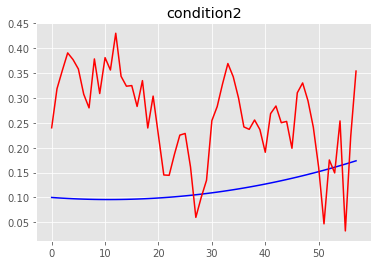

MSE condition2: 0.03044251642935664
R2 condition2: -54.17493239354775


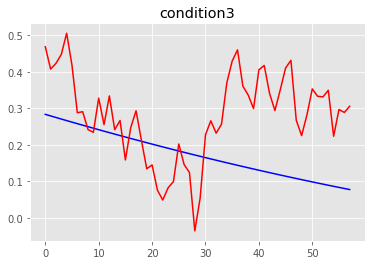

MSE condition3: 0.0287762694017834
R2 condition3: -6.88137252378922


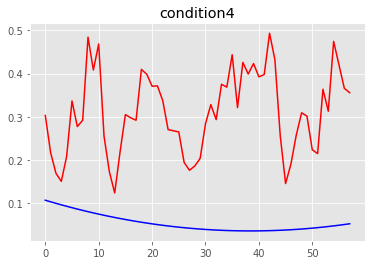

MSE condition4: 0.0758363903101831
R2 condition4: -188.23601487175435
==== the test person number # 13 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33146940e-09 4.50967163e-09 3.89465604e-09 3.95232682e-09]
Global min values from training is:  [-4.32136049e-09 -4.521

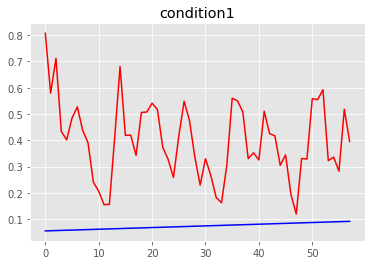

MSE condition1: 0.12891815173964322
R2 condition1: -1127.9023332640002


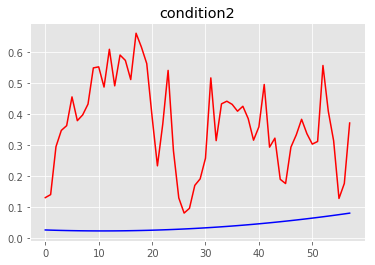

MSE condition2: 0.13047549767144215
R2 condition2: -435.6195578975316


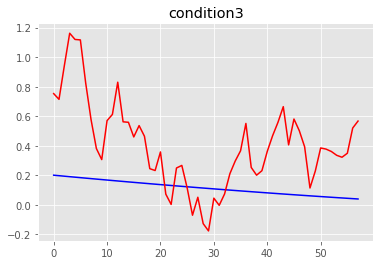

MSE condition3: 0.15905553014252677
R2 condition3: -70.01376764180183


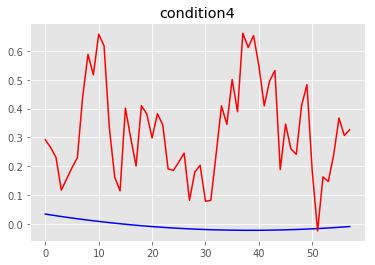

MSE condition4: 0.13422859471582402
R2 condition4: -533.0824459517876
==== the test person number # 13 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13033600e-09 4.35985303e-09 3.61076834e-09 3.81043312e-09]
Global min values from training is:  [-4.11526597e-09 -4.374

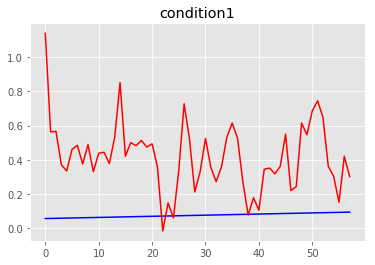

MSE condition1: 0.15804458076856626
R2 condition1: -1306.7213168901048


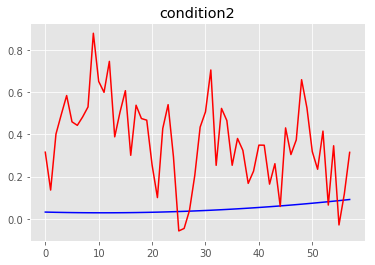

MSE condition2: 0.14567010788117504
R2 condition2: -403.12303987751403


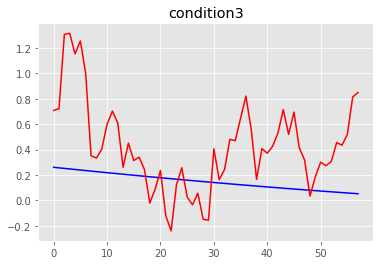

MSE condition3: 0.19070203460775162
R2 condition3: -50.005052789868124


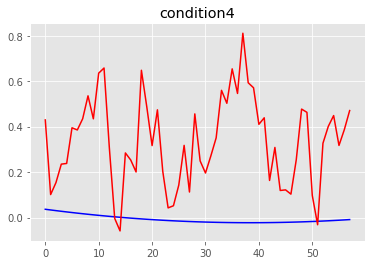

MSE condition4: 0.1557865994433586
R2 condition4: -559.3254824205379
==== the test person number # 13 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43289432e-09 4.65435063e-09 4.02651028e-09 4.07681731e-09]
Global min values from training is:  [-4.42348201e-09 -4.6672

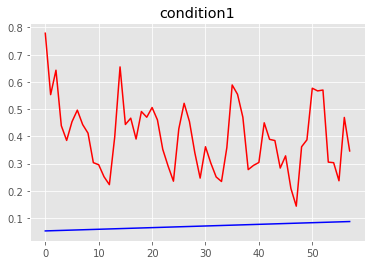

MSE condition1: 0.12516994980243215
R2 condition1: -1222.9023788188206


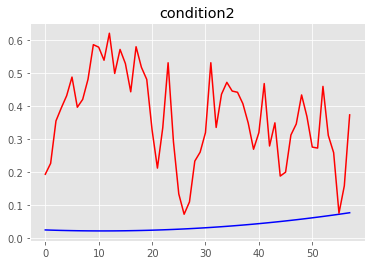

MSE condition2: 0.12924387649456076
R2 condition2: -467.6933492051048


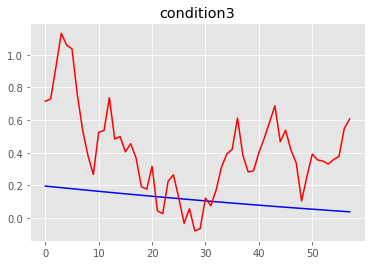

MSE condition3: 0.14878450826384912
R2 condition3: -68.30413453430617


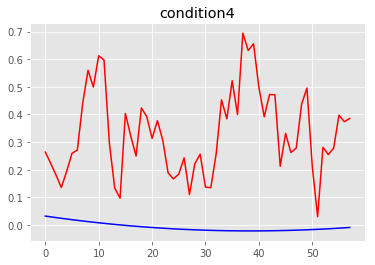

MSE condition4: 0.13906957374585116
R2 condition4: -605.1390739372335
==== the test person number # 14 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00737975e-09 3.82811449e-09 3.45734051e-09 3.59061275e-09]
Global min values from training is:  [-3.99242127e-09 -3.843

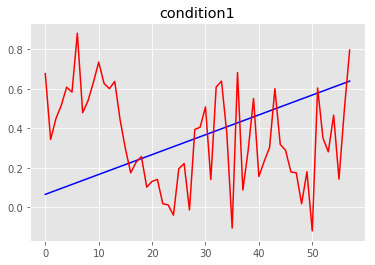

MSE condition1: 0.10872421795582368
R2 condition1: -2.838591609548588


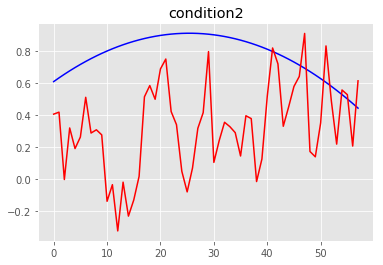

MSE condition2: 0.30976690021481607
R2 condition2: -18.134724306762664


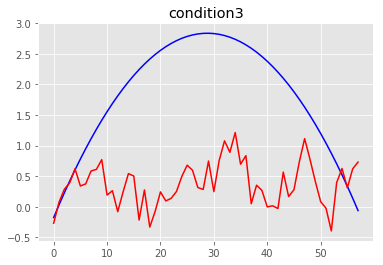

MSE condition3: 2.9602009468896977
R2 condition3: -2.561240025114337


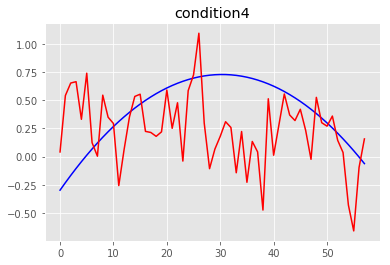

MSE condition4: 0.2081925454452127
R2 condition4: -1.528179414722358
==== the test person number # 14 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06281379e-09 4.29933914e-09 3.61899957e-09 3.80570244e-09]
Global min values from training is:  [-4.04474541e-09 -4.3124

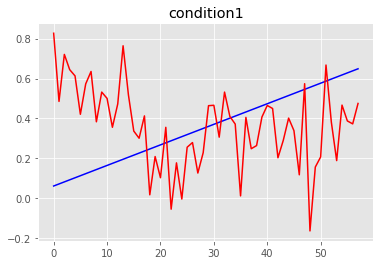

MSE condition1: 0.09373564679358033
R2 condition1: -2.154909608924665


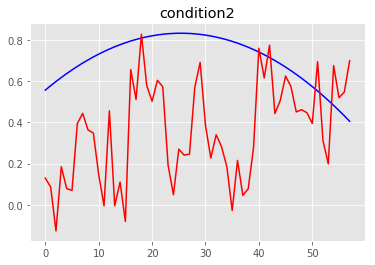

MSE condition2: 0.19986384603997062
R2 condition2: -13.895295987752249


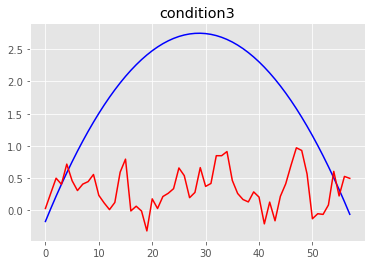

MSE condition3: 2.9098760658354847
R2 condition3: -2.731607391545582


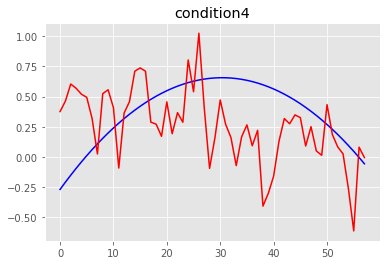

MSE condition4: 0.17305307525472893
R2 condition4: -1.5758547636391937
==== the test person number # 14 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11607731e-09 4.34274343e-09 3.67868774e-09 3.76590524e-09]
Global min values from training is:  [-4.10021761e-09 -4.35

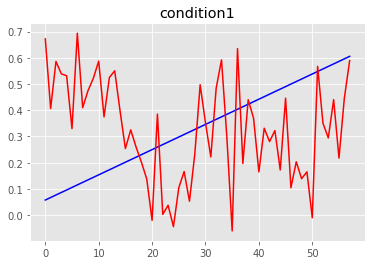

MSE condition1: 0.08083762395477534
R2 condition1: -2.119017774357671


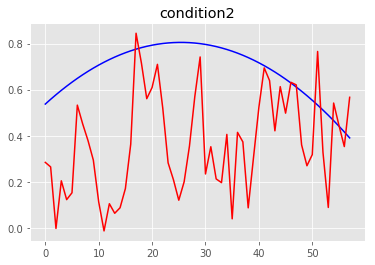

MSE condition2: 0.1610095602853706
R2 condition2: -11.712338363635528


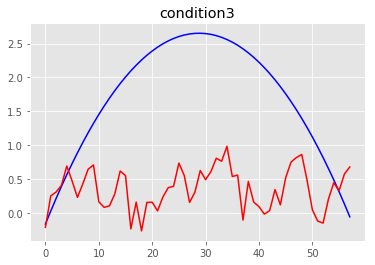

MSE condition3: 2.5991897815458826
R2 condition3: -2.5700798144228103


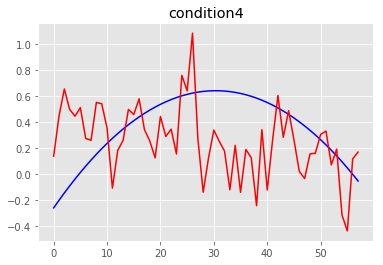

MSE condition4: 0.1514955933495816
R2 condition4: -1.3672329643333168
==== the test person number # 14 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.10404413e-09 4.30401659e-09 3.67157433e-09 3.76318639e-09]
Global min values from training is:  [-4.08945127e-09 -4.316

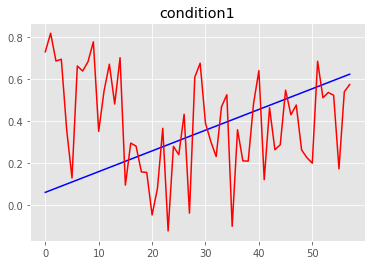

MSE condition1: 0.0984523459336846
R2 condition1: -2.5795914657812204


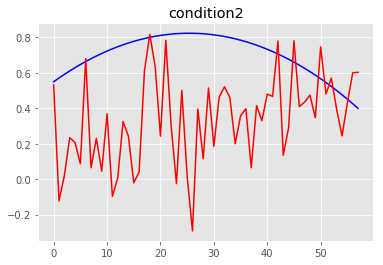

MSE condition2: 0.22016017110536412
R2 condition2: -15.604616441630505


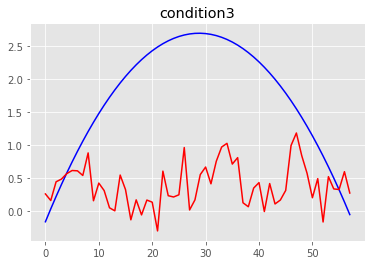

MSE condition3: 2.6625108482868765
R2 condition3: -2.5325581694953545


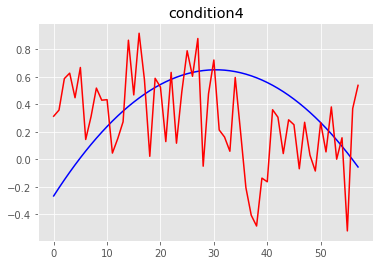

MSE condition4: 0.1906385620231699
R2 condition4: -1.8928550858690532
==== the test person number # 14 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19025695e-09 4.42483247e-09 3.65744909e-09 3.84746717e-09]
Global min values from training is:  [-4.17326579e-09 -4.439

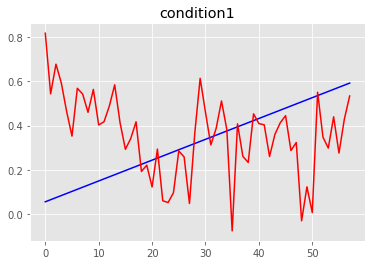

MSE condition1: 0.07712495101464656
R2 condition1: -2.121574338085166


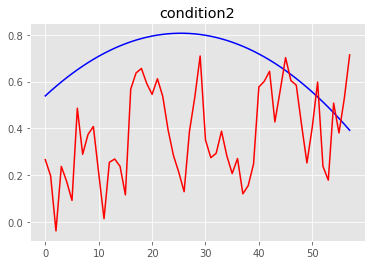

MSE condition2: 0.14577685818301386
R2 condition2: -10.467165131960797


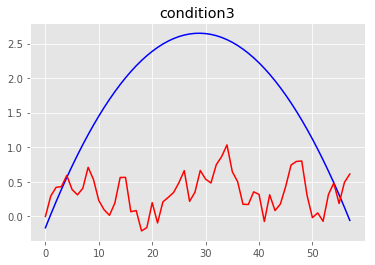

MSE condition3: 2.5891710518409554
R2 condition3: -2.5674033806983316


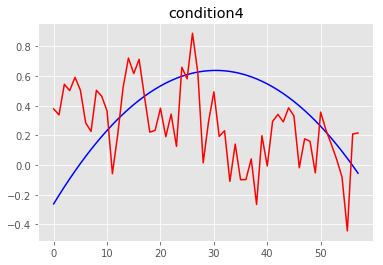

MSE condition4: 0.14678602218687703
R2 condition4: -1.316989511782792
==== the test person number # 14 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17075917e-09 4.14570978e-09 3.65051058e-09 3.80266402e-09]
Global min values from training is:  [-4.15471724e-09 -4.142

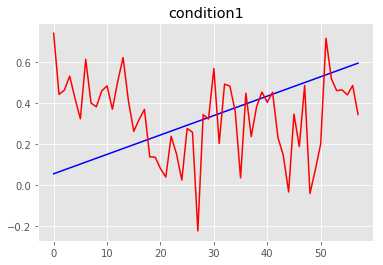

MSE condition1: 0.07166626307808809
R2 condition1: -1.8578016246975855


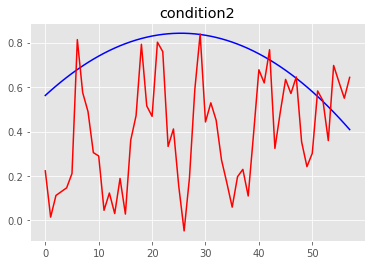

MSE condition2: 0.18144090517366412
R2 condition2: -12.093618708899703


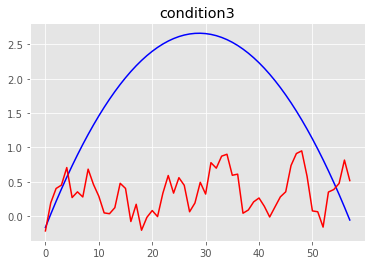

MSE condition3: 2.6790540844584436
R2 condition3: -2.6513793424097316


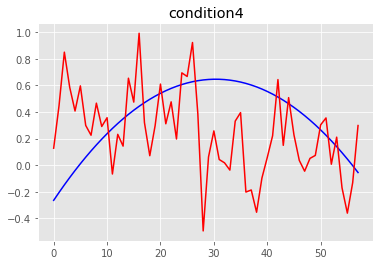

MSE condition4: 0.1916771712720913
R2 condition4: -1.94630647296546
==== the test person number # 14 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17137586e-09 4.41228446e-09 3.67217169e-09 3.82183914e-09]
Global min values from training is:  [-4.15505737e-09 -4.42643

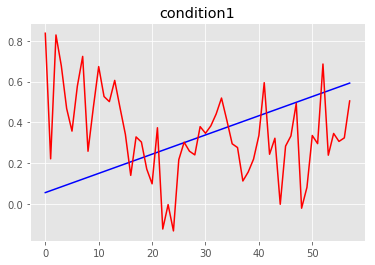

MSE condition1: 0.09034433518996242
R2 condition1: -2.64093197511201


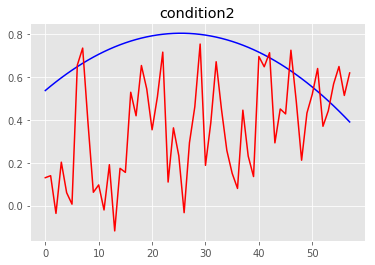

MSE condition2: 0.17860026561698367
R2 condition2: -13.135994482428877


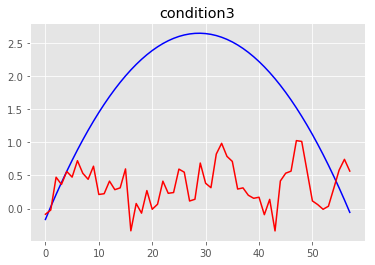

MSE condition3: 2.6344694285152257
R2 condition3: -2.6364825836863734


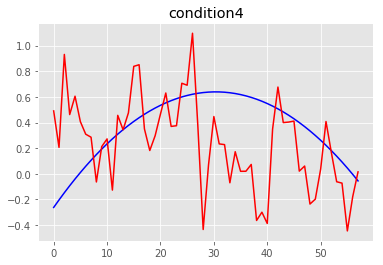

MSE condition4: 0.1958995651173898
R2 condition4: -2.073262171385077
==== the test person number # 14 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.76691850e-09 4.06175050e-09 3.31634017e-09 3.43576569e-09]
Global min values from training is:  [-3.75419309e-09 -4.0750

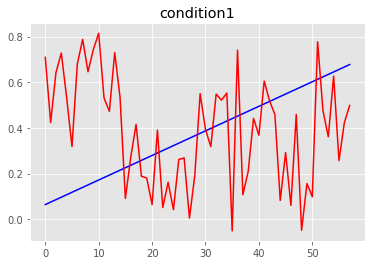

MSE condition1: 0.11355955826638621
R2 condition1: -2.5053712446546537


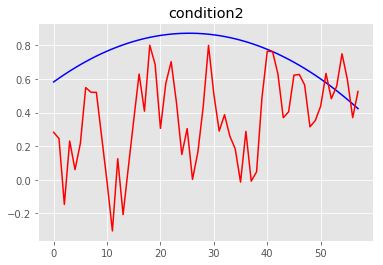

MSE condition2: 0.2318515187503517
R2 condition2: -14.565082847427561


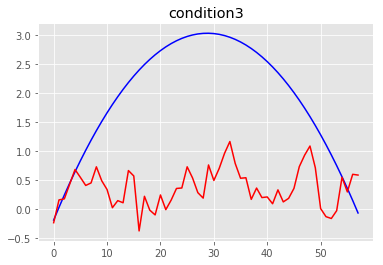

MSE condition3: 3.4638381974369525
R2 condition3: -2.628852679948842


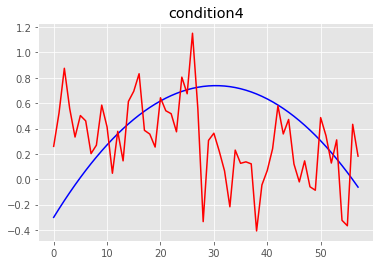

MSE condition4: 0.20643439420082726
R2 condition4: -1.433480877411046
==== the test person number # 14 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.14662817e-09 4.38612130e-09 3.65383485e-09 3.71014406e-09]
Global min values from training is:  [-4.12896076e-09 -4.398

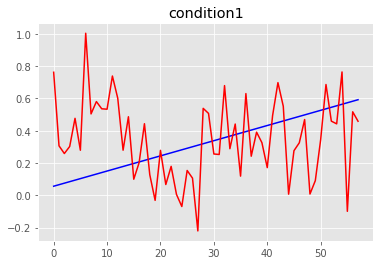

MSE condition1: 0.09327332178100488
R2 condition1: -2.770623700654254


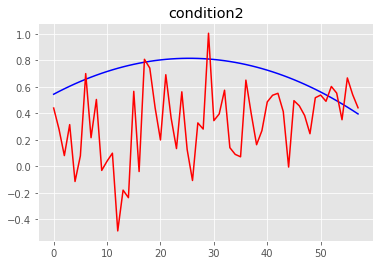

MSE condition2: 0.23484454830493737
R2 condition2: -17.061882469383566


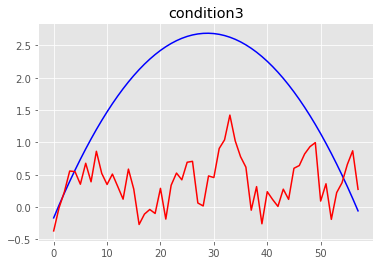

MSE condition3: 2.6208029368849224
R2 condition3: -2.5100597827386277


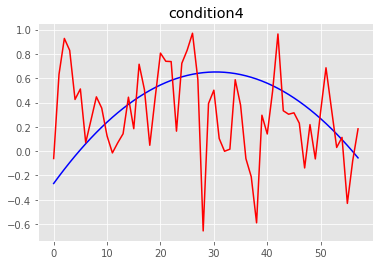

MSE condition4: 0.19627611554127733
R2 condition4: -1.975180969698953
==== the test person number # 14 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97904517e-09 4.29517726e-09 3.56737857e-09 3.65153522e-09]
Global min values from training is:  [-3.96538492e-09 -4.307

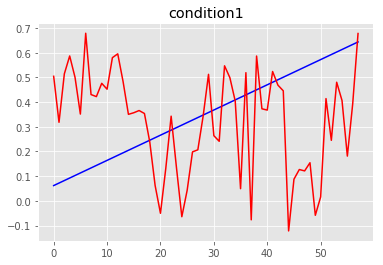

MSE condition1: 0.09090503300873919
R2 condition1: -2.1156551619758903


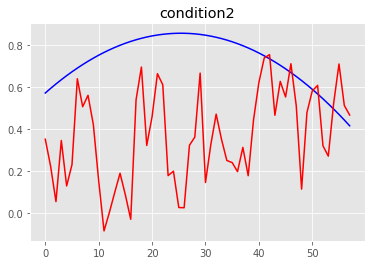

MSE condition2: 0.20439612448481265
R2 condition2: -13.306337100077181


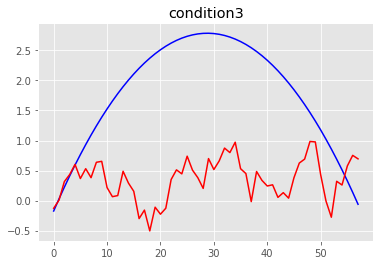

MSE condition3: 2.975849999122303
R2 condition3: -2.706157979588565


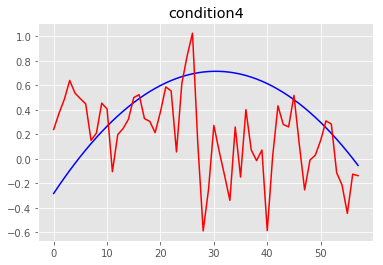

MSE condition4: 0.24157960778516924
R2 condition4: -2.100965821188268
==== the test person number # 14 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13495985e-09 4.34970896e-09 3.60456974e-09 3.75166167e-09]
Global min values from training is:  [-4.11622616e-09 -4.361

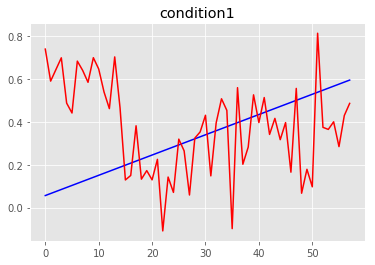

MSE condition1: 0.09165486710744024
R2 condition1: -2.6754445675923963


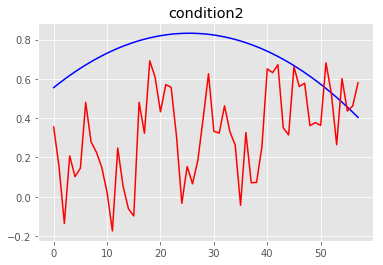

MSE condition2: 0.2242536831323418
R2 condition2: -15.556788709826776


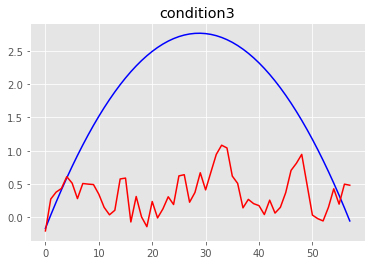

MSE condition3: 2.8165422793071677
R2 condition3: -2.561220015993786


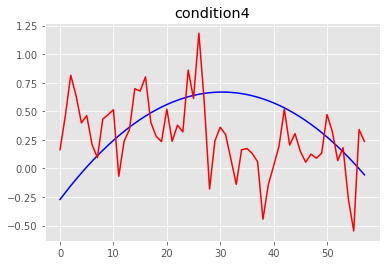

MSE condition4: 0.17931510565804454
R2 condition4: -1.5866073586324898
==== the test person number # 14 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.71879111e-09 3.96033493e-09 3.34927062e-09 3.45243146e-09]
Global min values from training is:  [-3.70883299e-09 -3.97

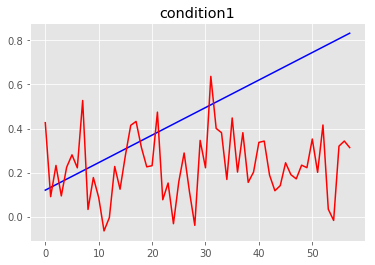

MSE condition1: 0.12025360221779914
R2 condition1: -1.7440122841294312


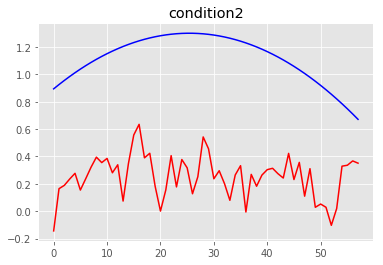

MSE condition2: 0.786075281265238
R2 condition2: -25.92748709307344


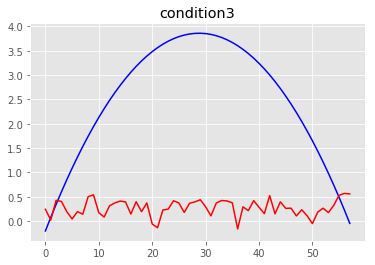

MSE condition3: 6.4455210902299545
R2 condition3: -3.2714751707753056


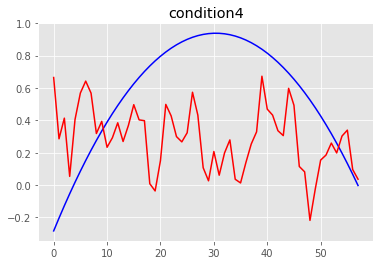

MSE condition4: 0.2504365859789289
R2 condition4: -1.142524067685545
==== the test person number # 14 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.07598495e-09 4.27130693e-09 3.56404619e-09 3.74131110e-09]
Global min values from training is:  [-4.05930739e-09 -4.2846

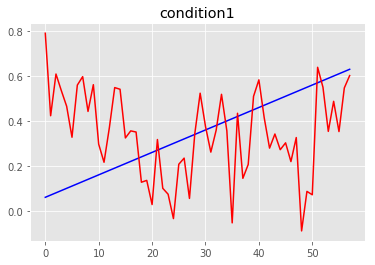

MSE condition1: 0.0766458530228394
R2 condition1: -1.7224238759347545


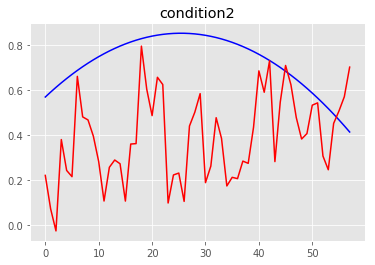

MSE condition2: 0.1678974532969727
R2 condition2: -10.87603956611119


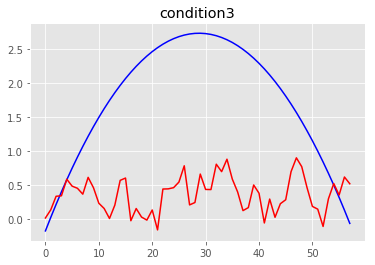

MSE condition3: 2.7220051136793906
R2 condition3: -2.5299282787444253


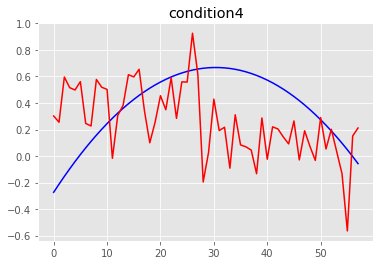

MSE condition4: 0.15545983285082027
R2 condition4: -1.2375370587771828
==== the test person number # 14 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13033600e-09 4.35985303e-09 3.61076834e-09 3.81043312e-09]
Global min values from training is:  [-4.11526597e-09 -4.37

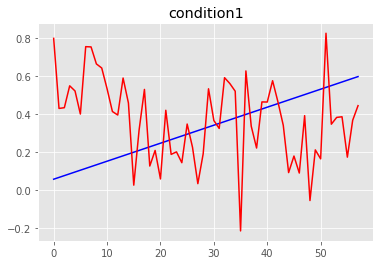

MSE condition1: 0.09483164813575584
R2 condition1: -2.777914617892632


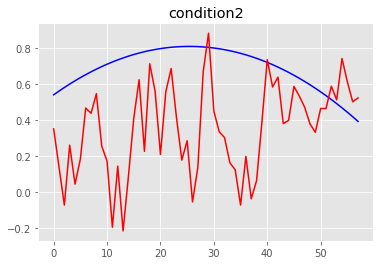

MSE condition2: 0.19953750696420317
R2 condition2: -14.517823470482506


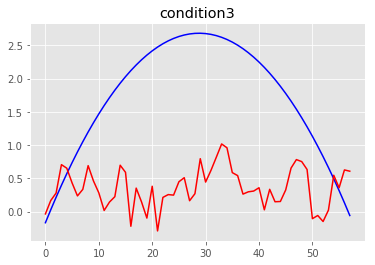

MSE condition3: 2.632069700072636
R2 condition3: -2.537820891709411


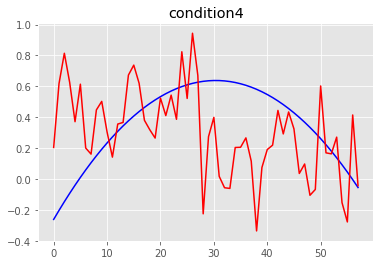

MSE condition4: 0.15452994725402133
R2 condition4: -1.4357550448003296
==== the test person number # 14 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17740987e-09 4.41598594e-09 3.69590043e-09 3.86580159e-09]
Global min values from training is:  [-4.16142891e-09 -4.43

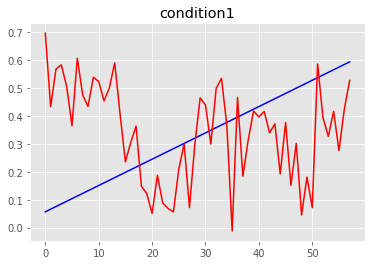

MSE condition1: 0.07000231437989013
R2 condition1: -1.8031369996152176


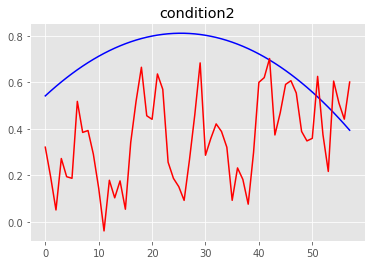

MSE condition2: 0.1663931289345678
R2 condition2: -11.907406872947018


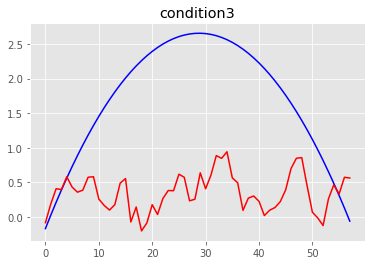

MSE condition3: 2.581682284015375
R2 condition3: -2.5392615630311015


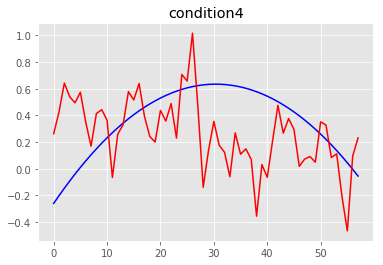

MSE condition4: 0.14672782862834477
R2 condition4: -1.3341453404285901
==== the test person number # 15 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30993808e-09 4.12261209e-09 3.87308245e-09 3.85699694e-09]
Global min values from training is:  [-4.30063731e-09 -4.13

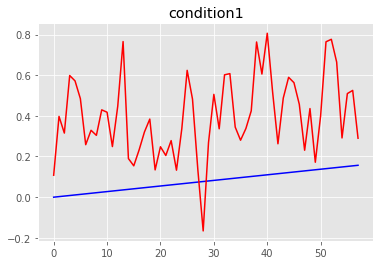

MSE condition1: 0.13899469286145189
R2 condition1: -64.44812639073449


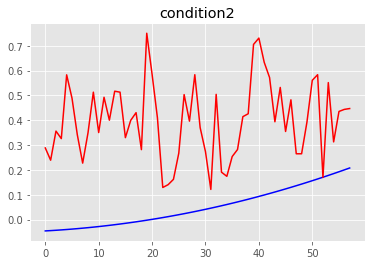

MSE condition2: 0.1481269098042024
R2 condition2: -24.78750935382726


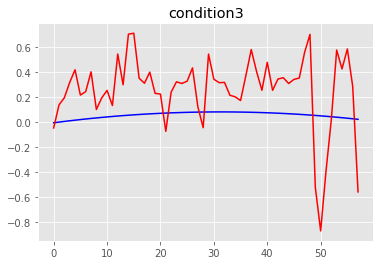

MSE condition3: 0.12299938878629407
R2 condition3: -216.02891331143735


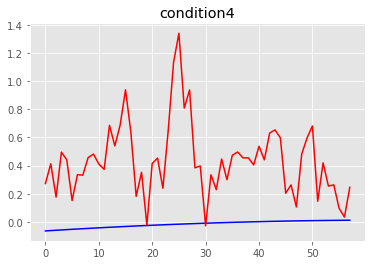

MSE condition4: 0.2736959190797915
R2 condition4: -524.4752390068115
==== the test person number # 15 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36537212e-09 4.59383674e-09 4.03474151e-09 4.07208662e-09]
Global min values from training is:  [-4.35296145e-09 -4.6048

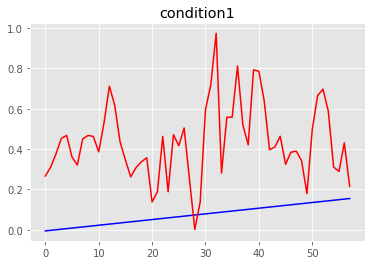

MSE condition1: 0.16403001441117399
R2 condition1: -72.93259463087745


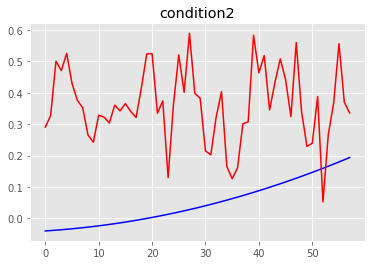

MSE condition2: 0.11746334885054435
R2 condition2: -23.063432993637353


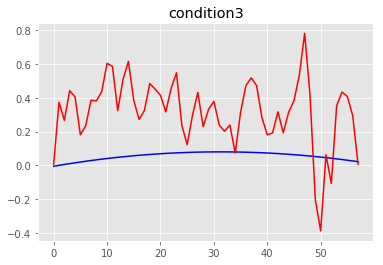

MSE condition3: 0.10777952607679239
R2 condition3: -198.51194316164288


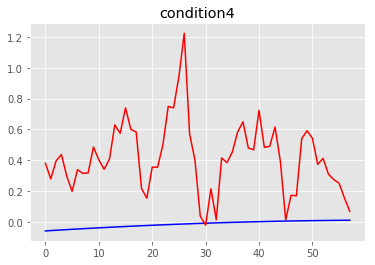

MSE condition4: 0.24007526729072765
R2 condition4: -552.767998818222
==== the test person number # 15 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41863563e-09 4.63724104e-09 4.09442967e-09 4.03228943e-09]
Global min values from training is:  [-4.40843365e-09 -4.6481

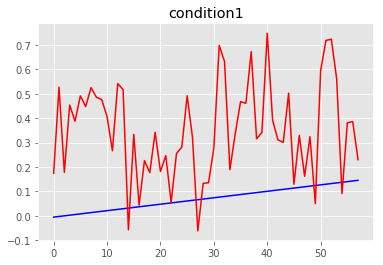

MSE condition1: 0.11671696458389365
R2 condition1: -58.62013855825213


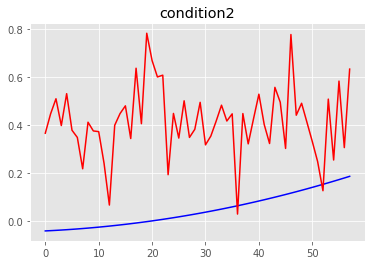

MSE condition2: 0.16394247206668822
R2 condition2: -34.32200543401185


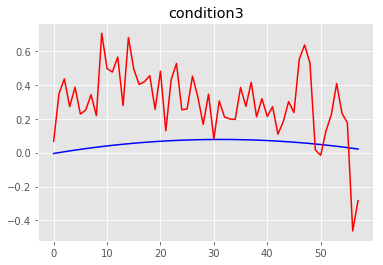

MSE condition3: 0.0991922838733876
R2 condition3: -192.40633221106714


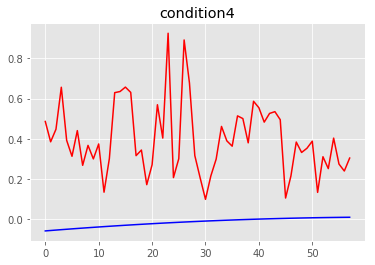

MSE condition4: 0.2033270686595116
R2 condition4: -489.13202340536964
==== the test person number # 15 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40660245e-09 4.59851420e-09 4.08731627e-09 4.02957058e-09]
Global min values from training is:  [-4.39766730e-09 -4.609

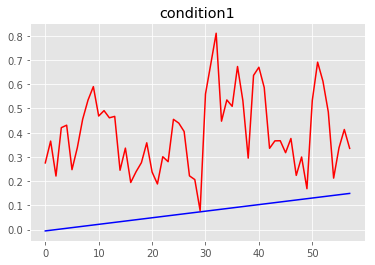

MSE condition1: 0.13267373737268526
R2 condition1: -63.17599657459604


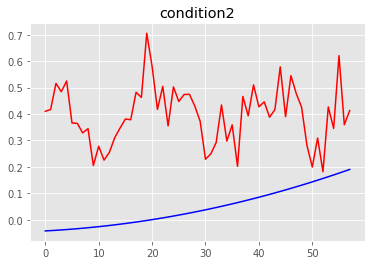

MSE condition2: 0.13999439699703473
R2 condition2: -27.97889785603688


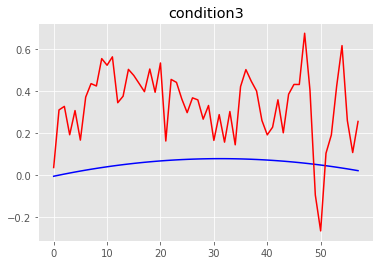

MSE condition3: 0.10485488923335101
R2 condition3: -198.14866250929404


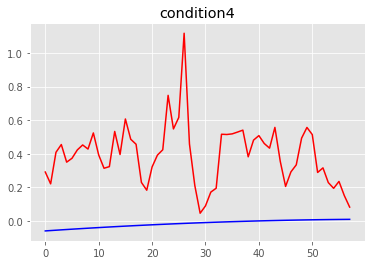

MSE condition4: 0.20049840257606963
R2 condition4: -469.6321118603392
==== the test person number # 15 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.49281527e-09 4.71933007e-09 4.07319103e-09 4.11385136e-09]
Global min values from training is:  [-4.48148183e-09 -4.731

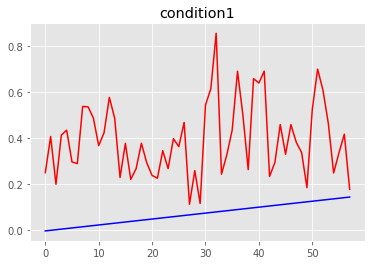

MSE condition1: 0.13123224265726094
R2 condition1: -69.04932094930673


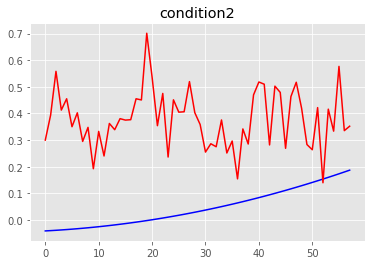

MSE condition2: 0.1275049706210988
R2 condition2: -26.3826124802074


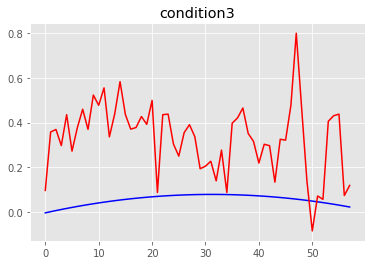

MSE condition3: 0.10110940293192754
R2 condition3: -196.6111070323318


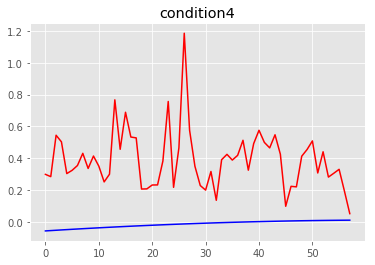

MSE condition4: 0.1985540774083618
R2 condition4: -482.04942756191275
==== the test person number # 15 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47331750e-09 4.44020738e-09 4.06625252e-09 4.06904821e-09]
Global min values from training is:  [-4.46293328e-09 -4.434

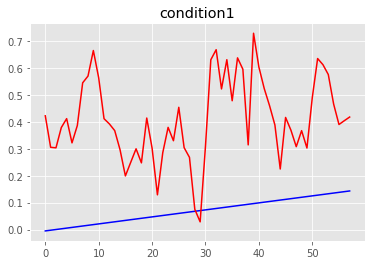

MSE condition1: 0.13807267807067097
R2 condition1: -71.69845500351467


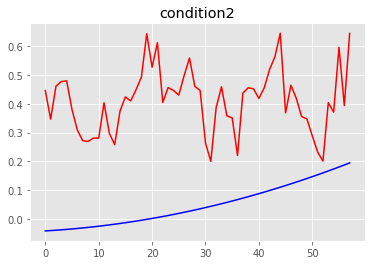

MSE condition2: 0.14868295335488418
R2 condition2: -28.615921608715947


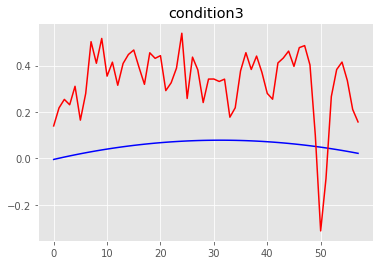

MSE condition3: 0.09629346615234673
R2 condition3: -185.65288583107517


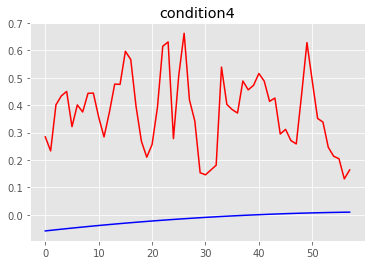

MSE condition4: 0.17259055631659403
R2 condition4: -408.88288340718987
==== the test person number # 15 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47393418e-09 4.70678206e-09 4.08791363e-09 4.08822333e-09]
Global min values from training is:  [-4.46327341e-09 -4.71

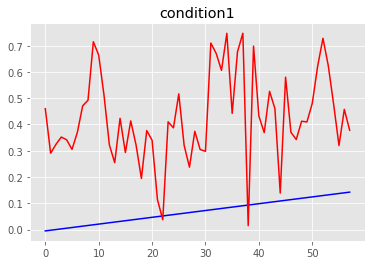

MSE condition1: 0.15528297910354807
R2 condition1: -81.55981196897551


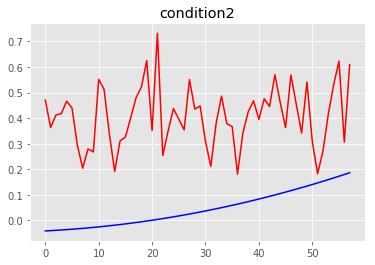

MSE condition2: 0.14740640883355147
R2 condition2: -30.827863932399808


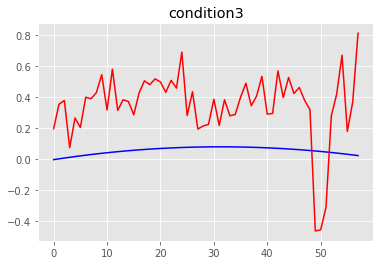

MSE condition3: 0.13493798046273106
R2 condition3: -263.09471845428567


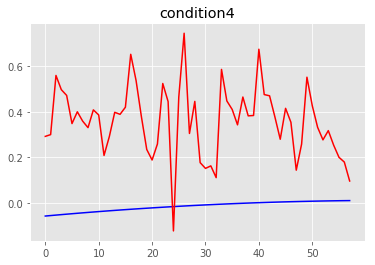

MSE condition4: 0.16468395671892463
R2 condition4: -397.41514052300937
==== the test person number # 15 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06947682e-09 4.35624811e-09 3.73208211e-09 3.70214988e-09]
Global min values from training is:  [-4.06240913e-09 -4.36

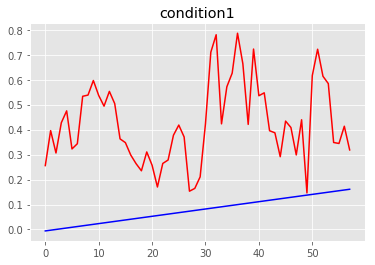

MSE condition1: 0.1470768676371365
R2 condition1: -60.26340532046461


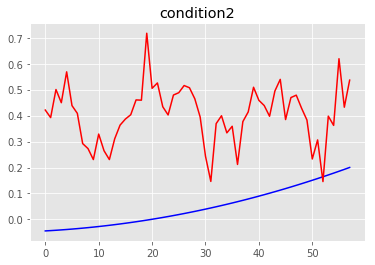

MSE condition2: 0.14391702884782634
R2 condition2: -25.922924426978042


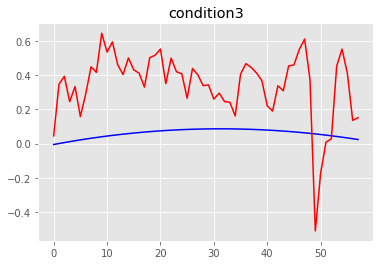

MSE condition3: 0.11685108442215482
R2 condition3: -185.10026360472582


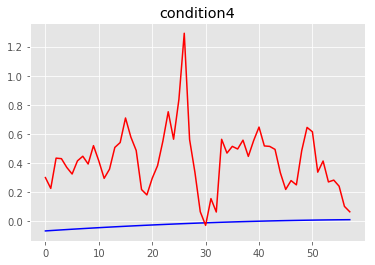

MSE condition4: 0.23651547355206298
R2 condition4: -441.1648967215918
==== the test person number # 15 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44918650e-09 4.68061890e-09 4.06957679e-09 3.97652825e-09]
Global min values from training is:  [-4.43717680e-09 -4.691

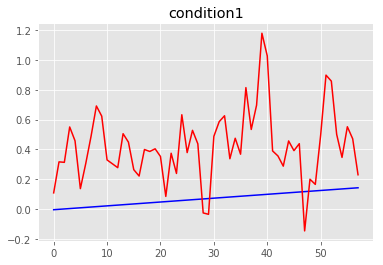

MSE condition1: 0.1809409933769777
R2 condition1: -95.4759171324447


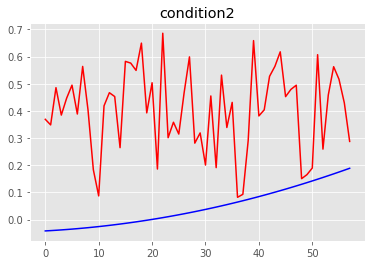

MSE condition2: 0.15588006058515386
R2 condition2: -31.823121776430156


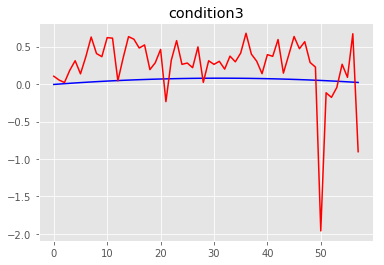

MSE condition3: 0.19556031641238494
R2 condition3: -373.07582451606993


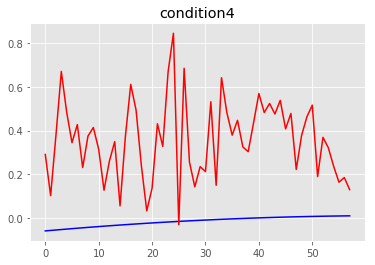

MSE condition4: 0.17236518377470292
R2 condition4: -403.19784818332283
==== the test person number # 15 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.28160350e-09 4.58967486e-09 3.98312051e-09 3.91791941e-09]
Global min values from training is:  [-4.27360096e-09 -4.59

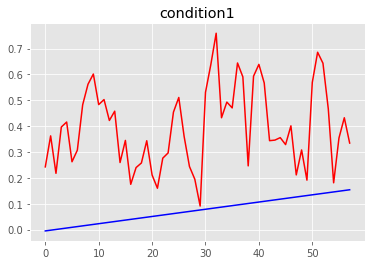

MSE condition1: 0.12630490655772103
R2 condition1: -56.88062485543625


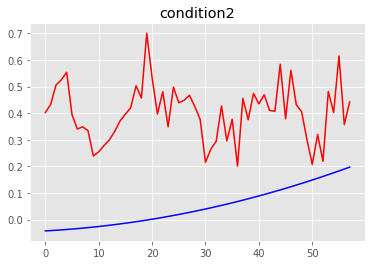

MSE condition2: 0.14117314678058482
R2 condition2: -26.382771648228463


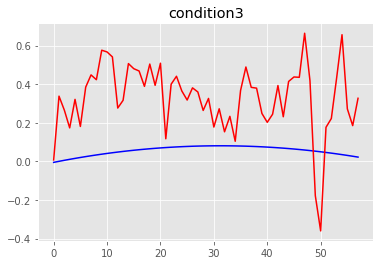

MSE condition3: 0.10544115952402233
R2 condition3: -189.9349014590821


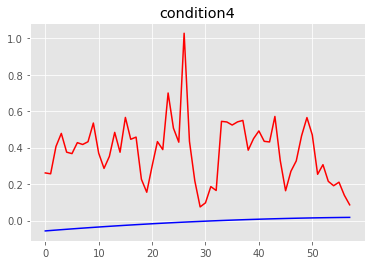

MSE condition4: 0.1820249382531266
R2 condition4: -366.33063309634014
==== the test person number # 15 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43751818e-09 4.64420657e-09 4.02031168e-09 4.01804586e-09]
Global min values from training is:  [-4.42444219e-09 -4.653

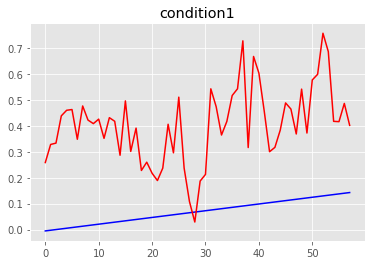

MSE condition1: 0.1300911884488126
R2 condition1: -67.85056235301941


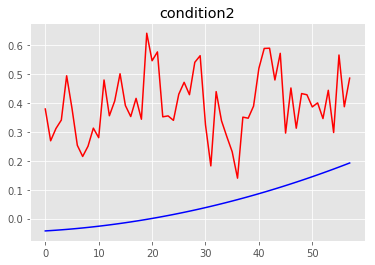

MSE condition2: 0.13607506035547876
R2 condition2: -26.648862779111806


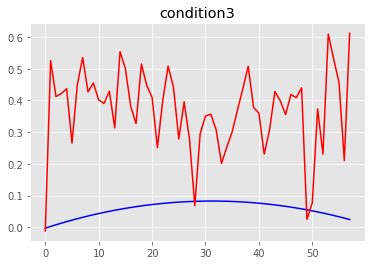

MSE condition3: 0.11593837839615143
R2 condition3: -211.34338792571847


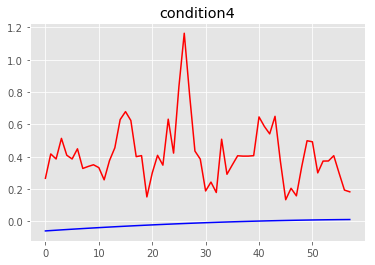

MSE condition4: 0.2176389527528067
R2 condition4: -486.9538870648224
==== the test person number # 15 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02134944e-09 4.25483254e-09 3.76501255e-09 3.71881565e-09]
Global min values from training is:  [-4.01704903e-09 -4.2694

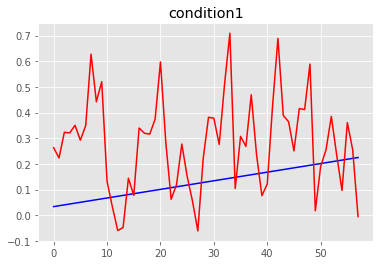

MSE condition1: 0.05820101192897941
R2 condition1: -17.45109063351918


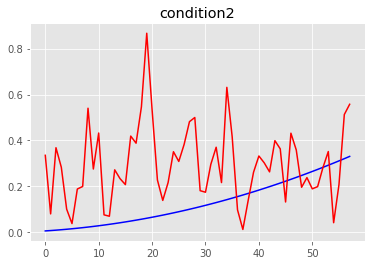

MSE condition2: 0.06394971088677488
R2 condition2: -5.77428598212918


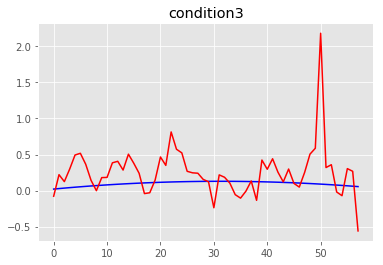

MSE condition3: 0.14375000012521888
R2 condition3: -164.3118640086903


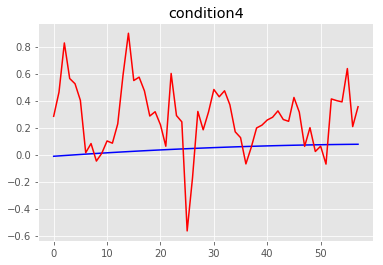

MSE condition4: 0.11594745782520831
R2 condition4: -162.07659762896503
==== the test person number # 15 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37854328e-09 4.56580454e-09 3.97978813e-09 4.00769529e-09]
Global min values from training is:  [-4.36752342e-09 -4.57

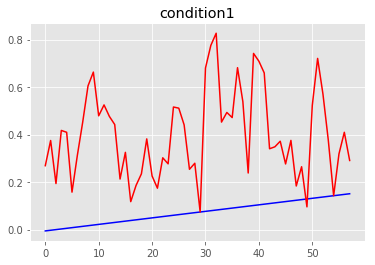

MSE condition1: 0.14136851576032902
R2 condition1: -65.93473509269519


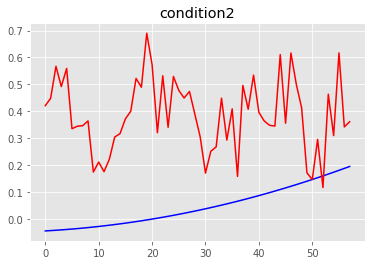

MSE condition2: 0.1385897604334464
R2 condition2: -26.128734833969208


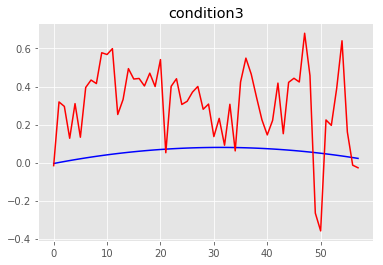

MSE condition3: 0.10508101138952779
R2 condition3: -195.16322070477153


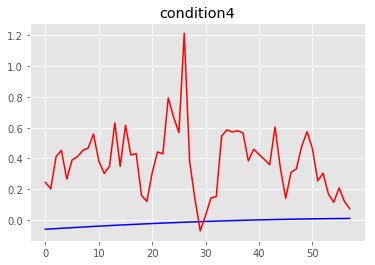

MSE condition4: 0.2040930886821388
R2 condition4: -455.66800391270635
==== the test person number # 15 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43289432e-09 4.65435063e-09 4.02651028e-09 4.07681731e-09]
Global min values from training is:  [-4.42348201e-09 -4.667

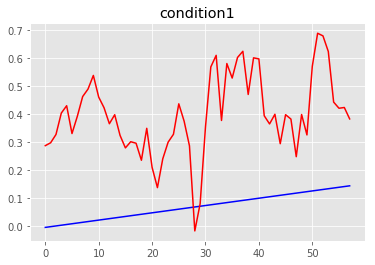

MSE condition1: 0.12619401064099117
R2 condition1: -65.38519050925521


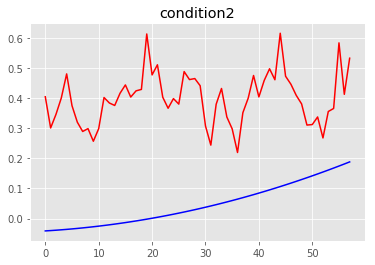

MSE condition2: 0.13467417022358702
R2 condition2: -27.634606285941928


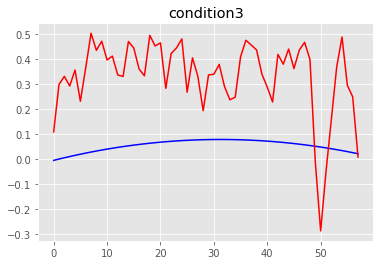

MSE condition3: 0.09853206565576325
R2 condition3: -187.98923062736043


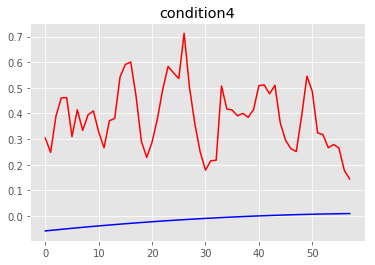

MSE condition4: 0.1770134673601454
R2 condition4: -429.0879520640861
==== the test person number # 15 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17740987e-09 4.41598594e-09 3.69590043e-09 3.86580159e-09]
Global min values from training is:  [-4.16142891e-09 -4.4301

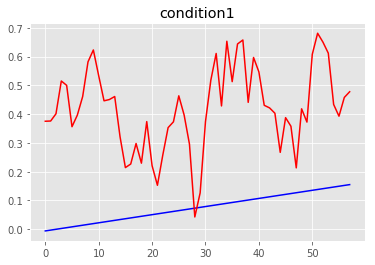

MSE condition1: 0.1396611143859234
R2 condition1: -61.492794356199056


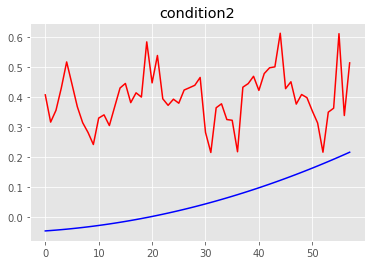

MSE condition2: 0.1304928571066228
R2 condition2: -20.17168132080137


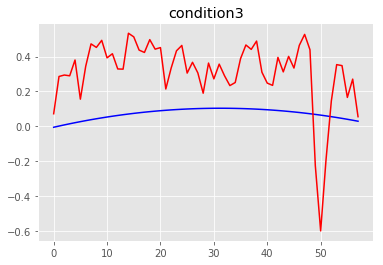

MSE condition3: 0.09391142742503306
R2 condition3: -104.48865718909715


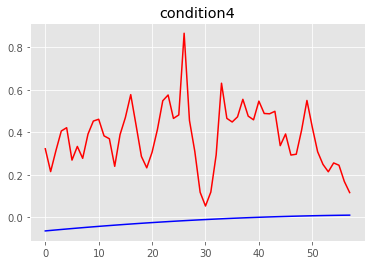

MSE condition4: 0.17917689664433858
R2 condition4: -361.5747419349165


In [3]:
## DATA pre-processing

#import datasetsJ
X_import = np.load('Extracted_timeseries_win3.npy')
print("Dimesion of dataset: ", X_import.shape)
print("'''''Import successfully'''''")

# Characteristic of the data
num_win = X_import.shape[2]
num_cond = int(X_import.shape[0]) 
person_num = int(X_import.shape[1])
smp_freq = 250  # 250 Hz
win_len = int(X_import.shape[3]/smp_freq) # 3s  Using sliding window size 3 secs

y_extractedFFT = np.load("PSD_amplitudes_win3.npy")
y_swapped = np.swapaxes(y_extractedFFT, 0, 1)
print(y_swapped.shape)

## Swapping dimension data to easily understand

X_swapped = np.swapaxes(X_import, 0, 1)
print("Dimension of data after applying swappaxes function", X_swapped.shape)

## Leave one out for testing and applying cross-validation training

#Manipulate training data set 
train_people = list(range(person_num))

# Leave one out for Testing
#Choose test person 
# all_person_num.remove(test_person_num)
for test_person_num in train_people:
    rest_of_training = [p for p in train_people if p != test_person_num]
    # Randomly leave ont for validation set
    for idx_run, vp in enumerate(rest_of_training):
        val_person_num = vp
        remain_person = [k for k in rest_of_training if k!= val_person_num]

        print("==== the test person number #", test_person_num, "====")
        print("==== the validated person number #", val_person_num, "====")

        #Check the remaining which use for training set
        num_train_people = int(len(remain_person))
        print("==== the set of subject training data #", remain_person, "====", "\n")
        
        #Slicing to get training data
        X_train = np.zeros((person_num-2, num_cond, X_swapped.shape[2], X_swapped.shape[3]))
        y_train = np.zeros((person_num-2, num_cond, y_swapped.shape[2]))

        for x, value in enumerate(remain_person):
            X_train[x,:,:,:] = X_swapped[value, :, :, :]
            y_train[x,:,:] = y_swapped[value, :, :]

        #Set up testing set as follwing (test_person_number) 
        X_test = np.zeros((num_cond, X_swapped.shape[2], X_swapped.shape[3]))
        X_test[:,:,:] = X_swapped[test_person_num,:,:,:]

        #Set up validation set as follwing (val_person_number) 
        X_val = np.zeros((num_cond, X_swapped.shape[2], X_swapped.shape[3]))
        X_val[:,:,:] = X_swapped[val_person_num,:,:,:]

        y_val = np.zeros((num_cond, y_swapped.shape[2]))
        y_test = np.zeros((num_cond, y_swapped.shape[2]))

        y_val[:,:] = y_swapped[val_person_num, :, :]
        y_test[:,:] = y_swapped[test_person_num, :, :]

        print("==== the Dimension of training set ====")
        print("Dimension of training data #", X_train.shape, "\n")

        print("==== the Dimension of testing set ====")
        print("Dimension of testing data #", X_test.shape, "\n")

        print("==== the Dimension of validation data ====")
        print("Dimension of validation data #", X_val.shape, "\n")

        print("==== the Dimension of training set for constructing target signals ====")
        print("Dimension of training data #", y_train.shape, "\n")

        print("==== the Dimension of validatio set for constructing target signals ====")
        print("Dimension of training data #", y_val.shape, "\n")

        print("==== the Dimension of testing set for constructing target signals ====")
        print("Dimension of training data #", y_test.shape, "\n")

        ## Min-Max scalar with global max and min from training

        #Calculate global max and global min from training set
        max_values_train = np.zeros((X_train.shape[0], X_train.shape[1]))
        min_values_train = np.zeros((X_train.shape[0], X_train.shape[1]))
        for p in range(X_train.shape[0]):
            for c in range(X_train.shape[1]):
                max_values_train[p, c] = np.max(X_train[p, c, :, :]) 
                min_values_train[p, c] = np.min(X_train[p, c, :, :])  

        max_values_train = np.swapaxes(max_values_train, 0, 1)
        min_values_train = np.swapaxes(min_values_train, 0, 1)   

        global_max = max_values_train.mean(axis=1)
        global_min = min_values_train.mean(axis=1)

        print("Global max values from training is: ", global_max)
        print("Global min values from training is: ", global_min)

        #Calculate global max and global min from target set
        max_values_tar = np.zeros((y_train.shape[0], y_train.shape[1]))
        min_values_tar = np.zeros((y_train.shape[0], y_train.shape[1]))
        for p_tar in range(y_train.shape[0]):
            for c_tar in range(y_train.shape[1]):
                max_values_tar[p_tar, c_tar] = np.max(y_train[p_tar, c_tar, :]) 
                min_values_tar[p_tar, c_tar] = np.min(y_train[p_tar, c_tar, :])  

        max_values_tar = np.swapaxes(max_values_tar, 0, 1)
        min_values_tar = np.swapaxes(min_values_tar, 0, 1)   

        global_max_tar = max_values_tar.mean(axis=1)
        global_min_tar = min_values_tar.mean(axis=1)

        print("Global max values from training is: ", global_max_tar)
        print("Global min values from training is: ", global_min_tar)

        ## Perform Min-Max scalar on training set

        X_train_normalized = np.zeros((X_train.shape[0], X_train.shape[1], X_train.shape[2], X_train.shape[3]))
        #Define new scales
        new_max = 1
        new_min = 0
        for per_idx in range(X_train.shape[0]):
            for con_idx in range(X_train.shape[1]):
                for win_idx in range(X_train.shape[2]):
                    X_std = (X_train[per_idx, con_idx, win_idx, :]-global_min[con_idx])/ (global_max[con_idx] - global_min[con_idx])
                    X_train_normalized[per_idx, con_idx, win_idx, :] = X_std*(new_max-new_min) + new_min
        print(X_train_normalized.shape)

        y_train_normalized = np.zeros((y_train.shape[0], y_train.shape[1], y_train.shape[2]))

        #Define new scales
        new_max = 1
        new_min = 0
        for per_idx_tar in range(y_train.shape[0]):
            for con_idx_tar in range(y_train.shape[1]):
                y_std = (y_train[per_idx_tar, con_idx_tar, :]-global_min_tar[con_idx_tar])/ (global_max_tar[con_idx_tar] - global_min_tar[con_idx_tar])
                y_train_normalized[per_idx_tar, con_idx_tar, :] = y_std*(new_max-new_min) + new_min
        print(y_train_normalized.shape)

        ## Perform Min-Max scalar on both testing set and validation set
        X_val_normalized = np.zeros((X_val.shape[0], X_val.shape[1], X_val.shape[2]))
        X_test_normalized = np.zeros((X_test.shape[0], X_test.shape[1], X_test.shape[2]))

        for c_idx in range(X_val.shape[0]):
            for w_idx in range(X_val.shape[1]):
                X_val_std = (X_val[c_idx, w_idx, :]-global_min[c_idx])/ (global_max[c_idx] - global_min[c_idx])
                X_test_std = (X_test[c_idx, w_idx, :]-global_min[c_idx])/ (global_max[c_idx] - global_min[c_idx])
                X_val_normalized[c_idx, w_idx, :] = X_val_std*(new_max-new_min) + new_min
                X_test_normalized[c_idx, w_idx, :] = X_test_std*(new_max-new_min) + new_min
        print(X_val_normalized.shape)
        print(X_test_normalized.shape)

        y_test_normalized = np.zeros((y_test.shape[0], y_test.shape[1]))
        y_val_normalized = np.zeros((y_val.shape[0], y_val.shape[1]))
        for c_idx_tar in range(y_test.shape[0]):
            for w_idx_tar in range(y_test.shape[1]):
                y_test_std = (y_test[c_idx_tar, w_idx_tar]-global_min_tar[c_idx_tar])/ (global_max_tar[c_idx_tar] - global_min_tar[c_idx_tar])
                y_test_normalized[c_idx_tar, w_idx_tar] = y_test_std*(new_max-new_min) + new_min

                y_val_std = (y_val[c_idx_tar, w_idx_tar]-global_min_tar[c_idx_tar])/ (global_max_tar[c_idx_tar] - global_min_tar[c_idx_tar])
                y_val_normalized[c_idx_tar, w_idx_tar] = y_val_std*(new_max-new_min) + new_min
        print(y_test_normalized.shape)
        print(y_val_normalized.shape)
        ## Polynomial Regression for curve fitting

        ## Curve fitting function to construct target signals
        target_data = curve_fitting(y_train_normalized)
        target_data_val = curve_fitting(y_val_normalized)
        target_data_test = curve_fitting(y_test_normalized)
        print(target_data.shape)
        print(target_data_val.shape)
        print(target_data_test.shape)

        ## Random Forest Regressor
        ## Data preparation
        X_train_used = X_train_normalized.reshape(-1, X_train_normalized.shape[3])
        X_val_used = X_val_normalized.reshape(-1, X_test_normalized.shape[2])
        X_test_used = X_test_normalized.reshape(-1, X_test_normalized.shape[2])

        #Target signals
        y_train_used = target_data .reshape(-1)
        y_val_used = target_data_val.reshape(-1)
        y_test_used = target_data_test.reshape(-1)

        print("Checking data dimension before performimng training")
        print(X_train_used.shape)
        print(X_val_used.shape)
        print(X_test_used.shape,"\n")

        print("Checking target data dimesion before performimng training")
        print(y_train_used.shape)
        print(y_val_used.shape)
        print(y_test_used.shape,"\n")

        regression = linear_model.LinearRegression()
        regression.fit(X_train_used, y_train_used)

        #Monitor time during prediction process
        start = time.time()
        Y_pred = regression.predict(X_test_used)
        end = time.time()
        Monitor_timing = end - start
        print("This model have just taken time into prediction is : ", Monitor_timing)

        mse = mean_squared_error(y_test_used, Y_pred)
        rmse = sqrt(mean_squared_error(y_test_used, Y_pred))
        mae = mean_absolute_error(y_test_used, Y_pred)
        r2_score = my_r2_score(y_test_used, Y_pred)
        print("MSE_score: {} RMSE_score:{} All_MAE: {} All_R2: {}".format(mse, rmse, mae, r2_score))

        plt.title('condition1')
        plt.plot(y_test_used[:int(len(y_test_used)/num_cond)], c='b')
        plt.plot(Y_pred[:int(len(Y_pred)/num_cond)], 'r')
        plt.show()
        mae1 = mean_absolute_error(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)])
        rmse1 = sqrt(mean_squared_error(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)]))
        mse1 = mean_squared_error(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)])
        r2_score1 = my_r2_score(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)])
        print('MSE condition1:', mse1)
        print('R2 condition1:', r2_score1)

        plt.title('condition2')
        plt.plot(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], c='b')
        plt.plot(Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)],'r')
        plt.show()
        mae2 = mean_absolute_error(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)])
        rmse2 = sqrt(mean_squared_error(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)]))
        mse2 = mean_squared_error(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)])
        r2_score2 = my_r2_score(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)])
        print('MSE condition2:', mse2)
        print('R2 condition2:', r2_score2)

        plt.title('condition3')

        plt.plot(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], c='b')
        plt.plot(Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)],'r')
        plt.show()
        mae3 = mean_absolute_error(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)])
        rmse3 = sqrt(mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)]))
        mse3 = mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)])
        r2_score3 = my_r2_score(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)])
        print('MSE condition3:', mse3)
        print('R2 condition3:', r2_score3)

        plt.title('condition4')

        plt.plot(y_test_used[int(len(y_test_used)/num_cond*3):], c='b')
        plt.plot(Y_pred[int(len(Y_pred)/num_cond*3):],'r')
        plt.show()
        mae4 = mean_absolute_error(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):])
        rmse4 = sqrt(mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):]))
        mse4 = mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):])
        r2_score4 = my_r2_score(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):])
        print('MSE condition4:', mse4)
        print('R2 condition4:', r2_score4)
        
#         list_row = range(0,257,16)
#         # Initialize a workbook
#         read_book = open_workbook("linear_reg_allcon_win3.xls")
#         write_book = copy(read_book)

#         # Add a sheet to the workbook
#         row = write_book.get_sheet(0)

#         #The fill data on table
#         row.write(idx_run+list_row[test_person_num]+2,0, test_person_num+1)
#         row.write(idx_run+list_row[test_person_num]+2,1, val_person_num+1)
#         row.write(idx_run+list_row[test_person_num]+2,2, "None")
#         row.write(idx_run+list_row[test_person_num]+2,3, "None")
#         row.write(idx_run+list_row[test_person_num]+2,4, Monitor_timing)
#         row.write(idx_run+list_row[test_person_num]+2,5, mse1)
#         row.write(idx_run+list_row[test_person_num]+2,6, rmse1)
#         row.write(idx_run+list_row[test_person_num]+2,7, mae1)
#         row.write(idx_run+list_row[test_person_num]+2,8, r2_score1)
#         row.write(idx_run+list_row[test_person_num]+2,9, mse2)
#         row.write(idx_run+list_row[test_person_num]+2,10, rmse2)
#         row.write(idx_run+list_row[test_person_num]+2,11, mae2)
#         row.write(idx_run+list_row[test_person_num]+2,12, r2_score2)
#         row.write(idx_run+list_row[test_person_num]+2,13, mse3)
#         row.write(idx_run+list_row[test_person_num]+2,14, rmse3)
#         row.write(idx_run+list_row[test_person_num]+2,15, mae3)
#         row.write(idx_run+list_row[test_person_num]+2,16, r2_score3)
#         row.write(idx_run+list_row[test_person_num]+2,17, mse4)
#         row.write(idx_run+list_row[test_person_num]+2,18, rmse4)
#         row.write(idx_run+list_row[test_person_num]+2,19, mae4)
#         row.write(idx_run+list_row[test_person_num]+2,20, r2_score4)
#         write_book.save("linear_reg_allcon_win3.xls")


In [4]:
print("Done!!!")

Done!!!
